# 🎯 Project Brief
Playhouse Communication is one of Nigeria's leading digital marketing agencies. They combine design and media planning with cutting-edge tech solutions to reimagine what marketing is all about. Their client roster is a mix of global juggernauts and nimble SMEs, each redefining their sectors.

We are rolling out the ultimate arena for innovation in data and setting the stage for up-and-coming data scientists and analysts to showcase their skills, win huge cash prizes, and boost their careers. The "Hack the Feed" hackathon is a showdown where data analytics meets creative prowess.

### The Project
Your mission? To decode a treasure trove of social media data for one of our high-profile clients and transform it into game-changing insights.

In a rare move, we're handing you the keys to a vault of exclusive social media data to let you dig deep, get creative, and strike gold with actionable insights that could redefine the future of digital marketing.  This isn't just a hackathon; it's your chance to shape the future of digital engagement. 🚀

### Key Deliverables:
Participants are expected to:
* Create a comprehensive and reproducible report detailing their findings.
* Propose actionable recommendations based on the insights.
* Create a simple and engaging visualisation of your results & analysis.

### Evaluation Criteria:
Submissions will be evaluated based on the following:
* Innovativeness:
Originality and novelty of the insights.
* Actionability:
Practicality and feasibility of the recommendations.
* Presentation Quality:
Clarity and effectiveness in conveying findings in writing and visual form.
* Depth of Analysis:
How thoroughly the data has been explored and understood.

### Rules:
* Participants must sign and respect the confidentiality agreement regarding the data provided.
* Data must not be used for purposes outside of this hackathon.
* All analyses should be original and free from plagiarism.
* Submissions after the deadline will not be considered.

Playhouse Communication Ltd. is eager to see the innovative solutions that you will bring to the table. This hackathon is not just a competition but an opportunity to gain subsequent employment and shape the future of digital marketing in Nigeria.

### 👣 Process
* Data Familiarization: 
    * Begin by understanding the datasets provided. Explore the columns, types of data, and any missing values.
    * Familiarize yourself with the platforms (Instagram, Facebook, Twitter, LinkedIn) from which the data originates to understand the context.
* Data Cleaning and Pre-processing: 
    * Handle missing values, either by imputing or removing them based on their relevance.
    * Convert data types if necessary (e.g., dates, categorical data).
    * Remove any duplicate entries.
* Exploratory Data Analysis (EDA): 
    * Use visualization tools to understand the distribution and trends in the data.
    * Identify key metrics like engagement rates, post-reach, and user demographics.
    * Check for any patterns or anomalies in posting times, content types, or engagement.
* Define Key Questions (here are a few examples, not exhaustive): 
    * What are they talking about?
    * Spread number of words by tags/ hashtags 
    * What are the most engaging types of posts?
    * Which platform yields the highest engagement for the client?
    * What are the peak times for user engagement? (Best date / time for impressions/ engagements/ reach)
    * Are there any noticeable trends over time (e.g., increasing likes, decreasing shares)?
        * Are there are any increases / decreases in engagements
        * Is this related to increase or reduction in activity
        * Is this related to time/ date of post?
        * Is this related to sentiment of post / hashtag?
        * Count of posts per day/ month
        * Which day of the week has the most / least posts?
    * Popular tags & hashtags
    * Sentiment analysis: Relationship between sentiment and engagement/ clicks
    * Which poster had the highest / lowest engagement/ impression?
    * Relationship between a content type and clicks/ engagement / impressions
    * Most popular and least popular post across all metrics
    * Word cloud of posts
    * Relationship between length of post and engagement.
        * 
* Feature Engineering: 
    * Based on EDA, create new metrics or indicators that might be more informative. For instance, engagement rate as a ratio of engagements to impressions.
* Deep Dive Analysis: 
    * Use statistical methods or machine learning (if applicable) to understand underlying patterns or to predict future trends.
        * Can we predict whether a post will have high or low engagement given certain features?
        * What linear relationships exist between features?
        * 
    * Segment data to find insights specific to certain demographics or post-types.
* Insight Generation: 
    * Based on the analysis, derive actionable insights.
    * Translate these insights into recommendations for the client.
* Visualisation: 
    * Use graphs, charts, and other visualisation tools to make your findings easily digestible.
    * Ensure that visualisations are clear and can be understood by someone without a technical background.
    * Provide a shareable link to the visualisation
* Report Compilation: 
    * Organize your findings, insights, and recommendations in a structured report.
    * Ensure clarity and simplicity in conveying complex data insights.

### Load Workspace

In [1]:
import re
import datetime as dt
from collections import Counter

import numpy as np
import pandas as pd
import matplotlib as mpl
from matplotlib import pyplot as plt
import seaborn as sns

import scipy.stats as stats
from wordcloud import WordCloud
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer
from tqdm.notebook import tqdm

from sklearn.metrics import r2_score

### Load the Data

In [2]:
linkedin = pd.read_csv('Post Performance (Stanbic IBTC) January 1, 2013 - July 13, 2023_LinkedIn.csv', low_memory=False)
twitter = pd.read_csv('Post Performance (Stanbic IBTC) January 1, 2013 - July 13, 2023_Twitter.csv', low_memory=False)
facebook = pd.read_csv('Post Performance (Stanbic IBTC) January 1, 2013 - July 13, 2023_Facebook.csv', low_memory=False)
instagram = pd.read_csv('Post Performance (Stanbic IBTC) January 1, 2013 - July 13, 2023_Instagram.csv', low_memory=False)

In [3]:
print(linkedin.info())
print(twitter.info())
print(facebook.info())
print(instagram.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7760 entries, 0 to 7759
Columns: 147 entries, Date to Tags
dtypes: float64(127), int64(1), object(19)
memory usage: 8.7+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8529 entries, 0 to 8528
Columns: 147 entries, Date to Tags
dtypes: float64(119), int64(1), object(27)
memory usage: 9.6+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9803 entries, 0 to 9802
Columns: 147 entries, Date to Tags
dtypes: float64(78), object(69)
memory usage: 11.0+ MB
None
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Columns: 147 entries, Date to Tags
dtypes: float64(125), int64(1), object(21)
memory usage: 11.2+ MB
None


In [4]:
linkedin.head()

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
0,7/13/2023 12:03 pm,7085212016608456704,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Your money should not be a gamble. Before you ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts
1,7/12/2023 8:00 pm,7084969706025009152,LinkedIn,Post,Text,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"What skill (s) do you have, that no one ever t...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,7/12/2023 7:00 pm,7084954641788018688,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:ugcPos...,Sade was able to acquire a home loan and make ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
3,7/11/2023 2:49 pm,7084529022105231360,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Safeguard every aspect of your operations with...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
4,7/11/2023 9:17 am,7084445462967070721,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"Together, we can make a difference and build a...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [5]:
twitter.head()

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
0,7/13/2023 10:57 am,1679429829567946759,Twitter,Tweet,Photo,'@StanbicIBTC,Sophia Amuka,https://twitter.com/StanbicIBTC/status/1679429...,Your money should not be a gamble. Before you ...,https://twitter.com/StanbicIBTC/status/1679429...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts
1,7/12/2023 8:03 pm,1679204777081864192,Twitter,Tweet,Text,'@StanbicIBTC,Blessing Ubah,https://twitter.com/StanbicIBTC/status/1679204...,"What skill (s) do you have, that no one ever t...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,7/12/2023 7:00 pm,1679189012798660608,Twitter,Tweet,Photo,'@StanbicIBTC,Blessing Ubah,https://twitter.com/StanbicIBTC/status/1679189...,Sade was able to acquire a home loan and make ...,"https://bit.ly/StanbicIBTCHomeLoans, https://t...",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
3,7/12/2023 6:20 pm,1679179017084354560,Twitter,Tweet,Photo,'@StanbicIBTC,Blessing Ubah,https://twitter.com/StanbicIBTC/status/1679179...,Here are some mistakes you shouldn’t make duri...,https://twitter.com/StanbicIBTC/status/1679179...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,7/11/2023 12:50 pm,1678733396992745472,Twitter,Tweet,Photo,'@StanbicIBTC,Sophia Amuka,https://twitter.com/StanbicIBTC/status/1678733...,Safeguard every aspect of your operations with...,https://twitter.com/StanbicIBTC/status/1678733...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Insurance Limited Posts, Weekly Wealth Posts"


In [6]:
facebook.head()

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
0,12/17/2022 5:08 pm,253788558082460_5441020446025886,Facebook,Post,Video,Stanbic IBTC,Damilare Oyekanmi,https://www.facebook.com/253788558082460/posts...,"We celebrated recently with Novare, one of our...",https://www.facebook.com/StanbicIBTC/videos/53...,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts
1,5/4/2019 10:01 am,253788558082460_2001824979945467,Facebook,Post,Photo,Stanbic IBTC,,https://www.facebook.com/253788558082460/posts...,N5k can get you started today. Call 01 280 126...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,6/2/2020 9:00 pm,253788558082460_2768996106561680,Facebook,Post,Photo,Stanbic IBTC,,https://www.facebook.com/StanbicIBTC/photos/a....,Still not sure whether to invest in the FGN Bo...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,5/9/2022 10:37 am,253788558082460_4808157902645480,Facebook,Post,Photo,Stanbic IBTC,Damilare Oyekanmi,https://www.facebook.com/StanbicIBTC/photos/a....,Let nothing stop you from achieving your goals...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,7/18/2021 10:00 am,253788558082460_3890983261029620,Facebook,Post,Photo,Stanbic IBTC,,https://www.facebook.com/StanbicIBTC/photos/a....,"If you were to pick one wish, what would it be...",https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [7]:
instagram.head()

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
0,1/30/2023 5:06 pm,18216468940204235,Instagram,Post,Carousel,stanbicibtc,,https://www.instagram.com/p/CoC6CKBIHbV/,The new Naira banknotes in circulation have se...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,4/15/2022 9:04 am,17971531720518163,Instagram,Post,Photo,stanbicibtc,Blessing Ubah,https://www.instagram.com/p/CcXUQTEMRm7/,We hope the faith that this #GoodFriday restor...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5/28/2021 8:45 pm,18008486986321009,Instagram,Post,Video,stanbicibtc,,https://www.instagram.com/p/CPbcdjygiaK/,Reposted from @mzdosunmu My son's entry\n#ITCA...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1/4/2023 4:08 pm,17903404469640387,Instagram,Post,Carousel,stanbicibtc,,https://www.instagram.com/p/Cm_2oino-Me/,The new Naira banknotes in circulation have se...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,12/7/2021 6:52 pm,17950858072558814,Instagram,Post,Photo,stanbicibtc,Blessing Ubah,https://www.instagram.com/p/CXMNAKFsjSs/,"If you were born in June, ‘cut soap for us oh’...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


All datasets have 147 features. Let's merge them:

In [8]:
# Create a list of DataFrames
dfs = [linkedin, twitter, facebook, instagram]

# Check if columns in all DataFrames are the same
columns_are_same = all(df.columns.equals(dfs[0].columns) for df in dfs)

if columns_are_same:
    print("All DataFrames have the same columns.")
else:
    print("Not all DataFrames have the same columns.")

All DataFrames have the same columns.


In [9]:
df = pd.concat(dfs, axis=0, ignore_index=True)

print(df.info())
df.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36092 entries, 0 to 36091
Columns: 147 entries, Date to Tags
dtypes: float64(70), object(77)
memory usage: 40.5+ MB
None


,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
0,7/13/2023 12:03 pm,7085212016608456704,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Your money should not be a gamble. Before you ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts
1,7/12/2023 8:00 pm,7084969706025009152,LinkedIn,Post,Text,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"What skill (s) do you have, that no one ever t...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,7/12/2023 7:00 pm,7084954641788018688,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:ugcPos...,Sade was able to acquire a home loan and make ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
3,7/11/2023 2:49 pm,7084529022105231360,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Safeguard every aspect of your operations with...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
4,7/11/2023 9:17 am,7084445462967070721,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"Together, we can make a difference and build a...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### Preview the Dataset

In [10]:
df.sample(10)

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
16349,7/18/2019 12:20 pm,253788558082460_2126779784116652,Facebook,Post,Photo,Stanbic IBTC,,https://www.facebook.com/253788558082460/posts...,Carrying out your transactions is as easy as *...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15585,11/26/2016 11:31 am,802459716274241537,Twitter,Tweet,Text,'@StanbicIBTC,,https://twitter.com/StanbicIBTC/status/8024597...,Hi everyone!\nHappy weekend. Our #TopReads for...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3572,1/15/2021 2:00 pm,6755831054445092864,LinkedIn,Post,Video,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:ugcPos...,Follow Sami and EZ for their daily struggles a...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
29736,7/15/2021 3:29 pm,17845462313624799,Instagram,Post,Photo,stanbicibtc,Kemi Amoo,https://www.instagram.com/p/CRWegd8DW4g/,"If you got the answer right, respond with a 💙....",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
16115,8/11/2015 10:00 am,631027280215568384,Twitter,Tweet,Photo,'@StanbicIBTC,,https://twitter.com/StanbicIBTC/status/6310272...,Manage your mutual fund investment portfolio &...,http://bit.ly/1OPFrOf,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
15440,1/9/2017 9:41 am,818377105012641792,Twitter,Tweet,Text,'@StanbicIBTC,,https://twitter.com/StanbicIBTC/status/8183771...,Hi@VictorAboyeji \nemployed. Thank you,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
26526,8/2/2019 11:00 am,18054086686147597,Instagram,Post,Photo,stanbicibtc,Aramide Salami,https://www.instagram.com/p/B0qE-2QgnJK/,With the rainy season comes the corn season. W...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22029,1/16/2018 5:31 pm,253788558082460_1395760507218587,Facebook,Post,Photo,Stanbic IBTC,,https://www.facebook.com/StanbicIBTC/posts/139...,Click bit.ly/Againsttheodds and come get inspi...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
19915,8/22/2021 7:00 pm,253788558082460_3995938400534105,Facebook,Post,Photo,Stanbic IBTC,,https://www.facebook.com/StanbicIBTC/photos/a....,Tomiwa’s television was stolen when he travell...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
22102,7/9/2022 12:28 pm,253788558082460_4979356682192267,Facebook,Post,Photo,Stanbic IBTC,Damilare Oyekanmi,https://www.facebook.com/StanbicIBTC/photos/a....,How much do you know about Africa? 🤔 \nHint: F...,https://www.facebook.com/StanbicIBTC/photos/a....,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Check feature datatypes:

In [11]:
df.dtypes

Date                        object
Post ID                     object
Network                     object
Post Type                   object
Content Type                object
                            ...   
Card Impressions           float64
Card Teaser Impressions    float64
Card Teaser Clicks         float64
Poll Votes                 float64
Tags                        object
Length: 147, dtype: object

An example record:

In [12]:
df.sample(1).T

,9680
Date,4/9/2022 4:00 pm
Post ID,1512807586038493187
Network,Twitter
Post Type,Tweet
Content Type,Photo
...,...
Card Impressions,NaN
Card Teaser Impressions,NaN
Card Teaser Clicks,NaN
Poll Votes,NaN


In [13]:
for i in list(df.columns):
    print(df[i].value_counts(dropna=False))
    print('*'*30)

11/29/2022 3:31 pm     8
10/13/2015 10:46 pm    8
8/10/2022 1:20 pm      8
6/22/2017 5:00 pm      7
8/10/2020 10:00 am     7
                      ..
6/6/2017 9:50 pm       1
6/7/2017 6:25 am       1
6/7/2017 11:54 am      1
6/7/2017 1:30 pm       1
12/22/2014 5:59 pm     1
Name: Date, Length: 27656, dtype: int64
******************************
7085212016608456704                 1
253788558082460_1215915555203084    1
253788558082460_1221934991267807    1
253788558082460_1221924384602201    1
253788558082460_1221923407935632    1
                                   ..
1232560397582032897                 1
1232650121441153024                 1
1232650210121306112                 1
1232714577432936453                 1
17841808438024797                   1
Name: Post ID, Length: 36092, dtype: int64
******************************
Instagram    10000
Facebook      9803
Twitter       8529
LinkedIn      7760
Name: Network, dtype: int64
******************************
Post     27563
Tweet     85

### Data Cleaning
The following work is to be done on both:
1. Split date into date and time
2. Create column for Hashtags
3. Datatypes to be changed
4. Empty features to be dropped

**Remove Empty Rows**

There are no rows with empty records across all features.

In [14]:
df[df.isna().all(axis=1)]

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags


**Handle Duplicates**

There are no duplicate records.

In [15]:
df.loc[df.duplicated(keep='first')]

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags


**Clean Date Feature**

In [16]:
# Define a function to parse time strings
def parse_time(time_str):
    try:
        # Try parsing as 12-hour format
        return pd.to_datetime(time_str, format='%I:%M %p').strftime('%H:%M:%S')
    except ValueError:
        try:
            # Try parsing as 24-hour format
            return pd.to_datetime(time_str, format='%H:%M:%S').strftime('%H:%M:%S')
        except ValueError:
            return np.nan

In [17]:
df.Date.head()

0    7/13/2023 12:03 pm
1     7/12/2023 8:00 pm
2     7/12/2023 7:00 pm
3     7/11/2023 2:49 pm
4     7/11/2023 9:17 am
Name: Date, dtype: object

In [18]:
date_pattern = r'(\d{4}-\d{2}-\d{2}|\d{1,2}/\d{1,2}/\d{4})'
time_pattern = r'(\d{2}:\d{2}:\d{2}|\d{1,2}:\d{2} [APap][Mm])'

df = df.assign(
    Time=lambda x: np.vectorize(parse_time)(x.Date.astype(str).str.extract(time_pattern)),
    Date=lambda x: x.Date.astype(str).str.extract(date_pattern),
).assign(
    Date=lambda x: pd.to_datetime(x.Date.astype(str) + ' ' + x.Time)
).drop(columns='Time')

df.head()

,Date,Post ID,Network,Post Type,Content Type,Profile,Sent by,Link,Post,Linked Content,...,Video Removed from Playlists,Annotation Impressions,Annotation Clickable Impressions,Annotation Closable Impressions,Annotation Closes,Card Impressions,Card Teaser Impressions,Card Teaser Clicks,Poll Votes,Tags
0,2023-07-13 12:03:00,7085212016608456704,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Your money should not be a gamble. Before you ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts
1,2023-07-12 20:00:00,7084969706025009152,LinkedIn,Post,Text,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"What skill (s) do you have, that no one ever t...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2023-07-12 19:00:00,7084954641788018688,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:ugcPos...,Sade was able to acquire a home loan and make ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
3,2023-07-11 14:49:00,7084529022105231360,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Safeguard every aspect of your operations with...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
4,2023-07-11 09:17:00,7084445462967070721,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"Together, we can make a difference and build a...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


**Drop Empty Features**

In [19]:
empty_features = list()

for i in df.columns:
    if df[i].value_counts().empty:
        empty_features.append(i)

empty_features

['Dislikes',
 'Subscribers Gained from Video',
 'Annotation Clicks',
 'Card Clicks',
 'Full Video View Rate',
 'Follow Video Views',
 'For You Video Views',
 'Hashtag Video Views',
 'Business Account Video Views',
 'Sound Video Views',
 'Unspecified Video Views',
 'Video Ad Break Ad Impressions',
 'Video Ad Break Ad Earnings',
 'Video Ad Break Ad Cost per Impression (CPM)',
 'YouTube Premium Views',
 'Estimated Minutes Watched',
 'Estimated Premium Minutes Watched',
 'Story Taps Back',
 'Story Taps Forward',
 'Story Exits',
 'Story Replies',
 'Video Added to Playlists',
 'Subscribers Lost from Video',
 'Video Removed from Playlists',
 'Annotation Impressions',
 'Annotation Clickable Impressions',
 'Annotation Closable Impressions',
 'Annotation Closes',
 'Card Impressions',
 'Card Teaser Impressions',
 'Card Teaser Clicks']

In [20]:
df[empty_features].isnull().sum()

Dislikes                                       36092
Subscribers Gained from Video                  36092
Annotation Clicks                              36092
Card Clicks                                    36092
Full Video View Rate                           36092
Follow Video Views                             36092
For You Video Views                            36092
Hashtag Video Views                            36092
Business Account Video Views                   36092
Sound Video Views                              36092
Unspecified Video Views                        36092
Video Ad Break Ad Impressions                  36092
Video Ad Break Ad Earnings                     36092
Video Ad Break Ad Cost per Impression (CPM)    36092
YouTube Premium Views                          36092
Estimated Minutes Watched                      36092
Estimated Premium Minutes Watched              36092
Story Taps Back                                36092
Story Taps Forward                            

In [21]:
df = df.drop(columns=empty_features)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 36092 entries, 0 to 36091
Columns: 116 entries, Date to Tags
dtypes: datetime64[ns](1), float64(39), object(76)
memory usage: 31.9+ MB


**Change Datatypes**

In [22]:
# Convert column names to snail case format
df = df.rename(columns=lambda x: x.lower().replace(' ', '_').replace('(', '').replace(')', '').replace('-', '_').replace('.', '_'))
df.head()

,date,post_id,network,post_type,content_type,profile,sent_by,link,post,linked_content,...,paid_video_view_time_seconds,unique_video_views,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,poll_votes,tags
0,2023-07-13 12:03:00,7085212016608456704,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Your money should not be a gamble. Before you ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts
1,2023-07-12 20:00:00,7084969706025009152,LinkedIn,Post,Text,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"What skill (s) do you have, that no one ever t...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2023-07-12 19:00:00,7084954641788018688,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:ugcPos...,Sade was able to acquire a home loan and make ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
3,2023-07-11 14:49:00,7084529022105231360,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Safeguard every aspect of your operations with...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts
4,2023-07-11 09:17:00,7084445462967070721,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"Together, we can make a difference and build a...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Convert `num_cols` to float:

In [23]:
num_cols = df.columns[10:-1]
df[num_cols].dtypes

impressions                        object
organic_impressions                object
viral_impressions                  object
non_viral_impressions              object
paid_impressions                  float64
                                   ...   
unique_10_second_video_views       object
unique_full_video_views            object
unique_organic_95%_video_views     object
unique_paid_95%_video_views       float64
poll_votes                        float64
Length: 105, dtype: object

In [24]:
obj_num_cols = [i for i in num_cols if df[i].dtype == 'object']
obj_num_cols

['impressions',
 'organic_impressions',
 'viral_impressions',
 'non_viral_impressions',
 'fan_impressions',
 'fan_organic_impressions',
 'non_fan_impressions',
 'non_fan_organic_impressions',
 'reach',
 'organic_reach',
 'viral_reach',
 'non_viral_reach',
 'fan_reach',
 'potential_reach',
 'engagement_rate_per_impression',
 'engagement_rate_per_reach',
 'engagements',
 'reactions',
 'likes',
 'comments',
 'shares',
 'click_through_rate',
 'post_link_clicks',
 'other_post_clicks',
 'post_clicks_all',
 'post_media_clicks',
 'post_detail_expand_clicks',
 'post_photo_view_clicks',
 'post_video_play_clicks',
 'other_engagements',
 'bit_ly_link_clicks',
 'engaged_users',
 'engaged_fans',
 'users_talking_about_this',
 'unique_reactions',
 'unique_post_clicks',
 'unique_post_photo_view_clicks',
 'unique_other_post_clicks',
 'video_views',
 'media_views',
 'organic_video_views',
 'partial_video_views',
 'organic_partial_video_views',
 'full_video_views',
 'organic_full_video_views',
 'autoplay_

In [25]:
def clean_num_cols(value):
    # Remove comma signs
    value = str(value).replace(',', '')
    
    # Check if the value contains a percentage sign
    if '%' in value:
        # Remove percentage sign and divide by 100
        return float(value.replace('%', '')) / 100.0
    else:
        # Otherwise, convert to float directly
        return float(value)

In [26]:
df[obj_num_cols] = df[obj_num_cols].applymap(lambda x: clean_num_cols(x))

**Create Hashtag Feature**

In [27]:
def extract_hashtags(tweet):
    hashtags = re.findall(r'#\w+', str(tweet))
    return hashtags

df.post.apply(extract_hashtags)

df['hashtags'] = df.post.apply(extract_hashtags)
df.head()

,date,post_id,network,post_type,content_type,profile,sent_by,link,post,linked_content,...,unique_video_views,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,poll_votes,tags,hashtags
0,2023-07-13 12:03:00,7085212016608456704,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Your money should not be a gamble. Before you ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts,"[#ITCANBE, #Invest]"
1,2023-07-12 20:00:00,7084969706025009152,LinkedIn,Post,Text,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"What skill (s) do you have, that no one ever t...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,[#ITCANBE]
2,2023-07-12 19:00:00,7084954641788018688,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:ugcPos...,Sade was able to acquire a home loan and make ...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts,"[#WealthWednesday, #ITCANBE]"
3,2023-07-11 14:49:00,7084529022105231360,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,Safeguard every aspect of your operations with...,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Weekly Wealth Posts,[#ITCANBE]
4,2023-07-11 09:17:00,7084445462967070721,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,https://linkedin.com/feed/update/urn:li:share:...,"Together, we can make a difference and build a...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"[#GlobalUnityForTomorrow, #WorldPopulationDay,..."


**Create Word and Character Count Features**

In [28]:
df = df.assign(
    character_count=lambda x: np.where(x.post.isna(), 0, x.post.str.len()),
    word_count=lambda x: np.where(x.post.isna(), 0, x.post.str.split().str.len()),
)

**Convert Potential Reach to Reach**

Potential Reach is the corresponding twitter analytics tracker for reach. It is calculated by adding a user's followers to the followers of those who retweted the user's content. We'll convert those values to the `reach` feature.

In [29]:
df.query('~potential_reach.isna()').network.unique()

array(['Twitter'], dtype=object)

In [30]:

tw_rch_index = df.query('~potential_reach.isna()').index
df.loc[tw_rch_index, 'reach'] = df.query('~potential_reach.isna()').potential_reach
df.loc[tw_rch_index, 'network'] = df.query('~potential_reach.isna()').network

df.query('~reach.isna()').network.unique()

array(['Twitter', 'Facebook', 'Instagram'], dtype=object)

In [31]:
df = df.drop(columns='potential_reach')

**Viral, Fan & Fan Organic Metrics**

These are facebook specific metrics and are not collected by other networks. Any analysis on these features must consider their limited scope.

In [32]:
df.query('~viral_impressions.isna()').network.unique(), df.query('~fan_impressions.isna()').network.unique(), df.query('~fan_organic_impressions.isna()').network.unique(),

(array(['Facebook'], dtype=object),
 array(['Facebook'], dtype=object),
 array(['Facebook'], dtype=object))

In [33]:
df.query('~viral_reach.isna()').network.unique(), df.query('~fan_reach.isna()').network.unique(), df.query('~fan_reach.isna()').network.unique()

(array(['Facebook'], dtype=object),
 array(['Facebook'], dtype=object),
 array(['Facebook'], dtype=object))

Compare with impressions/ reach and organic impressions/ reach. The missing values in these features can be imputed with the average of the column:

In [34]:
df.query('~impressions.isna()').network.unique(), df.query('~organic_impressions.isna()').network.unique()

(array(['LinkedIn', 'Twitter', 'Facebook', 'Instagram'], dtype=object),
 array(['LinkedIn', 'Twitter', 'Facebook', 'Instagram'], dtype=object))

In [35]:
df.query('~reach.isna()').network.unique(), df.query('~organic_reach.isna()').network.unique()

(array(['Twitter', 'Facebook', 'Instagram'], dtype=object),
 array(['Facebook', 'Instagram'], dtype=object))

**Clean Metrics**

We'll follow this theme in cleaning the metrics feature:
1. Missing values will be filled based on network feature.
2. For missing values within a network, we'll fill with the mean of that feature for that network.
3. Where a network does not collect the metrics for that feature, we'll fill missing values with 0.

Impressions, Reach & Engagement Metrics:

In [36]:
df[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                        4509
engagement_rate_per_impression     5943
reach                             10234
engagement_rate_per_reach         21098
engagements                        3025
dtype: int64

LinkedIn:

LinkedIn has no engagement rate per reach because it has no reach data:

In [37]:
df.query('network=="LinkedIn"').shape[0]

7760

In [38]:
df.query('network=="LinkedIn"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       1428
engagement_rate_per_impression    1428
reach                             7760
engagement_rate_per_reach         7760
engagements                       1428
dtype: int64

We'll impute average for impressions and engagements for LinkedIn and calculate engagement_rate_per_impression. Then for reach metrics, we'll impute 0:

In [39]:
df.loc[df.network=="LinkedIn", 'impressions'] = df.query('network=="LinkedIn"').impressions.fillna(df.query('network=="LinkedIn" & ~impressions.isna()').impressions.mean())
df.loc[df.network=="LinkedIn", 'organic_impressions'] = df.query('network=="LinkedIn"').organic_impressions.fillna(df.query('network=="LinkedIn" & ~organic_impressions.isna()').organic_impressions.mean())
df.loc[df.network=="LinkedIn", 'engagements'] = df.query('network=="LinkedIn"').engagements.fillna(df.query('network=="LinkedIn" & ~engagements.isna()').engagements.mean())

df.query('network=="LinkedIn"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()


impressions                          0
engagement_rate_per_impression    1428
reach                             7760
engagement_rate_per_reach         7760
engagements                          0
dtype: int64

In [40]:
df.loc[df.network=="LinkedIn", 'engagement_rate_per_impression'] = df.loc[df.network=="LinkedIn", 'engagement_rate_per_impression'].fillna(
    df.engagements / df.impressions
)
df.loc[df.network=="LinkedIn", ['reach', 'engagement_rate_per_reach']] = df.loc[df.network=="LinkedIn", ['reach', 'engagement_rate_per_reach']].fillna(0)
df.query('network=="LinkedIn"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       0
engagement_rate_per_impression    0
reach                             0
engagement_rate_per_reach         0
engagements                       0
dtype: int64

Facebook:

Facebook has some missing engagement per impression & per reach records. Let's find why:

In [41]:
df.query('network=="Facebook"').shape[0]

9803

In [42]:
df.query('network=="Facebook"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                        910
engagement_rate_per_impression    2059
reach                              910
engagement_rate_per_reach         2062
engagements                        910
dtype: int64

In [43]:
df.loc[df.network=="Facebook", 'engagement_rate_per_impression'] = df.loc[df.network=="Facebook", 'engagement_rate_per_impression'].fillna(
    df.engagements / df.impressions
)
df.loc[df.network=="Facebook", 'engagement_rate_per_reach'] = df.loc[df.network=="Facebook", 'engagement_rate_per_reach'].fillna(
    df.engagements / df.reach
)
df.query('network=="Facebook"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       910
engagement_rate_per_impression    910
reach                             910
engagement_rate_per_reach         910
engagements                       910
dtype: int64

Fill the remainder missing values with the average of each column:

In [44]:
df.loc[df.network=="Facebook", 'impressions'] = df.loc[df.network=="Facebook", 'impressions'].fillna(df.loc[df.network=="Facebook", 'impressions'].mean())
df.loc[df.network=="Facebook", 'organic_impressions'] = df.query('network=="Facebook"').organic_impressions.fillna(df.query('network=="Facebook" & ~organic_impressions.isna()').organic_impressions.mean())
df.loc[df.network=="Facebook", 'engagement_rate_per_impression']  = df.loc[df.network=="Facebook", 'engagement_rate_per_impression'].fillna(df.loc[df.network=="Facebook", 'engagement_rate_per_impression'].mean())
df.loc[df.network=="Facebook", 'reach'] = df.loc[df.network=="Facebook", 'reach'].fillna(df.loc[df.network=="Facebook", 'reach'].mean())
df.loc[df.network=="Facebook", 'engagement_rate_per_reach'] = df.loc[df.network=="Facebook", 'engagement_rate_per_reach'].fillna(df.loc[df.network=="Facebook", 'engagement_rate_per_reach'].mean())
df.loc[df.network=="Facebook", 'engagements'] = df.loc[df.network=="Facebook", 'engagements'].fillna(df.loc[df.network=="Facebook", 'engagements'].mean())

df.query('network=="Facebook"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       0
engagement_rate_per_impression    0
reach                             0
engagement_rate_per_reach         0
engagements                       0
dtype: int64

In [45]:
imp_reach = [
    'viral_impressions', 'non_viral_impressions', 'fan_impressions', 'fan_organic_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'viral_reach', 'non_viral_reach', 'fan_reach',
    ]

df.loc[df.network=="Facebook", imp_reach] = df.loc[df.network=="Facebook", imp_reach].fillna(df.loc[df.network=="Facebook", imp_reach].mean())
df[imp_reach] = df[imp_reach].fillna(0)

Instagram:

Instagram has more missing values in engagement per impression & per reach records than in the original values. We'll find why and calculate the missing values.

In [46]:
df.query('network=="Instagram"').shape[0]

10000

In [47]:
df.query('network=="Instagram"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       1484
engagement_rate_per_impression    1768
reach                             1484
engagement_rate_per_reach         2747
engagements                          0
dtype: int64

In [48]:
df.loc[df.network=="Instagram", 'engagement_rate_per_impression'] = df.loc[df.network=="Instagram", 'engagement_rate_per_impression'].fillna(
    df.engagements / df.impressions
)
df.loc[df.network=="Instagram", 'engagement_rate_per_reach'] = df.loc[df.network=="Instagram", 'engagement_rate_per_reach'].fillna(
    df.engagements / df.reach
)
df.query('network=="Instagram"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       1484
engagement_rate_per_impression    1484
reach                             1484
engagement_rate_per_reach         1484
engagements                          0
dtype: int64

In [49]:
df.loc[df.network=="Instagram", 'impressions'] = df.loc[df.network=="Instagram", 'impressions'].fillna(df.loc[df.network=="Instagram", 'impressions'].mean())
df.loc[df.network=="Instagram", 'organic_impressions'] = df.query('network=="Instagram"').organic_impressions.fillna(df.query('network=="Instagram" & ~organic_impressions.isna()').organic_impressions.mean())
df.loc[df.network=="Instagram", 'engagement_rate_per_impression']  = df.loc[df.network=="Instagram", 'engagement_rate_per_impression'].fillna(df.loc[df.network=="Instagram", 'engagement_rate_per_impression'].mean())
df.loc[df.network=="Instagram", 'reach'] = df.loc[df.network=="Instagram", 'reach'].fillna(df.loc[df.network=="Instagram", 'reach'].mean())
df.loc[df.network=="Instagram", 'engagement_rate_per_reach'] = df.loc[df.network=="Instagram", 'engagement_rate_per_reach'].fillna(df.loc[df.network=="Instagram", 'engagement_rate_per_reach'].mean())
df.loc[df.network=="Instagram", 'engagements'] = df.loc[df.network=="Instagram", 'engagements'].fillna(df.loc[df.network=="Instagram", 'engagements'].mean())

df.query('network=="Instagram"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       0
engagement_rate_per_impression    0
reach                             0
engagement_rate_per_reach         0
engagements                       0
dtype: int64

Twitter:

Twitter has no engagement rate per reach because it had no reach data. We've called reach from potential_reach feature. We'll calculate engagement per reach for twitter records.

In [50]:
df.query('network=="Twitter"').shape[0]

8529

In [51]:
df.query('network=="Twitter"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                        687
engagement_rate_per_impression     688
reach                               80
engagement_rate_per_reach         8529
engagements                        687
dtype: int64

In [52]:
df.loc[df.network=="Twitter", 'engagement_rate_per_impression'] = df.loc[df.network=="Twitter", 'engagement_rate_per_impression'].fillna(
    df.engagements / df.impressions
)
df.loc[df.network=="Twitter", 'engagement_rate_per_reach'] = df.loc[df.network=="Twitter", 'engagement_rate_per_reach'].fillna(
    df.engagements / df.reach
)
df.loc[df.network=="Twitter", ['impressions', 'organic_impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']] = df.loc[df.network=="Twitter", ['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].fillna(df.loc[df.network=="Twitter", ['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']]
.mean())

df.query('network=="Twitter"')[['impressions', 'engagement_rate_per_impression', 'reach', 'engagement_rate_per_reach', 'engagements']].isnull().sum()

impressions                       0
engagement_rate_per_impression    0
reach                             0
engagement_rate_per_reach         0
engagements                       0
dtype: int64

Reaction Metrics:

All reactions metrics are drawn from Facebook, except for `reactions` and `likes`.

In [53]:
for i in ['reactions', 'likes', 'love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique())

reactions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
likes: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
love_reactions: ['Facebook']
haha_reactions: ['Facebook']
wow_reactions: ['Facebook']
sad_reactions: ['Facebook']
angry_reactions: ['Facebook']
unique_reactions: ['Facebook']


In [54]:
for i in ['reactions', 'likes', 'love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']:
    print(f'{i}:', df[i].isnull().sum())

reactions: 3025
likes: 3025
love_reactions: 27199
haha_reactions: 27199
wow_reactions: 27199
sad_reactions: 27199
angry_reactions: 27199
unique_reactions: 27199


For the metrics culled from all networks, missing values are only 3025. This makes imputation easier. We can impute mean values and not unduly skew the features toward any one value.

For the remainder metrics, we can impute with 0, since those metrics are not tracked by the other networks. 

In [55]:
df.loc[df.network=="Twitter", ['reactions', 'likes']] = df.loc[df.network=="Twitter", ['reactions', 'likes']].fillna(df.loc[df.network=="Twitter", ['reactions', 'likes']].mean())
df.loc[df.network=="Facebook", ['reactions', 'likes']]  = df.loc[df.network=="Facebook", ['reactions', 'likes']].fillna(df.loc[df.network=="Facebook", ['reactions', 'likes']].mean())
df.loc[df.network=="Instagram", ['reactions', 'likes']] = df.loc[df.network=="Instagram", ['reactions', 'likes']].fillna(df.loc[df.network=="Instagram", ['reactions', 'likes']].mean())
df.loc[df.network=="LinkedIn", ['reactions', 'likes']] = df.loc[df.network=="LinkedIn", ['reactions', 'likes']].fillna(df.loc[df.network=="LinkedIn", ['reactions', 'likes']].mean())

for i in ['reactions', 'likes']:
    print(f'{i}:', df[i].isnull().sum())

reactions: 0
likes: 0


In [56]:
df.love_reactions.isnull().sum()

27199

In [57]:
df.loc[df.network=="Facebook", ['love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']] = df.loc[df.network=="Facebook", ['love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']].fillna(df.loc[df.network=="Facebook", ['love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']].mean())
df[['love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']] = df[['love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']].fillna(0)

for i in ['reactions', 'likes', 'love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions', 'angry_reactions', 'unique_reactions']:
    print(f'{i}:', df[i].isnull().sum())

reactions: 0
likes: 0
love_reactions: 0
haha_reactions: 0
wow_reactions: 0
sad_reactions: 0
angry_reactions: 0
unique_reactions: 0


Activity Metrics:

Comments is the only activity metric tracked by all networks. Shares is tracked by all except LinkedIn. The other activity metrics are peculiar to specific networks only. 

In [58]:
for i in ['comments', 'shares', 'saves', 'other_engagements', 'answers', 'app_opens', 'follows_from_post', 'unfollows_from_post', 'negative_feedback', 'unique_comments','unique_shares', 'unique_answers', 'unique_negative_feedback']:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique())

comments: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
shares: ['LinkedIn' 'Twitter' 'Facebook']
saves: ['Instagram']
other_engagements: ['Twitter']
answers: ['Facebook']
app_opens: ['Twitter']
follows_from_post: ['Twitter']
unfollows_from_post: ['Twitter']
negative_feedback: ['Facebook']
unique_comments: ['Facebook']
unique_shares: ['Facebook']
unique_answers: ['Facebook']
unique_negative_feedback: ['Facebook']


In [59]:
for i in ['comments', 'shares', 'saves', 'other_engagements', 'answers', 'app_opens', 'follows_from_post', 'unfollows_from_post', 'negative_feedback', 'unique_comments','unique_shares', 'unique_answers', 'unique_negative_feedback']:
    print(f'{i}:', df[i].isnull().sum())

comments: 3025
shares: 13025
saves: 27576
other_engagements: 28250
answers: 27199
app_opens: 28250
follows_from_post: 28250
unfollows_from_post: 28250
negative_feedback: 27199
unique_comments: 27199
unique_shares: 27199
unique_answers: 27199
unique_negative_feedback: 27199


In [60]:
df.loc[df.network=="Twitter", ['comments', 'shares']] = df.loc[df.network=="Twitter", ['comments', 'shares']].fillna(df.loc[df.network=="Twitter", ['comments', 'shares']].mean())
df.loc[df.network=="Facebook", ['comments', 'shares']]  = df.loc[df.network=="Facebook", ['comments', 'shares']].fillna(df.loc[df.network=="Facebook", ['comments', 'shares']].mean())
df.loc[df.network=="Instagram", ['comments', 'shares']] = df.loc[df.network=="Instagram", ['comments', 'shares']].fillna(df.loc[df.network=="Instagram", ['comments', 'shares']].mean())
df.loc[df.network=="LinkedIn", ['comments', 'shares']] = df.loc[df.network=="LinkedIn", ['comments', 'shares']].fillna(df.loc[df.network=="LinkedIn", ['comments', 'shares']].mean())


for i in ['comments', 'shares']:
    print(f'{i}:', df[i].isnull().sum())

comments: 0
shares: 10000


In [61]:
df.loc[df.network=="Instagram", 'saves'] = df.loc[df.network=="Instagram", 'saves'].fillna(df.loc[df.network=="Instagram", 'saves'].mean())
df.loc[df.network=="Twitter", 'other_engagements']  = df.loc[df.network=="Twitter", 'other_engagements'].fillna(df.loc[df.network=="Twitter", 'other_engagements'].mean())
df.loc[df.network=="Facebook", 'answers'] = df.loc[df.network=="Facebook", 'answers'].fillna(df.loc[df.network=="Facebook", 'answers'].mean())
df.loc[df.network=="Twitter", 'app_opens'] = df.loc[df.network=="Twitter", 'app_opens'].fillna(df.loc[df.network=="Twitter", 'app_opens'].mean())
df.loc[df.network=="Twitter", 'follows_from_post'] = df.loc[df.network=="Twitter", 'follows_from_post'].fillna(df.loc[df.network=="Twitter", 'follows_from_post'].mean())
df.loc[df.network=="Twitter", 'unfollows_from_post'] = df.loc[df.network=="Twitter", 'unfollows_from_post'].fillna(df.loc[df.network=="Twitter", 'unfollows_from_post'].mean())
df.loc[df.network=="Facebook", 'negative_feedback']  = df.loc[df.network=="Facebook", 'negative_feedback'].fillna(df.loc[df.network=="Facebook", 'negative_feedback'].mean())
df.loc[df.network=="Facebook", 'unique_comments'] = df.loc[df.network=="Facebook", 'unique_comments'].fillna(df.loc[df.network=="Facebook", 'unique_comments'].mean())
df.loc[df.network=="Facebook", 'unique_shares'] = df.loc[df.network=="Facebook", 'unique_shares'].fillna(df.loc[df.network=="Facebook", 'unique_shares'].mean())
df.loc[df.network=="Facebook", 'unique_answers'] = df.loc[df.network=="Facebook", 'unique_answers'].fillna(df.loc[df.network=="Facebook", 'unique_answers'].mean())
df.loc[df.network=="Facebook", 'unique_negative_feedback'] = df.loc[df.network=="Facebook", 'unique_negative_feedback'].fillna(df.loc[df.network=="Facebook", 'unique_negative_feedback'].mean())

df.saves = df.saves.fillna(0)
df.shares = df.shares.fillna(0)
df.other_engagements = df.other_engagements.fillna(0)
df.answers = df.answers.fillna(0)
df.app_opens = df.app_opens.fillna(0)
df.follows_from_post = df.follows_from_post.fillna(0)
df.unfollows_from_post = df.unfollows_from_post.fillna(0)
df.negative_feedback  = df.negative_feedback.fillna(0)
df.unique_comments = df.unique_comments.fillna(0)
df.unique_shares = df.unique_shares.fillna(0)
df.unique_answers = df.unique_answers.fillna(0)
df.unique_negative_feedback = df.unique_negative_feedback.fillna(0)


In [62]:
for i in ['comments', 'shares', 'saves', 'other_engagements', 'answers', 'app_opens', 'follows_from_post', 'unfollows_from_post', 'negative_feedback', 'unique_comments','unique_shares', 'unique_answers', 'unique_negative_feedback']:
    print(f'{i}:', df[i].isnull().sum())

comments: 0
shares: 0
saves: 0
other_engagements: 0
answers: 0
app_opens: 0
follows_from_post: 0
unfollows_from_post: 0
negative_feedback: 0
unique_comments: 0
unique_shares: 0
unique_answers: 0
unique_negative_feedback: 0


Click Metrics:

Instagram does not collect any click-based metrics. The metrics collected by all the other networks are `post_link_clicks` and `post_clicks_all`. These will be the major click metrics for analysis.

In [63]:
for i in ['post_link_clicks', 'other_post_clicks', 'post_clicks_all', 'post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'post_photo_view_clicks', 'post_video_play_clicks', 'bit_ly_link_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique())

post_link_clicks: ['LinkedIn' 'Twitter' 'Facebook']
other_post_clicks: ['Twitter' 'Facebook']
post_clicks_all: ['LinkedIn' 'Twitter' 'Facebook']
post_media_clicks: ['Twitter']
post_hashtag_clicks: ['Twitter']
post_detail_expand_clicks: ['Twitter']
profile_clicks: ['Twitter']
post_photo_view_clicks: ['Facebook']
post_video_play_clicks: ['Facebook']
bit_ly_link_clicks: ['Twitter']
unique_post_clicks: ['Facebook']
unique_post_link_clicks: ['Facebook']
unique_post_photo_view_clicks: ['Facebook']
unique_post_video_play_clicks: ['Facebook']
unique_other_post_clicks: ['Facebook']


Missing values in `post_link_clicks` reflect more than the network that is not represented. However, the missing values in `post_clicks_all` reflect those from `shares` in activity metrics. We'll  use similar imputation techniques for both features.

In [64]:
for i in ['post_link_clicks', 'other_post_clicks', 'post_clicks_all', 'post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'post_photo_view_clicks', 'post_video_play_clicks', 'bit_ly_link_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']:
    print(f'{i}:', df[i].isnull().sum())

post_link_clicks: 24408
other_post_clicks: 19357
post_clicks_all: 13025
post_media_clicks: 29399
post_hashtag_clicks: 30195
post_detail_expand_clicks: 28250
profile_clicks: 28250
post_photo_view_clicks: 28411
post_video_play_clicks: 35168
bit_ly_link_clicks: 36029
unique_post_clicks: 27199
unique_post_link_clicks: 34353
unique_post_photo_view_clicks: 28411
unique_post_video_play_clicks: 35168
unique_other_post_clicks: 27199


In [65]:
df.loc[df.network=="Twitter", ['post_clicks_all', 'post_link_clicks', 'other_post_clicks']] = df.loc[df.network=="Twitter", ['post_clicks_all', 'post_link_clicks', 'other_post_clicks']].fillna(df.loc[df.network=="Twitter", ['post_clicks_all', 'post_link_clicks', 'other_post_clicks']].mean())
df.loc[df.network=="LinkedIn", ['post_clicks_all', 'post_link_clicks']] = df.loc[df.network=="LinkedIn", ['post_clicks_all', 'post_link_clicks']].fillna(df.loc[df.network=="LinkedIn", ['post_clicks_all', 'post_link_clicks']].mean())
df.loc[df.network=="Facebook", ['post_clicks_all', 'post_link_clicks', 'other_post_clicks']] = df.loc[df.network=="Facebook", ['post_clicks_all', 'post_link_clicks', 'other_post_clicks']].fillna(df.loc[df.network=="Facebook", ['post_clicks_all', 'post_link_clicks', 'other_post_clicks']].mean())
df.loc[df.network=="Instagram", ['post_clicks_all', 'post_link_clicks']] = df.loc[df.network=="Instagram", ['post_clicks_all', 'post_link_clicks']].fillna(0)

In [66]:
df.loc[df.network=="Twitter", ['post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'bit_ly_link_clicks']] = df.loc[df.network=="Twitter", ['post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'bit_ly_link_clicks']].fillna(df.loc[df.network=="Twitter", ['post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'bit_ly_link_clicks']].mean())
df.loc[df.network=="Facebook", ['post_photo_view_clicks', 'post_video_play_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']] = df.loc[df.network=="Facebook", ['post_photo_view_clicks', 'post_video_play_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']].fillna(df.loc[df.network=="Facebook", ['post_photo_view_clicks', 'post_video_play_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']].mean())

Fill remainder with 0s since they are not metrics collected by the remaining networks.

In [67]:
df[['post_link_clicks', 'other_post_clicks', 'post_clicks_all', 'post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'post_photo_view_clicks', 'post_video_play_clicks', 'bit_ly_link_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']] = df[['post_link_clicks', 'other_post_clicks', 'post_clicks_all', 'post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'post_photo_view_clicks', 'post_video_play_clicks', 'bit_ly_link_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']].fillna(0)

In [68]:
for i in ['post_link_clicks', 'other_post_clicks', 'post_clicks_all', 'post_media_clicks', 'post_hashtag_clicks', 'post_detail_expand_clicks', 'profile_clicks', 'post_photo_view_clicks', 'post_video_play_clicks', 'bit_ly_link_clicks', 'unique_post_clicks', 'unique_post_link_clicks', 'unique_post_photo_view_clicks', 'unique_post_video_play_clicks', 'unique_other_post_clicks']:
    print(f'{i}:', df[i].isnull().sum())

post_link_clicks: 0
other_post_clicks: 0
post_clicks_all: 0
post_media_clicks: 0
post_hashtag_clicks: 0
post_detail_expand_clicks: 0
profile_clicks: 0
post_photo_view_clicks: 0
post_video_play_clicks: 0
bit_ly_link_clicks: 0
unique_post_clicks: 0
unique_post_link_clicks: 0
unique_post_photo_view_clicks: 0
unique_post_video_play_clicks: 0
unique_other_post_clicks: 0


User-Based Metrics:

These metrics are only collected by facebook.

In [69]:
for i in ['engaged_users', 'engaged_fans', 'users_talking_about_this']:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique())

engaged_users: ['Facebook']
engaged_fans: ['Facebook']
users_talking_about_this: ['Facebook']


In [70]:
for i in ['engaged_users', 'engaged_fans', 'users_talking_about_this']:
    print(f'{i}:', df[i].isnull().sum())

engaged_users: 27199
engaged_fans: 27199
users_talking_about_this: 27199


In [71]:
df.loc[df.network=="Facebook", ['engaged_users', 'engaged_fans', 'users_talking_about_this']] = df.loc[df.network=="Facebook", ['engaged_users', 'engaged_fans', 'users_talking_about_this']].fillna(df.loc[df.network=="Facebook", ['engaged_users', 'engaged_fans', 'users_talking_about_this']].mean())
df[['engaged_users', 'engaged_fans', 'users_talking_about_this']] = df[['engaged_users', 'engaged_fans', 'users_talking_about_this']].fillna(0)

for i in ['engaged_users', 'engaged_fans', 'users_talking_about_this']:
    print(f'{i}:', df[i].isnull().sum())

engaged_users: 0
engaged_fans: 0
users_talking_about_this: 0


Photo Metrics:

These metrics are only collected by Facebook.

In [72]:
for i in ['post_photo_view_clicks', 'unique_post_photo_view_clicks']:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique())

post_photo_view_clicks: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
unique_post_photo_view_clicks: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']


In [73]:
for i in ['post_photo_view_clicks', 'unique_post_photo_view_clicks']:
    print(f'{i}:', df[i].isnull().sum())

post_photo_view_clicks: 0
unique_post_photo_view_clicks: 0


Video Metrics:

Video views is collected by all networks and organic video views is collected by all but Twitter. Twitter instead collects media views. This may relate to all media including photo and video. All other video metrics are collected by Facebook.

In [74]:
for i in [
    'post_video_play_clicks', 'unique_post_video_play_clicks', 'video_views','media_views', 'organic_video_views', 'partial_video_views', 'organic_partial_video_views', 'full_video_views', 'organic_full_video_views', 'autoplay_video_views', 'click_to_play_video_views', 'sound_on_video_views', 'sound_off_video_views', '10_second_video_views', 'organic_10_second_video_views', 'paid_10_second_video_views', 'autoplay_10_second_video_views', 'click_to_play_10_second_video_views', 'sound_on_10_second_video_views', 'sound_off_10_second_video_views', 'autoplay_partial_video_views', 'autoplay_full_video_views', 'click_to_play_full_video_views', '95%_video_views', 'organic_95%_video_views', 'video_length_seconds', 'average_video_time_watched_seconds', 'video_view_time_seconds', 'organic_video_view_time_seconds', 'paid_video_view_time_seconds', 'unique_video_views', 'unique_organic_video_views', 'unique_10_second_video_views', 'unique_full_video_views', 'unique_organic_95%_video_views'
]:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique())

post_video_play_clicks: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
unique_post_video_play_clicks: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
video_views: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram']
media_views: ['Twitter']
organic_video_views: ['LinkedIn' 'Facebook' 'Instagram']
partial_video_views: ['Facebook']
organic_partial_video_views: ['Facebook']
full_video_views: ['Facebook']
organic_full_video_views: ['Facebook']
autoplay_video_views: ['Facebook']
click_to_play_video_views: ['Facebook']
sound_on_video_views: ['Facebook']
sound_off_video_views: ['Facebook']
10_second_video_views: ['Facebook']
organic_10_second_video_views: ['Facebook']
paid_10_second_video_views: ['Facebook']
autoplay_10_second_video_views: ['Facebook']
click_to_play_10_second_video_views: ['Facebook']
sound_on_10_second_video_views: ['Facebook']
sound_off_10_second_video_views: ['Facebook']
autoplay_partial_video_views: ['Facebook']
autoplay_full_video_views: ['Facebook']
click_to_play_full_video_views

In [75]:
for i in [
    'post_video_play_clicks', 'unique_post_video_play_clicks', 'video_views','media_views', 'organic_video_views', 'partial_video_views', 'organic_partial_video_views', 'full_video_views', 'organic_full_video_views', 'autoplay_video_views', 'click_to_play_video_views', 'sound_on_video_views', 'sound_off_video_views', '10_second_video_views', 'organic_10_second_video_views', 'paid_10_second_video_views', 'autoplay_10_second_video_views', 'click_to_play_10_second_video_views', 'sound_on_10_second_video_views', 'sound_off_10_second_video_views', 'autoplay_partial_video_views', 'autoplay_full_video_views', 'click_to_play_full_video_views', '95%_video_views', 'organic_95%_video_views', 'video_length_seconds', 'average_video_time_watched_seconds', 'video_view_time_seconds', 'organic_video_view_time_seconds', 'paid_video_view_time_seconds', 'unique_video_views', 'unique_organic_video_views', 'unique_10_second_video_views', 'unique_full_video_views', 'unique_organic_95%_video_views'
]:
    print(f'{i}:', df[i].isnull().sum())

post_video_play_clicks: 0
unique_post_video_play_clicks: 0
video_views: 32072
media_views: 29394
organic_video_views: 32974
partial_video_views: 35170
organic_partial_video_views: 35170
full_video_views: 35165
organic_full_video_views: 35165
autoplay_video_views: 35165
click_to_play_video_views: 35165
sound_on_video_views: 35165
sound_off_video_views: 35170
10_second_video_views: 35165
organic_10_second_video_views: 35165
paid_10_second_video_views: 35170
autoplay_10_second_video_views: 35165
click_to_play_10_second_video_views: 35165
sound_on_10_second_video_views: 35165
sound_off_10_second_video_views: 35165
autoplay_partial_video_views: 35165
autoplay_full_video_views: 35165
click_to_play_full_video_views: 35166
95%_video_views: 35165
organic_95%_video_views: 35165
video_length_seconds: 35170
average_video_time_watched_seconds: 35170
video_view_time_seconds: 35165
organic_video_view_time_seconds: 35165
paid_video_view_time_seconds: 35170
unique_video_views: 35165
unique_organic_vide

In [76]:
vid_metrics = [
    'post_video_play_clicks', 'unique_post_video_play_clicks', 'video_views','media_views', 'organic_video_views', 'partial_video_views', 'organic_partial_video_views', 'full_video_views', 'organic_full_video_views', 'autoplay_video_views', 'click_to_play_video_views', 'sound_on_video_views', 'sound_off_video_views', '10_second_video_views', 'organic_10_second_video_views', 'paid_10_second_video_views', 'autoplay_10_second_video_views', 'click_to_play_10_second_video_views', 'sound_on_10_second_video_views', 'sound_off_10_second_video_views', 'autoplay_partial_video_views', 'autoplay_full_video_views', 'click_to_play_full_video_views', '95%_video_views', 'organic_95%_video_views', 'video_length_seconds', 'average_video_time_watched_seconds', 'video_view_time_seconds', 'organic_video_view_time_seconds', 'paid_video_view_time_seconds', 'unique_video_views', 'unique_organic_video_views', 'unique_10_second_video_views', 'unique_full_video_views', 'unique_organic_95%_video_views'
]
df.loc[df.network=='Facebook', vid_metrics] = df.loc[df.network=='Facebook', vid_metrics].fillna(df.loc[df.network=='Facebook', vid_metrics].mean())
df[vid_metrics] = df[vid_metrics].fillna(0)

for i in vid_metrics:
    print(f'{i}:', df[i].isnull().sum())

post_video_play_clicks: 0
unique_post_video_play_clicks: 0
video_views: 0
media_views: 0
organic_video_views: 0
partial_video_views: 0
organic_partial_video_views: 0
full_video_views: 0
organic_full_video_views: 0
autoplay_video_views: 0
click_to_play_video_views: 0
sound_on_video_views: 0
sound_off_video_views: 0
10_second_video_views: 0
organic_10_second_video_views: 0
paid_10_second_video_views: 0
autoplay_10_second_video_views: 0
click_to_play_10_second_video_views: 0
sound_on_10_second_video_views: 0
sound_off_10_second_video_views: 0
autoplay_partial_video_views: 0
autoplay_full_video_views: 0
click_to_play_full_video_views: 0
95%_video_views: 0
organic_95%_video_views: 0
video_length_seconds: 0
average_video_time_watched_seconds: 0
video_view_time_seconds: 0
organic_video_view_time_seconds: 0
paid_video_view_time_seconds: 0
unique_video_views: 0
unique_organic_video_views: 0
unique_10_second_video_views: 0
unique_full_video_views: 0
unique_organic_95%_video_views: 0


The client also took out paid ads. Imputing the missing values for these features, we'll use 0 since we expect that any records not provided in this feature are organic and not paid. 

In [77]:
vid_metrics2 =  ['unique_paid_95%_video_views', 'unique_paid_video_views', 'paid_95%_video_views', 'click_to_play_partial_video_views', 'paid_full_video_views', 'paid_partial_video_views', 'paid_video_views']

for i in vid_metrics2:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique(), 'nulls:', df[i].isnull().sum())

unique_paid_95%_video_views: ['Facebook'] nulls: 35170
unique_paid_video_views: ['Facebook'] nulls: 35170
paid_95%_video_views: ['Facebook'] nulls: 35170
click_to_play_partial_video_views: ['Facebook'] nulls: 35170
paid_full_video_views: ['Facebook'] nulls: 35170
paid_partial_video_views: ['Facebook'] nulls: 35170
paid_video_views: ['Facebook'] nulls: 35170


In [78]:
df[vid_metrics2] = df[vid_metrics2].fillna(0)

for i in vid_metrics2:
    print(f'{i}:', df[i].isnull().sum())

unique_paid_95%_video_views: 0
unique_paid_video_views: 0
paid_95%_video_views: 0
click_to_play_partial_video_views: 0
paid_full_video_views: 0
paid_partial_video_views: 0
paid_video_views: 0


Other Metrics:

We'll fill the missing values in this metric with 0 because we assume that the other records are not app-based.

In [79]:
others = ['app_engagements', 'app_install_attempts']

for i in others:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique(), 'nulls:', df[i].isnull().sum())

app_engagements: ['Twitter'] nulls: 28250
app_install_attempts: ['Twitter'] nulls: 28250


In [80]:
df[others] = df[others].fillna(0)

for i in others:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique(), 'nulls:', df[i].isnull().sum())

app_engagements: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
app_install_attempts: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0


Other Impression & Reach-Based Metrics:

In [81]:
imp_rch = ['organic_impressions', 'viral_impressions', 'non_viral_impressions', 'paid_impressions', 'fan_impressions', 'fan_organic_impressions', 'fan_paid_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'non_fan_paid_impressions', 'organic_reach', 'viral_reach', 'non_viral_reach', 'paid_reach', 'fan_reach', 'fan_paid_reach']

for i in imp_rch:
    print(f'{i}:', df.loc[~df[i].isna(), 'network'].unique(), 'nulls:', df[i].isnull().sum())

organic_impressions: ['LinkedIn' 'Facebook' 'Instagram'] nulls: 8529
viral_impressions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
non_viral_impressions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
paid_impressions: ['Facebook'] nulls: 27199
fan_impressions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
fan_organic_impressions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
fan_paid_impressions: ['Facebook'] nulls: 27199
non_fan_impressions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
non_fan_organic_impressions: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
non_fan_paid_impressions: ['Facebook'] nulls: 27199
organic_reach: ['Facebook' 'Instagram'] nulls: 18683
viral_reach: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
non_viral_reach: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
paid_reach: ['Facebook'] nulls: 27199
fan_reach: ['LinkedIn' 'Twitter' 'Facebook' 'Instagram'] nulls: 0
fan_paid_reach: ['Facebook

In [82]:
df.loc[df.network=="Twitter", ['organic_impressions']] = df.loc[df.network=="Twitter", ['organic_impressions']].fillna(0)

df.loc[df.network=="Facebook", ['organic_impressions', 'organic_reach']]  = df.loc[df.network=="Facebook", ['organic_impressions', 'organic_reach']].fillna(df.loc[df.network=="Facebook", ['organic_impressions', 'organic_reach']].mean())

df.loc[df.network=="Instagram", ['organic_impressions', 'organic_reach']] = df.loc[df.network=="Instagram", ['organic_impressions', 'organic_reach']].fillna(df.loc[df.network=="Instagram", ['organic_impressions', 'organic_reach']].mean())

df.loc[df.network=="LinkedIn", ['organic_impressions']] = df.loc[df.network=="LinkedIn", ['organic_impressions']].fillna(df.loc[df.network=="LinkedIn", ['organic_impressions']].mean())


In [83]:
df.loc[df.network=="Facebook", ['viral_impressions', 'non_viral_impressions', 'paid_impressions', 'fan_impressions', 'fan_organic_impressions', 'fan_paid_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'non_fan_paid_impressions', 'viral_reach', 'non_viral_reach', 'paid_reach', 'fan_reach', 'fan_paid_reach']] = df.loc[df.network=="Facebook", ['viral_impressions', 'non_viral_impressions', 'paid_impressions', 'fan_impressions', 'fan_organic_impressions', 'fan_paid_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'non_fan_paid_impressions', 'viral_reach', 'non_viral_reach', 'paid_reach', 'fan_reach', 'fan_paid_reach']].fillna(df.loc[df.network=="Facebook", ['viral_impressions', 'non_viral_impressions', 'paid_impressions', 'fan_impressions', 'fan_organic_impressions', 'fan_paid_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'non_fan_paid_impressions', 'viral_reach', 'non_viral_reach', 'paid_reach', 'fan_reach', 'fan_paid_reach']].mean())

In [84]:
df[['viral_impressions', 'non_viral_impressions', 'paid_impressions', 'fan_impressions', 'fan_organic_impressions', 'fan_paid_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'non_fan_paid_impressions', 'viral_reach', 'non_viral_reach', 'paid_reach', 'fan_reach', 'fan_paid_reach']] = df[['viral_impressions', 'non_viral_impressions', 'paid_impressions', 'fan_impressions', 'fan_organic_impressions', 'fan_paid_impressions', 'non_fan_impressions', 'non_fan_organic_impressions', 'non_fan_paid_impressions', 'viral_reach', 'non_viral_reach', 'paid_reach', 'fan_reach', 'fan_paid_reach']].fillna(0)

Check nulls in num_cols:

In [85]:
num_cols = list(num_cols)
num_cols.remove('potential_reach')
df[num_cols].isnull().sum()

impressions                           0
organic_impressions                   0
viral_impressions                     0
non_viral_impressions                 0
paid_impressions                      0
                                  ...  
unique_10_second_video_views          0
unique_full_video_views               0
unique_organic_95%_video_views        0
unique_paid_95%_video_views           0
poll_votes                        36090
Length: 104, dtype: int64

**Drop Irrelevant Features**

We'll drop the `post_id` and `link` feature since they are made up of unique irrelevant values:

In [86]:
df = df.drop(columns=['post_id', 'link'])
df.head()

,date,network,post_type,content_type,profile,sent_by,post,linked_content,impressions,organic_impressions,...,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,poll_votes,tags,hashtags,character_count,word_count
0,2023-07-13 12:03:00,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,Your money should not be a gamble. Before you ...,NaN,1083.303696,1083.303696,...,0.0,0.0,0.0,0.0,0.0,NaN,CIB Posts,"[#ITCANBE, #Invest]",276.0,44.0
1,2023-07-12 20:00:00,LinkedIn,Post,Text,Stanbic IBTC,Blessing Ubah,"What skill (s) do you have, that no one ever t...",NaN,1083.303696,1083.303696,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,[#ITCANBE],90.0,17.0
2,2023-07-12 19:00:00,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,Sade was able to acquire a home loan and make ...,NaN,63.000000,63.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,Weekly Wealth Posts,"[#WealthWednesday, #ITCANBE]",193.0,32.0
3,2023-07-11 14:49:00,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,Safeguard every aspect of your operations with...,NaN,164.000000,164.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,Weekly Wealth Posts,[#ITCANBE],176.0,20.0
4,2023-07-11 09:17:00,LinkedIn,Post,Photo,Stanbic IBTC,Blessing Ubah,"Together, we can make a difference and build a...",NaN,376.000000,376.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,"[#GlobalUnityForTomorrow, #WorldPopulationDay,...",123.0,15.0


In [87]:
df.describe(include='all', datetime_is_numeric=True)

,date,network,post_type,content_type,profile,sent_by,post,linked_content,impressions,organic_impressions,...,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,poll_votes,tags,hashtags,character_count,word_count
count,36092,36092,36092,36092,36092,36092,35800,14547,36092.000000,36092.000000,...,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,2.000000,6187,36092,36092.000000,36092.000000
unique,NaN,4,2,7,3,12,31049,13946,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,135,4075,NaN,NaN
top,NaN,Instagram,Post,Photo,Stanbic IBTC,,Repost #MyDreamsCanBe,http://bitly.com/sibdemo,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,CIB Posts,[],NaN,NaN
freq,NaN,10000,27563,29267,17563,19271,43,17,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,879,7508,NaN,NaN
mean,2020-02-04 01:12:07.868225792,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3207.483389,2436.792024,...,0.002161,28.492831,18.132041,12.142526,0.000665,653.000000,NaN,NaN,177.897900,27.572620
min,2013-01-15 16:25:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,575.000000,NaN,NaN,0.000000,0.000000
25%,2018-04-25 16:39:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1083.303696,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,614.000000,NaN,NaN,113.000000,17.000000
50%,2020-05-21 02:30:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2196.000000,1243.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,653.000000,NaN,NaN,160.000000,24.000000
75%,2022-02-02 15:52:45,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3693.250000,2870.000000,...,0.000000,104.902913,66.757282,44.705502,0.000000,692.000000,NaN,NaN,218.000000,34.000000
max,2023-07-13 12:03:00,NaN,NaN,NaN,NaN,NaN,NaN,NaN,207378.000000,207378.000000,...,29.000000,4315.000000,3682.000000,1421.000000,11.000000,731.000000,NaN,NaN,2142.000000,370.000000


**Fill Missing Values**

For num_cols replace nan values with 0

In [88]:
num_cols = list(num_cols)
# num_cols.remove('potential_reach')
df[num_cols].isnull().sum()

impressions                           0
organic_impressions                   0
viral_impressions                     0
non_viral_impressions                 0
paid_impressions                      0
                                  ...  
unique_10_second_video_views          0
unique_full_video_views               0
unique_organic_95%_video_views        0
unique_paid_95%_video_views           0
poll_votes                        36090
Length: 104, dtype: int64

Replace the missing values in `linked_content` with `no linked content`.

In [89]:
df.linked_content = df.linked_content.fillna('no linked content')
df.linked_content.value_counts(dropna=False)

no linked content                                                  21545
http://bitly.com/sibdemo                                              17
http://bit.ly/Againsttheodds                                          14
http://bit.ly/StanbicIBTCYLS                                          13
http://sicchallenge.com                                               13
                                                                   ...  
http://bit.ly/2kZAFci                                                  1
http://bit.ly/2ktoAYH                                                  1
https://twitter.com/messages/compose?recipient_id=711853548            1
http://bit.ly/2kzBjJj                                                  1
https://www.facebook.com/253788558082460/posts/271028919691757/        1
Name: linked_content, Length: 13947, dtype: int64

There are 31 rows where the `post` feature is empty, but they have metrics. The content type is a mix of text, video and photo, but `text` forms the majority of these rows. These are all LinkedIn posts, sent by an unknown poster. Upon further review, this seems to be an error in the data collection process. The metrics are fine. 

In [90]:
df.loc[df.post.isna()]

,date,network,post_type,content_type,profile,sent_by,post,linked_content,impressions,organic_impressions,...,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,poll_votes,tags,hashtags,character_count,word_count
151,2023-06-05 18:22:00,LinkedIn,Post,Text,Stanbic IBTC,,NaN,no linked content,459.000000,459.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,[],0.0,0.0
164,2023-06-01 15:01:00,LinkedIn,Post,Poll,Stanbic IBTC,,NaN,no linked content,21335.000000,21335.000000,...,0.0,0.0,0.0,0.0,0.0,575.0,NaN,[],0.0,0.0
247,2023-05-09 07:56:00,LinkedIn,Post,Text,Stanbic IBTC,,NaN,no linked content,906.000000,906.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,[],0.0,0.0
324,2023-04-24 11:26:00,LinkedIn,Post,Poll,Stanbic IBTC,,NaN,no linked content,23379.000000,23379.000000,...,0.0,0.0,0.0,0.0,0.0,731.0,NaN,[],0.0,0.0
373,2023-04-13 09:56:00,LinkedIn,Post,Text,Stanbic IBTC,,NaN,no linked content,256.000000,256.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,[],0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
30813,2021-11-10 14:43:00,Instagram,Post,Video,stanbicibtc,,NaN,no linked content,1249.000000,1249.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,Reward4Saving,[],0.0,0.0
30973,2021-12-17 15:39:00,Instagram,Post,Video,stanbicibtc,,NaN,no linked content,1104.000000,1104.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,Reward4Saving,[],0.0,0.0
31389,2021-12-17 15:33:00,Instagram,Post,Video,stanbicibtc,,NaN,no linked content,883.000000,883.000000,...,0.0,0.0,0.0,0.0,0.0,NaN,Reward4Saving,[],0.0,0.0
34634,2022-07-08 10:05:00,Instagram,Post,Carousel,stanbicibtc,Sophia Amuka,NaN,no linked content,2273.855214,2273.855214,...,0.0,0.0,0.0,0.0,0.0,NaN,NaN,[],0.0,0.0


We'll replace the missing values in `post` with `no post`.

In [91]:
df.post = df.post.fillna('no post')
df.post.value_counts(dropna=False)

no post                                                                                                                                                                                                                                                                    292
Repost #MyDreamsCanBe                                                                                                                                                                                                                                                       43
#GoForGrowth\n#TrustedPartner\n#ITCANBE                                                                                                                                                                                                                                     17
Did you apply for the 2020 Stanbic IBTC University Scholarship? \nCheck your emails to know if you are a winner.\n#StanbicIBTCScholarship \n#ITCANBE                                       

We'll drop `poll votes` since there are only 2 records in that feature:

In [92]:
df.poll_votes.value_counts(dropna=False)

NaN      36090
575.0        1
731.0        1
Name: poll_votes, dtype: int64

In [93]:
df = df.drop(columns='poll_votes')

We'll replace the missing values in `tags` with `no tags`.

In [94]:
df.tags = df.tags.fillna('no tags')
df.tags.value_counts(dropna=False)

no tags                                                                           29905
CIB Posts                                                                           879
Weekly Wealth Posts                                                                 556
CHNW Mass Retail                                                                    523
CHNW Mass Retail, Reward4Saving                                                     381
                                                                                  ...  
CHNW Mass Retail, Device Financing, Digital Lending Solutions                         1
Funeral Plan Insurance                                                                1
Wella Health                                                                          1
Insurance Limited Posts                                                               1
BCC, BCC Digital Lending, BCC Thematic Campaign, CIB Brand Campaign, CIB Posts        1
Name: tags, Length: 136, dtype: 

Fill empty string in `sent_by` feature with unknown:

In [95]:
df.loc[df.sent_by == ' ', 'sent_by'] = 'Unknown'
df.sent_by.value_counts()

Unknown              19271
Blessing Ubah         5712
Sophia Amuka          5276
Aramide Salami        2991
Damilare Oyekanmi     1911
Kemi Amoo              792
Dunni Ogunsanya        131
Patience Nnaji           3
Lilian Ibekwe            2
Rebecca Oyebode          1
Kanayo Obiano            1
Philip Nwagwunor         1
Name: sent_by, dtype: int64

In [96]:
df.isnull().sum()

date                           0
network                        0
post_type                      0
content_type                   0
profile                        0
                              ..
unique_paid_95%_video_views    0
tags                           0
hashtags                       0
character_count                0
word_count                     0
Length: 115, dtype: int64

**Set Date as Index**

There are no null values in the date feature, so we can use it as an index:

In [97]:
df = df.set_index(['date']).sort_index()
df.head()

,network,post_type,content_type,profile,sent_by,post,linked_content,impressions,organic_impressions,viral_impressions,...,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,tags,hashtags,character_count,word_count
date,,,,,,,,,,,,,,,,,,,,,
2013-01-15 16:25:00,Facebook,Post,Link,Stanbic IBTC,Unknown,no post,https://www.facebook.com/253788558082460/posts...,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-01-16 16:51:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-01-16 16:58:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-01-17 17:08:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-02-01 13:24:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0


In [98]:
for i in df.columns:
    print(df[i].value_counts())
    print('*'*30)

Instagram    10000
Facebook      9803
Twitter       8529
LinkedIn      7760
Name: network, dtype: int64
******************************
Post     27563
Tweet     8529
Name: post_type, dtype: int64
******************************
Photo       29267
Video        3773
Text         1590
Carousel      742
Link          717
Poll            2
Document        1
Name: content_type, dtype: int64
******************************
Stanbic IBTC     17563
stanbicibtc      10000
'@StanbicIBTC     8529
Name: profile, dtype: int64
******************************
Unknown              19271
Blessing Ubah         5712
Sophia Amuka          5276
Aramide Salami        2991
Damilare Oyekanmi     1911
Kemi Amoo              792
Dunni Ogunsanya        131
Patience Nnaji           3
Lilian Ibekwe            2
Philip Nwagwunor         1
Kanayo Obiano            1
Rebecca Oyebode          1
Name: sent_by, dtype: int64
******************************
no post                                                                  

### Data Exploration

* Exploratory Data Analysis (EDA): 
    * Use visualization tools to understand the distribution and trends in the data.
    * Identify key metrics like engagement rates, post-reach, and user demographics.
    * Check for any patterns or anomalies in posting times, content types, or engagement.
* Define Key Questions (here are a few examples, not exhaustive): 
    * What are the most engaging types of posts?
    * Which platform yields the highest engagement for the client?
    * What are the peak times for user engagement?
    * Are there any noticeable trends over time (e.g., increasing likes, decreasing shares)?
    * What are the peak times for user engagement? (Best date / time for impressions/ engagements/ reach)
    * Are there any noticeable trends over time (e.g., increasing likes, decreasing shares)?
        * Are there are any increases / decreases in engagements
        * Is this related to increase or reduction in activity
        * Is this related to time/ date of post?
        * Is this related to sentiment of post / hashtag?
        * Count of posts per day/ month
        * Which day of the week has the most / least posts?
    * Popular tags & hashtags
    * Sentiment analysis: Relationship between sentiment and engagement/ clicks
    * Which poster had the highest / lowest engagement/ impression?
    * Relationship between a content type and clicks/ engagement / impressions
    * Most popular and least popular post across all metrics
    * Word cloud of posts
    * Relationship between length of post and engagement.

In [99]:
df.head()

,network,post_type,content_type,profile,sent_by,post,linked_content,impressions,organic_impressions,viral_impressions,...,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,tags,hashtags,character_count,word_count
date,,,,,,,,,,,,,,,,,,,,,
2013-01-15 16:25:00,Facebook,Post,Link,Stanbic IBTC,Unknown,no post,https://www.facebook.com/253788558082460/posts...,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-01-16 16:51:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-01-16 16:58:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-01-17 17:08:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0
2013-02-01 13:24:00,Facebook,Post,Photo,Stanbic IBTC,Unknown,no post,https://www.facebook.com/StanbicIBTC/photos/a....,5857.725177,5794.522996,623.155066,...,224.97411,0.0,104.902913,66.757282,44.705502,0.0,no tags,[],0.0,0.0


In [100]:
num_cols = [i for i in df.columns if df[i].dtype=='float64']
text_cols = ['post', 'linked_content', 'tags', 'hashtags']
cat_cols = [i for i in df.columns if df[i].dtype=='object' and i not in text_cols]

**Exploring Categorical Variables**

In [101]:
df[cat_cols].describe()

,network,post_type,content_type,profile,sent_by
count,36092,36092,36092,36092,36092
unique,4,2,7,3,12
top,Instagram,Post,Photo,Stanbic IBTC,Unknown
freq,10000,27563,29267,17563,19271


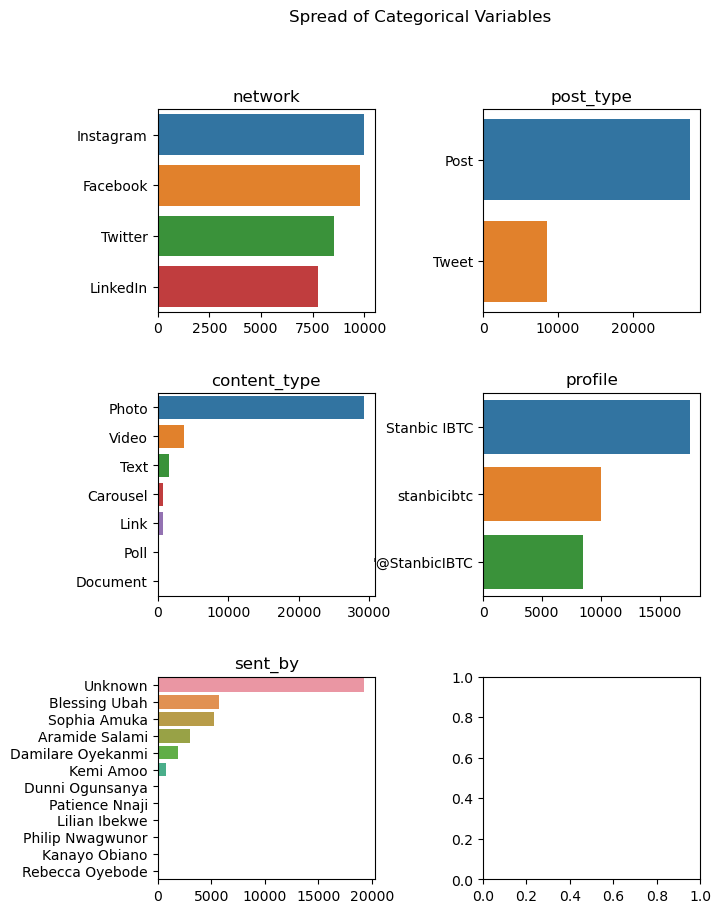

In [102]:
fig, axes = plt.subplots(3, 2, figsize=(7, 10))
fig.subplots_adjust(hspace=0.4, wspace=0.5)
cat_names = ['network', 'post_type', 'content_type', 'profile', 'sent_by']

for ax, col, name in zip(axes.ravel(), cat_cols, cat_names):
    sns.countplot(data=df, y=col, ax=ax, orient='h',
                  order=df[col].value_counts(ascending=False).index)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(name)
    
plt.suptitle('Spread of Categorical Variables')
plt.show()

**Initial Findings on Categorical Variables**
* The social media site with the most posts in our dataset is `Instagram` with about 10,000 records. However, all records have posts in excess of 7500 in the dataframe.
* `post_type` is an irrelevant feature since all included social media networks use `post` as the name of their posts except Twitter which uses `tweet`. We'll drop the feature.
* Photo is significantly the most popular content type.
* `profile` is also an irrelevant feature as it says nothing unique about the record that the `network` feature does not already state. We'll drop it as well. 
* Most posts were sent by an unknown sender. 

Let's drop the irrelevant features:

In [103]:
df = df.drop(columns=['post_type', 'profile'])
cat_cols = [i for i in df.columns if df[i].dtype=='object' and i not in text_cols]

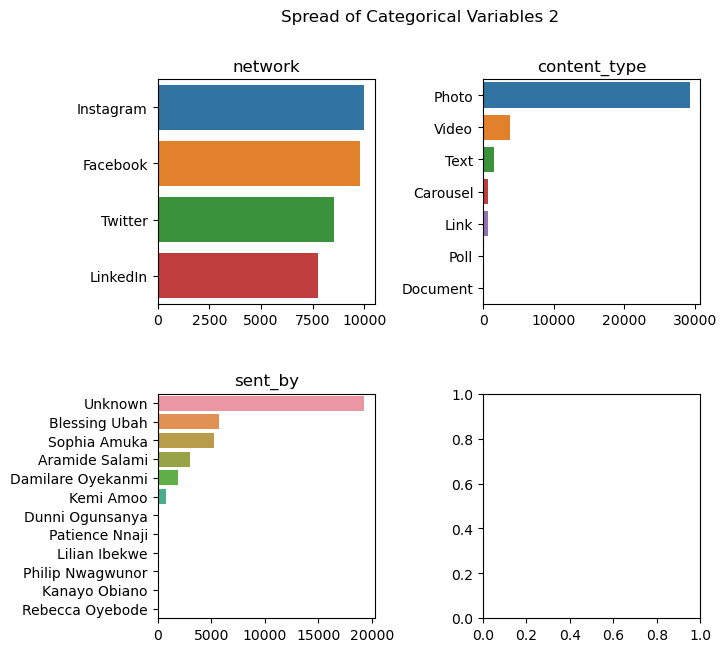

In [104]:
fig, axes = plt.subplots(2, 2, figsize=(7, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.5)
cat_names = ['network', 'content_type', 'sent_by']

for ax, col, name in zip(axes.ravel(), cat_cols, cat_names):
    sns.countplot(data=df, y=col, ax=ax, orient='h',
                  order=df[col].value_counts(ascending=False).index)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(name)

plt.suptitle('Spread of Categorical Variables 2')
plt.show()

Let's dig deeper into the `content_type` and `sent_by` features. Let's exclude the `Photo` and `Unknown` values in the `content_type` and `sent_by` features to see the spread of the smaller values:

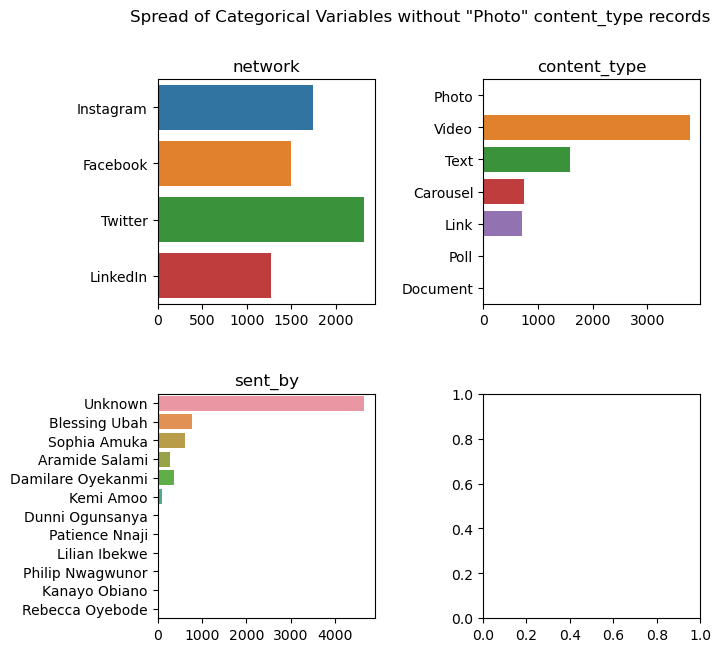

In [105]:
fig, axes = plt.subplots(2, 2, figsize=(7, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.5)
cat_names = ['network', 'content_type', 'sent_by']

for ax, col, name in zip(axes.ravel(), cat_cols, cat_names):
    sns.countplot(data=df.query('content_type != "Photo"'), y=col, ax=ax, orient='h', order=df[col].value_counts(ascending=False).index)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(name)

plt.suptitle('Spread of Categorical Variables without "Photo" content_type records')
plt.show()

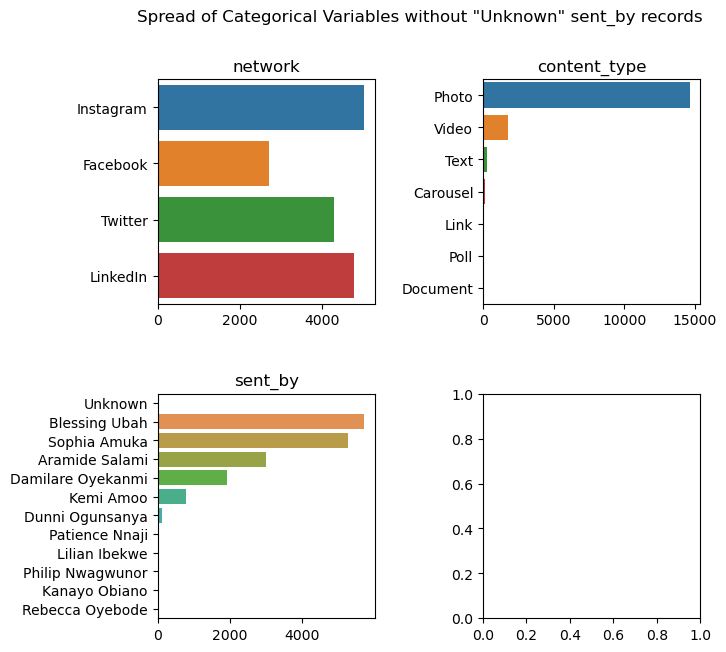

In [106]:
fig, axes = plt.subplots(2, 2, figsize=(7, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.5)
cat_names = ['network', 'content_type', 'sent_by']

for ax, col, name in zip(axes.ravel(), cat_cols, cat_names):
    sns.countplot(data=df.query('sent_by != "Unknown"'), y=col, ax=ax, orient='h', order=df[col].value_counts(ascending=False).index)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(name)

plt.suptitle('Spread of Categorical Variables without "Unknown" sent_by records')
plt.show()

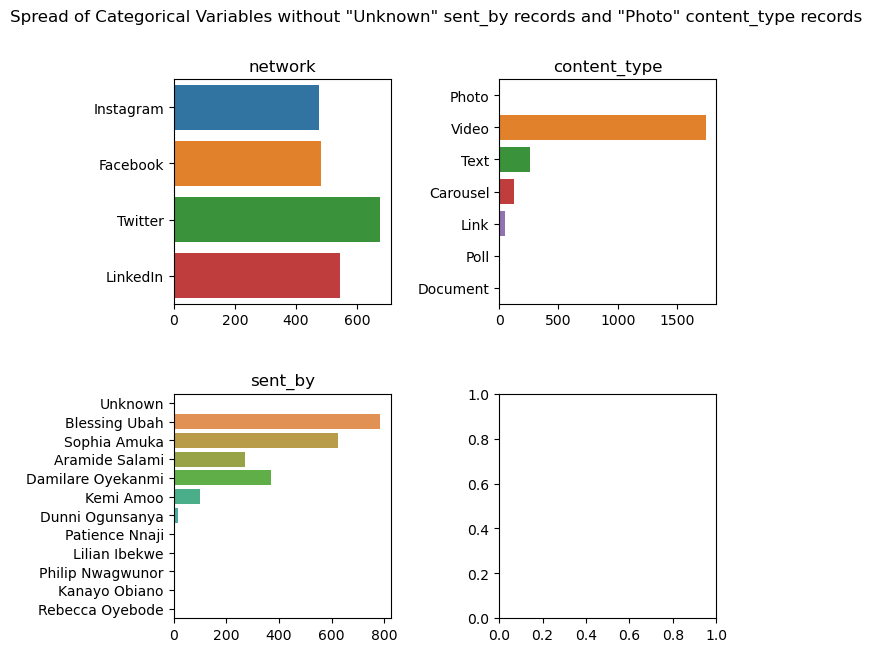

In [107]:
fig, axes = plt.subplots(2, 2, figsize=(7, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.5)
cat_names = ['network', 'content_type', 'sent_by']

for ax, col, name in zip(axes.ravel(), cat_cols, cat_names):
    sns.countplot(data=df.query('sent_by != "Unknown" and content_type != "Photo"'), y=col, ax=ax, orient='h', order=df[col].value_counts(ascending=False).index)
    ax.set_xlabel('')
    ax.set_ylabel('')
    ax.set_title(name)

plt.suptitle('Spread of Categorical Variables without "Unknown" sent_by records and "Photo" content_type records')
plt.show()

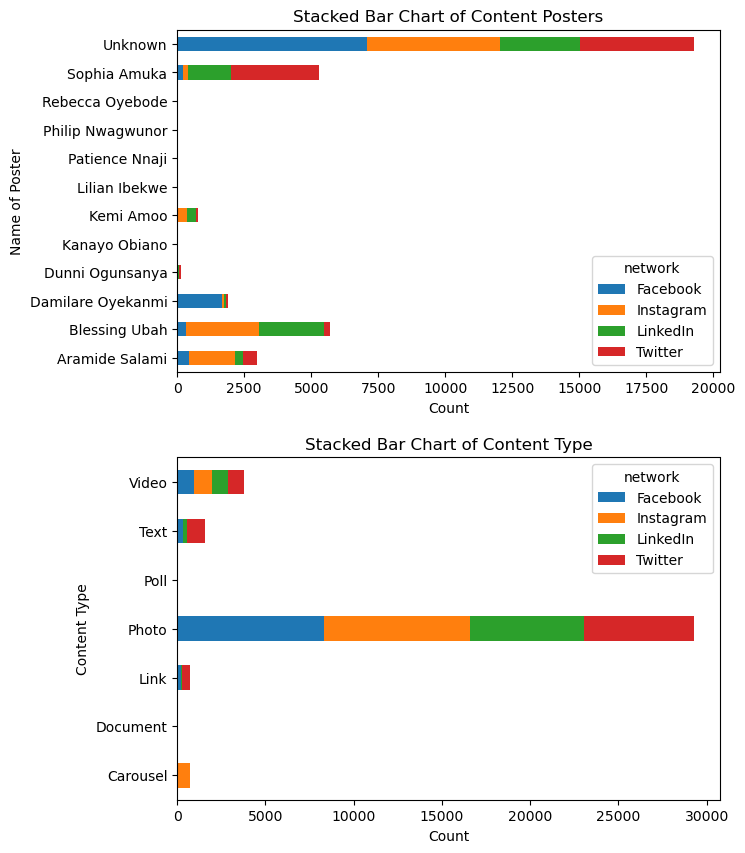

In [108]:
fig, axes = plt.subplots(2, 1, figsize=(7, 10))
fig.subplots_adjust(hspace=0.25)

pd.crosstab(df.sent_by, df.network).plot(kind='barh', stacked=True, ax=axes[0])
axes[0].set_title('Stacked Bar Chart of Content Posters')
axes[0].set_ylabel('Name of Poster')
axes[0].set_xlabel('Count')

pd.crosstab(df.content_type, df.network).plot(kind='barh', stacked=True, ax=axes[1])
axes[1].set_title('Stacked Bar Chart of Content Type')
axes[1].set_ylabel('Content Type')
axes[1].set_xlabel('Count')

plt.show()

When stacked by `network`, some interesting trends arise:
* Blessing Ubah, unlike other posters, makes significantly more posts on LinkedIn than on Twitter
* Twitter features significantly more text posts than LinkedIn, more than for all other content type counts visible on the chart.

<Figure size 1000x1000 with 0 Axes>

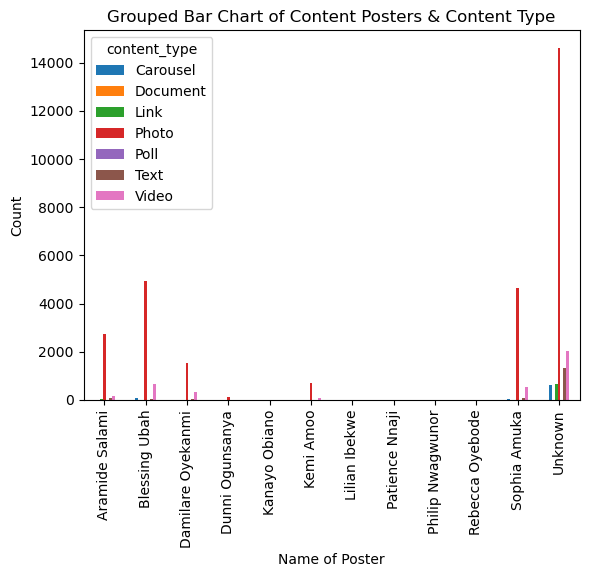

In [109]:
plt.figure(figsize=(10, 10))

pd.crosstab(df.sent_by, df.content_type).plot(kind='bar')
plt.title('Grouped Bar Chart of Content Posters & Content Type')
plt.xlabel('Name of Poster')
plt.ylabel('Count')

plt.show()

**Exploring the Text Features**

#Hashtags:

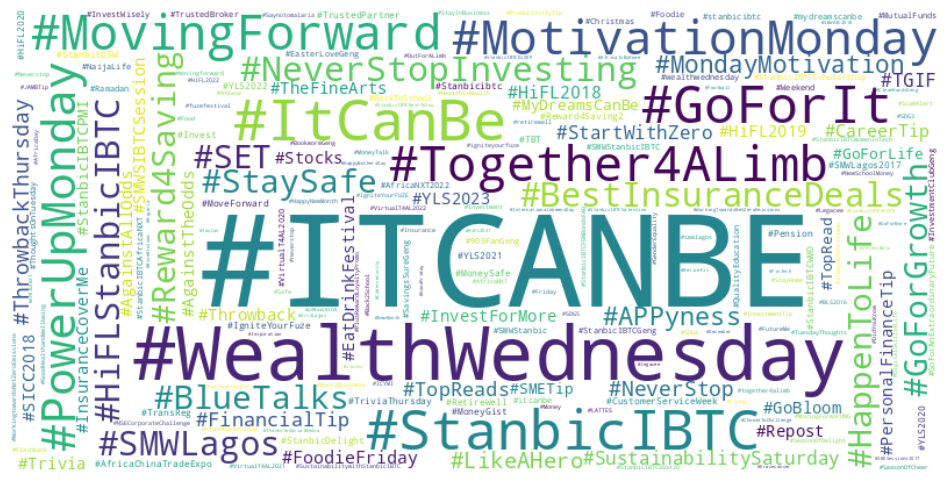

In [110]:
all_words = [word for sublist in df.hashtags for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

**Exploring Numerical Variables**

In [111]:
df[num_cols].describe()

,impressions,organic_impressions,viral_impressions,non_viral_impressions,paid_impressions,fan_impressions,fan_organic_impressions,fan_paid_impressions,non_fan_impressions,non_fan_organic_impressions,...,paid_video_view_time_seconds,unique_video_views,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views,character_count,word_count
count,36092.000000,36092.000000,36092.000000,36092.000000,36092.0,36092.000000,36092.000000,36092.0,36092.000000,36092.000000,...,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000
mean,3207.483389,2436.792024,169.256043,1421.763095,0.0,1336.182525,1336.182525,0.0,254.842630,237.676195,...,10.245543,61.131032,61.105541,0.002161,28.492831,18.132041,12.142526,0.000665,177.897900,27.572620
std,4440.780245,4312.114733,864.961455,3915.130142,0.0,3595.192230,3595.192230,0.0,1578.593414,1540.534323,...,121.433388,115.310243,115.271434,0.184596,58.581581,41.567768,24.726489,0.064893,115.264656,19.067668
min,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,-1930.000000,...,-29.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1083.303696,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,113.000000,17.000000
50%,2196.000000,1243.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,160.000000,24.000000
75%,3693.250000,2870.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.0,0.000000,0.000000,...,0.000000,225.067961,224.974110,0.000000,104.902913,66.757282,44.705502,0.000000,218.000000,34.000000
max,207378.000000,207378.000000,35816.000000,207373.000000,0.0,103287.000000,103287.000000,0.0,206231.000000,206231.000000,...,20611.980000,6243.000000,6243.000000,29.000000,4315.000000,3682.000000,1421.000000,11.000000,2142.000000,370.000000


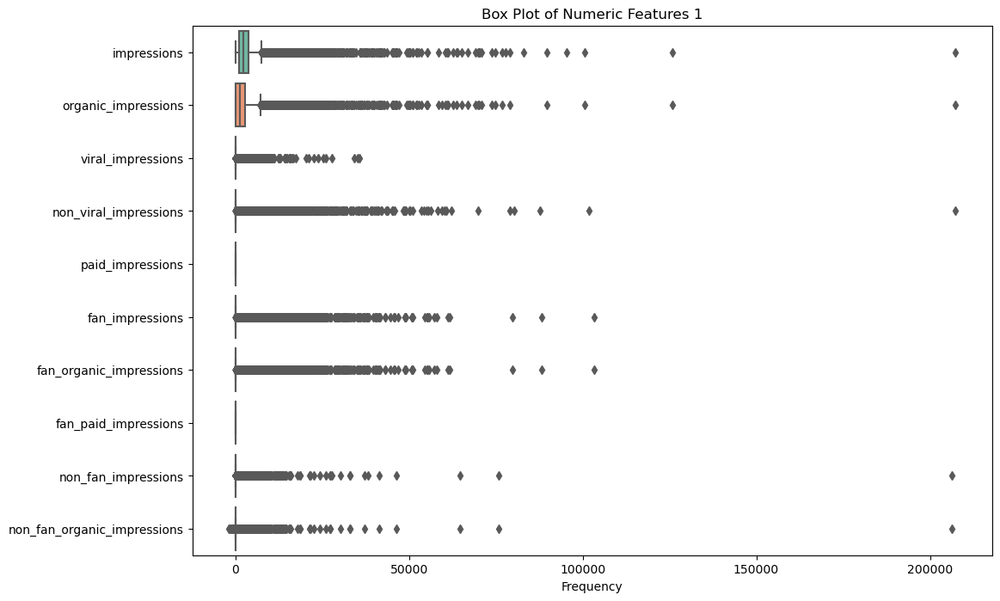

In [112]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[:10]], orient="h", palette="Set2") 
plt.title('Box Plot of Numeric Features 1')
plt.xlabel('Frequency')

plt.show()

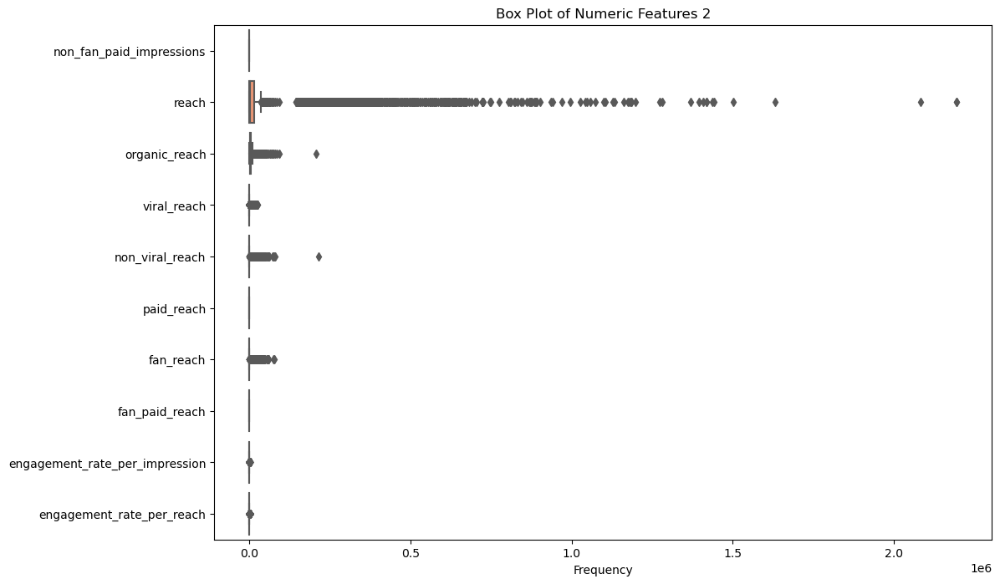

In [113]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[10:20]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 2')
plt.xlabel('Frequency')

plt.show()

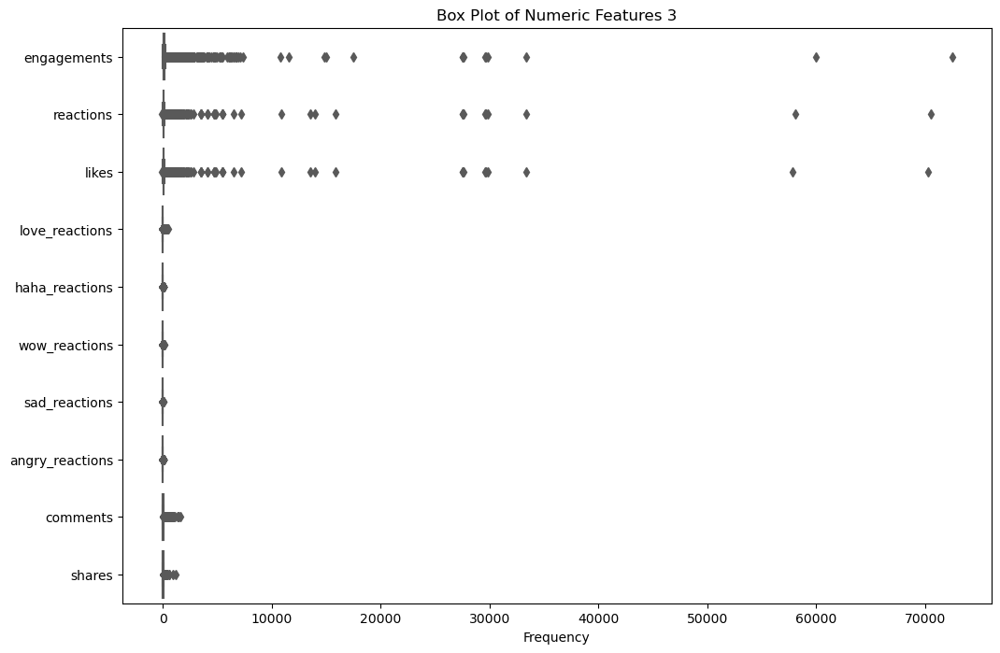

In [114]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[20:30]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 3')
plt.xlabel('Frequency')

plt.show()

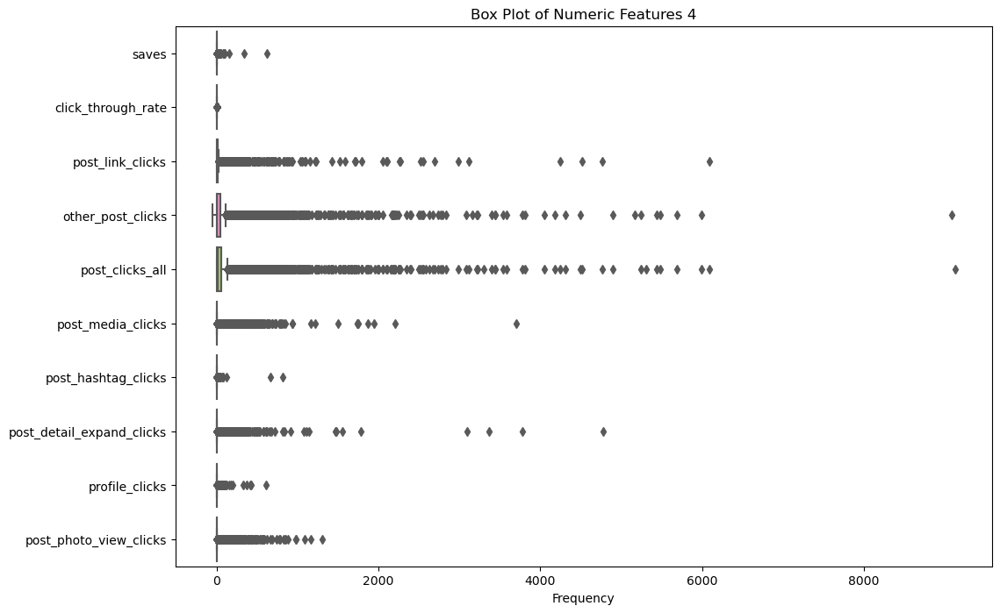

In [115]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[30:40]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 4')
plt.xlabel('Frequency')

plt.show()

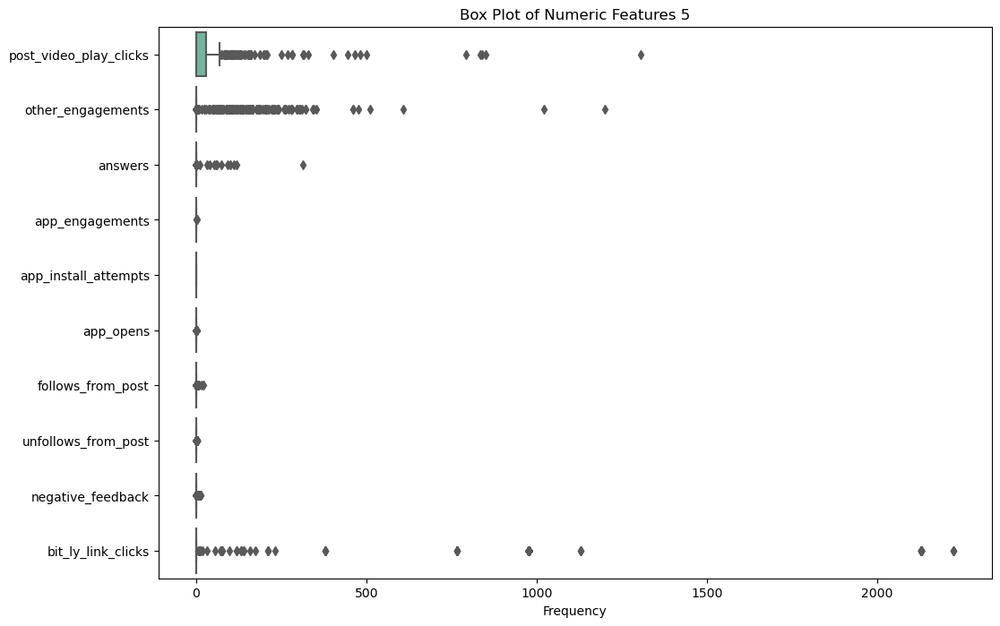

In [116]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[40:50]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 5')
plt.xlabel('Frequency')

plt.show()

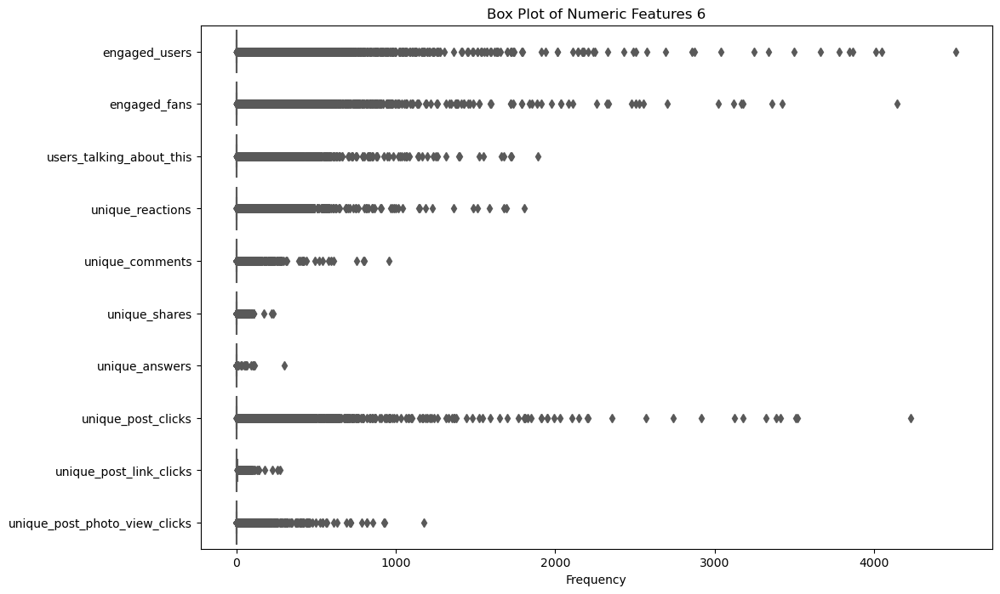

In [117]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[50:60]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 6')
plt.xlabel('Frequency')

plt.show()

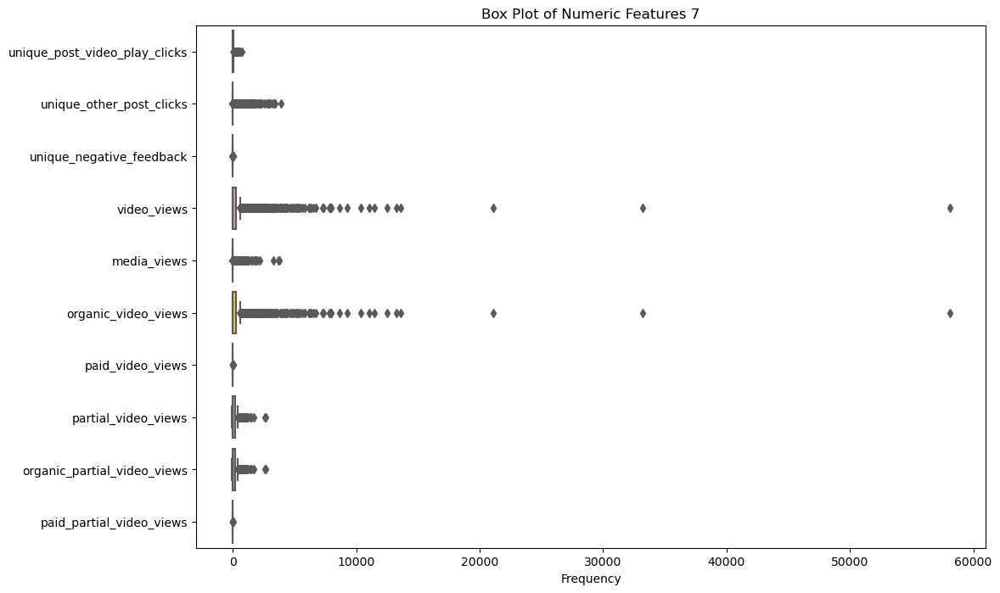

In [118]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[60:70]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 7')
plt.xlabel('Frequency')

plt.show()

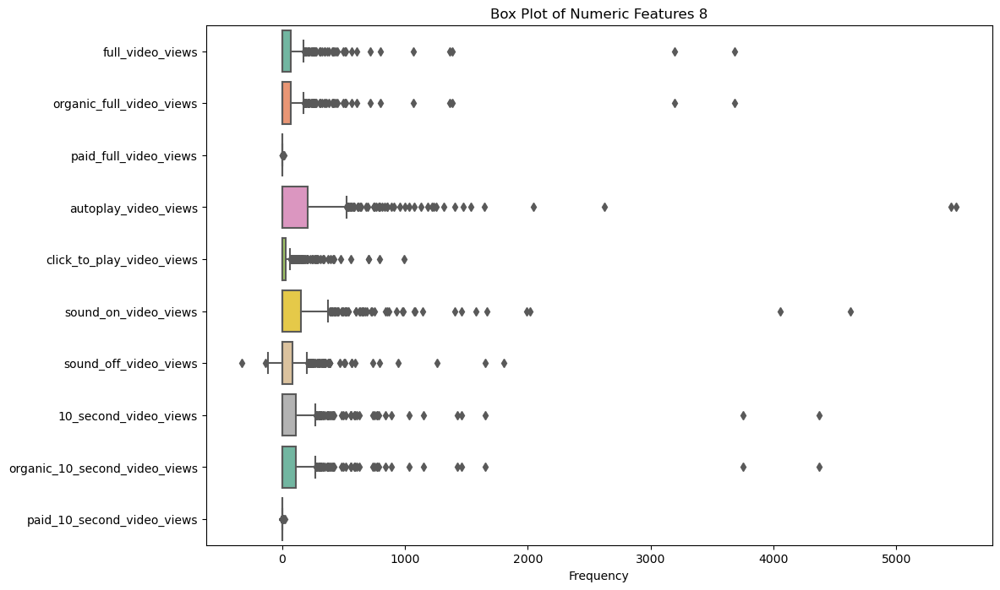

In [119]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[70:80]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 8')
plt.xlabel('Frequency')

plt.show()

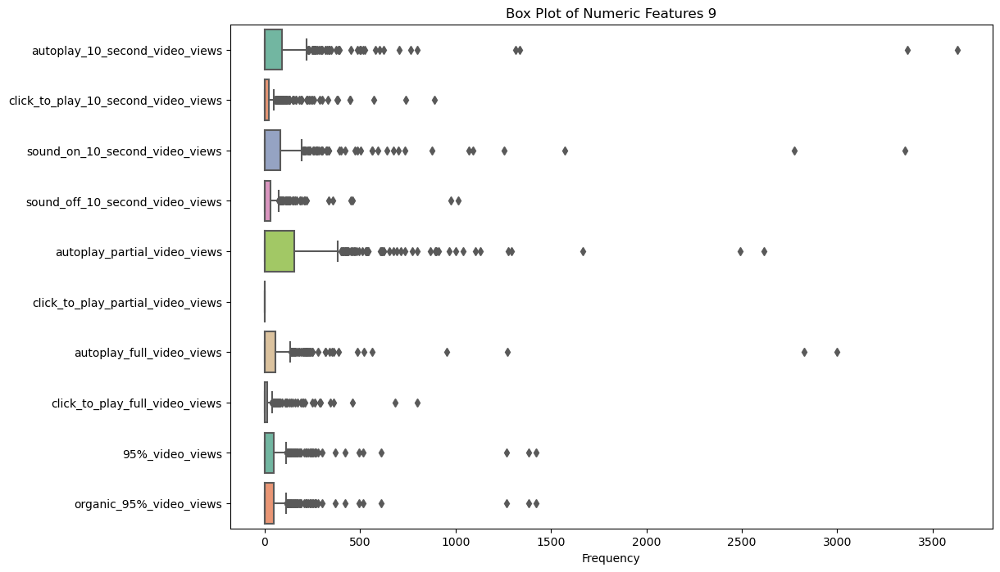

In [120]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[num_cols[80:90]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 9')
plt.xlabel('Frequency')

plt.show()

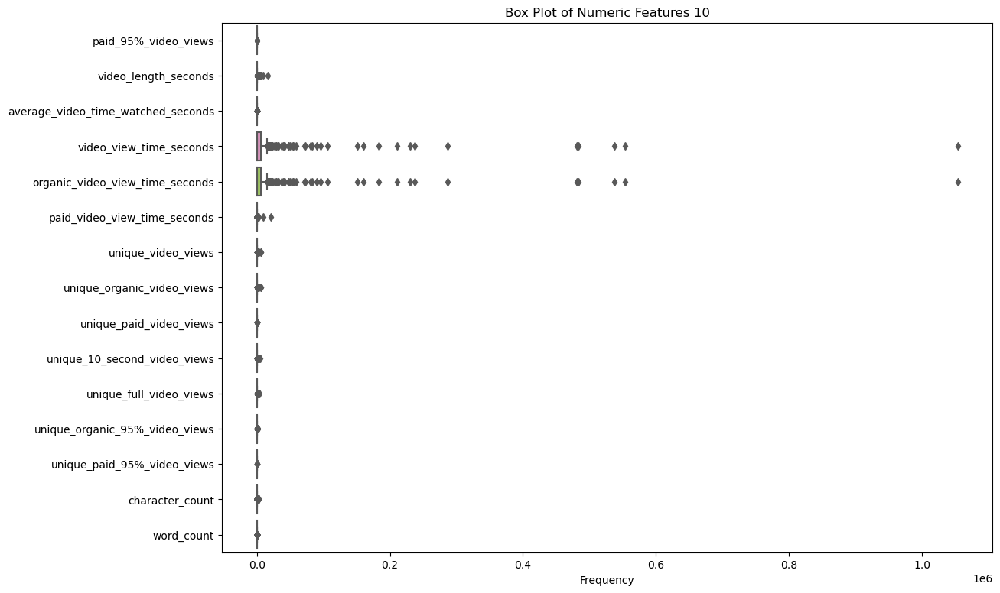

In [121]:
plt.figure(figsize=(13, 9))
sns.boxplot(data=df[num_cols[90:]], orient="h", palette="Set2")
plt.title('Box Plot of Numeric Features 10')
plt.xlabel('Frequency')

plt.show()

The numeric features with the biggest spreads are:
* impressions
* organic_impressions
* other_post_clicks
* post_clicks_all

The following features seem to have no values beyond 0. We'll review them to confirm and delete where necessary:
* paid_impressions
* fan_paid_impressions
* non_fan_paid_impressions
* paid_reach
* fan_paid_reach
* app_install_attempts
* click_to_play_partial_video_views

Other features to consider for very small spreads:
* viral_reach
* engagement_rate_per_impression
* engagement_rate_per_reach
* love_reactions
* haha_reactions
* wow_reactions
* sad_reactions
* angry_reactions
* click_through_rate
* app_engagements
* app_opens
* unfollows_from_post
* unique_negative_feedback
* paid_video_views
* paid_partial_video_views
* paid_full_video_views
* paid_10_second_video_views
* organic_95%_video_views
* paid_95%_video_views
* average_video_time_watched_seconds
* unique_video_views
* unique_organic_video_views
* unique_paid_video_views
* unique_10_second_video_views
* unique_full_video_views
* unique_organic_95%_video_views
* unique_paid_95%_video_views

In [122]:
cols_rev = ['paid_impressions', 'fan_paid_impressions', 'non_fan_paid_impressions', 'paid_reach', 'fan_paid_reach', 'app_install_attempts', 'click_to_play_partial_video_views']

In [123]:
df[cols_rev].describe()

,paid_impressions,fan_paid_impressions,non_fan_paid_impressions,paid_reach,fan_paid_reach,app_install_attempts,click_to_play_partial_video_views
count,36092.0,36092.0,36092.0,36092.0,36092.0,36092.0,36092.0
mean,0.0,0.0,0.0,0.0,0.0,0.0,0.0
std,0.0,0.0,0.0,0.0,0.0,0.0,0.0
min,0.0,0.0,0.0,0.0,0.0,0.0,0.0
25%,0.0,0.0,0.0,0.0,0.0,0.0,0.0
50%,0.0,0.0,0.0,0.0,0.0,0.0,0.0
75%,0.0,0.0,0.0,0.0,0.0,0.0,0.0
max,0.0,0.0,0.0,0.0,0.0,0.0,0.0


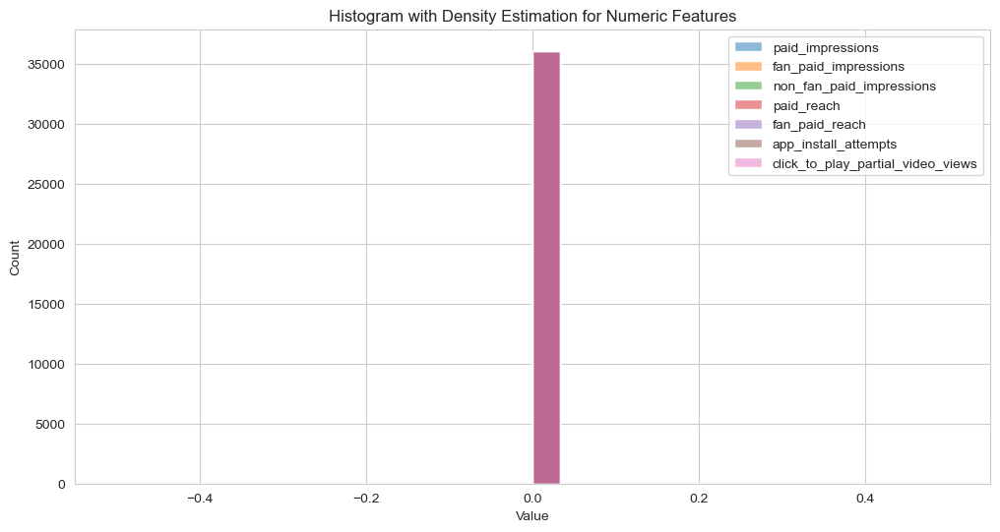

In [124]:
sns.set_style("whitegrid")

plt.figure(figsize=(12, 6))  
for column in cols_rev:  
    sns.histplot(df[column], kde=True, label=column, bins=30)
plt.title('Histogram with Density Estimation for Numeric Features')
plt.xlabel('Value')
plt.legend()
plt.show()

In [125]:
df = df.drop(columns=cols_rev)

In [126]:
cols_rev2 = ['viral_reach', 'engagement_rate_per_impression', 'engagement_rate_per_reach', 'love_reactions', 'haha_reactions', 'wow_reactions', 'sad_reactions',  'angry_reactions', 'click_through_rate', 'app_engagements', 'app_opens', 'unfollows_from_post', 'unique_negative_feedback', 'paid_video_views', 'paid_partial_video_views', 'paid_full_video_views', 'paid_10_second_video_views', 'organic_95%_video_views', 'paid_95%_video_views', 'average_video_time_watched_seconds', 'unique_video_views', 'unique_organic_video_views', 'unique_paid_video_views', 'unique_10_second_video_views', 'unique_full_video_views', 'unique_organic_95%_video_views', 'unique_paid_95%_video_views']

In [127]:
df[cols_rev2].describe()

,viral_reach,engagement_rate_per_impression,engagement_rate_per_reach,love_reactions,haha_reactions,wow_reactions,sad_reactions,angry_reactions,click_through_rate,app_engagements,...,organic_95%_video_views,paid_95%_video_views,average_video_time_watched_seconds,unique_video_views,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views
count,36092.000000,3.609200e+04,3.609200e+04,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,18838.000000,36092.000000,...,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000
mean,123.667409,inf,inf,0.626267,0.042942,0.035093,0.009224,0.041140,0.006748,0.000111,...,12.457501,0.000665,2.108097,61.131032,61.105541,0.002161,28.492831,18.132041,12.142526,0.000665
std,596.222508,NaN,NaN,8.019602,0.799063,1.153409,0.113628,0.338966,0.049362,0.012893,...,25.322742,0.064893,4.581778,115.310243,115.271434,0.184596,58.581581,41.567768,24.726489,0.064893
min,0.000000,-1.200000e-02,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,2.080000e-02,7.434890e-05,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,3.020000e-02,1.960000e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.000600,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,4.656636e-02,4.940000e-02,0.000000,0.000000,0.000000,0.000000,0.000000,0.007100,0.000000,...,45.865156,0.000000,7.761443,225.067961,224.974110,0.000000,104.902913,66.757282,44.705502,0.000000
max,24829.000000,inf,inf,471.000000,70.000000,163.000000,6.000000,21.000000,5.000000,2.000000,...,1421.000000,11.000000,327.530000,6243.000000,6243.000000,29.000000,4315.000000,3682.000000,1421.000000,11.000000


In [128]:
df.query('engagement_rate_per_impression==inf')[['post', 'impressions', 'engagements', 'reach', 'engagement_rate_per_impression', 'engagement_rate_per_reach', 'network']].head()

,post,impressions,engagements,reach,engagement_rate_per_impression,engagement_rate_per_reach,network
date,,,,,,,
2013-01-15 16:25:00,no post,5857.725177,231.683234,5210.642078,inf,inf,Facebook
2013-01-16 16:51:00,no post,5857.725177,231.683234,5210.642078,inf,inf,Facebook
2013-01-16 16:58:00,no post,5857.725177,231.683234,5210.642078,inf,inf,Facebook
2013-01-17 17:08:00,no post,5857.725177,231.683234,5210.642078,inf,inf,Facebook
2013-02-01 13:24:00,no post,5857.725177,231.683234,5210.642078,inf,inf,Facebook


In [129]:
df.loc[df.engagement_rate_per_impression==np.inf] = df.query('engagement_rate_per_impression==inf').assign(
    engagement_rate_per_impression=lambda x: x.engagements/x.impressions,
    engagement_rate_per_reach=lambda x: x.engagements/x.reach,
)

df.loc[df.engagement_rate_per_impression==np.inf] = df.query('engagement_rate_per_impression==inf').assign(
    engagement_rate_per_impression=0,
)

df.loc[df.engagement_rate_per_reach==np.inf] = df.query('engagement_rate_per_reach==inf').assign(
    engagement_rate_per_reach=0,
)

In [130]:
df[cols_rev2].describe()

,viral_reach,engagement_rate_per_impression,engagement_rate_per_reach,love_reactions,haha_reactions,wow_reactions,sad_reactions,angry_reactions,click_through_rate,app_engagements,...,organic_95%_video_views,paid_95%_video_views,average_video_time_watched_seconds,unique_video_views,unique_organic_video_views,unique_paid_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,unique_paid_95%_video_views
count,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,18838.000000,36092.000000,...,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000
mean,123.667409,0.123629,2.911470,0.626267,0.042942,0.035093,0.009224,0.041140,0.006748,0.000111,...,12.457501,0.000665,2.108097,61.131032,61.105541,0.002161,28.492831,18.132041,12.142526,0.000665
std,596.222508,2.129090,17.492225,8.019602,0.799063,1.153409,0.113628,0.338966,0.049362,0.012893,...,25.322742,0.064893,4.581778,115.310243,115.271434,0.184596,58.581581,41.567768,24.726489,0.064893
min,0.000000,-0.012000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.018500,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.027000,0.000766,0.000000,0.000000,0.000000,0.000000,0.000000,0.000600,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.039100,0.030100,0.000000,0.000000,0.000000,0.000000,0.000000,0.007100,0.000000,...,45.865156,0.000000,7.761443,225.067961,224.974110,0.000000,104.902913,66.757282,44.705502,0.000000
max,24829.000000,142.000000,656.000000,471.000000,70.000000,163.000000,6.000000,21.000000,5.000000,2.000000,...,1421.000000,11.000000,327.530000,6243.000000,6243.000000,29.000000,4315.000000,3682.000000,1421.000000,11.000000


In [131]:
for col in cols_rev2:
    print(df[col].value_counts())
    print('*'*30)

0.000000       27987
455.310019       910
1.000000         182
2.000000         127
3.000000         126
               ...  
6242.000000        1
2228.000000        1
4032.000000        1
2963.000000        1
1202.000000        1
Name: viral_reach, Length: 1459, dtype: int64
******************************
0.000000    1574
0.046566    1428
0.039552     910
0.034520     687
0.023000     130
            ... 
0.126000       1
0.121700       1
0.182000       1
0.152800       1
0.122000       1
Name: engagement_rate_per_impression, Length: 1687, dtype: int64
******************************
0.000000    10370
0.044463      910
0.026900       74
0.025100       65
0.021200       65
            ...  
0.000356        1
0.000249        1
0.000546        1
0.000298        1
0.000046        1
Name: engagement_rate_per_reach, Length: 9975, dtype: int64
******************************
0.000000      30765
1.000000       2106
2.000000       1112
2.305746        910
3.000000        463
              ...  


Remove the following columns since they have nearly no values outside 0:

In [132]:
cols_rev2 = ['click_through_rate', 'app_engagements', 'paid_video_views', 'paid_partial_video_views', 'paid_full_video_views', 'paid_95%_video_views', 'unique_paid_video_views', 'unique_paid_95%_video_views']
df[cols_rev2].describe()

,click_through_rate,app_engagements,paid_video_views,paid_partial_video_views,paid_full_video_views,paid_95%_video_views,unique_paid_video_views,unique_paid_95%_video_views
count,18838.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000
mean,0.006748,0.000111,0.002161,0.001081,0.001081,0.000665,0.002161,0.000665
std,0.049362,0.012893,0.184596,0.092523,0.097765,0.064893,0.184596,0.064893
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000600,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,0.007100,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,5.000000,2.000000,29.000000,13.000000,16.000000,11.000000,29.000000,11.000000


In [133]:
df = df.drop(columns=cols_rev2)

In [134]:
num_cols = [i for i in df.columns if df[i].dtype=='float64']
text_cols = ['post', 'linked_content', 'tags', 'hashtags']
cat_cols = [i for i in df.columns if df[i].dtype=='object' and i not in text_cols]

In [135]:
df[num_cols].describe()

,impressions,organic_impressions,viral_impressions,non_viral_impressions,fan_impressions,fan_organic_impressions,non_fan_impressions,non_fan_organic_impressions,reach,organic_reach,...,video_view_time_seconds,organic_video_view_time_seconds,paid_video_view_time_seconds,unique_video_views,unique_organic_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,character_count,word_count
count,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,3.609200e+04,19803.000000,...,3.609200e+04,3.609200e+04,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000,36092.000000
mean,3207.483389,2436.792024,169.256043,1421.763095,1336.182525,1336.182525,254.842630,237.676195,6.815193e+04,3321.901454,...,2.647621e+03,2.637430e+03,10.245543,61.131032,61.105541,28.492831,18.132041,12.142526,177.897900,27.572620
std,4440.780245,4312.114733,864.961455,3915.130142,3595.192230,3595.192230,1578.593414,1540.534323,1.287777e+05,4742.315727,...,9.391897e+03,9.383876e+03,121.433388,115.310243,115.271434,58.581581,41.567768,24.726489,115.264656,19.067668
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1930.000000,0.000000e+00,0.000000,...,0.000000e+00,0.000000e+00,-29.300000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1083.303696,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,951.000000,...,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,113.000000,17.000000
50%,2196.000000,1243.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.175000e+03,2077.000000,...,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,160.000000,24.000000
75%,3693.250000,2870.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.390675e+04,4399.000000,...,6.207075e+03,6.131025e+03,0.000000,225.067961,224.974110,104.902913,66.757282,44.705502,218.000000,34.000000
max,207378.000000,207378.000000,35816.000000,207373.000000,103287.000000,103287.000000,206231.000000,206231.000000,2.194275e+06,207378.000000,...,1.053676e+06,1.053676e+06,20611.980000,6243.000000,6243.000000,4315.000000,3682.000000,1421.000000,2142.000000,370.000000


The numeric columns have the following trends:
*  All features are right-skewed with most values clustered around 0. This is a function of the high number of missing values across the numeric features that were filled with 0. This means that for most posts, no metrics are recorded. 
* However, significant outliers exist. It is important to see the corresponding features for those outlier records.

Let's drill down into some variables:

**Impressions**

There are over 5000 records with outlier impressions in excess of 5000, representing over 14% of the dataset, while there are nearly 6000 records with 0 impressions, representing over 16% of the dataset.

In [136]:
print(f'LinkedIn Earliest Post Date: {df.loc[df.network == "LinkedIn"].index.min()}')

print(f'Facebook Earliest Post Date: {df.loc[df.network == "Facebook"].index.min()}')

print(f'Twitter Earliest Post Date: {df.loc[df.network == "Twitter"].index.min()}')

print(f'Instagram Earliest Post Date: {df.loc[df.network == "Instagram"].index.min()}')

LinkedIn Earliest Post Date: 2014-05-05 10:57:00
Facebook Earliest Post Date: 2013-01-15 16:25:00
Twitter Earliest Post Date: 2013-02-17 09:01:00
Instagram Earliest Post Date: 2014-12-22 17:59:00


**Impression Metrics**

In [137]:
excess_5k = df.loc[df['impressions'] > 5000, 'impressions'].shape[0]
zero_vals = df.loc[df['impressions'] == 0, 'impressions'].shape[0]
len_df = df.shape[0]

print(f'There are {excess_5k} records with outlier impressions in excess of 5000, representing over {(excess_5k/len_df)*100:.2f}% of the dataset, while there are {zero_vals} records with 0 impressions, representing over {(zero_vals/len_df)*100:.2f}% of the dataset.')

There are 6121 records with outlier impressions in excess of 5000, representing over 16.96% of the dataset, while there are 1470 records with 0 impressions, representing over 4.07% of the dataset.


Let's view the spread of the dataset for impressions outside these outliers, i.e., 80% of the dataset:

For non-outlier values, the dataset remains right-skewed, with a mode of 1000 impressions. The mode, however, represents 0.08% of the values in this dataframe without outliers. 

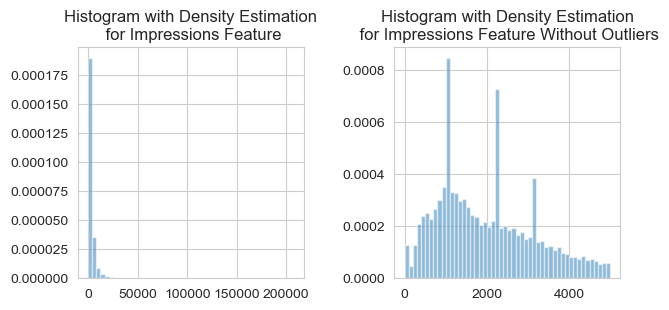

In [138]:
sns.set_style("whitegrid")

fig, axes = plt.subplots(1, 2, figsize=(7, 3))
fig.subplots_adjust(wspace=0.4)

axes[0].hist(df.impressions, density=True, bins=50, alpha=0.5)
axes[0].set_title('Histogram with Density Estimation\n for Impressions Feature')

no_outliers = df.loc[df.impressions.between(0, 5000, inclusive='neither'), 'impressions']
axes[1].hist(no_outliers, density=True, bins=50, alpha=0.5)
axes[1].set_title('Histogram with Density Estimation\n for Impressions Feature Without Outliers')

plt.show()

How does impression trend over time?

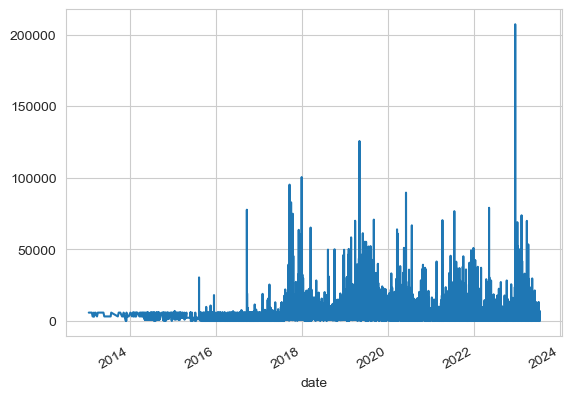

In [139]:
sns.set_style("whitegrid")
df.impressions.plot(kind='line')
plt.show()

Monthly average impressions over time:

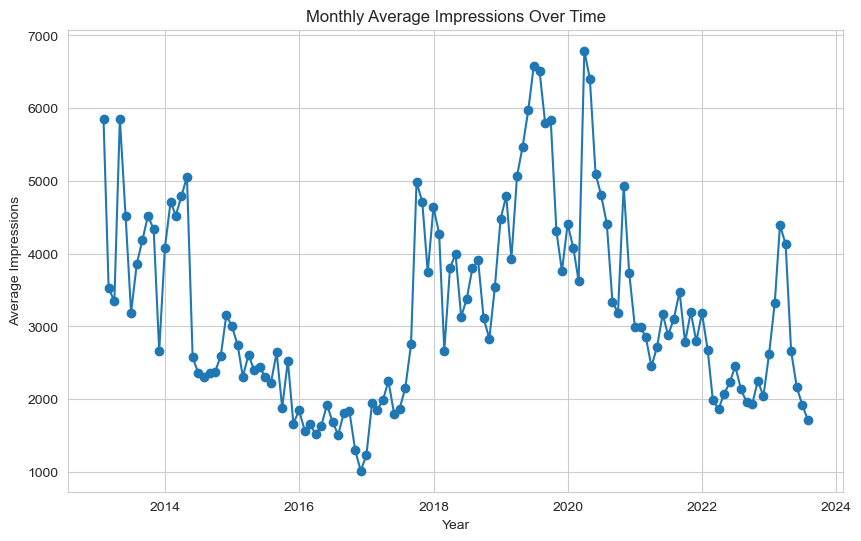

In [140]:
sns.set_style("whitegrid")
monthly_mean = df.impressions.resample('M').mean().interpolate()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Impressions')
plt.title('Monthly Average Impressions Over Time')
plt.show()

Trendline:

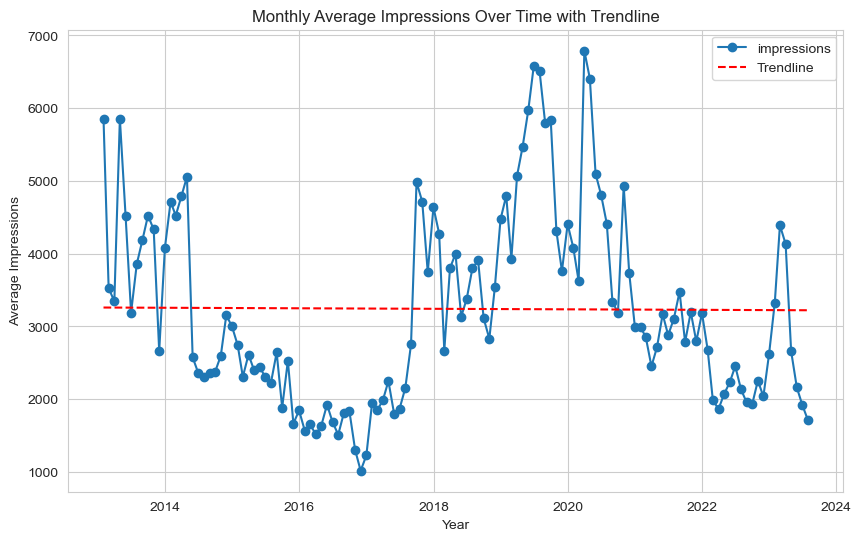

In [141]:
sns.set_style("whitegrid")
monthly_mean = df.impressions.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='impressions')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Impressions')
plt.title('Monthly Average Impressions Over Time with Trendline')
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


Average Impressions Grouped by Month

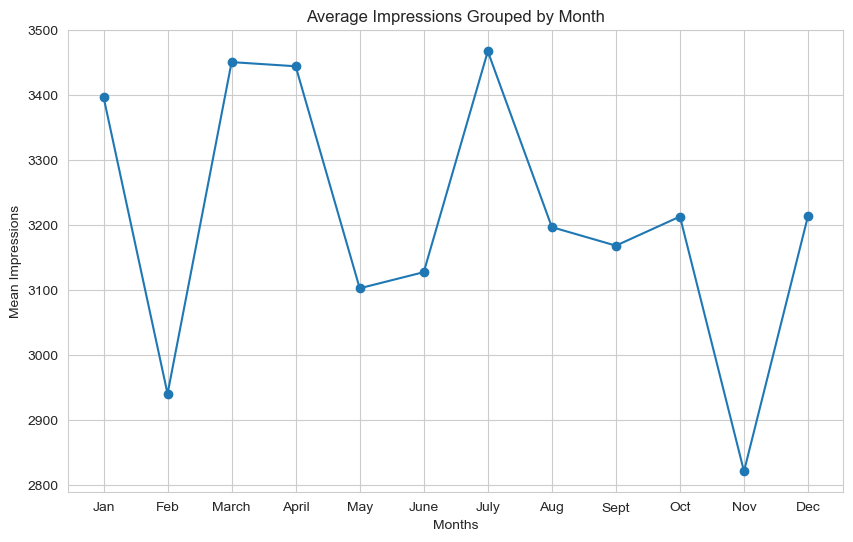

In [142]:
sns.set_style("whitegrid")
monthly_mean = df.impressions.groupby(df.index.month).mean()

month_mapping = {
    1: 'Jan', 2: 'Feb', 3: 'March', 4: 'April', 
    5: 'May', 6: 'June', 7: 'July', 8: 'Aug', 
    9: 'Sept', 10: 'Oct', 11: 'Nov', 12: 'Dec'
}
monthly_mean.index = monthly_mean.index.map(month_mapping)

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Months')
plt.ylabel('Mean Impressions')
plt.title('Average Impressions Grouped by Month')
plt.show()

Average Impressions grouped by Network

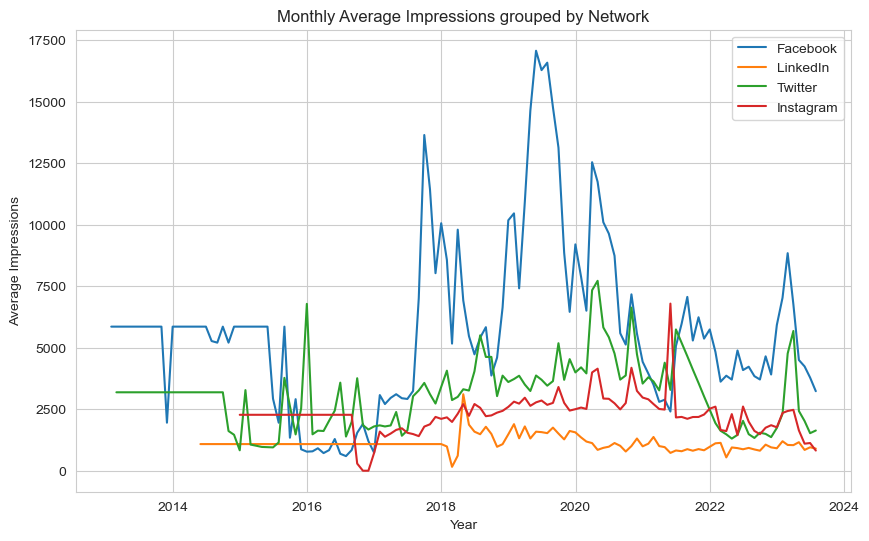

In [143]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'impressions'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'impressions'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'impressions'].resample('M').mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'impressions'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Year')
plt.ylabel('Average Impressions')
plt.title('Monthly Average Impressions grouped by Network')
plt.legend()
plt.show()

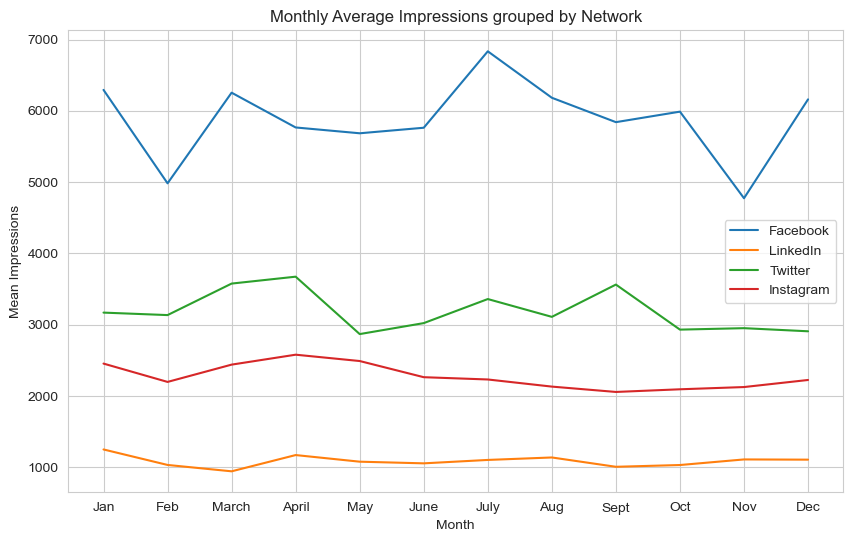

In [144]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'impressions'].groupby(df.loc[df.network=='Facebook', 'impressions'].index.month).mean().interpolate()

li_monthly_mean = df.loc[df.network=='LinkedIn', 'impressions'].groupby(df.loc[df.network=='LinkedIn', 'impressions'].index.month).mean().interpolate()

tw_monthly_mean = df.loc[df.network=='Twitter', 'impressions'].groupby(df.loc[df.network=='Twitter', 'impressions'].index.month).mean().interpolate()

ig_monthly_mean = df.loc[df.network=='Instagram', 'impressions'].groupby(df.loc[df.network=='Instagram', 'impressions'].index.month).mean().interpolate()

fb_monthly_mean.index = fb_monthly_mean.index.map(month_mapping)
li_monthly_mean.index = li_monthly_mean.index.map(month_mapping)
tw_monthly_mean.index = tw_monthly_mean.index.map(month_mapping)
ig_monthly_mean.index = ig_monthly_mean.index.map(month_mapping)

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Month')
plt.ylabel('Mean Impressions')
plt.title('Monthly Average Impressions grouped by Network')
plt.legend()
plt.show()

Impressions Trends for records with tags:

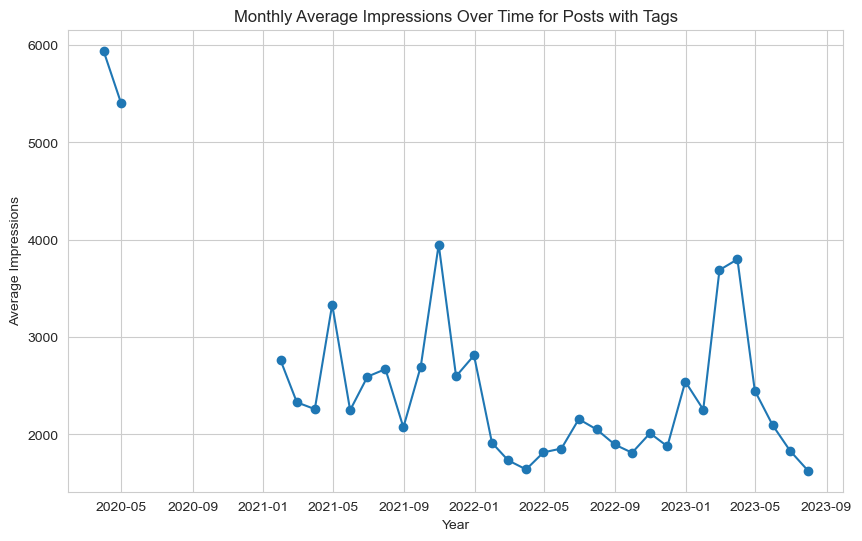

In [145]:
tag_df = df.loc[df.tags != 'no tags']
monthly_mean = tag_df.impressions.resample('M').mean()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Impressions')
plt.title('Monthly Average Impressions Over Time for Posts with Tags')
plt.show()

In [146]:
df.loc[df.tags != 'no tags'].network.unique()

array(['Twitter', 'Instagram', 'Facebook', 'LinkedIn'], dtype=object)

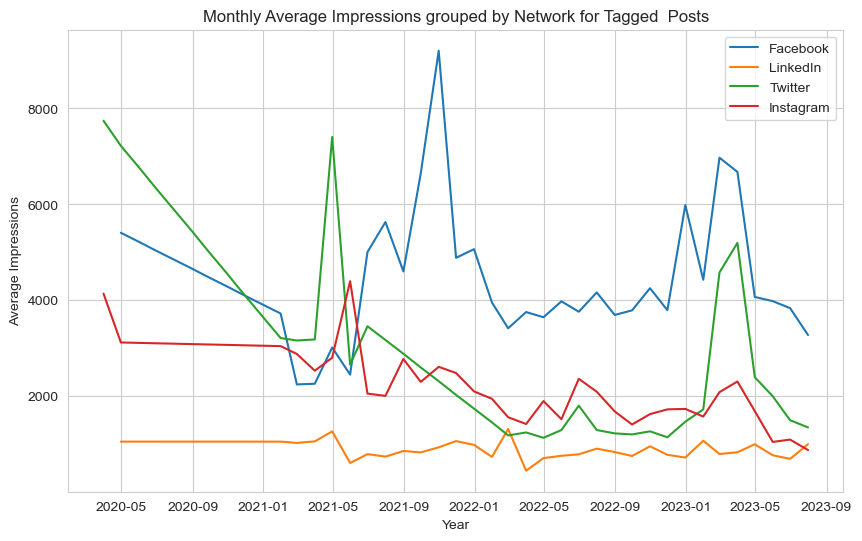

In [147]:
fb_monthly_mean = tag_df.loc[tag_df.network=='Facebook', 'impressions'].resample('M').mean().interpolate()
li_monthly_mean = tag_df.loc[tag_df.network=='LinkedIn', 'impressions'].resample('M').mean().interpolate()
tw_monthly_mean = tag_df.loc[tag_df.network=='Twitter', 'impressions'].resample('M').mean().interpolate()
ig_monthly_mean = tag_df.loc[tag_df.network=='Instagram', 'impressions'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Year')
plt.ylabel('Average Impressions')
plt.title('Monthly Average Impressions grouped by Network for Tagged  Posts')
plt.legend()
plt.show()

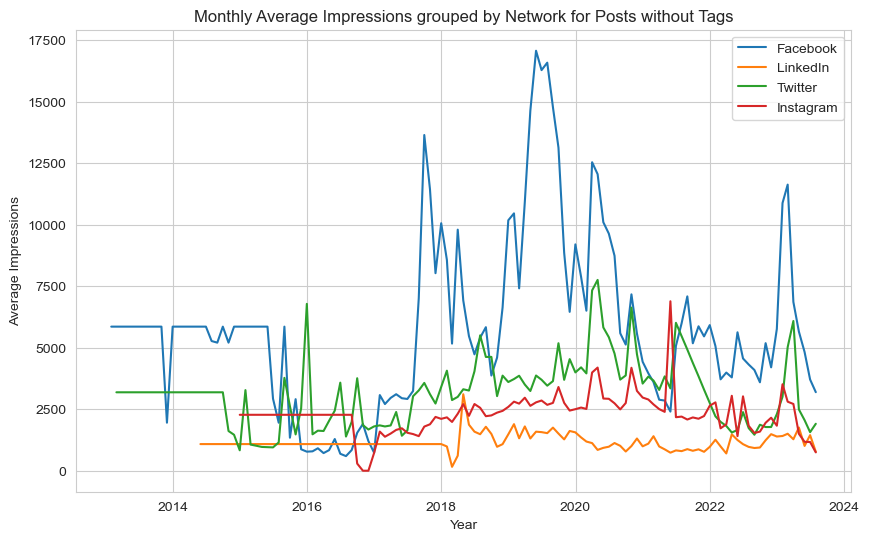

In [148]:
ntag_df = df.loc[df.tags == 'no tags']

fb_monthly_mean = ntag_df.loc[ntag_df.network=='Facebook', 'impressions'].resample('M').mean().interpolate()
li_monthly_mean = ntag_df.loc[ntag_df.network=='LinkedIn', 'impressions'].resample('M').mean().interpolate()
tw_monthly_mean = ntag_df.loc[ntag_df.network=='Twitter', 'impressions'].resample('M').mean().interpolate()
ig_monthly_mean = ntag_df.loc[ntag_df.network=='Instagram', 'impressions'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Year')
plt.ylabel('Average Impressions')
plt.title('Monthly Average Impressions grouped by Network for Posts without Tags')
plt.legend()
plt.show()

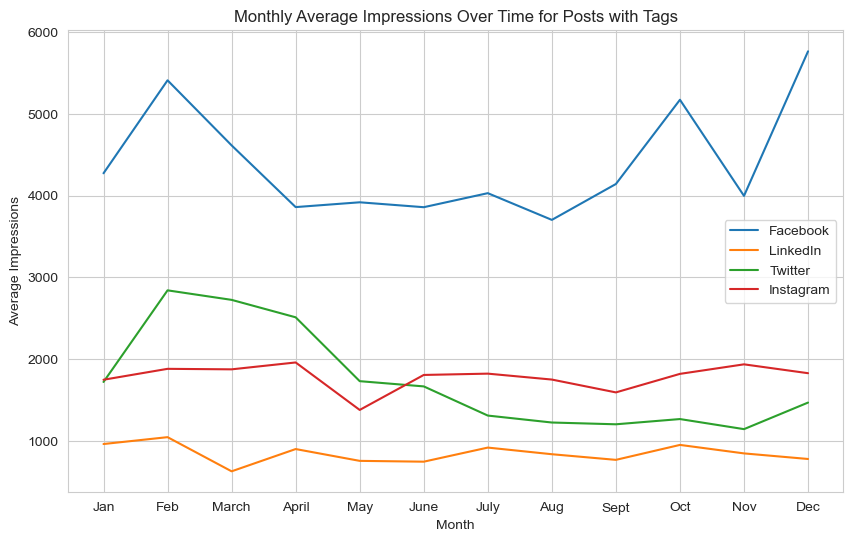

In [149]:
fb_monthly_mean = tag_df.loc[tag_df.network=='Facebook', 'impressions'].groupby(tag_df.loc[tag_df.network=='Facebook', 'impressions'].index.month).mean().interpolate()
li_monthly_mean = tag_df.loc[tag_df.network=='LinkedIn', 'impressions'].groupby(tag_df.loc[tag_df.network=='LinkedIn', 'impressions'].index.month).mean().interpolate()
tw_monthly_mean = tag_df.loc[tag_df.network=='Twitter', 'impressions'].groupby(tag_df.loc[tag_df.network=='Twitter', 'impressions'].index.month).mean().interpolate()
ig_monthly_mean = tag_df.loc[tag_df.network=='Instagram', 'impressions'].groupby(tag_df.loc[tag_df.network=='Instagram', 'impressions'].index.month).mean().interpolate()

fb_monthly_mean.index = fb_monthly_mean.index.map(month_mapping)
li_monthly_mean.index = li_monthly_mean.index.map(month_mapping)
tw_monthly_mean.index = tw_monthly_mean.index.map(month_mapping)
ig_monthly_mean.index = ig_monthly_mean.index.map(month_mapping)

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Month')
plt.ylabel('Average Impressions')
plt.legend()
plt.title('Monthly Average Impressions Over Time for Posts with Tags')
plt.show()

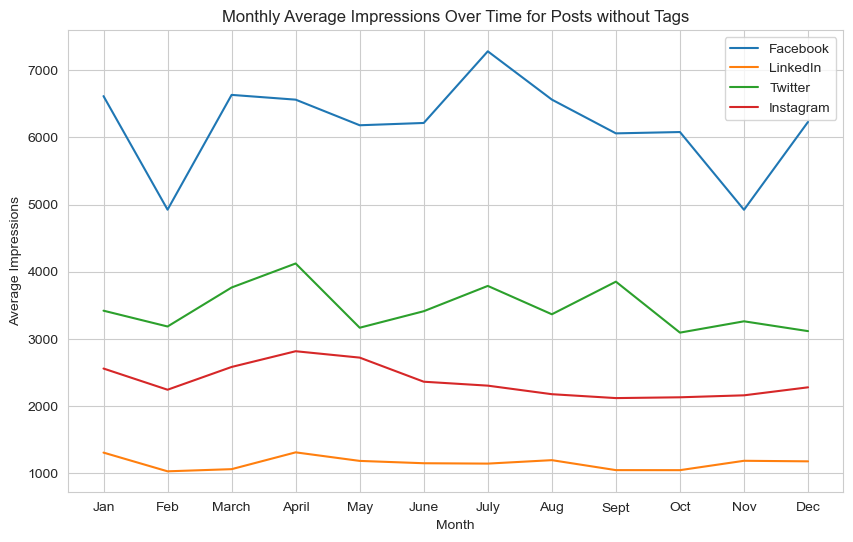

In [150]:
fb_monthly_mean = ntag_df.loc[ntag_df.network=='Facebook', 'impressions'].groupby(ntag_df.loc[ntag_df.network=='Facebook', 'impressions'].index.month).mean().interpolate()
li_monthly_mean = ntag_df.loc[ntag_df.network=='LinkedIn', 'impressions'].groupby(ntag_df.loc[ntag_df.network=='LinkedIn', 'impressions'].index.month).mean().interpolate()
tw_monthly_mean = ntag_df.loc[ntag_df.network=='Twitter', 'impressions'].groupby(ntag_df.loc[ntag_df.network=='Twitter', 'impressions'].index.month).mean().interpolate()
ig_monthly_mean = ntag_df.loc[ntag_df.network=='Instagram', 'impressions'].groupby(ntag_df.loc[ntag_df.network=='Instagram', 'impressions'].index.month).mean().interpolate()

fb_monthly_mean.index = fb_monthly_mean.index.map(month_mapping)
li_monthly_mean.index = li_monthly_mean.index.map(month_mapping)
tw_monthly_mean.index = tw_monthly_mean.index.map(month_mapping)
ig_monthly_mean.index = ig_monthly_mean.index.map(month_mapping)

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Month')
plt.ylabel('Average Impressions')
plt.legend()
plt.title('Monthly Average Impressions Over Time for Posts without Tags')
plt.show()

In [151]:
tag_df = df.loc[df.tags != 'no tags']
tag_df.loc[tag_df.impressions > 3000].groupby(by='network').mean(numeric_only=True)['impressions']

network
Facebook     5906.507450
Instagram    4789.128205
LinkedIn     5549.944444
Twitter      5868.657564
Name: impressions, dtype: float64

Are impressions seasonal?:

`Impression`, in the context of social media, refers to the total number of times a particular piece of content, such as a post, ad, or tweet, is displayed on a user's screen.

In our dataset, individual impressions have steadily increased over time, with a peak in 2023. Records from all networks start coming in from 2013-2014, however, we see a significant increase in average monthly impressions from late 2017. The cause of this spike is unclear. However, it is maintained and increased through to the end of the dataset.

When grouped by months, average impressions are consecutively high between November and April (with a dip in February). The rest of the year has lower impressions on average with an excepted spike in July. Going by Nigeria's weather patterns, average impressions are generally higher in the dry months and lower in the wet months of the year. This implies a seasonal trend in impressions.

When grouped by networks, the highest impressions are from Facebook. Facebook, Twitter and to some extent, Instagram, have somewhat similar impression trends over time. LinkedIn's impressions have the lowest values across networks, and after a spike in 2018, their values even out through to the end of the dataset. 

When grouped by months and networks, LinkedIn and Instagram have similar patterns with peaks between February and April and slight spikes between October and December. This is in line with the overall average impressions grouped by months which are the highest between November and April. While Twitter and Facebook follow the same trend, they both have bimodal distributions, with clear peaks in March & July for Facebook and April & September for Twitter.

In conclusion, a deep dive into the `impressions` feature reveals the following:
* 20% of the feature consists of outliers, either with 0 values or values in excess of 5,000 impressions.
* For the remainder values, the feature spread is right skewed with a mode of 1000 impressions, although the mode represents only 0.08% of the non-outlier dataset.
* Impressions have generally increased over time.
* On average, impressions are seasonal with higher values during the dry season.
* The highest impressions are from Facebook & Twitter.
* In a smoother plot, most network impressions show a normal distribution over time, except LinkedIn, whose values are closer to uniform than normal.
* On average, the lowest months for impressions are November and February.
* Tagging posts began in 2020. Tagged posts generally have lower impressions, averaging around 2500 impressions, with 2 peaks in late 2021 and early 2023.

Organic Impressions

`Organic impressions` in the context of social media refer to the number of times a piece of content (such as a post, tweet, video, or image) is displayed on users' feeds or timelines without any paid promotion or advertising. These impressions are the result of your content being shown to your followers and others who come across your content through shares, likes, comments, or other interactions within the platform's natural, non-paid distribution system.

Organic impressions are metrics native to all networks except twitter. All chart analysis should keep this in mind.

This feature is likely to be correlated with other impressions-based metrics.

In [152]:
df.query('network=="Twitter"').organic_impressions.unique()

array([0.])

In [153]:
imp_metrics = [
    'impressions', 'organic_impressions', 'viral_impressions', 'non_viral_impressions', 'fan_impressions', 'fan_organic_impressions', 'non_fan_impressions', 'non_fan_organic_impressions'
]

In [154]:
excess_5k = df.loc[df['organic_impressions'] > 5000, 'organic_impressions'].shape[0]
zero_vals = df.loc[df['organic_impressions'] == 0, 'organic_impressions'].shape[0]
len_df = df.shape[0]

print(f'There are {excess_5k} records with outlier organic impressions in excess of 5000, representing over {(excess_5k/len_df)*100:.2f}% of the dataset, while there are {zero_vals} records with 0 organic impressions, representing over {(zero_vals/len_df)*100:.2f}% of the dataset.')

There are 4938 records with outlier organic impressions in excess of 5000, representing over 13.68% of the dataset, while there are 9998 records with 0 organic impressions, representing over 27.70% of the dataset.


These numbers are similar to those from the `impressions` metrics.

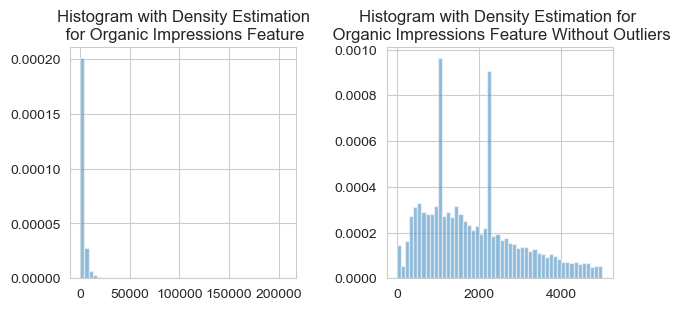

In [155]:
sns.set_style("whitegrid")

fig, axes = plt.subplots(1, 2, figsize=(7, 3))
fig.subplots_adjust(wspace=0.4)

axes[0].hist(df.organic_impressions, density=True, bins=50, alpha=0.5)
axes[0].set_title('Histogram with Density Estimation\n for Organic Impressions Feature')

no_outliers = df.loc[df.organic_impressions.between(0, 5000, inclusive='neither'), 'organic_impressions']
axes[1].hist(no_outliers, density=True, bins=50, alpha=0.5)
axes[1].set_title('Histogram with Density Estimation for \n Organic Impressions Feature Without Outliers')

plt.show()

This plot is identical to that of the `impressions` feature.

Organic Impressions vs. Impressions:

We assume that both features are identical. Therefore, we'll use a regression plot to confirm or disprove our assumption. We'll also include an r-squared score to determine how identical the values of both features are.

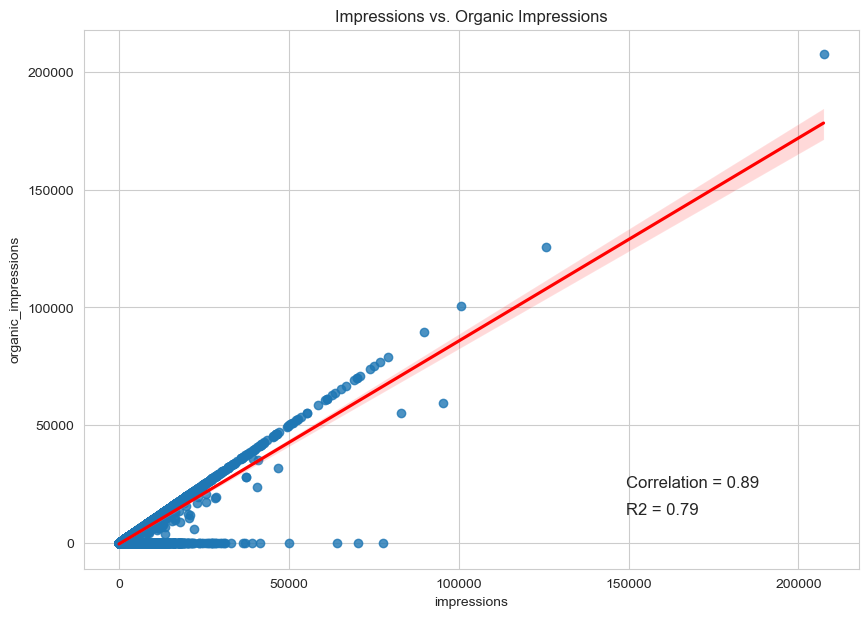

In [156]:
plt.figure(figsize=(10, 7))

slope, intercept, r_value, p_value, std_err = stats.linregress(df.impressions.fillna(df.impressions.mean()), df.organic_impressions.fillna(df.organic_impressions.mean()))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='impressions', y='organic_impressions', data=df, line_kws=dict(color="r"))
plt.annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.1), xycoords='axes fraction', fontsize=12)
plt.annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.15), xycoords='axes fraction', fontsize=12)

plt.title('Impressions vs. Organic Impressions')

plt.show()

From our plot, nearly all impressions are organic. Let's check for other impressions-based metrics:

<Figure size 1200x1200 with 0 Axes>

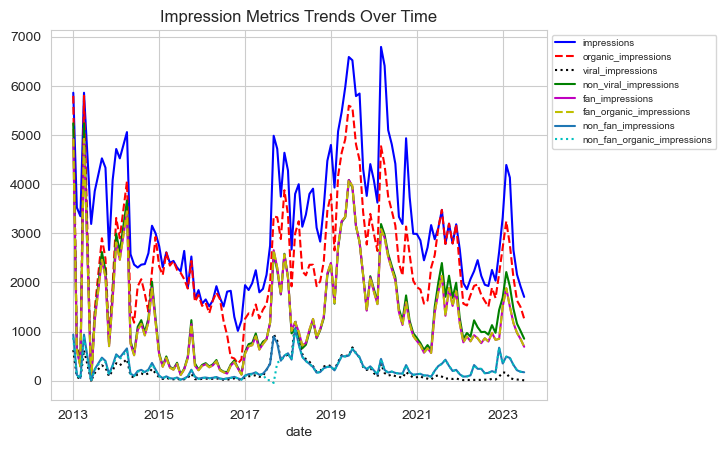

In [157]:
plt.figure(figsize=(12, 12))
df[imp_metrics].resample('M').mean().interpolate().plot(
    y=imp_metrics,
    # style=['o-b', '--r', ':k', '-g', 'o-m', '*--y', '', ':c', 'o-w'],
    style=['-b', '--r', ':k', '-g', '-m', '--y', '', ':c', '-w'],
    title='Impression Metrics Trends Over Time'
).autoscale()
plt.legend(loc='upper left', bbox_to_anchor=(1, 1), fontsize=7)
plt.show()

Comparing Similar Impressions Metrics

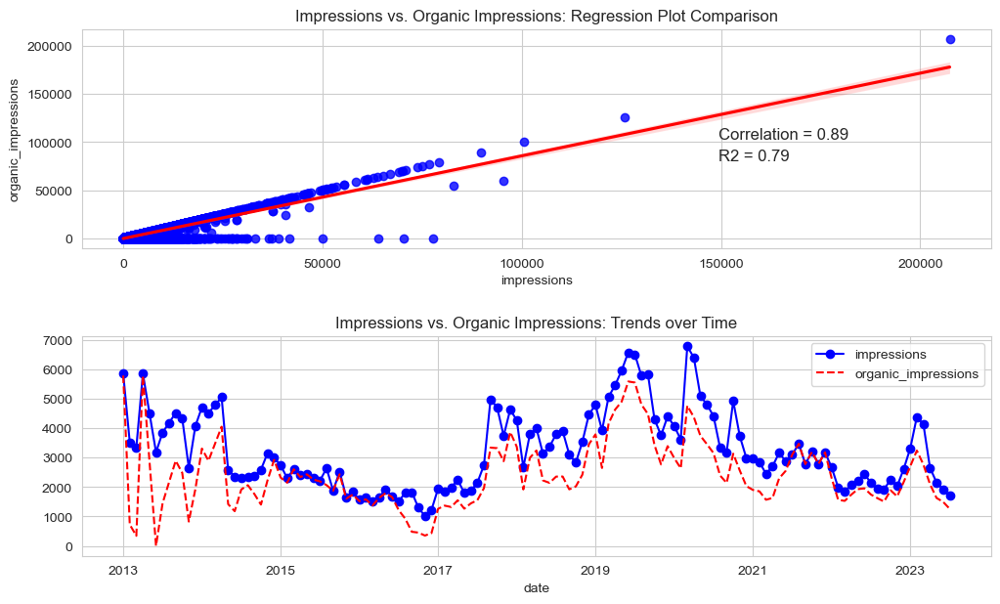

In [158]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.impressions.fillna(df.impressions.mean()), df.organic_impressions.fillna(df.organic_impressions.mean()))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='impressions', y='organic_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Impressions vs. Organic Impressions: Regression Plot Comparison')

df[imp_metrics].resample('M').mean().interpolate().plot(
    y=['impressions', 'organic_impressions'],
    style=['o-b', '--r'],
    title='Impressions vs. Organic Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

Beyond `impressions / reach` and `organic_impressions / reach`, all other impressions/ reach based metrics are only tracked by Facebook.

`Viral impressions` refer to the number of times a piece of content or post is viewed or displayed as a result of being shared by users beyond your immediate network or followers. They occur when your content spreads rapidly and widely through social media platforms due to shares, reposts, retweets, or other forms of user-driven distribution.

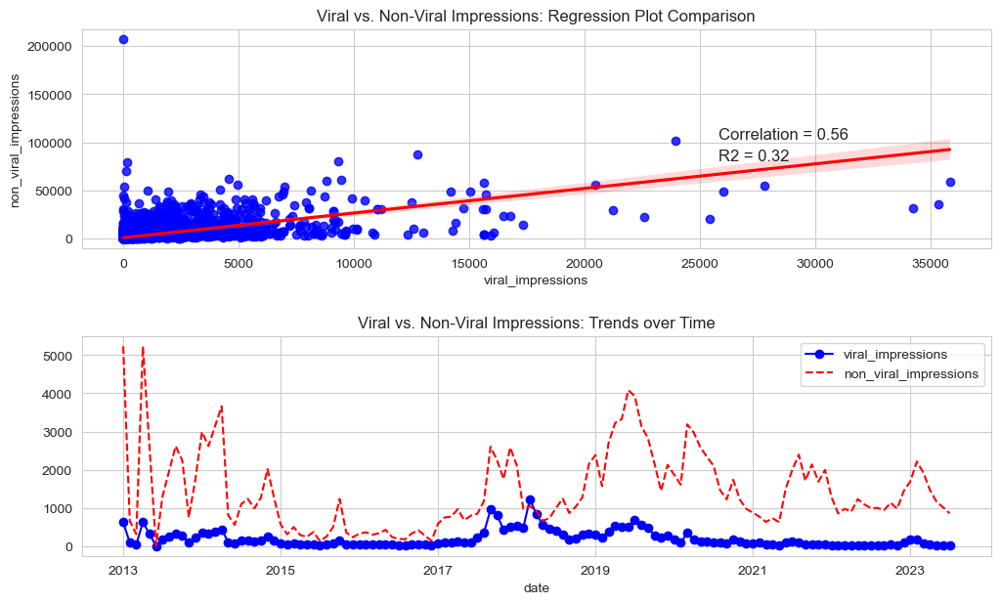

In [159]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.viral_impressions.fillna(0), df.non_viral_impressions.fillna(0))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='viral_impressions', y='non_viral_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Viral vs. Non-Viral Impressions: Regression Plot Comparison')

df[imp_metrics].resample('M').mean().interpolate().plot(
    y=['viral_impressions', 'non_viral_impressions'],
    style=['o-b', '--r'],
    title='Viral vs. Non-Viral Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

For viral & non-viral impressions, values only exist for Facebook network:

In [160]:
df.groupby(by='network').mean(numeric_only=True).viral_impressions

network
Facebook     623.155066
Instagram      0.000000
LinkedIn       0.000000
Twitter        0.000000
Name: viral_impressions, dtype: float64

In [161]:
df.groupby(by='network').mean(numeric_only=True).non_viral_impressions

network
Facebook     5234.547959
Instagram       0.000000
LinkedIn        0.000000
Twitter         0.000000
Name: non_viral_impressions, dtype: float64

A relevant question is what drives virality? Let's consider the relationship between word and character counts and virality.

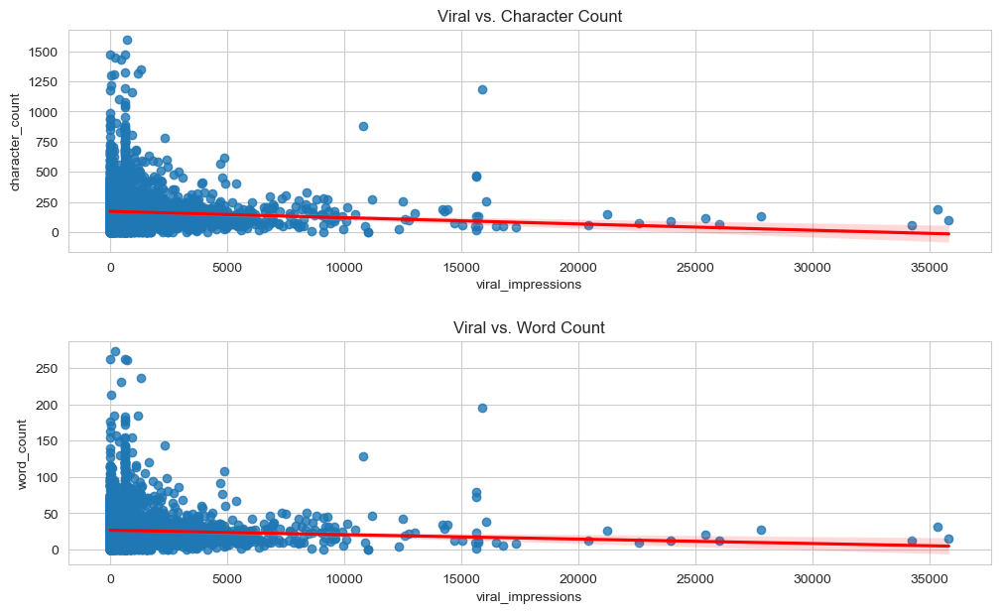

In [162]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

sns.regplot(x='viral_impressions', y='character_count', data=df.query('network=="Facebook"'), line_kws=dict(color="r"), ax=axes[0])
axes[0].set_title('Viral vs. Character Count')
sns.regplot(x='viral_impressions', y='word_count', data=df.query('network=="Facebook"'), line_kws=dict(color="r"), ax=axes[1])
axes[1].set_title('Viral vs. Word Count')
plt.show()

What about virality and period of post, i.e. Time, Day, Month, Year?

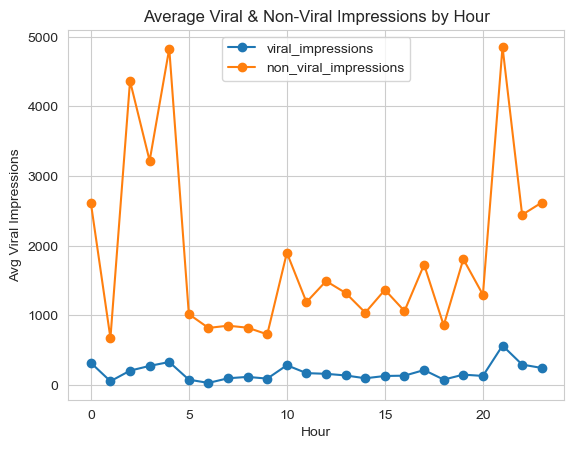

In [163]:
df.groupby(df.index.hour)[['viral_impressions', 'non_viral_impressions']].mean().reset_index().set_index('date').plot(
    xlabel='Hour', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Average Viral & Non-Viral Impressions by Hour',
    label=['viral_impressions', 'non_viral_impressions']
)
plt.show()

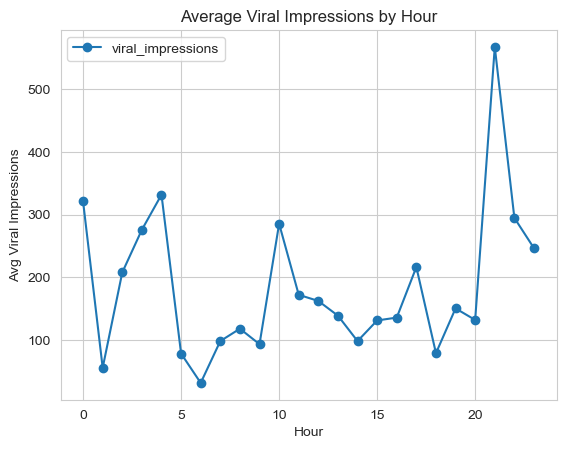

In [164]:
df.groupby(df.index.hour)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Hour', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Average Viral Impressions by Hour',
    label=['viral_impressions']
)
plt.show()

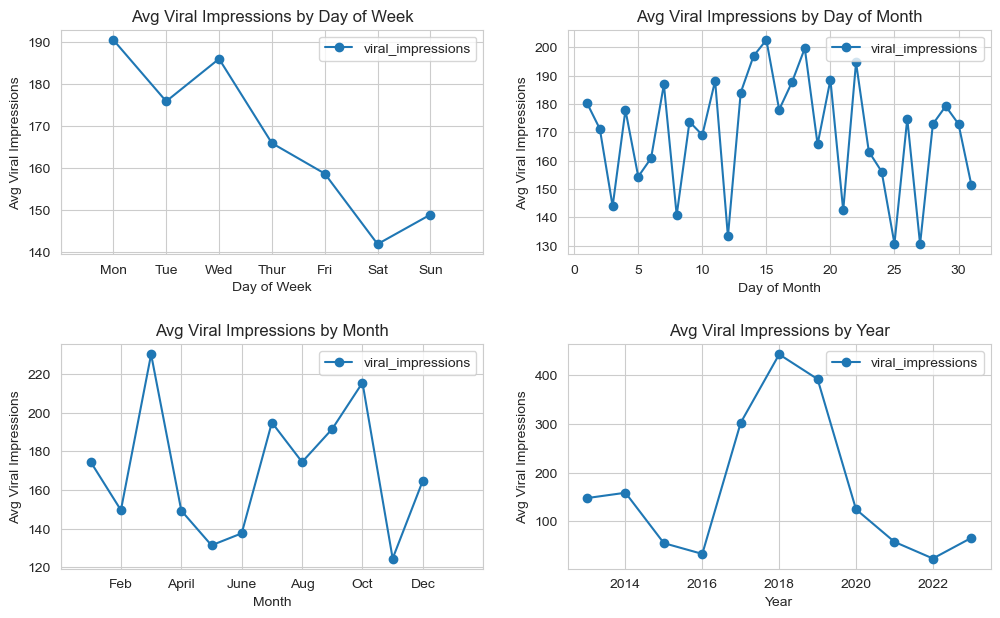

In [165]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Avg Viral Impressions by Day of Week',
    label=['viral_impressions'], ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Avg Viral Impressions by Day of Month',
    label=['viral_impressions'], ax=axes.ravel()[1]
)

df.groupby(df.index.month)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Avg Viral Impressions by Month',
    label=['viral_impressions'], ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.groupby(df.index.year)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Avg Viral Impressions by Year',
    label=['viral_impressions'], ax=axes.ravel()[3]
)
plt.show()

Which content and Posters were popular in 2018?:

<Axes: title={'center': 'Content Type During Peak Viral Year: 2018'}, ylabel='content_type'>

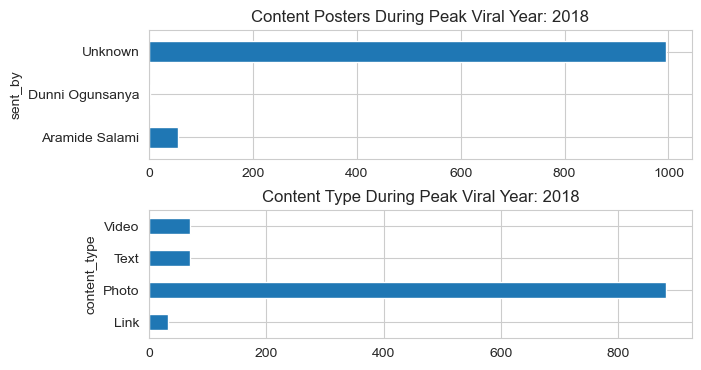

In [166]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.loc[(df.index.year == 2018) & (df.network=='Facebook')].groupby(by='sent_by').count().network.plot(
    kind='barh', title='Content Posters During Peak Viral Year: 2018',
    ax=axes[0]
)

df.loc[(df.index.year == 2018) & (df.network=='Facebook')].groupby(by='content_type').count().network.plot(
    kind='barh', title='Content Type During Peak Viral Year: 2018',
    ax=axes[1]
)

Which hastags dominated 2018?:

The Most popular tags are about the Higher Institutions Football League #HiFLStanbicIBTC. The client is clealry a major sponsor of the league.

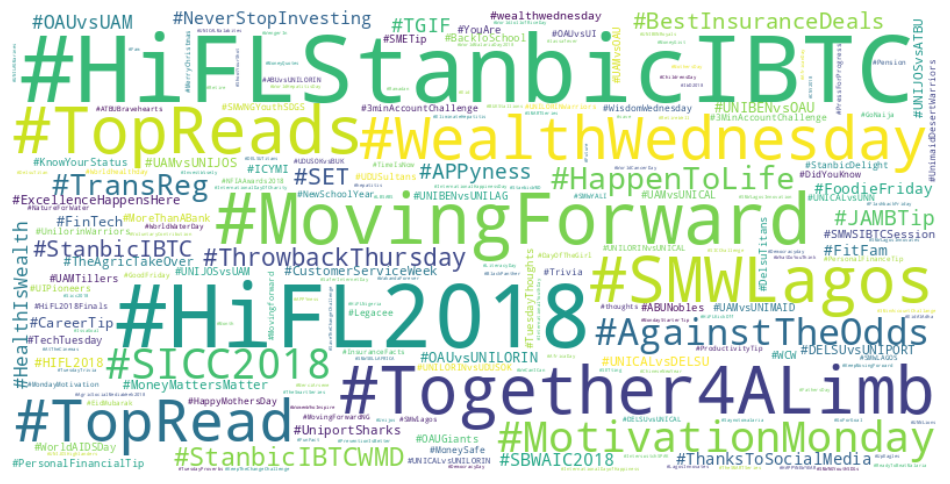

In [167]:
all_words = [word for sublist in df.loc[(df.index.year == 2018) & (df.network=='Facebook'), 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In 2018, which months & days experienced the most virality?:

Facebook posts made on Sundays in March 2018 have the most virality on average. 

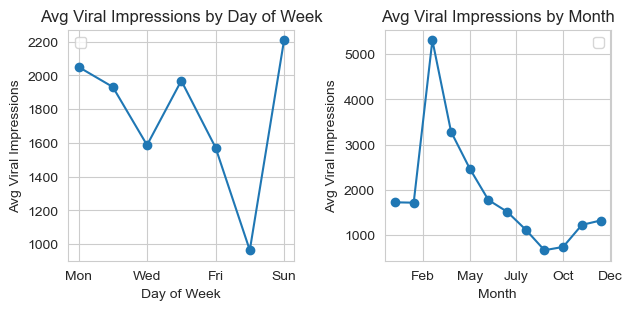

In [168]:
fig, axes = plt.subplots(1, 2, figsize=(7, 3))
fig.subplots_adjust(wspace=0.4)
sns.set_style("whitegrid")

df.loc[(df.index.year == 2018) & (df.network=='Facebook')].groupby(df.loc[(df.index.year == 2018) & (df.network=='Facebook')].index.dayofweek)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Avg Viral Impressions by Day of Week', label='',
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].legend('')
axes.ravel()[0].set_xticks(xticks[1:-1])
axes.ravel()[0].set_xticklabels(['Mon', 'Wed', 'Fri', 'Sun'])

df.loc[(df.index.year == 2018) & (df.network=='Facebook')].groupby(df.loc[(df.index.year == 2018) & (df.network=='Facebook')].index.month)['viral_impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Viral Impressions', linestyle='-', 
    marker='o', title='Avg Viral Impressions by Month', label='',
    ax=axes.ravel()[1]
)
xticks = axes.ravel()[1].get_xticks()
axes.ravel()[1].legend('')
axes.ravel()[1].set_xticks(xticks[1:-1])
axes.ravel()[1].set_xticklabels(['Feb', 'May', 'July', 'Oct', 'Dec'])

plt.show()

The days that fell on Sunday in March 2018 are 4, 11, 18, 25

In [169]:
days = [4, 11, 18, 25]
most_viral = df.loc[(df.network=='Facebook') & (df.index.year == 2018) & (df.index.month==3) & (df.index.day.isin(days))]

The most viral post from this period are 2 Mother's Day post of March 2018.

In [170]:
most_viral.iloc[0].post

'Here’s a  big thank you from us to every mother in our lives. We ❤️ you. #HappyMothersDay'

However, the most viral post is an EPL post from 17th Spetember 2019, with hashtag #Supersunday asking users to predict the winner in a match between Chelsea & Arsenal and stand a chance to win a NGN5,000 voucher:

In [171]:
df.loc[df.viral_impressions.idxmax()].post

"This EPL #Supersunday, it's the Blues against the Gunners. Predict and win 5k shopping voucher."

**General Metrics**

Deep Dive into Generally Tracked Metrics

General metrics are those tracked by at least 3 of the social media networks. We'll take a deep dive into those metrics.

We recall that impressions and engagement are tracked by all social media networks and reach is tracked by all but LinkedIn. This has implications in the distributions of derivative variables such as engagement_per_reach and engagment_per_impression.


In [172]:
gen_metrics = [
    'impressions', 'reach', 'engagements', 
    'engagement_rate_per_impression', 'engagement_rate_per_reach',
    'reactions', 'likes', 'comments', 'shares', 'post_link_clicks', 
    'post_clicks_all', 'video_views', 'organic_video_views',
    ]

df[gen_metrics].head()

,impressions,reach,engagements,engagement_rate_per_impression,engagement_rate_per_reach,reactions,likes,comments,shares,post_link_clicks,post_clicks_all,video_views,organic_video_views
date,,,,,,,,,,,,,
2013-01-15 16:25:00,5857.725177,5210.642078,231.683234,0.039552,0.044463,91.88699,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909
2013-01-16 16:51:00,5857.725177,5210.642078,231.683234,0.039552,0.044463,91.88699,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909
2013-01-16 16:58:00,5857.725177,5210.642078,231.683234,0.039552,0.044463,91.88699,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909
2013-01-17 17:08:00,5857.725177,5210.642078,231.683234,0.039552,0.044463,91.88699,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909
2013-02-01 13:24:00,5857.725177,5210.642078,231.683234,0.039552,0.044463,91.88699,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909


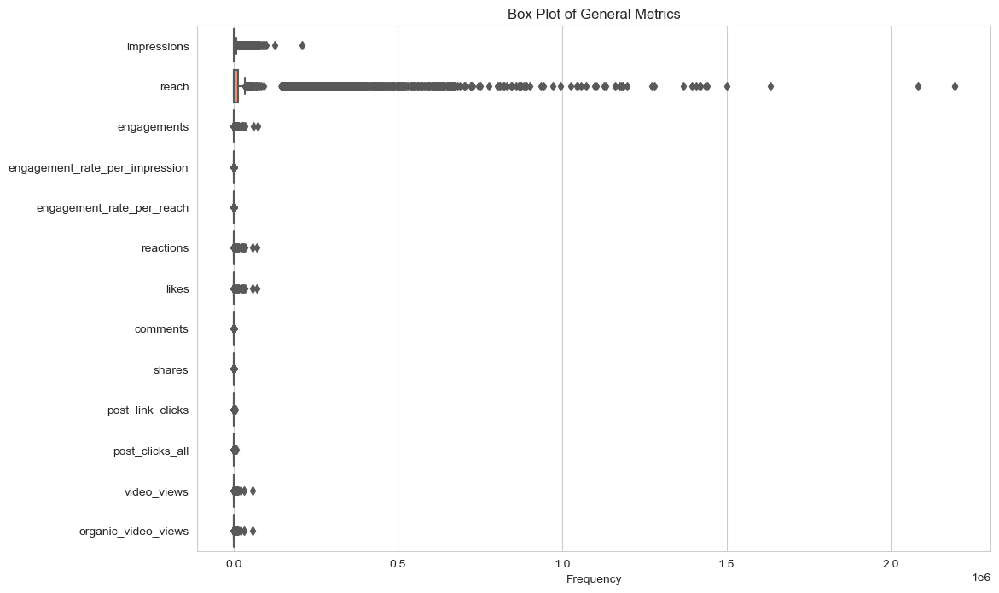

In [173]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[gen_metrics], orient="h", palette="Set2")
plt.title('Box Plot of General Metrics')
plt.xlabel('Frequency')

plt.show()

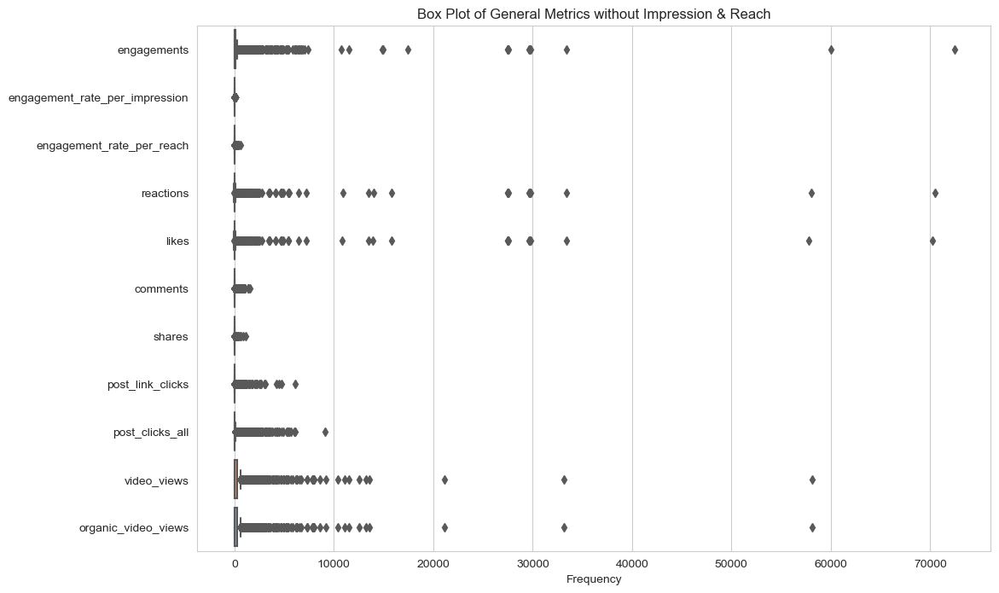

In [174]:
gen_metrics2 = gen_metrics.copy()
gen_metrics2.remove('reach')
gen_metrics2.remove('impressions')

plt.figure(figsize=(12, 8))
sns.boxplot(data=df[gen_metrics2], orient="h", palette="Set2")
plt.title('Box Plot of General Metrics without Impression & Reach')
plt.xlabel('Frequency')

plt.show()

What drives impression?

About 80% of impressions are organic. This may correspond to the fact that Twitter does not track organic impressions and Twitter's records corresponds to about 23% of the dataset.

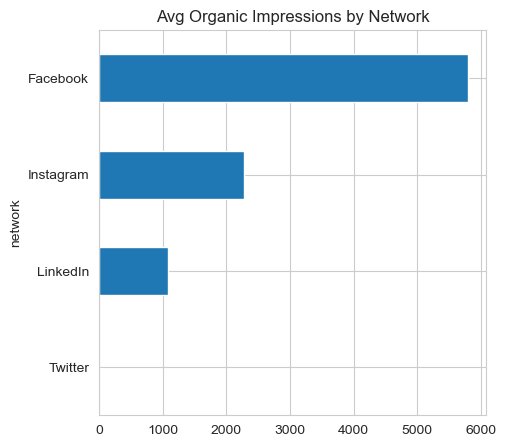

In [175]:
df.groupby(by='network').organic_impressions.mean().sort_values().plot.barh(
    figsize=(5,5), title='Avg Organic Impressions by Network')
plt.show()

Tracking Impressions by Period:

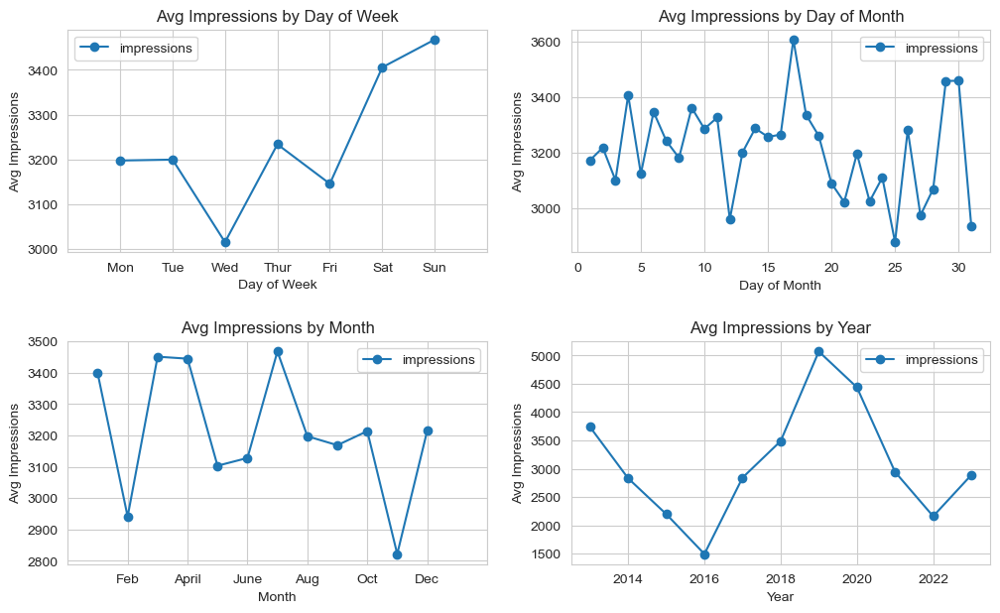

In [176]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)['impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Impressions', linestyle='-', 
    marker='o', title='Avg Impressions by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)['impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Impressions', linestyle='-', 
    marker='o', title='Avg Impressions by Day of Month',
    ax=axes.ravel()[1]
)

df.groupby(df.index.month)['impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Impressions', linestyle='-', 
    marker='o', title='Avg Impressions by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.groupby(df.index.year)['impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Impressions', linestyle='-', 
    marker='o', title='Avg Impressions by Year',
    ax=axes.ravel()[3]
)

plt.show()

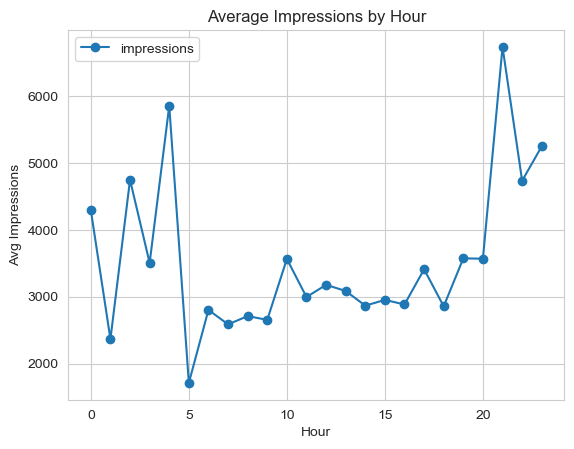

In [177]:
df.groupby(df.index.hour)['impressions'].mean().reset_index().set_index('date').plot(
    xlabel='Hour', ylabel='Avg Impressions', linestyle='-', 
    marker='o', title='Average Impressions by Hour'
)
plt.show()

The post with the most impressions is a video posted by  Damilare Oyekanmi on December 17, 2022, celebrating a Stanbic IBTC partner, Novare Mall, Lekki on their 6th anniversary, with hashtags #TrustedPartner, #ITCANBE

In [178]:
df.loc[df.impressions.idxmax()]

network                                                                    Facebook
content_type                                                                  Video
sent_by                                                           Damilare Oyekanmi
post                              We celebrated recently with Novare, one of our...
linked_content                    https://www.facebook.com/StanbicIBTC/videos/53...
                                                        ...                        
unique_organic_95%_video_views                                                 19.0
tags                                                                      CIB Posts
hashtags                                                [#TrustedPartner, #ITCANBE]
character_count                                                               143.0
word_count                                                                     22.0
Name: 2022-12-17 17:08:00, Length: 97, dtype: object

This is an outlier value. On average, the highest impressions come on Sundays in March, April and July 2019.

In [179]:
days = [3, 7, 10, 14, 17, 21, 24, 28, 31]
months = [3, 4, 7]
most_imp = df.loc[(df.index.year == 2019) & (df.index.month.isin(months)) & (df.index.day.isin(days))]

<Axes: xlabel='date'>

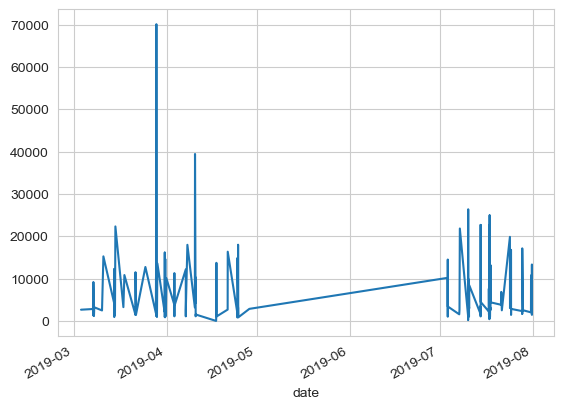

In [180]:
most_imp.impressions.plot()

The highest point is actually in April, a post from April 7th 2019 on Facebook, including a photo, with no hashtags and no tags, about a call to action for users to partner with the bank to grow their business, including a phone number & email for users to reach to initiate this business relationship.

In [181]:
days = [7, 14, 21, 28]
months = [4]
most_imp = df.loc[(df.index.year == 2019) & (df.index.month.isin(months)) & (df.index.day.isin(days))]

most_imp.loc[most_imp.impressions.idxmax()]

network                                                                    Facebook
content_type                                                                  Photo
sent_by                                                                     Unknown
post                              Let’s be your partner to help grow your busine...
linked_content                    https://www.facebook.com/StanbicIBTC/photos/a....
                                                        ...                        
unique_organic_95%_video_views                                            44.705502
tags                                                                        no tags
hashtags                                                                         []
character_count                                                               154.0
word_count                                                                     23.0
Name: 2019-04-07 21:01:00, Length: 97, dtype: object

Impressions by Character & Word Count

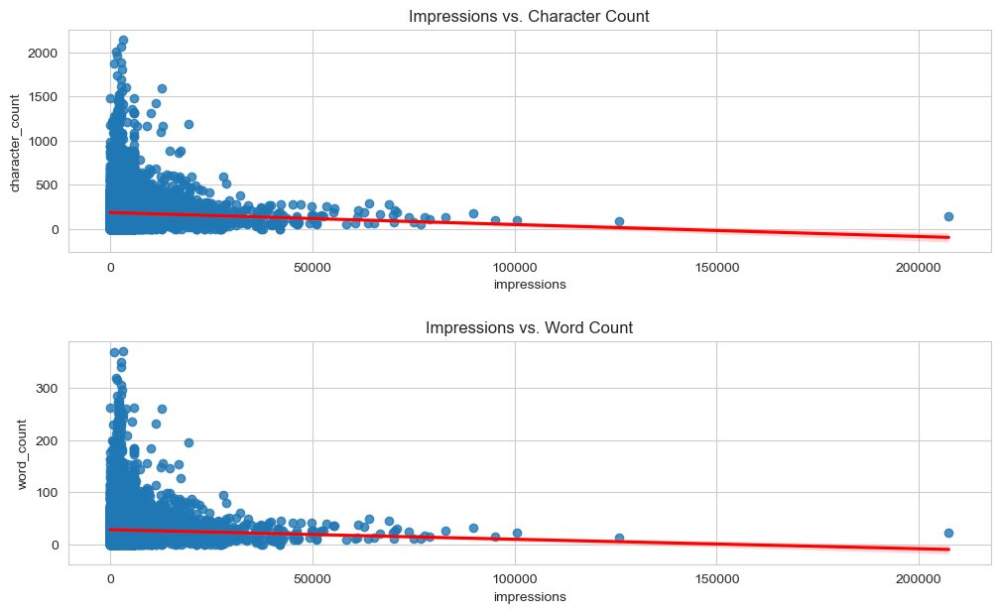

In [182]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

sns.regplot(x='impressions', y='character_count', data=df, line_kws=dict(color="r"), ax=axes[0])
axes[0].set_title('Impressions vs. Character Count')
sns.regplot(x='impressions', y='word_count', data=df, line_kws=dict(color="r"), ax=axes[1])
axes[1].set_title('Impressions vs. Word Count')
plt.show()

Which content type & poster dominated 2019?

<Axes: title={'center': 'Content Type During Peak Impressions Year: 2019'}, ylabel='content_type'>

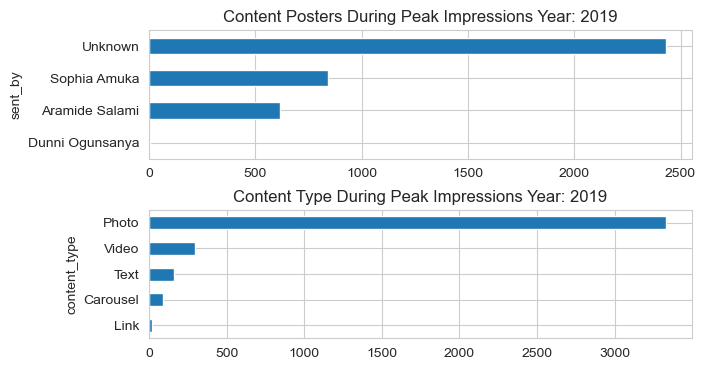

In [183]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.loc[df.index.year == 2019].groupby(by='sent_by').count().network.sort_values().plot(
    kind='barh', title='Content Posters During Peak Impressions Year: 2019',
    ax=axes[0]
)

df.loc[df.index.year == 2019].groupby(by='content_type').count().network.sort_values().plot(
    kind='barh', title='Content Type During Peak Impressions Year: 2019',
    ax=axes[1]
)

Which Hastags Domminated 2019?

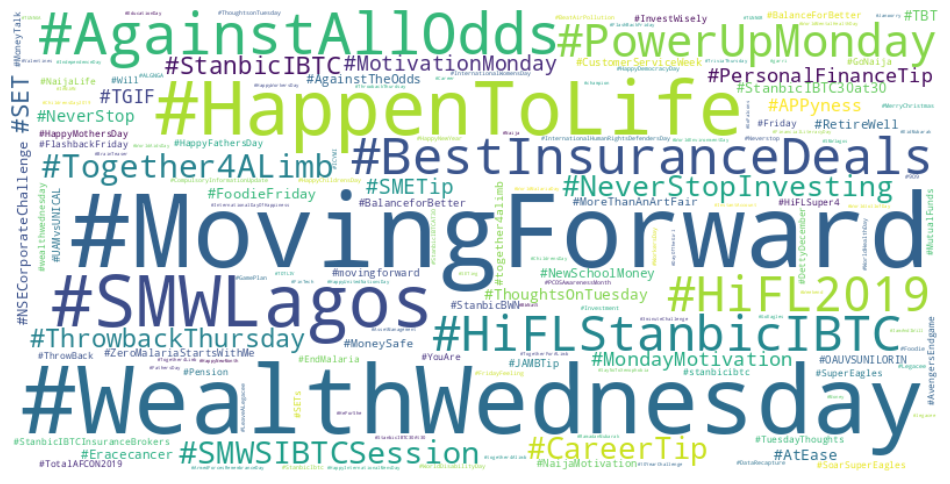

In [184]:
all_words = [word for sublist in df.loc[df.index.year == 2019, 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

What is the relationshiip between Impressions & Reach?

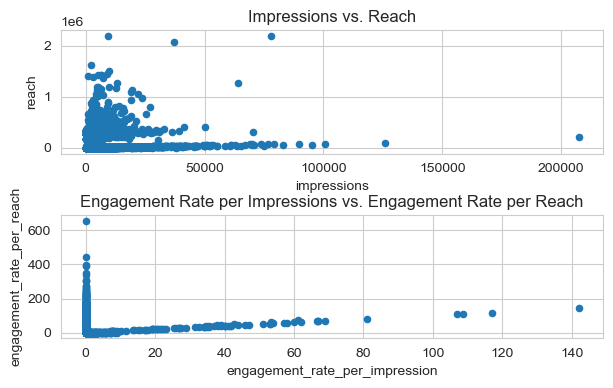

In [185]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.5)
sns.set_style("whitegrid")

df.plot(
    kind='scatter', x='impressions', y='reach',
    title='Impressions vs. Reach', ax=axes.ravel()[0]
)
df.plot(
    kind='scatter', x='engagement_rate_per_impression', 
    y='engagement_rate_per_reach', 
    title='Engagement Rate per Impressions vs. Engagement Rate per Reach', 
    ax=axes.ravel()[1]
)

plt.show()

Trends in Engagements vs Impression vs Reach:

`Reach` refers to the total number of unique users or accounts who have seen a particular piece of content posted on a social media platform. It is a metric used to gauge how far a piece of content has spread and how many people have been exposed to it. 

Reach is often used in conjunction with other metrics like engagement (likes, comments, shares) to assess the effectiveness of a social media marketing campaign or the popularity of a specific post.

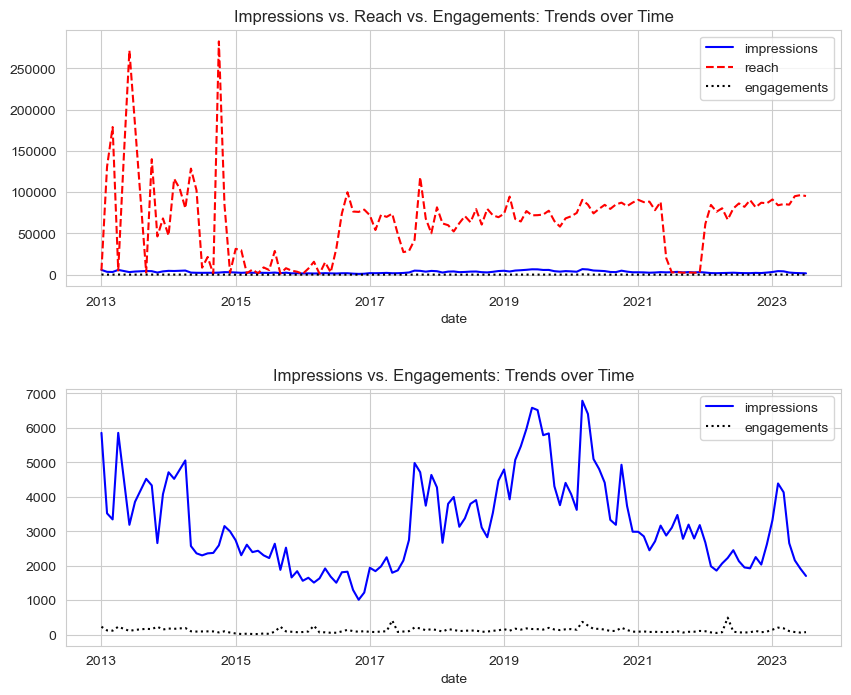

In [186]:
fig, axes = plt.subplots(2, 1, figsize=(10, 8))
fig.subplots_adjust(hspace=0.4)
sns.set_style("whitegrid")

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['impressions', 'reach', 'engagements'],
    style=['-b', '--r', ':k'],
    title='Impressions vs. Reach vs. Engagements: Trends over Time',
    ax=axes[0]
).autoscale()

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['impressions', 'engagements'],
    style=['-b', ':k'],
    title='Impressions vs. Engagements: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

Reach vs. Engagement:

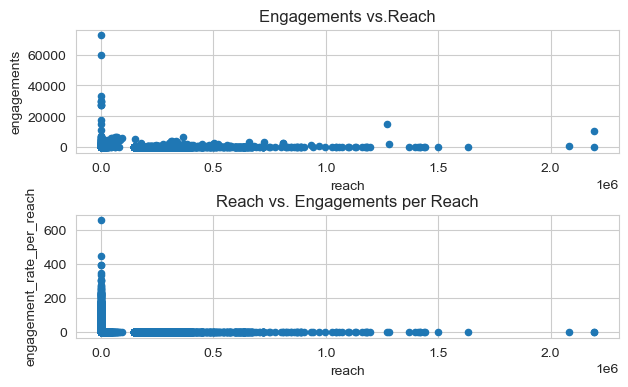

In [187]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.5)
sns.set_style("whitegrid")

df.plot(
    kind='scatter', x='reach', y='engagements', 
    title='Engagements vs.Reach', ax=axes.ravel()[0]
)

df.plot(
    kind='scatter', x='reach', y='engagement_rate_per_reach', 
    title='Reach vs. Engagements per Reach', ax=axes.ravel()[1]
)

plt.show()

Engagement, Impressions & Reach Spread by Network:

When classified according to networks, the widest reaches come from Twitter, which, from above, track `potential reach`, which may reflect different methods of calculating reach across social networks. Facebook reach is comparatively small but the relationship to impression is clearly linear.

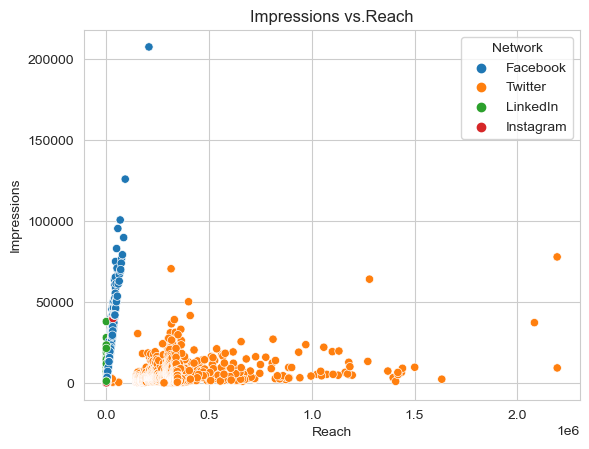

In [188]:
sns.scatterplot(data=df, x='reach', y='impressions', hue='network')

plt.xlabel('Reach')
plt.ylabel('Impressions')
plt.legend(title='Network')
plt.title('Impressions vs.Reach')

plt.show()

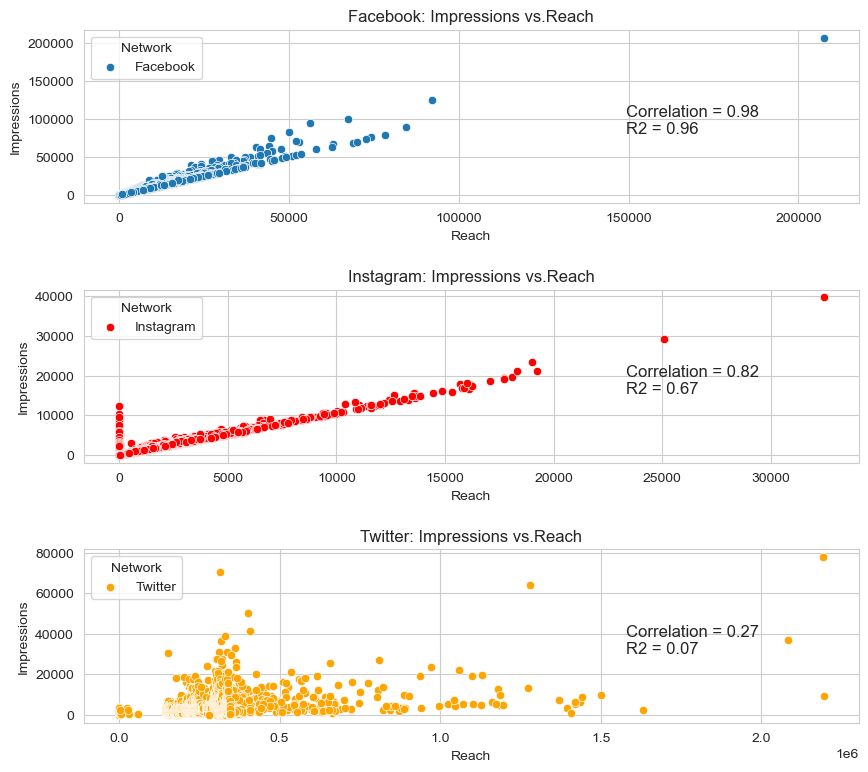

In [189]:
fig, axes = plt.subplots(3, 1, figsize=(10, 9))
fig.subplots_adjust(hspace=0.5)
sns.set_style("whitegrid")

sns.scatterplot(data=df.loc[df.network=='Facebook'], x='reach', 
                y='impressions', ax=axes[0], label='Facebook')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Facebook"').reach, df.query('network=="Facebook"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes[0].annotate(
    f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=12)
axes[0].annotate(
    f'Correlation = {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_xlabel('Reach')
axes[0].set_ylabel('Impressions')
axes[0].legend(title='Network')
axes[0].set_title('Facebook: Impressions vs.Reach')

sns.scatterplot(data=df.loc[df.network=='Instagram'], x='reach', 
                y='impressions', ax=axes[1], color='red', 
                label='Instagram')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Instagram"').reach, df.query('network=="Instagram"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes[1].annotate(
    f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=12)
axes[1].annotate(
    f'Correlation = {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[1].set_xlabel('Reach')
axes[1].set_ylabel('Impressions')
axes[1].legend(title='Network')
axes[1].set_title('Instagram: Impressions vs.Reach')

sns.scatterplot(data=df.loc[df.network=='Twitter'], x='reach', 
                y='impressions', ax=axes[2], color='orange', 
                label='Twitter')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Twitter"').reach, df.query('network=="Twitter"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes[2].annotate(
    f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=12)
axes[2].annotate(
    f'Correlation = {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[2].set_xlabel('Reach')
axes[2].set_ylabel('Impressions')
axes[2].legend(title='Network')
axes[2].set_title('Twitter: Impressions vs.Reach')

plt.show()

Correlation between impressions and reach is linear and significant for Facebbok and Instagram. However, the general pearson correlation is low because it is weighted by the outliers from Twitter, where the pearson correlation of both variables is low. This is because Twitter's reach values are significantly larger than Facebook's and Instagram's. Using Spearman correlation will provide a much more accurate correlation analysis of these variables.

Impression & Reach vs. Engagement

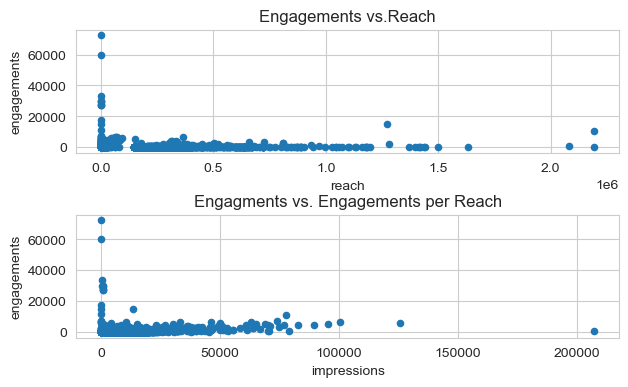

In [190]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.5)
sns.set_style("whitegrid")

df.plot(
    kind='scatter', x='reach', y='engagements', 
    title='Engagements vs.Reach', ax=axes.ravel()[0]
)

df.plot(
    kind='scatter', x='impressions', y='engagements', 
    title='Engagments vs. Engagements per Reach', ax=axes.ravel()[1]
)

plt.show()

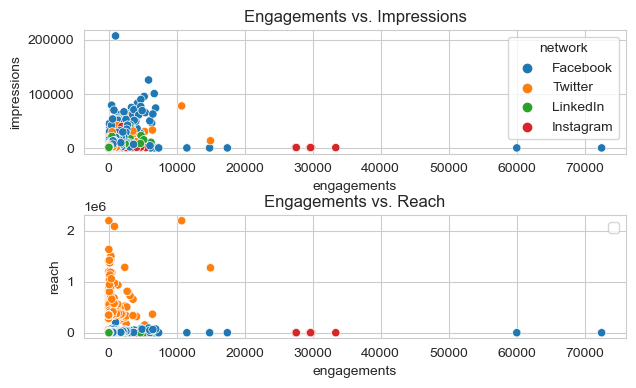

In [191]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.5)
sns.set_style("whitegrid")

sns.scatterplot(data=df, x='engagements', y='impressions', hue='network',
                ax=axes[0])
axes[0].set_title('Engagements vs. Impressions')

sns.scatterplot(data=df, x='engagements', y='reach', hue='network',
                ax=axes[1])
axes[1].set_title('Engagements vs. Reach')
axes[1].legend('')

plt.show()

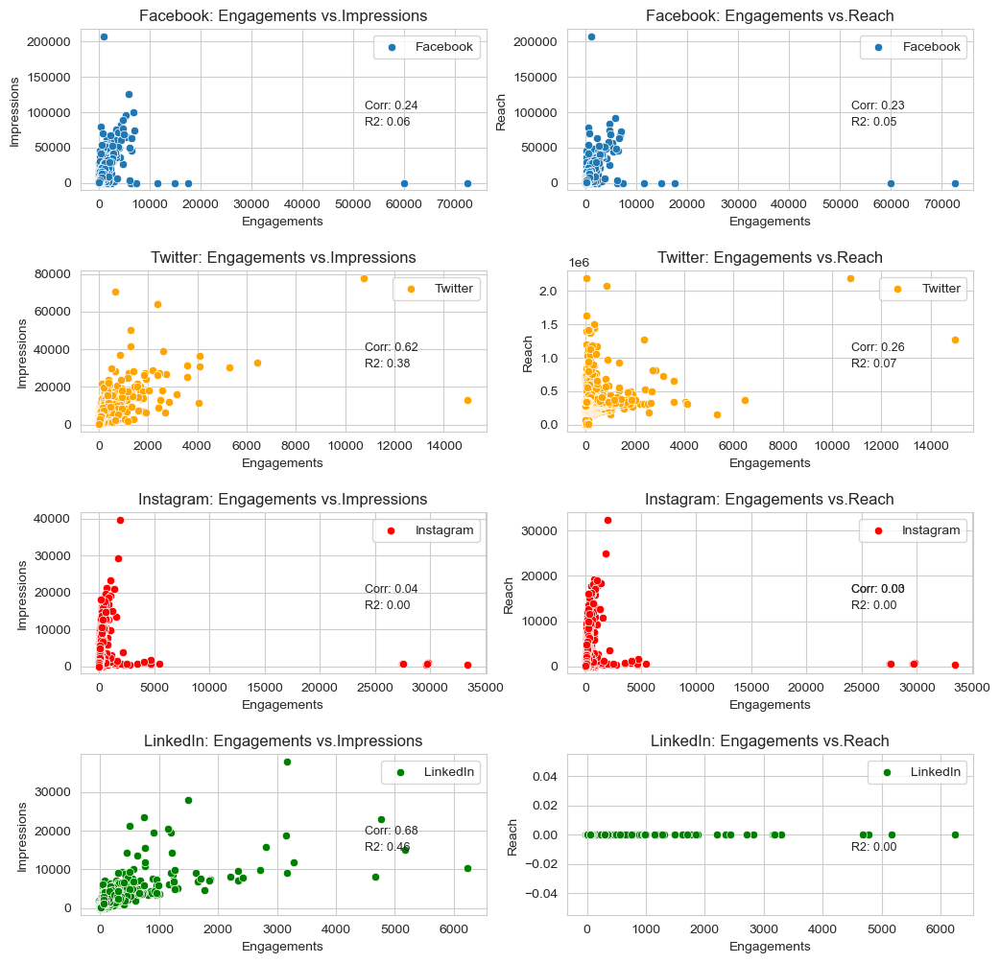

In [192]:
fig, axes = plt.subplots(4, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.5, wspace=0.2)
sns.set_style("whitegrid")

# Facebook
sns.scatterplot(data=df.loc[df.network=='Facebook'], x='engagements', 
                y='impressions', ax=axes.ravel()[0], label='Facebook')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Facebook"').engagements, 
    df.query('network=="Facebook"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[0].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[0].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[0].set_xlabel('Engagements')
axes.ravel()[0].set_ylabel('Impressions')
axes.ravel()[0].set_title('Facebook: Engagements vs.Impressions')

sns.scatterplot(data=df.loc[df.network=='Facebook'], x='engagements', 
                y='reach', ax=axes.ravel()[1], label='Facebook')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Facebook"').engagements, 
    df.query('network=="Facebook"').reach
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[1].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[1].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[1].set_xlabel('Engagements')
axes.ravel()[1].set_ylabel('Reach')
axes.ravel()[1].set_title('Facebook: Engagements vs.Reach')

# Twitter
sns.scatterplot(data=df.loc[df.network=='Twitter'], x='engagements', 
                y='impressions', ax=axes.ravel()[2], label='Twitter',
                color='orange')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Twitter"').engagements, 
    df.query('network=="Twitter"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[2].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[2].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[2].set_xlabel('Engagements')
axes.ravel()[2].set_ylabel('Impressions')
axes.ravel()[2].set_title('Twitter: Engagements vs.Impressions')

sns.scatterplot(data=df.loc[df.network=='Twitter'], x='engagements', 
                y='reach', ax=axes.ravel()[3], label='Twitter',
                color='orange')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Twitter"').engagements, 
    df.query('network=="Twitter"').reach
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[3].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[3].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[3].set_xlabel('Engagements')
axes.ravel()[3].set_ylabel('Reach')
axes.ravel()[3].set_title('Twitter: Engagements vs.Reach')

# Instagram
sns.scatterplot(data=df.loc[df.network=='Instagram'], x='engagements', 
                y='impressions', ax=axes.ravel()[4], label='Instagram',
                color='red')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Instagram"').engagements, 
    df.query('network=="Instagram"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[4].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[4].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[4].set_xlabel('Engagements')
axes.ravel()[4].set_ylabel('Impressions')
axes.ravel()[4].set_title('Instagram: Engagements vs.Impressions')

sns.scatterplot(data=df.loc[df.network=='Instagram'], x='engagements', 
                y='reach', ax=axes.ravel()[5], label='Instagram',
                color='red')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="Instagram"').engagements, 
    df.query('network=="Instagram"').reach
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[5].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[5].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[5].set_xlabel('Engagements')
axes.ravel()[5].set_ylabel('Reach')
axes.ravel()[5].set_title('Instagram: Engagements vs.Reach')

# LinkedIn
sns.scatterplot(data=df.loc[df.network=='LinkedIn'], x='engagements', 
                y='impressions', ax=axes.ravel()[6], label='LinkedIn',
                color='green')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="LinkedIn"').engagements, 
    df.query('network=="LinkedIn"').impressions
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[6].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[6].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[6].set_xlabel('Engagements')
axes.ravel()[6].set_ylabel('Impressions')
axes.ravel()[6].set_title('LinkedIn: Engagements vs.Impressions')

sns.scatterplot(data=df.loc[df.network=='LinkedIn'], x='engagements', 
                y='reach', ax=axes.ravel()[7], label='LinkedIn',
                color='green')
slope, intercept, r_value, p_value, std_err = stats.linregress(
    df.query('network=="LinkedIn"').engagements, 
    df.query('network=="LinkedIn"').reach
    )
r_squared = r_value**2
correlation_coefficient = r_value
axes.ravel()[7].annotate(
    f'R2: {r_squared:.2f}', xy=(0.7, 0.4), 
    xycoords='axes fraction', fontsize=9)
axes.ravel()[5].annotate(
    f'Corr: {correlation_coefficient:.2f}',
    xy=(0.7, 0.5), xycoords='axes fraction', fontsize=9)
axes.ravel()[7].set_xlabel('Engagements')
axes.ravel()[7].set_ylabel('Reach')
axes.ravel()[7].set_title('LinkedIn: Engagements vs.Reach')


plt.show()

Correlation between Reach, Impression & Engagements Metrics

Pearson Correlation:

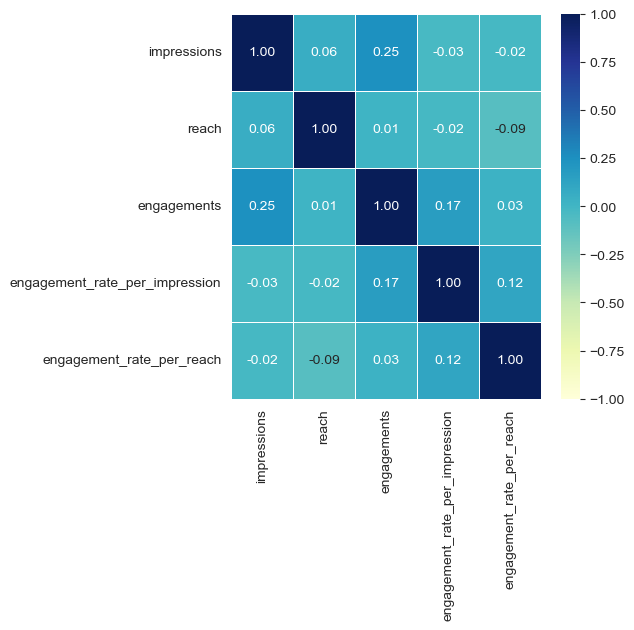

In [193]:
plt.figure(figsize=(5, 5))
sns.heatmap(
    df[['impressions', 'reach', 'engagements', 
        'engagement_rate_per_impression', 
        'engagement_rate_per_reach']].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Spearman Correlation:

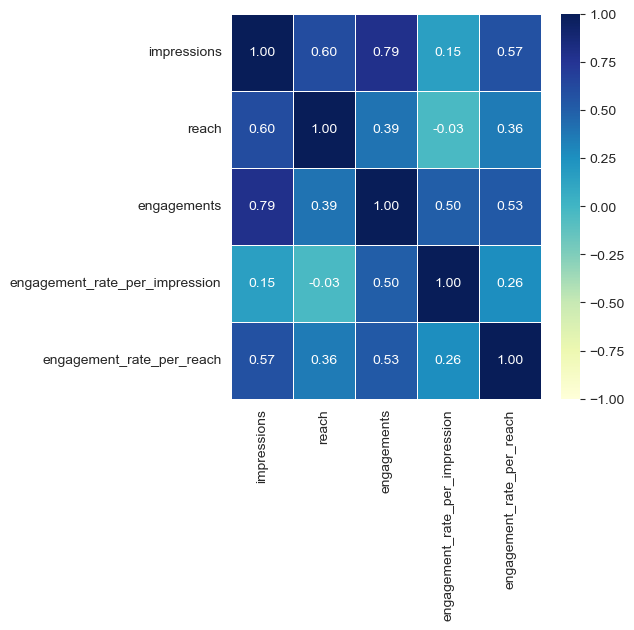

In [194]:
plt.figure(figsize=(5, 5))
sns.heatmap(
    df[['impressions', 'reach', 'engagements', 
        'engagement_rate_per_impression', 
        'engagement_rate_per_reach']].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

From our correlation analysis, we find that the relationship between the variables is not linear. However, rank-based relationships exist. 

Probability Plot:

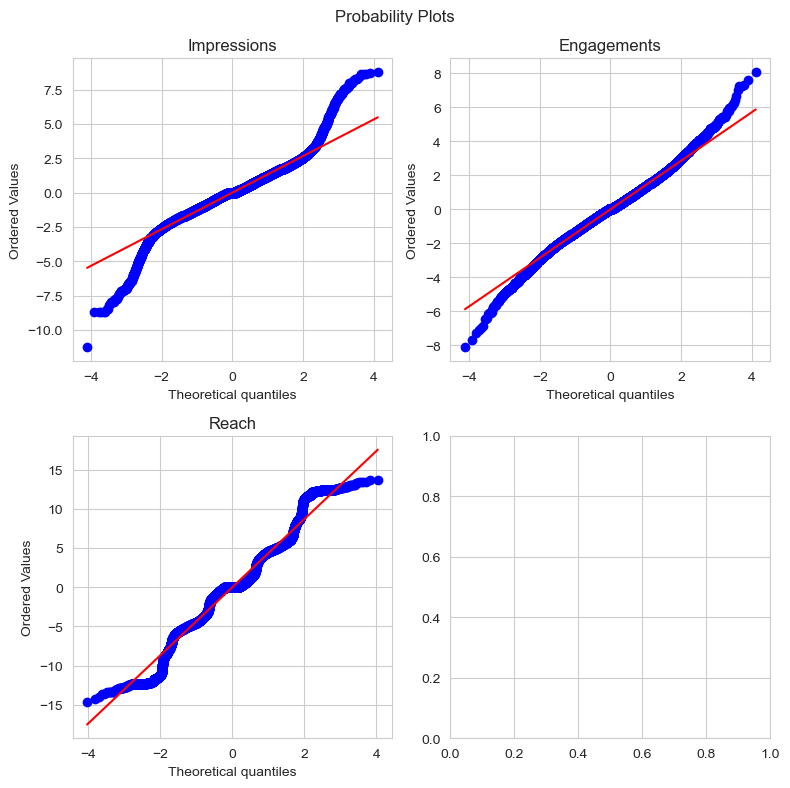

In [195]:
imp = df.impressions
imp = np.diff(np.log(imp[imp > 0]))

eng = df.engagements
eng = np.diff(np.log(eng[eng > 0]))

rch = df.reach
rch = np.diff(np.log(rch[rch > 0]))

fig, axes = plt.subplots(2, 2, figsize=(8, 8))
for ax, i, name in zip(axes.ravel(), [imp, eng, rch], ['Impressions', 'Engagements', 'Reach']):
    stats.probplot(i, plot=ax)
    ax.set_title(name)

plt.suptitle('Probability Plots')
plt.tight_layout()
plt.show()

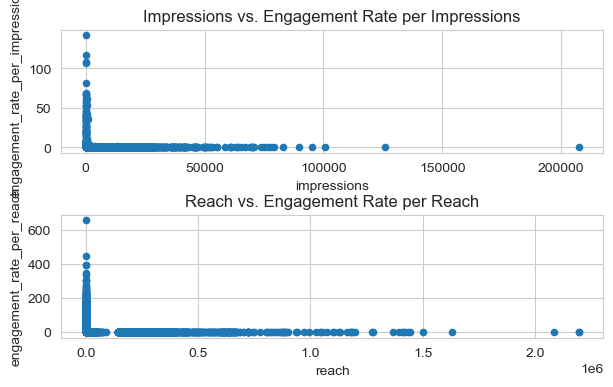

In [196]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.5)
sns.set_style("whitegrid")

df.plot(
    kind='scatter', x='impressions', y='engagement_rate_per_impression',
    title='Impressions vs. Engagement Rate per Impressions', ax=axes.ravel()[0]
)
df.plot(
    kind='scatter', x='reach', 
    y='engagement_rate_per_reach', 
    title='Reach vs. Engagement Rate per Reach', 
    ax=axes.ravel()[1]
)

plt.show()

Which Posters & Content Type correspond to Impressions Outliers?

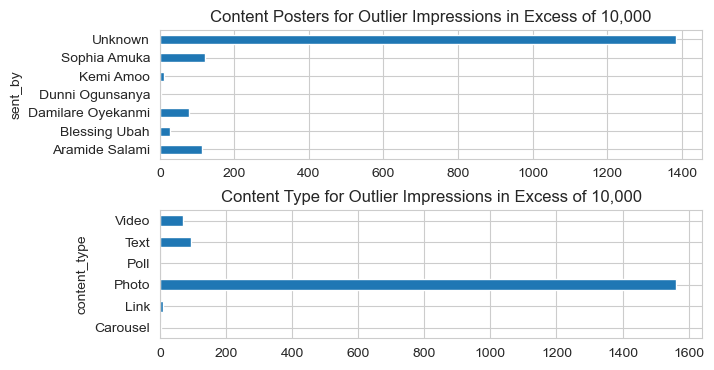

In [197]:
fig, axes = plt.subplots(2, 1, figsize=(7, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.loc[df.impressions.gt(10000)].groupby(by='sent_by').network.count().plot.barh(
    title='Content Posters for Outlier Impressions in Excess of 10,000',
    ax=axes.ravel()[0]
)

df.loc[df.impressions.gt(10000)].groupby(by='content_type').network.count().plot.barh(
    title='Content Type for Outlier Impressions in Excess of 10,000',
    ax=axes.ravel()[1]
)

plt.show()

Reactions, Likes, Comments & Shares:

From above, we know that reactions, likes and comments are tracked by all social media networks, while shares is tracked by all except Instagram. Let's confirm this by analyzing the means of each feature filtered by network:

In [198]:
print('Reactions')
print('Facebook Reactions Avg: ', df.query('network=="Facebook"').reactions.mean())
print('Twitter Reactions Avg: ', df.query('network=="Twitter"').reactions.mean())
print('LinkedIn Reactions Avg: ', df.query('network=="LinkedIn"').reactions.mean())
print('Instagram Reactions Avg: ', df.query('network=="Instagram"').reactions.mean())

print('\nLikes')
print('Facebook Likes Avg: ', df.query('network=="Facebook"').likes.mean())
print('Twitter Likes Avg: ', df.query('network=="Twitter"').likes.mean())
print('LinkedIn Likes Avg: ', df.query('network=="LinkedIn"').likes.mean())
print('Instagram Likes Avg: ', df.query('network=="Instagram"').likes.mean())

print('\nComments')
print('Facebook Comments Avg: ', df.query('network=="Facebook"').comments.mean())
print('Twitter Comments Avg: ', df.query('network=="Twitter"').comments.mean())
print('LinkedIn Comments Avg: ', df.query('network=="LinkedIn"').comments.mean())
print('Instagram Comments Avg: ', df.query('network=="Instagram"').comments.mean())

print('\nShares')
print('Facebook Shares Avg: ', df.query('network=="Facebook"').shares.mean())
print('Twitter Shares Avg: ', df.query('network=="Twitter"').shares.mean())
print('LinkedIn Shares Avg: ', df.query('network=="LinkedIn"').shares.mean())
print('Instagram Shares Avg: ', df.query('network=="Instagram"').shares.mean())


Reactions
Facebook Reactions Avg:  91.88698976723266
Twitter Reactions Avg:  20.21015047181841
LinkedIn Reactions Avg:  15.752684775742262
Instagram Reactions Avg:  90.8868

Likes
Facebook Likes Avg:  89.1085123130552
Twitter Likes Avg:  20.21015047181841
LinkedIn Likes Avg:  15.752684775742262
Instagram Likes Avg:  90.8868

Comments
Facebook Comments Avg:  20.538738333520744
Twitter Comments Avg:  6.244963019637848
LinkedIn Comments Avg:  1.1528742893240682
Instagram Comments Avg:  7.831

Shares
Facebook Shares Avg:  8.381311143596088
Twitter Shares Avg:  8.317393522060698
LinkedIn Shares Avg:  1.4074542008843967
Instagram Shares Avg:  0.0


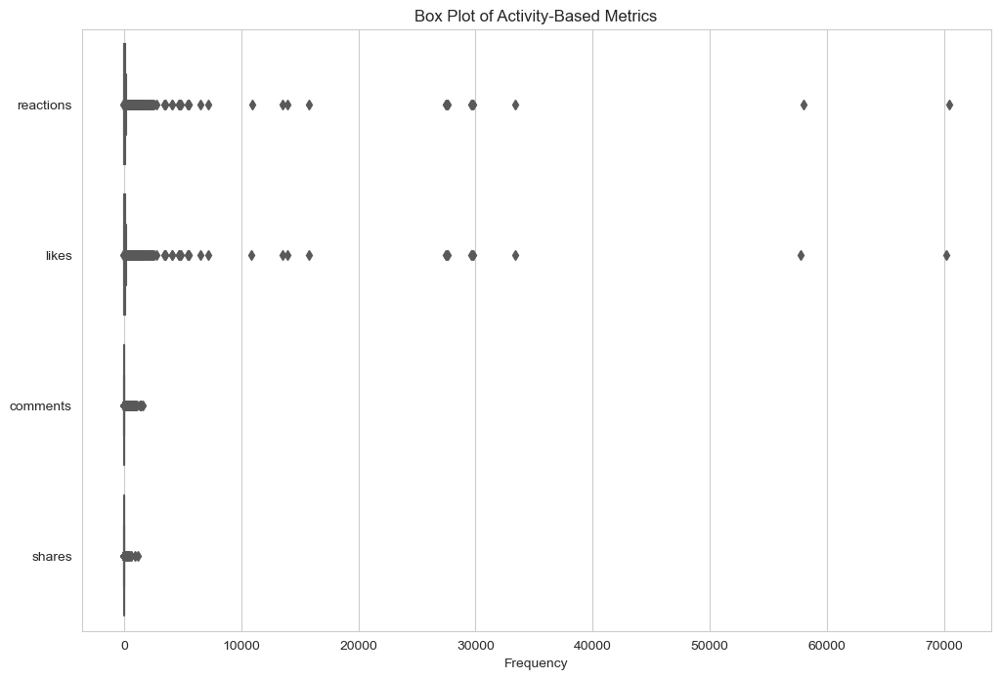

In [199]:
gen_act = ['reactions', 'likes', 'comments', 'shares']
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[gen_act], orient="h", palette="Set2")
plt.title('Box Plot of Activity-Based Metrics')
plt.xlabel('Frequency')

plt.show()

Relationships between the variables

<function matplotlib.pyplot.show(close=None, block=None)>

<Figure size 700x700 with 0 Axes>

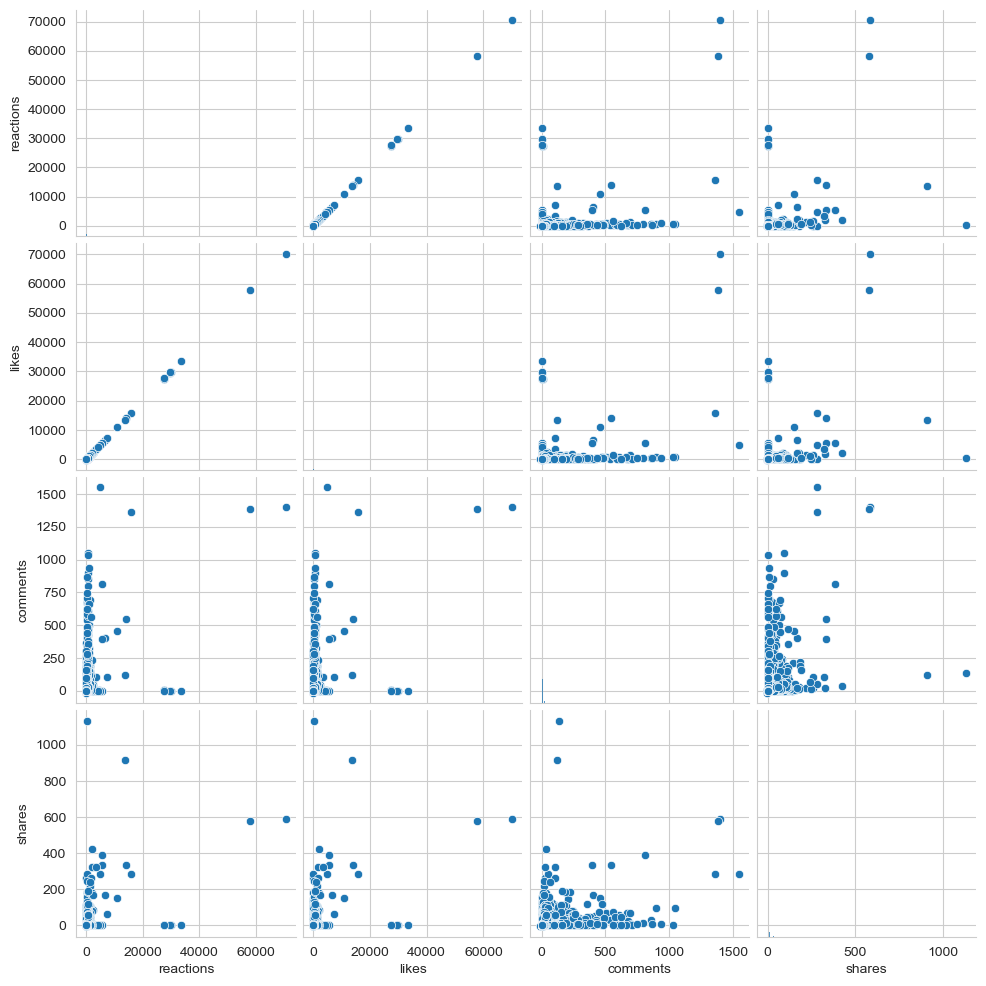

In [200]:
plt.figure(figsize=(7, 7))
sns.pairplot(df[gen_act])
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

<Figure size 700x700 with 0 Axes>

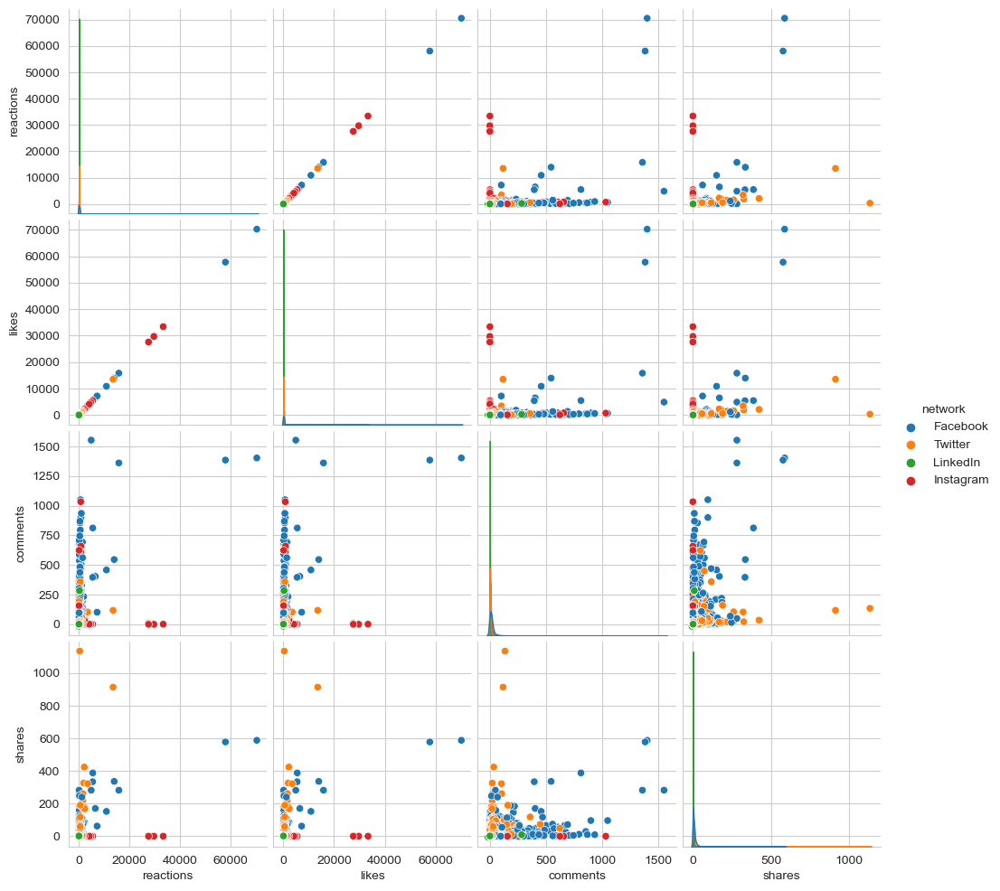

In [201]:
plt.figure(figsize=(7, 7))
sns.pairplot(df[gen_act + ['network']], hue='network')
plt.show

Relations when Outliers are Removed:

<function matplotlib.pyplot.show(close=None, block=None)>

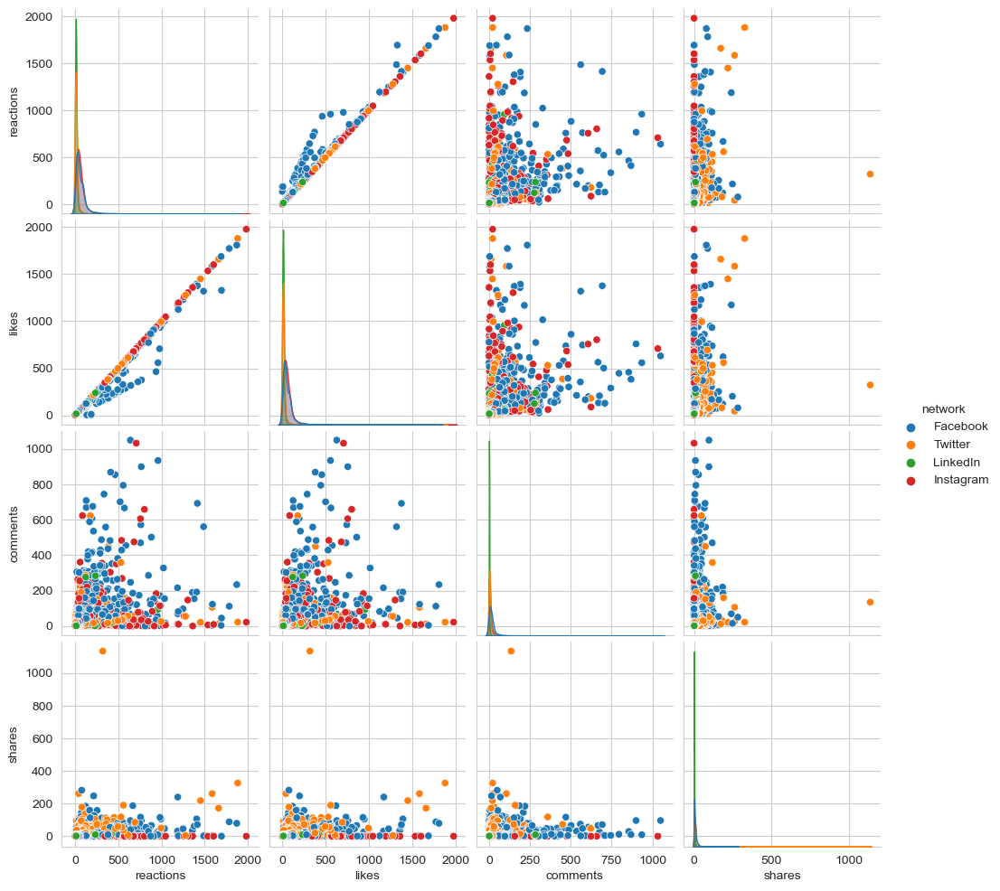

In [202]:
sns.pairplot(df.query('reactions > 0 & reactions <= 2000')[gen_act + ['network']], hue='network')
plt.show

Trends in Activity Metrics:

Reactions Trends:

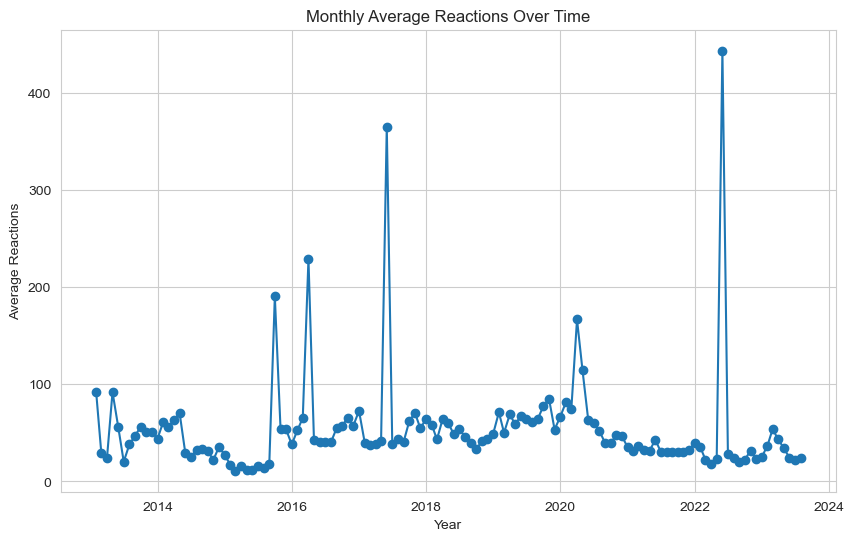

In [203]:
sns.set_style("whitegrid")
monthly_mean = df.reactions.resample('M').mean().interpolate()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Reactions')
plt.title('Monthly Average Reactions Over Time')
plt.show()

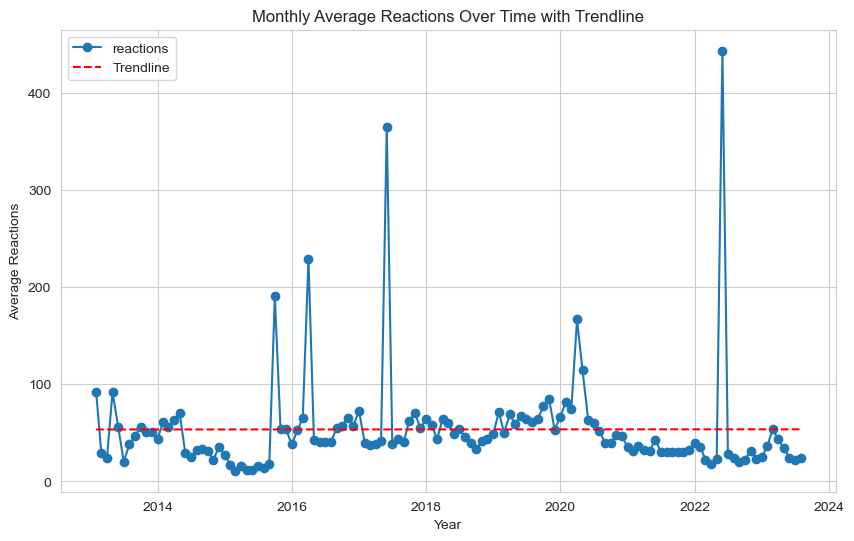

In [204]:
sns.set_style("whitegrid")
monthly_mean = df.reactions.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='reactions')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Reactions')
plt.title('Monthly Average Reactions Over Time with Trendline')
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


Reactions on average stay below 100 throughout the dataset. However a few significant outliers exist, with the period for highest average reactions occurring in early 2022. 

When we segment by networks, we find that reactions differ depending on the network. Facebook has the highest reactions followed by Instagram. LinkedIn reactions are flat with little variations near the 0 line. Twitter reactions are also flat, but there is a small peak in 2020.

We'll analyze these reactions further:

Reactions Trends by Network:

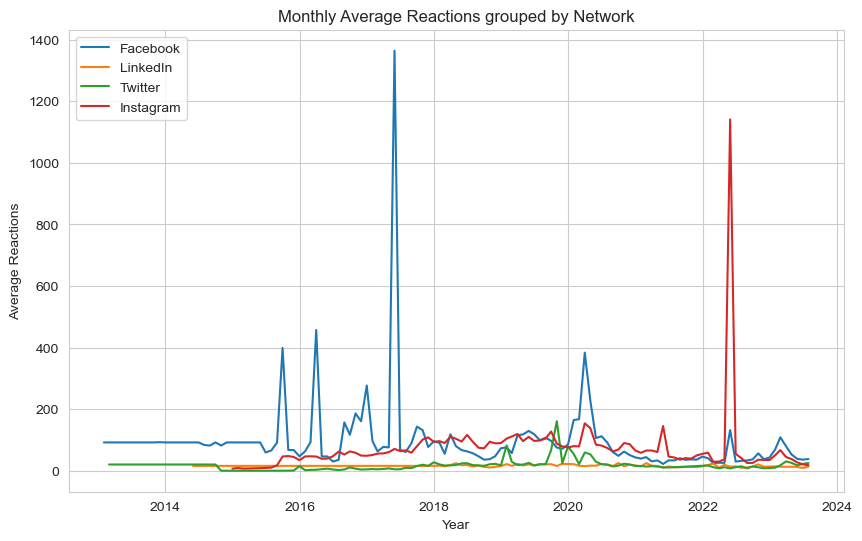

In [205]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'reactions'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'reactions'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'reactions'].resample('M').mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'reactions'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Year')
plt.ylabel('Average Reactions')
plt.title('Monthly Average Reactions grouped by Network')
plt.legend()
plt.show()

Reactions Trends by Period:

On average, the best days for reactions are Friday and Saturday. Reactions are also at the highest for posts that occur at the end of the month. The best month for reactions is May and reactions peaked in the year 2017. 

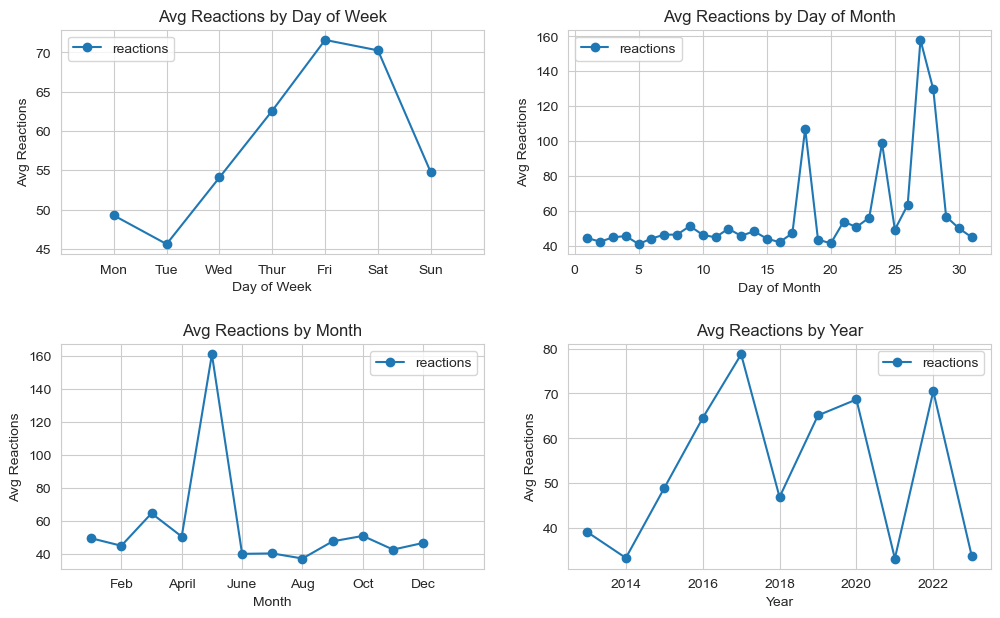

In [206]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)['reactions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Reactions', linestyle='-', 
    marker='o', title='Avg Reactions by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)['reactions'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Reactions', linestyle='-', 
    marker='o', title='Avg Reactions by Day of Month',
    ax=axes.ravel()[1]
)

df.groupby(df.index.month)['reactions'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Reactions', linestyle='-', 
    marker='o', title='Avg Reactions by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.groupby(df.index.year)['reactions'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Reactions', linestyle='-', 
    marker='o', title='Avg Reactions by Year',
    ax=axes.ravel()[3]
)

plt.show()

Like Trends:

Likes trend is similar to reactions. When we examine correlation, we find a near perfect linear relationship:

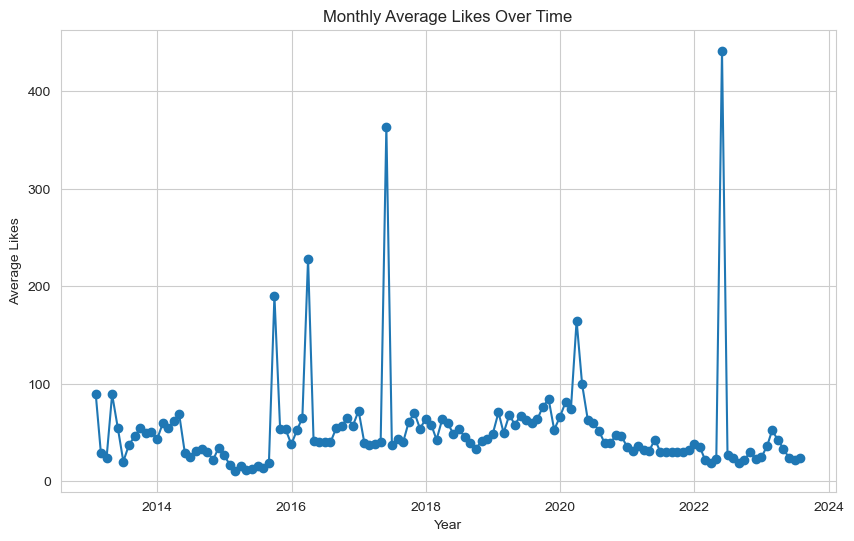

In [207]:
sns.set_style("whitegrid")
monthly_mean = df.likes.resample('M').mean().interpolate()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Likes')
plt.title('Monthly Average Likes Over Time')
plt.show()

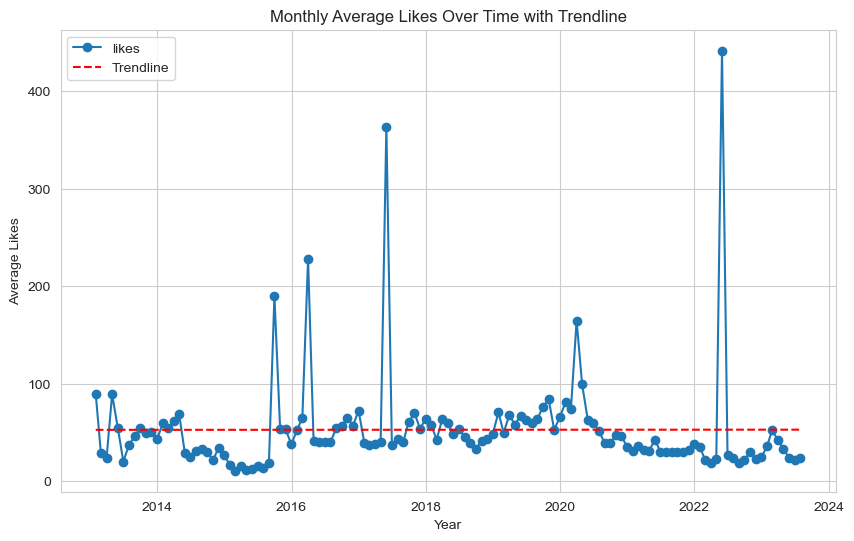

In [208]:
sns.set_style("whitegrid")
monthly_mean = df.likes.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='likes')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Likes')
plt.title('Monthly Average Likes Over Time with Trendline')
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


In [209]:
df[['reactions', 'likes']].corr(numeric_only=True)

,reactions,likes
reactions,1.000000,0.999919
likes,0.999919,1.000000


We expect this relationship to be maintained when likes feature is segmented by network and by period.

Relationship between Reactions and Character & Word Count

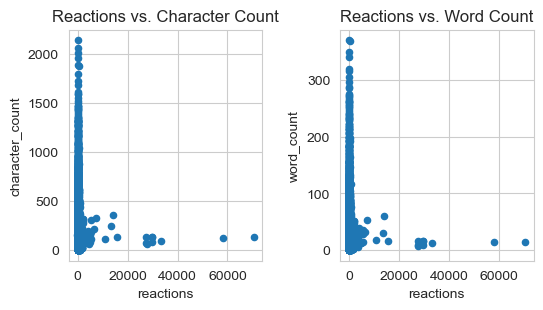

In [210]:
fig, axes = plt.subplots(1, 2, figsize=(6, 3))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
sns.set_style("whitegrid")

df.plot(
    kind='scatter', x='reactions', y='character_count', ax=axes[0],
    title='Reactions vs. Character Count'
)

df.plot(
    kind='scatter', x='reactions', y='word_count', ax=axes[1],
    title='Reactions vs. Word Count'
)

plt.show()

Trends in Comments:

On average, comments generally trend around the 20-mark line, meaning that there are usually about 20 comments on each post. However, a significant outlier exists near 2014. Generally Facebook posts have the highest comments. However, from 2021, the number of comments from Twitter & Instagram overlaps with Facebook. LinkedIn remains flat with little variation, near the 0 line.

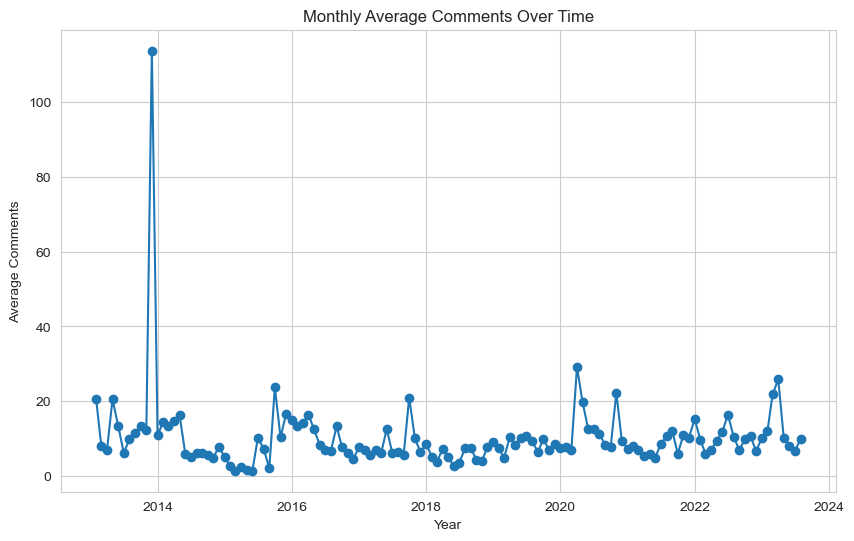

In [211]:
sns.set_style("whitegrid")
monthly_mean = df.comments.resample('M').mean().interpolate()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Comments')
plt.title('Monthly Average Comments Over Time')
plt.show()

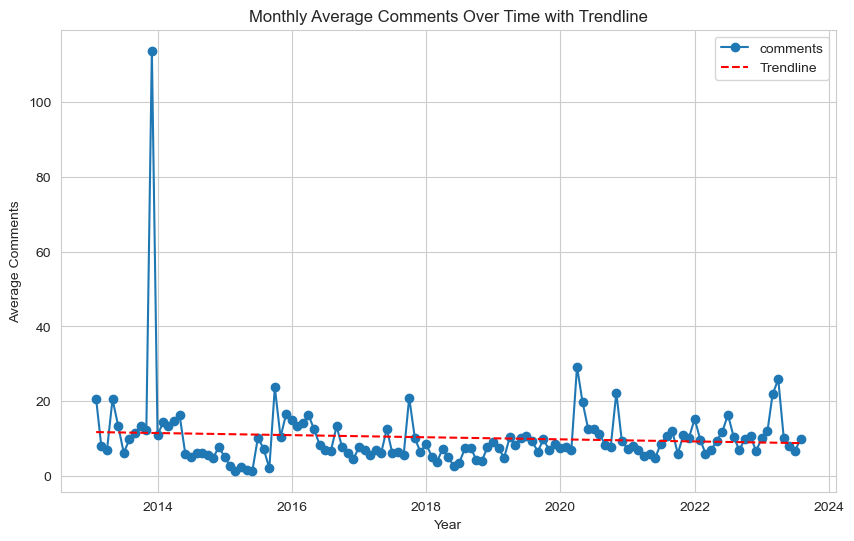

In [212]:
sns.set_style("whitegrid")
monthly_mean = df.comments.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='comments')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Comments')
plt.legend()
plt.title('Monthly Average Comments Over Time with Trendline')

# Show the plot
plt.grid(True)
plt.show()


Comments by Network:

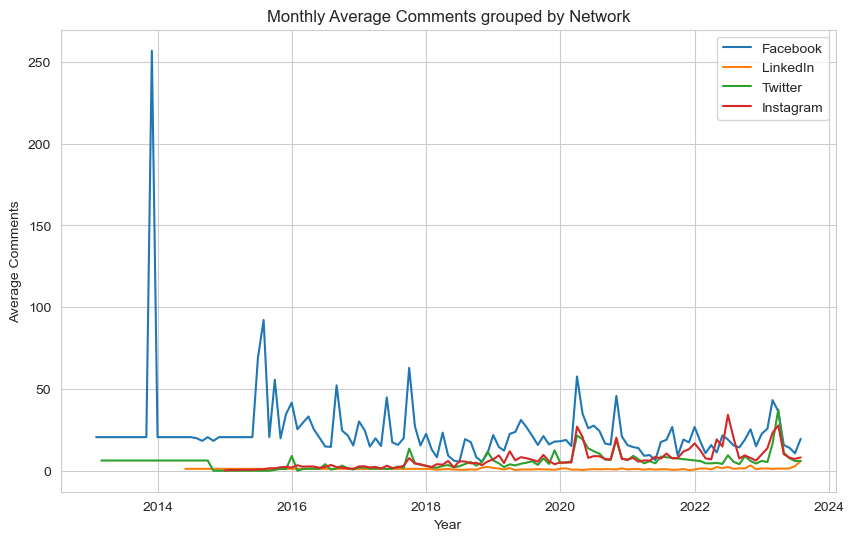

In [213]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'comments'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'comments'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'comments'].resample('M').mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'comments'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Year')
plt.ylabel('Average Comments')
plt.title('Monthly Average Comments grouped by Network')
plt.legend()
plt.show()

Comments by Period:

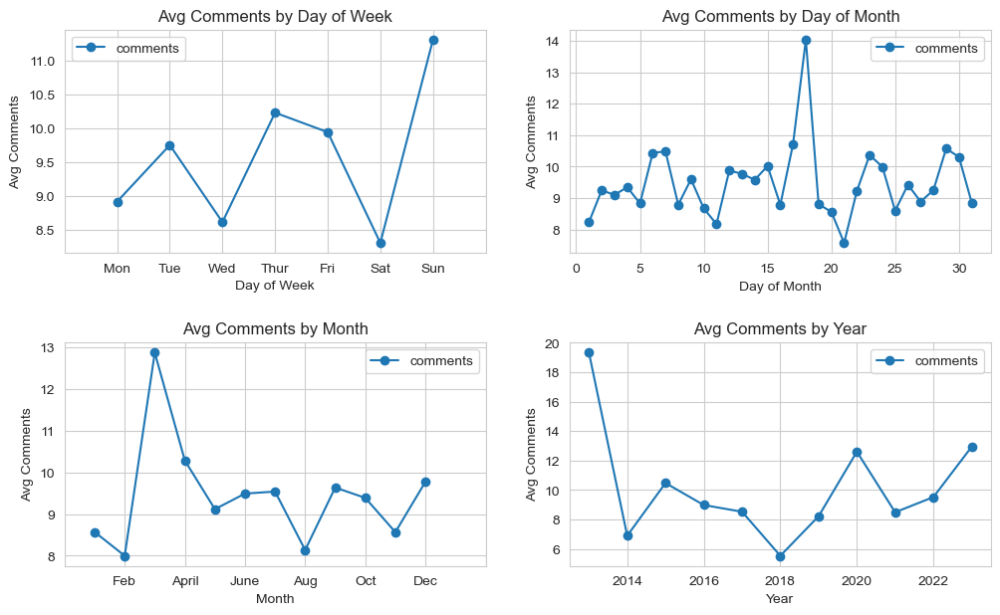

In [214]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)['comments'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Comments', linestyle='-', 
    marker='o', title='Avg Comments by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)['comments'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Comments', linestyle='-', 
    marker='o', title='Avg Comments by Day of Month',
    ax=axes.ravel()[1]
)

df.groupby(df.index.month)['comments'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Comments', linestyle='-', 
    marker='o', title='Avg Comments by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.groupby(df.index.year)['comments'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Comments', linestyle='-', 
    marker='o', title='Avg Comments by Year',
    ax=axes.ravel()[3]
)

plt.show()

Which Content type has the most Comments?

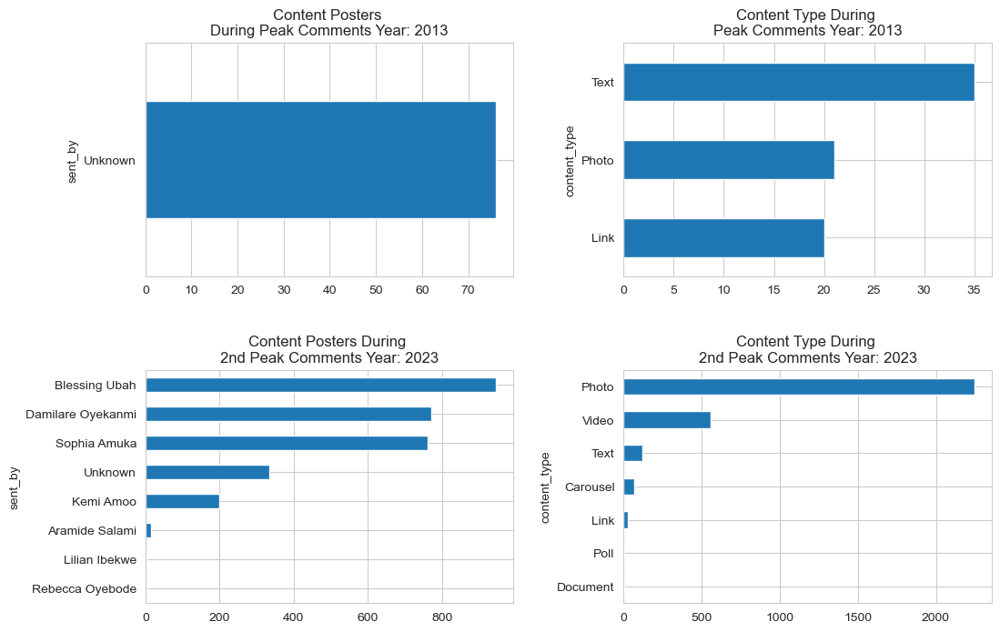

In [215]:
fig, axes = plt.subplots(2, 2, figsize=(12, 8))
fig.subplots_adjust(hspace=0.4, wspace=0.3)
sns.set_style("whitegrid")

df.loc[df.index.year == 2013].groupby(by='sent_by').count().network.plot(
    kind='barh', title='Content Posters \nDuring Peak Comments Year: 2013',
    ax=axes.ravel()[0]
)

df.loc[df.index.year == 2013].groupby(by='content_type').count().network.plot(
    kind='barh', title='Content Type During \nPeak Comments Year: 2013',
    ax=axes.ravel()[1]
)

df.loc[df.index.year == 2023].groupby(by='sent_by').count().network.sort_values().plot(
    kind='barh', title='Content Posters During \n2nd Peak Comments Year: 2023',
    ax=axes.ravel()[2]
)

df.loc[df.index.year == 2023].groupby(by='content_type').count().network.sort_values().plot(
    kind='barh', title='Content Type During \n2nd Peak Comments Year: 2023',
    ax=axes.ravel()[3]
)

plt.show()

Highest comment post:

A call to action post about business banking with Stanbic from February 12, 2016, with 1552 comments.

In [216]:
df.loc[df.comments.idxmax()]

network                                                                    Facebook
content_type                                                                  Photo
sent_by                                                                     Unknown
post                              Your business needs more than just a bank acco...
linked_content                    https://www.facebook.com/StanbicIBTC/photos/a....
                                                        ...                        
unique_organic_95%_video_views                                            44.705502
tags                                                                        no tags
hashtags                                                                         []
character_count                                                               153.0
word_count                                                                     28.0
Name: 2016-02-12 10:54:00, Length: 97, dtype: object

Highest Comments from 2013 & 2023

For 2013, the post with the highest number of comments was an informational text post on Facebook about sending money via ATMs with 670 comments.

In [217]:
most_com = df.loc[(df.index.year == 2013)]
most_com.loc[most_com.comments.idxmax()]

network                                                                    Facebook
content_type                                                                   Text
sent_by                                                                     Unknown
post                              Did you know that you can send money from your...
linked_content                                                    no linked content
                                                        ...                        
unique_organic_95%_video_views                                            44.705502
tags                                                                        no tags
hashtags                                                                         []
character_count                                                               108.0
word_count                                                                     20.0
Name: 2013-11-26 20:16:00, Length: 97, dtype: object

For 2023, it was an instagram photo motivation post from January 18, 2023.

In [218]:
most_com = df.loc[(df.index.year == 2023)]
most_com.loc[most_com.comments.idxmax()]

,network,content_type,sent_by,post,linked_content,impressions,organic_impressions,viral_impressions,non_viral_impressions,fan_impressions,...,paid_video_view_time_seconds,unique_video_views,unique_organic_video_views,unique_10_second_video_views,unique_full_video_views,unique_organic_95%_video_views,tags,hashtags,character_count,word_count
date,,,,,,,,,,,,,,,,,,,,,
2023-01-18 09:49:00,Instagram,Photo,Unknown,"Whatever you hope to achieve this year, just #...",no linked content,3989.0,3989.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,no tags,"[#GoForIt, #ITCANBE]",120.0,23.0
2023-01-18 09:49:00,Instagram,Photo,Unknown,"Whatever you hope to achieve this year, just #...",no linked content,3666.0,3666.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,no tags,"[#GoForIt, #ITCANBE]",120.0,23.0


Relationship between Comments & Word/ Character Counts

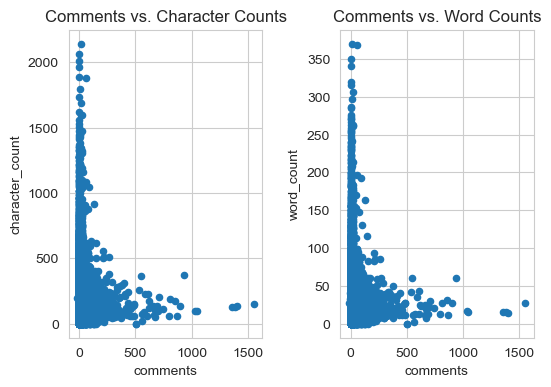

In [219]:
fig, axes = plt.subplots(1, 2, figsize=(6, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
sns.set_style("whitegrid")

df.plot(
    kind='scatter', x='comments', y='character_count', ax=axes[0],
    title='Comments vs. Character Counts'
)

df.plot(
    kind='scatter', x='comments', y='word_count', ax=axes[1],
    title='Comments vs. Word Counts'
)

plt.show()

Most Popular Post & Sender by Year

In [220]:
grouped_data = df.groupby(
    [df.index.year, 'content_type']
    )['network'].count().reset_index().sort_values(by='network', ascending=False)
pop_content = grouped_data.groupby('date')['content_type'].agg(lambda x: x.iloc[0])

grouped_data = df.groupby(
    [df.index.year, 'sent_by']
    )['network'].count().reset_index().sort_values(by='network', ascending=False)
pop_sender = grouped_data.groupby('date')['sent_by'].agg(lambda x: x.iloc[0])


pd.DataFrame({'content_type':pop_content, 'sender':pop_sender}, index=pop_content.index)

,content_type,sender
date,,
2013,Text,Unknown
2014,Photo,Unknown
2015,Photo,Unknown
2016,Photo,Unknown
2017,Photo,Unknown
2018,Photo,Unknown
2019,Photo,Unknown
2020,Photo,Unknown
2021,Photo,Unknown


For peak comments year, which hashtags dominated?

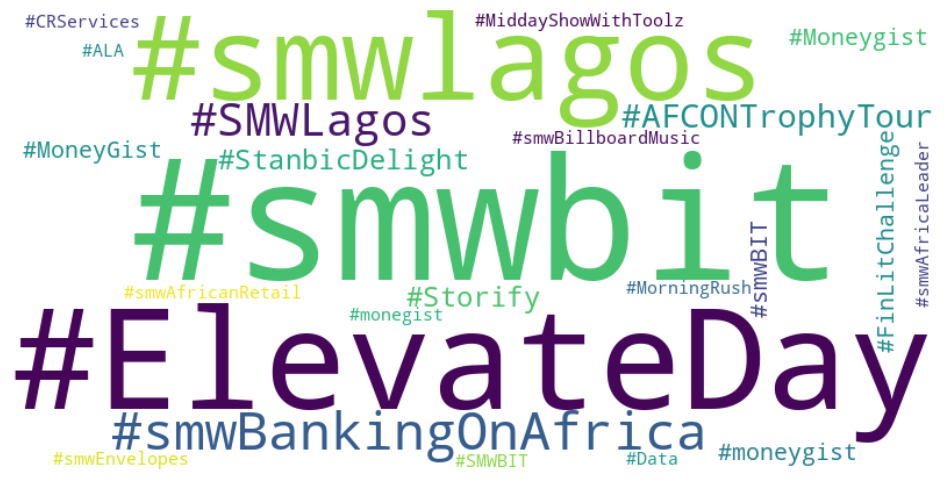

In [221]:
all_words = [word for sublist in df.loc[df.index.year == 2013, 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

Activity Metrics Correlation:

Pearson Correlation

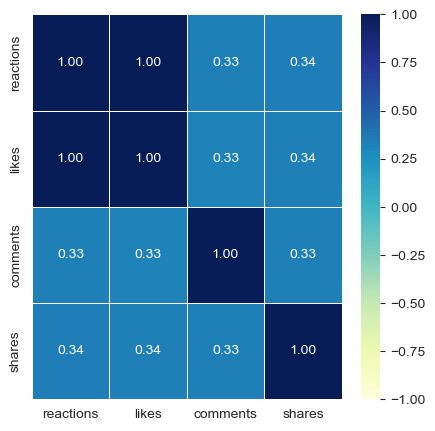

In [222]:
plt.figure(figsize=(5, 5))
sns.heatmap(
    df[gen_act].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Spearman's Rank Correlation

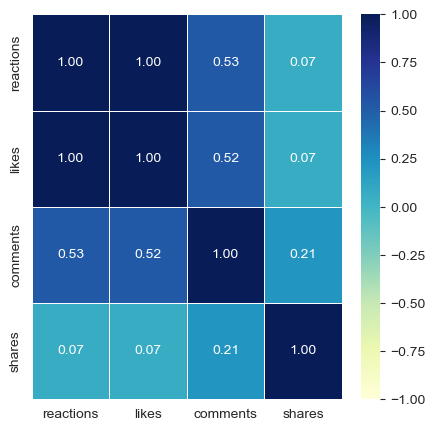

In [223]:
plt.figure(figsize=(5, 5))
sns.heatmap(
    df[gen_act].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Trends in Shares:

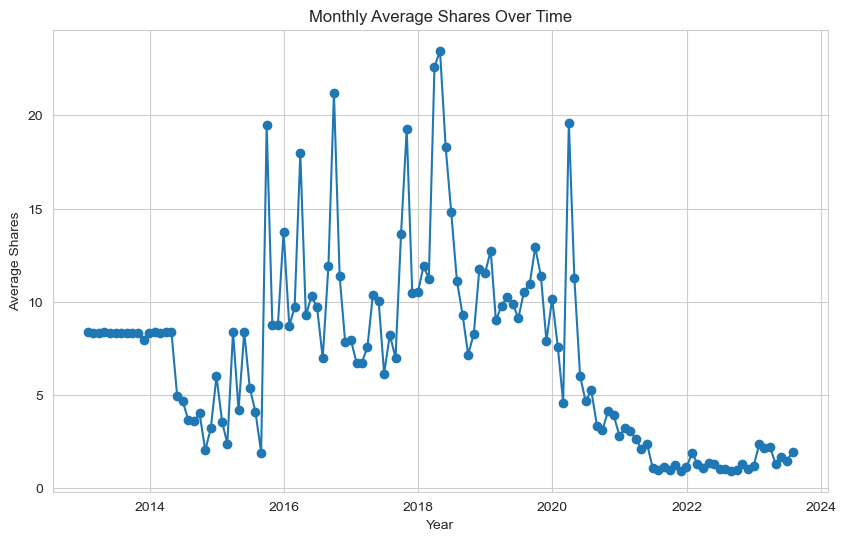

In [224]:
sns.set_style("whitegrid")
monthly_mean = df.query('network != "Instagram"').shares.resample('M').mean().interpolate()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Shares')
plt.title('Monthly Average Shares Over Time')
plt.show()

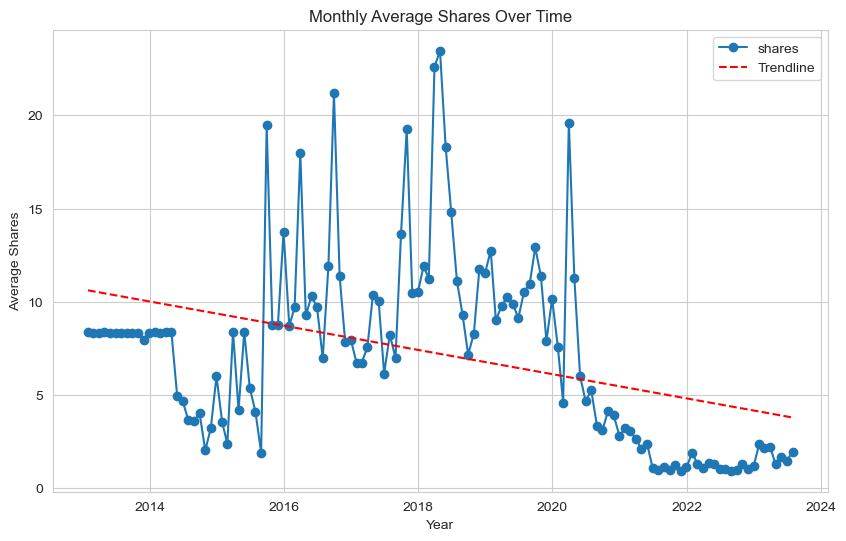

In [225]:
sns.set_style("whitegrid")
monthly_mean = df.query('network != "Instagram"').shares.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='shares')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Shares')
plt.title('Monthly Average Shares Over Time')
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


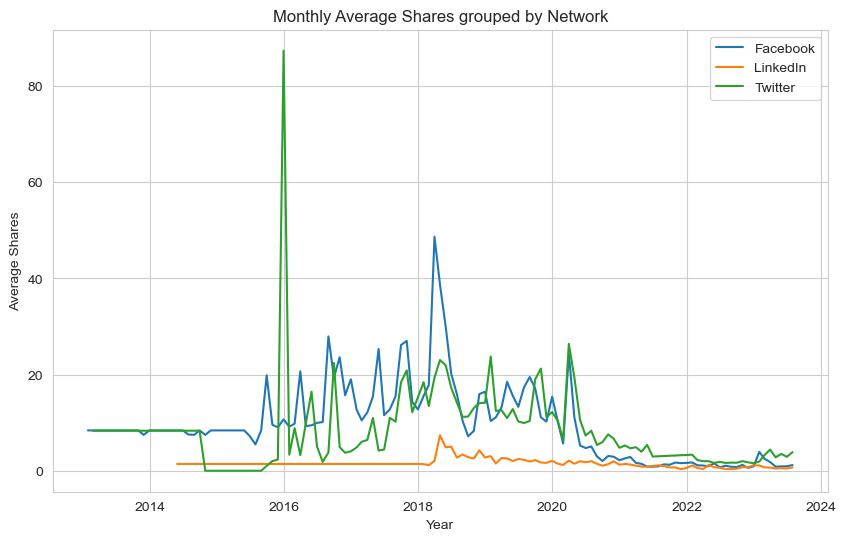

In [226]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'shares'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'shares'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'shares'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')

plt.xlabel('Year')
plt.ylabel('Average Shares')
plt.title('Monthly Average Shares grouped by Network')
plt.legend()
plt.show()

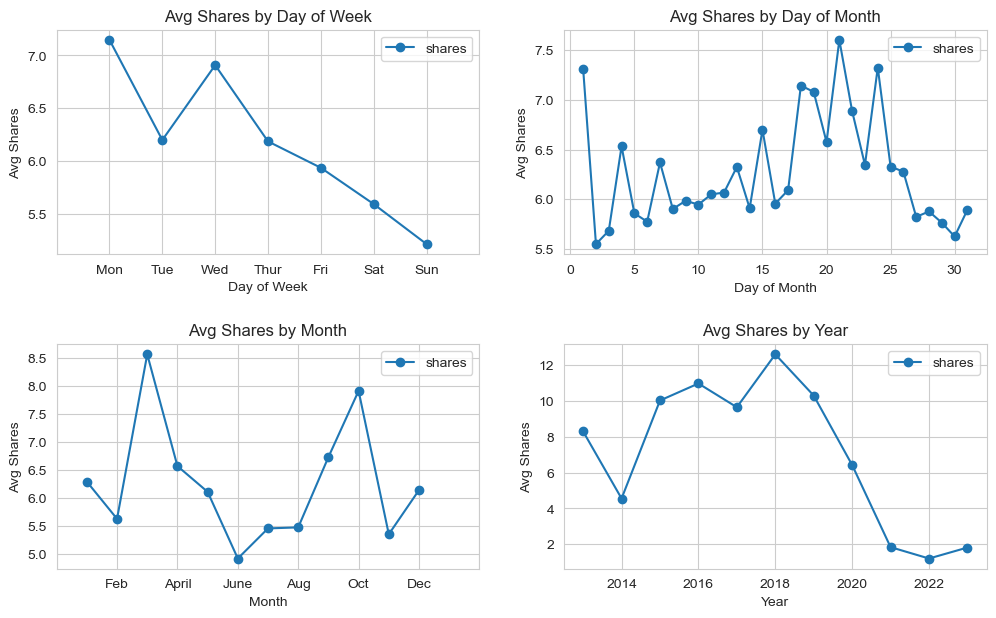

In [227]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.dayofweek)['shares'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Shares', linestyle='-', 
    marker='o', title='Avg Shares by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.day)['shares'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Shares', linestyle='-', 
    marker='o', title='Avg Shares by Day of Month',
    ax=axes.ravel()[1]
)

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.month)['shares'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Shares', linestyle='-', 
    marker='o', title='Avg Shares by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.year)['shares'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Shares', linestyle='-', 
    marker='o', title='Avg Shares by Year',
    ax=axes.ravel()[3]
)

plt.show()

Most shared post is a twitter photo post from 2016 with a call to action about an investment product.

In [228]:
df.loc[df.shares.idxmax()]

network                                                                     Twitter
content_type                                                                  Photo
sent_by                                                                     Unknown
post                              Want investments that don’t cost £89m and you ...
linked_content                                                    no linked content
                                                        ...                        
unique_organic_95%_video_views                                                  0.0
tags                                                                        no tags
hashtags                                                                         []
character_count                                                               131.0
word_count                                                                     16.0
Name: 2016-09-19 18:58:00, Length: 97, dtype: object

Relationship between Impressions, Engagements & Shares

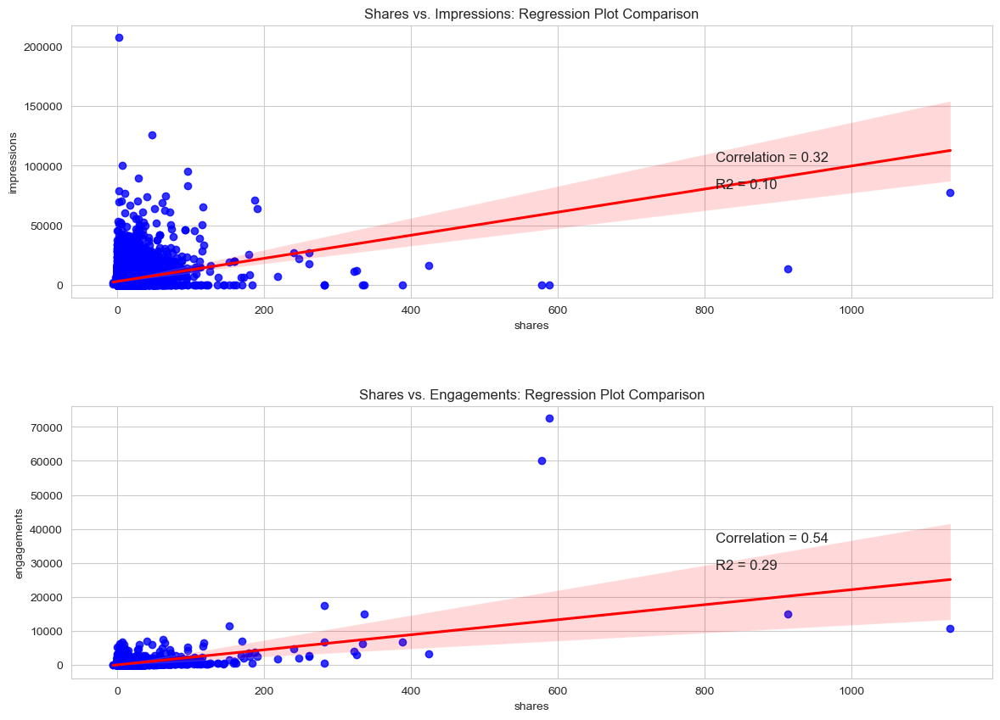

In [229]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network!="Instagram"').shares, df.query('network!="Instagram"').impressions)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='shares', y='impressions', data=df.query('network!="Instagram"'), color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Shares vs. Impressions: Regression Plot Comparison')


slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network!="Instagram"').shares, df.query('network!="Instagram"').engagements)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='shares', y='engagements', data=df.query('network!="Instagram"'), color='b', line_kws=dict(color="r"), ax=axes[1])
axes[1].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[1].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[1].set_title('Shares vs. Engagements: Regression Plot Comparison')

plt.show()

Relationship between Word & Character Counts & Shares

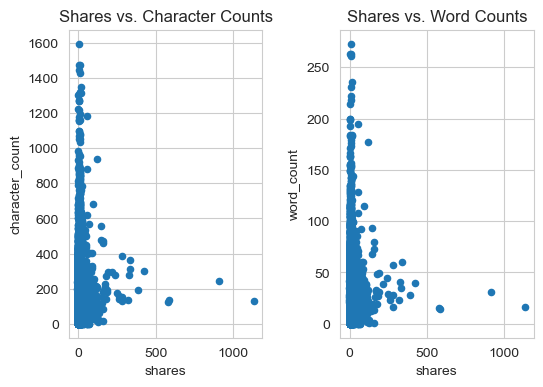

In [230]:
fig, axes = plt.subplots(1, 2, figsize=(6, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
sns.set_style("whitegrid")

df.query('network!="Instagram"').plot(
    kind='scatter', x='shares', y='character_count', ax=axes[0],
    title='Shares vs. Character Counts'
)

df.query('network!="Instagram"').plot(
    kind='scatter', x='shares', y='word_count', ax=axes[1],
    title='Shares vs. Word Counts'
)

plt.show()

Click-based General Metrics

All networks but instagram track click metrics:

In [231]:
print('Post Link Clicks Avg')
print('Facebook: ', df.query('network=="Facebook"').post_link_clicks.mean())
print('Twitter: ', df.query('network=="Twitter"').post_link_clicks.mean())
print('LinkedIn: ', df.query('network=="LinkedIn"').post_link_clicks.mean())
print('Instagram: ', df.query('network=="Instagram"').post_link_clicks.mean())

print('\nPost Clicks All Avg')
print('Facebook: ', df.query('network=="Facebook"').post_clicks_all.mean())
print('Twitter: ', df.query('network=="Twitter"').post_clicks_all.mean())
print('LinkedIn: ', df.query('network=="LinkedIn"').post_clicks_all.mean())
print('Instagram: ', df.query('network=="Instagram"').post_clicks_all.mean())


Post Link Clicks Avg
Facebook:  10.718228867165038
Twitter:  7.002767783005812
LinkedIn:  32.13250157927985
Instagram:  0.0

Post Clicks All Avg
Facebook:  110.87619475992352
Twitter:  72.2285131344045
LinkedIn:  32.13250157927985
Instagram:  0.0


Trends in Clicks:

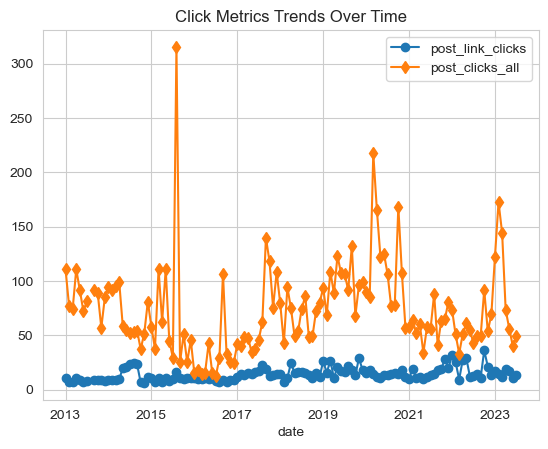

In [232]:
# All Inclusive
df.query('network != "Instagram"')[['post_link_clicks', 'post_clicks_all']].resample('M').mean().plot(
    y=['post_link_clicks', 'post_clicks_all'],
    style=['-o', '-d'],
    title='Click Metrics Trends Over Time'
).autoscale()
plt.show()

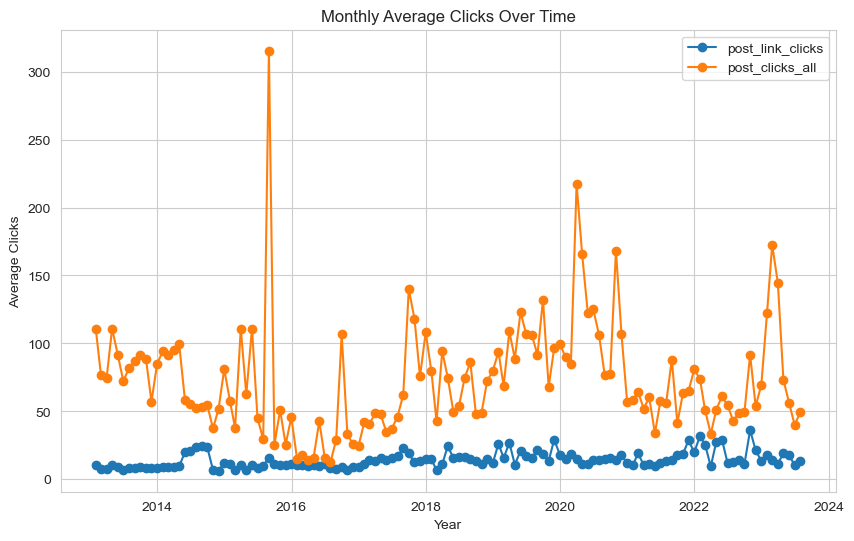

In [233]:
sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))

monthly_mean = df.query('network != "Instagram"').post_link_clicks.resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, marker='o', 
         linestyle='-', label='post_link_clicks')
monthly_mean = df.query('network != "Instagram"').post_clicks_all.resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, marker='o', 
         linestyle='-', label='post_clicks_all')

plt.xlabel('Year')
plt.ylabel('Average Clicks')
plt.legend()
plt.title('Monthly Average Clicks Over Time')
plt.show()

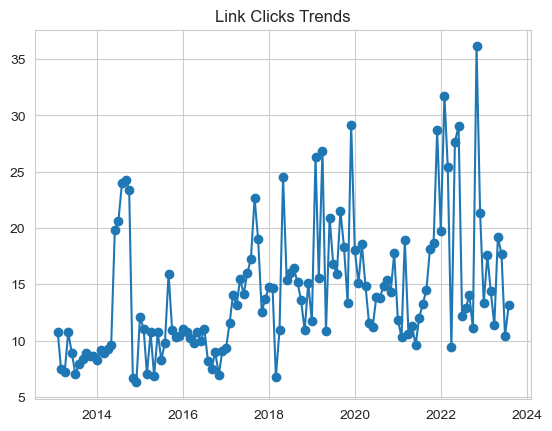

In [234]:
monthly_mean = df.query('network != "Instagram"').post_link_clicks.resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, marker='o', 
         linestyle='-', label='post_link_clicks')
plt.title('Link Clicks Trends')
plt.show()

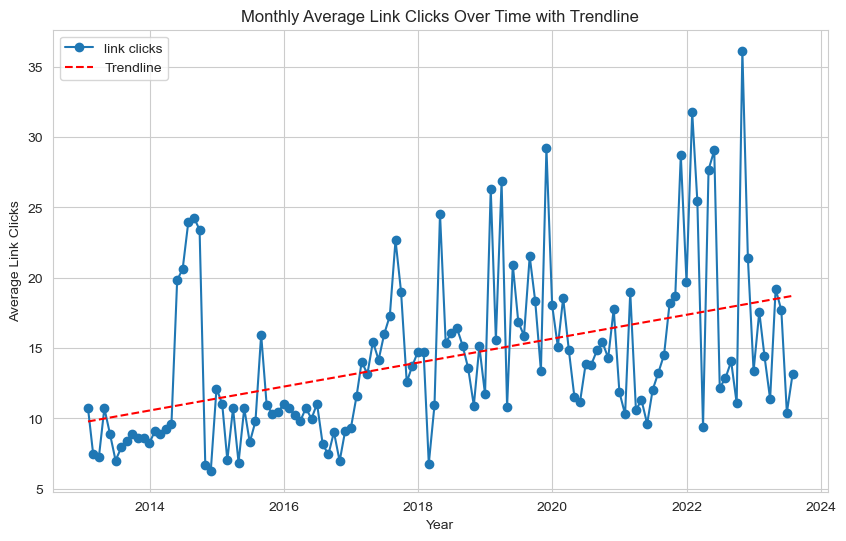

In [235]:
sns.set_style("whitegrid")
monthly_mean = df.query('network != "Instagram"').post_link_clicks.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='link clicks')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Link Clicks')
plt.legend()
plt.title('Monthly Average Link Clicks Over Time with Trendline')

# Show the plot
plt.grid(True)
plt.show()


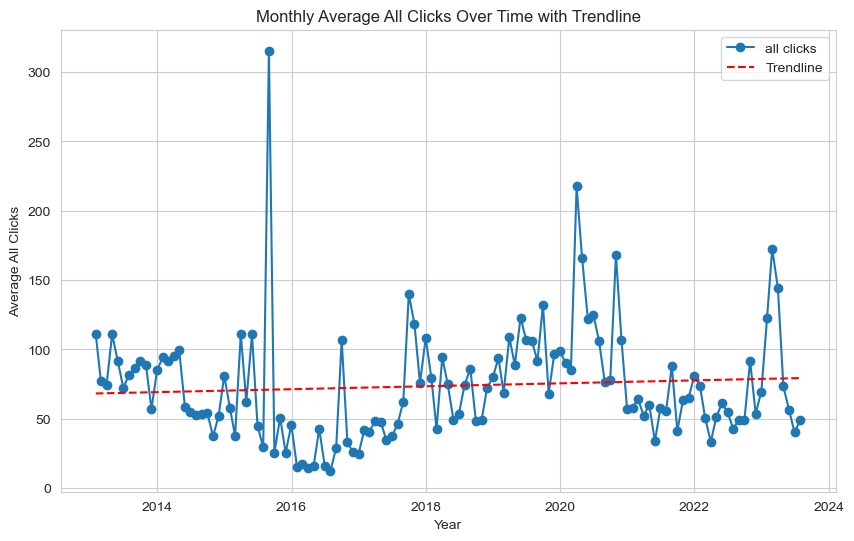

In [236]:
sns.set_style("whitegrid")
monthly_mean = df.query('network != "Instagram"').post_clicks_all.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='all clicks')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average All Clicks')
plt.legend()
plt.title('Monthly Average All Clicks Over Time with Trendline')

# Show the plot
plt.grid(True)
plt.show()


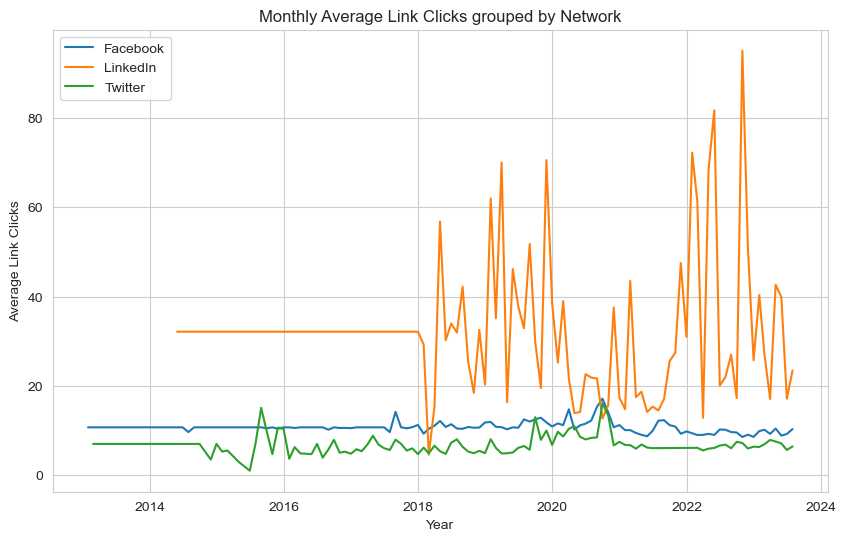

In [237]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'post_link_clicks'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'post_link_clicks'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'post_link_clicks'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')

plt.xlabel('Year')
plt.ylabel('Average Link Clicks')
plt.title('Monthly Average Link Clicks grouped by Network')
plt.legend()
plt.show()

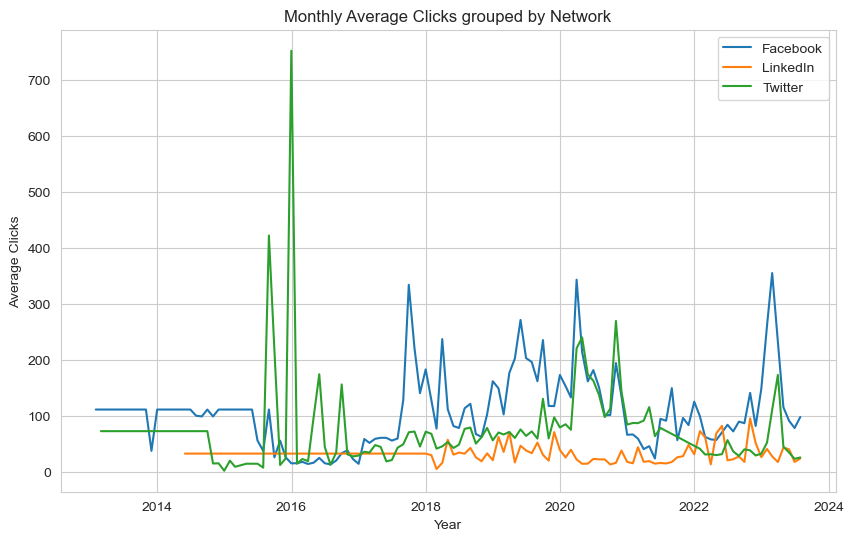

In [238]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'post_clicks_all'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'post_clicks_all'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'post_clicks_all'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')

plt.xlabel('Year')
plt.ylabel('Average Clicks')
plt.title('Monthly Average Clicks grouped by Network')
plt.legend()
plt.show()

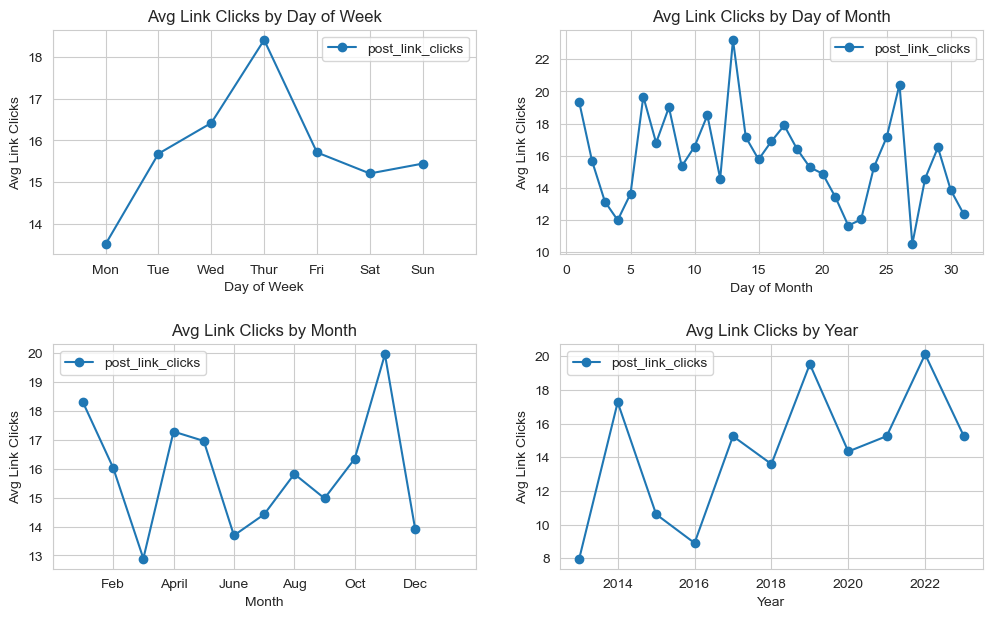

In [239]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.dayofweek)['post_link_clicks'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Link Clicks', linestyle='-', 
    marker='o', title='Avg Link Clicks by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.day)['post_link_clicks'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Link Clicks', linestyle='-', 
    marker='o', title='Avg Link Clicks by Day of Month',
    ax=axes.ravel()[1]
)

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.month)['post_link_clicks'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Link Clicks', linestyle='-', 
    marker='o', title='Avg Link Clicks by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.year)['post_link_clicks'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Link Clicks', linestyle='-', 
    marker='o', title='Avg Link Clicks by Year',
    ax=axes.ravel()[3]
)

plt.show()

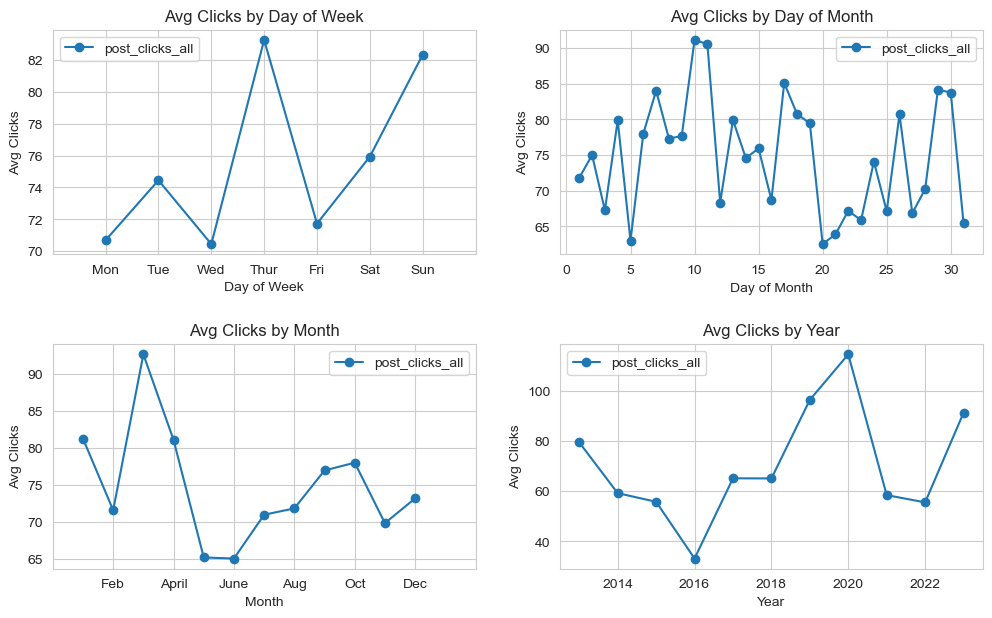

In [240]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.dayofweek)['post_clicks_all'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Clicks', linestyle='-', 
    marker='o', title='Avg Clicks by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.day)['post_clicks_all'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Clicks', linestyle='-', 
    marker='o', title='Avg Clicks by Day of Month',
    ax=axes.ravel()[1]
)

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.month)['post_clicks_all'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Clicks', linestyle='-', 
    marker='o', title='Avg Clicks by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.query('network != "Instagram"').groupby(df.query('network != "Instagram"').index.year)['post_clicks_all'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Clicks', linestyle='-', 
    marker='o', title='Avg Clicks by Year',
    ax=axes.ravel()[3]
)

plt.show()

Most clicked link post is a linkedin photo post from 2022's Worker's day.

In [241]:
df.loc[df.post_link_clicks.idxmax()]

network                                                                    LinkedIn
content_type                                                                  Photo
sent_by                                                                     Unknown
post                              Do you know anyone that falls into these categ...
linked_content                                                    no linked content
                                                        ...                        
unique_organic_95%_video_views                                                  0.0
tags                                                                        no tags
hashtags                                                [#WorkersDay2022, #itcanbe]
character_count                                                                80.0
word_count                                                                     12.0
Name: 2022-05-01 14:57:00, Length: 97, dtype: object

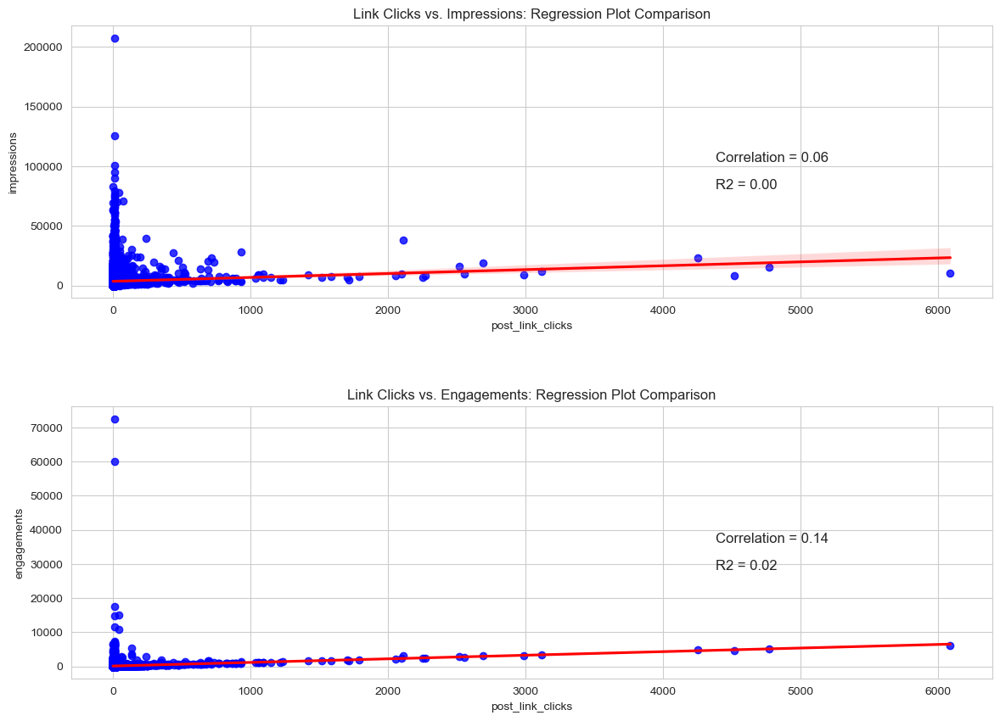

In [242]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network!="Instagram"').post_link_clicks, df.query('network!="Instagram"').impressions)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='post_link_clicks', y='impressions', data=df.query('network!="Instagram"'), color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Link Clicks vs. Impressions: Regression Plot Comparison')


slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network!="Instagram"').post_link_clicks, df.query('network!="Instagram"').engagements)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='post_link_clicks', y='engagements', data=df.query('network!="Instagram"'), color='b', line_kws=dict(color="r"), ax=axes[1])
axes[1].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[1].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[1].set_title('Link Clicks vs. Engagements: Regression Plot Comparison')

plt.show()

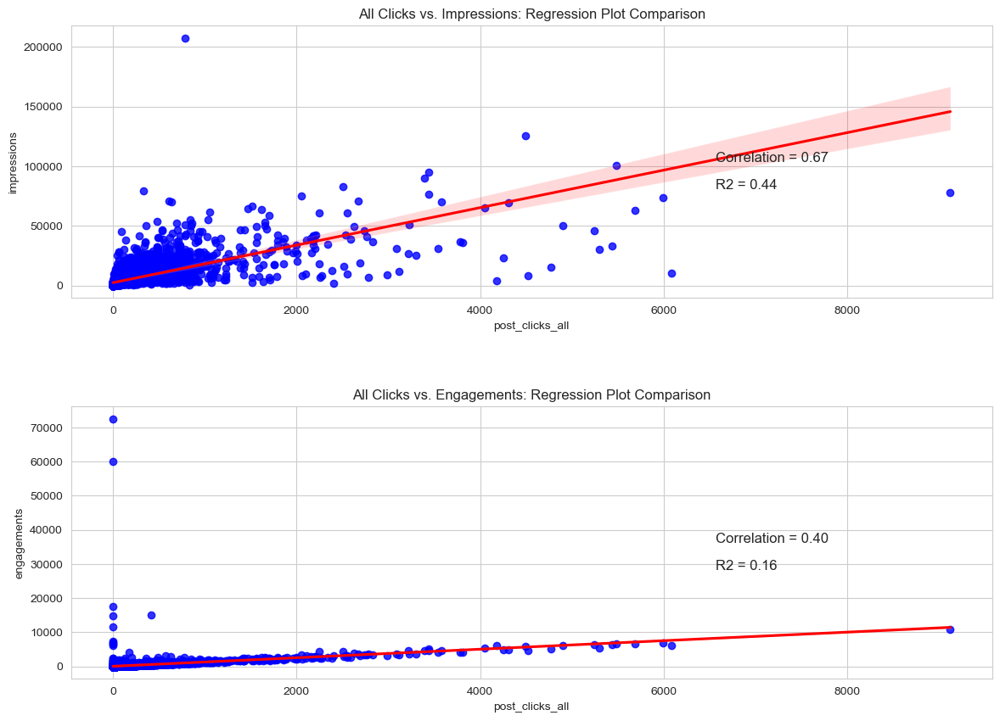

In [243]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network!="Instagram"').post_clicks_all, df.query('network!="Instagram"').impressions)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='post_clicks_all', y='impressions', data=df.query('network!="Instagram"'), color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('All Clicks vs. Impressions: Regression Plot Comparison')


slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network!="Instagram"').post_clicks_all, df.query('network!="Instagram"').engagements)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='post_clicks_all', y='engagements', data=df.query('network!="Instagram"'), color='b', line_kws=dict(color="r"), ax=axes[1])
axes[1].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[1].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[1].set_title('All Clicks vs. Engagements: Regression Plot Comparison')

plt.show()

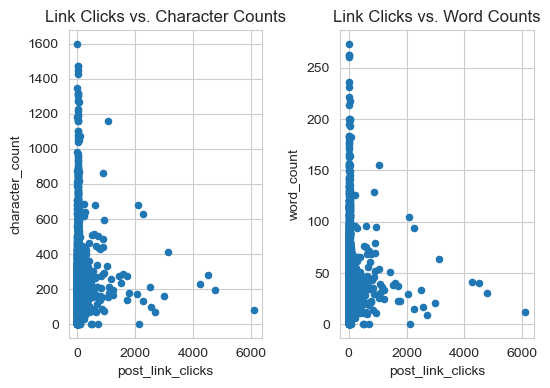

In [244]:
fig, axes = plt.subplots(1, 2, figsize=(6, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
sns.set_style("whitegrid")

df.query('network!="Instagram"').plot(
    kind='scatter', x='post_link_clicks', y='character_count', ax=axes[0],
    title='Link Clicks vs. Character Counts'
)

df.query('network!="Instagram"').plot(
    kind='scatter', x='post_link_clicks', y='word_count', ax=axes[1],
    title='Link Clicks vs. Word Counts'
)

plt.show()

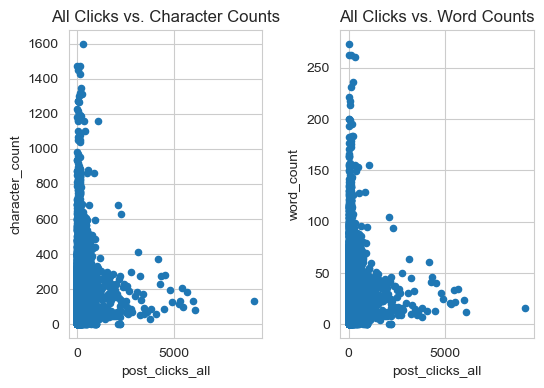

In [245]:
fig, axes = plt.subplots(1, 2, figsize=(6, 4))
fig.subplots_adjust(hspace=0.4, wspace=0.4)
sns.set_style("whitegrid")

df.query('network!="Instagram"').plot(
    kind='scatter', x='post_clicks_all', y='character_count', ax=axes[0],
    title='All Clicks vs. Character Counts'
)

df.query('network!="Instagram"').plot(
    kind='scatter', x='post_clicks_all', y='word_count', ax=axes[1],
    title='All Clicks vs. Word Counts'
)

plt.show()

Video-Based General Metrics

Onlt Twitter does not track organic video views. Both features are identical, implying that all video views are organic. 

In [246]:
print('Video Views Avg')
print('Facebook: ', df.query('network=="Facebook"').video_views.mean())
print('Twitter: ', df.query('network=="Twitter"').video_views.mean())
print('LinkedIn: ', df.query('network=="LinkedIn"').video_views.mean())
print('Instagram: ', df.query('network=="Instagram"').video_views.mean())

print('\nOrganic Video Views Avg')
print('Facebook: ', df.query('network=="Facebook"').organic_video_views.mean())
print('Twitter: ', df.query('network=="Twitter"').organic_video_views.mean())
print('LinkedIn: ', df.query('network=="LinkedIn"').organic_video_views.mean())
print('Instagram: ', df.query('network=="Instagram"').organic_video_views.mean())


Video Views Avg
Facebook:  235.06832971800435
Twitter:  17.728104115371085
LinkedIn:  51.63505154639175
Instagram:  81.2426

Organic Video Views Avg
Facebook:  235.92190889370934
Twitter:  0.0
LinkedIn:  51.63505154639175
Instagram:  81.2426


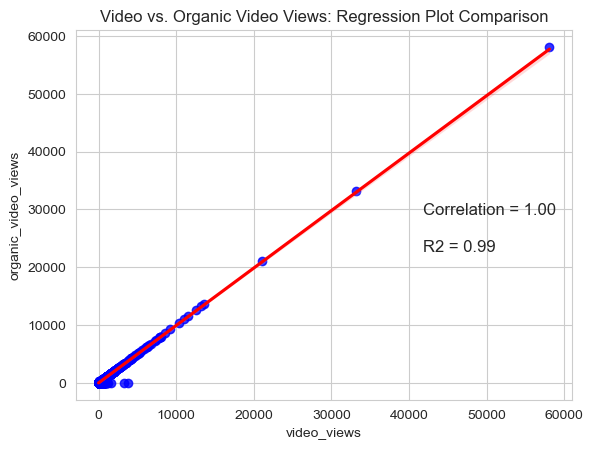

In [247]:
slope, intercept, r_value, p_value, std_err = stats.linregress(df.video_views, df.organic_video_views)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='video_views', y='organic_video_views', data=df, color='b', line_kws=dict(color="r"))
plt.annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
plt.annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
plt.title('Video vs. Organic Video Views: Regression Plot Comparison')
plt.show()

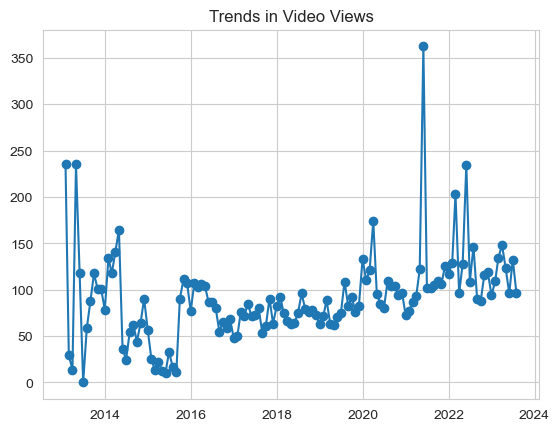

In [248]:
monthly_mean = df.video_views.resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, marker='o', 
         linestyle='-', label='video_views')
plt.title('Trends in Video Views')
plt.show()

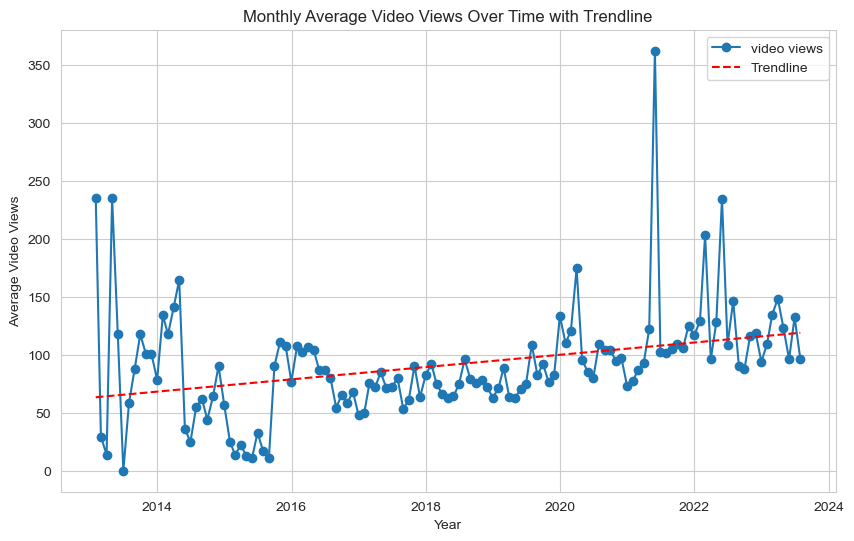

In [249]:
sns.set_style("whitegrid")
monthly_mean = df.video_views.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='video views')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Video Views')
plt.legend()
plt.title('Monthly Average Video Views Over Time with Trendline')

# Show the plot
plt.grid(True)
plt.show()


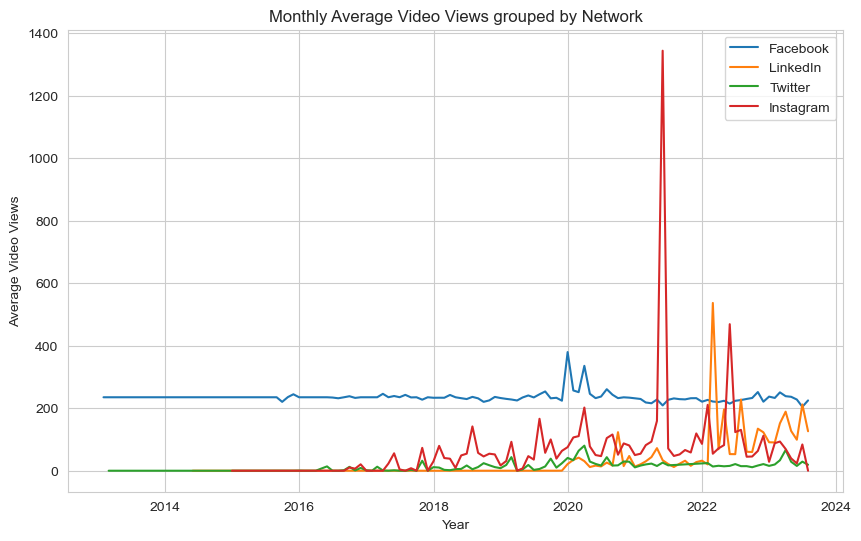

In [250]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'video_views'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'video_views'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'video_views'].resample('M').mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'video_views'].resample('M').mean().interpolate()


sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')


plt.xlabel('Year')
plt.ylabel('Average Video Views')
plt.title('Monthly Average Video Views grouped by Network')
plt.legend()
plt.show()

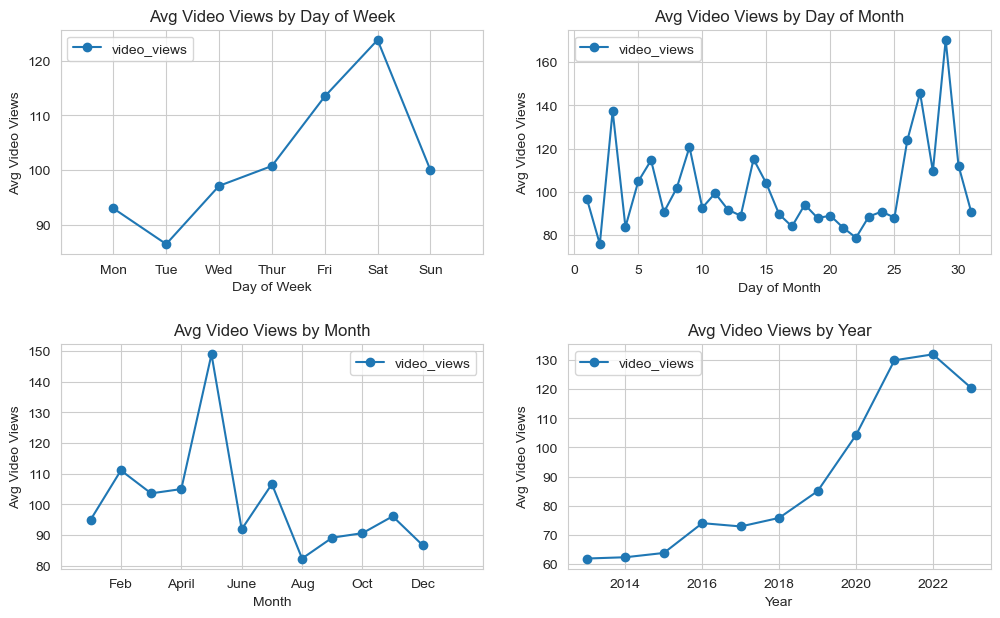

In [251]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)['video_views'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Video Views', linestyle='-', 
    marker='o', title='Avg Video Views by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)['video_views'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', ylabel='Avg Video Views', linestyle='-', 
    marker='o', title='Avg Video Views by Day of Month',
    ax=axes.ravel()[1]
)

df.groupby(df.index.month)['video_views'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Video Views', linestyle='-', 
    marker='o', title='Avg Video Views by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.groupby(df.index.year)['video_views'].mean().reset_index().set_index('date').plot(
    xlabel='Year', ylabel='Avg Video Views', linestyle='-', 
    marker='o', title='Avg Video Views by Year',
    ax=axes.ravel()[3]
)

plt.show()

Highest Video Views Post:

The post with the highest video views is a video post from February 3rd, 2022 with a call to action about investing in Stanbic mutual funds by clicking a link, with over 58k views. 

In [252]:
df.loc[df.video_views.idxmax()]

network                                                                    LinkedIn
content_type                                                                  Video
sent_by                                                                     Unknown
post                              Go for happiness by investing in relationships...
linked_content                                                    no linked content
                                                        ...                        
unique_organic_95%_video_views                                                  0.0
tags                                                                        no tags
hashtags                                       [#GoForIt, #InvestForMore, #ITCANBE]
character_count                                                               200.0
word_count                                                                     28.0
Name: 2022-02-03 12:14:00, Length: 97, dtype: object

Video Views & Impressions / Engagements

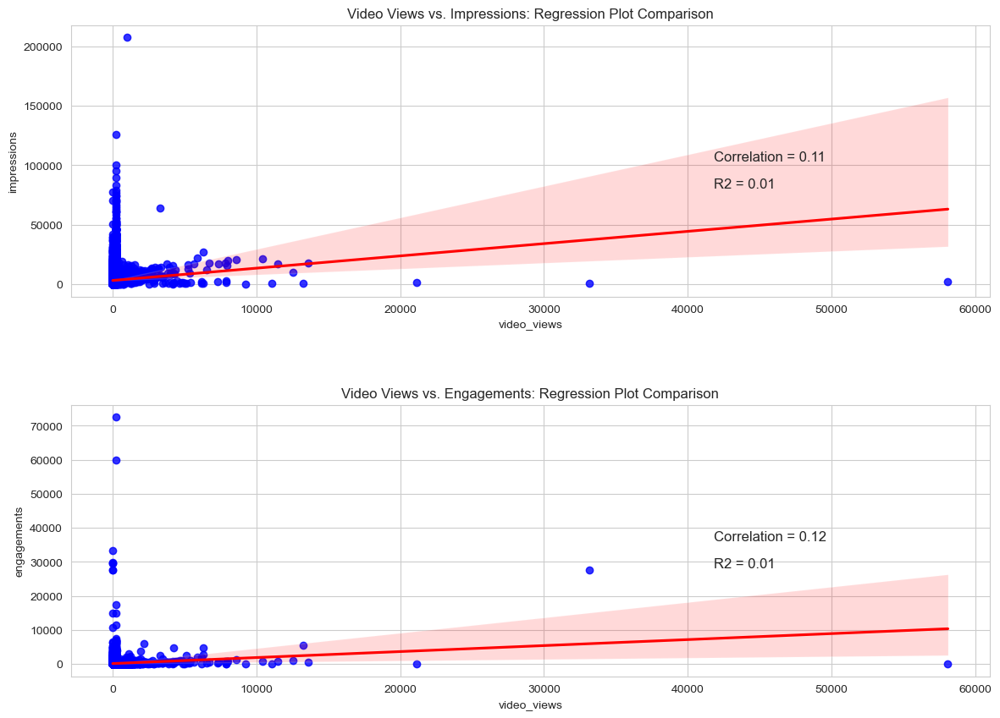

In [253]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.video_views, df.impressions)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='video_views', y='impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Video Views vs. Impressions: Regression Plot Comparison')


slope, intercept, r_value, p_value, std_err = stats.linregress(df.video_views, df.engagements)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='video_views', y='engagements', data=df, color='b', line_kws=dict(color="r"), ax=axes[1])
axes[1].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[1].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[1].set_title('Video Views vs. Engagements: Regression Plot Comparison')

plt.show()

Popular Hashtags from Peak Video Views Year

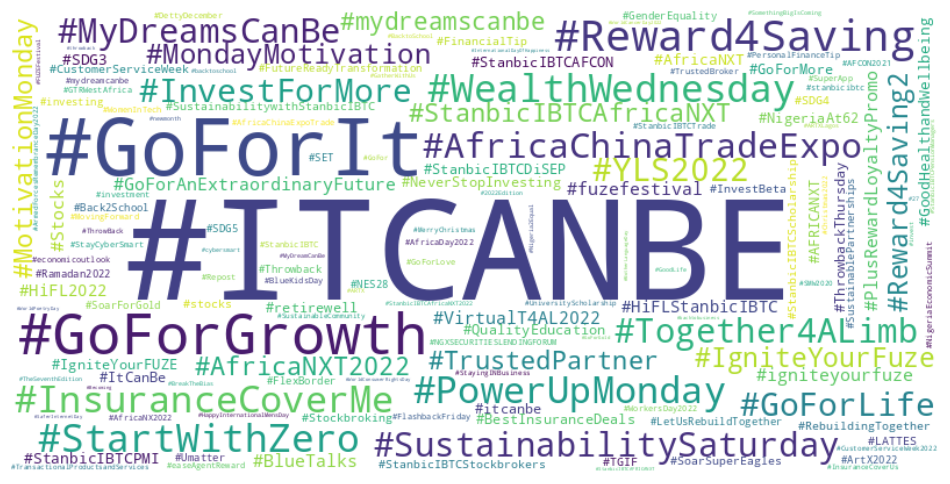

In [254]:
all_words = [word for sublist in df.loc[df.index.year == 2022, 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

Gen Metrics Correlation:

Pearson Correlation:

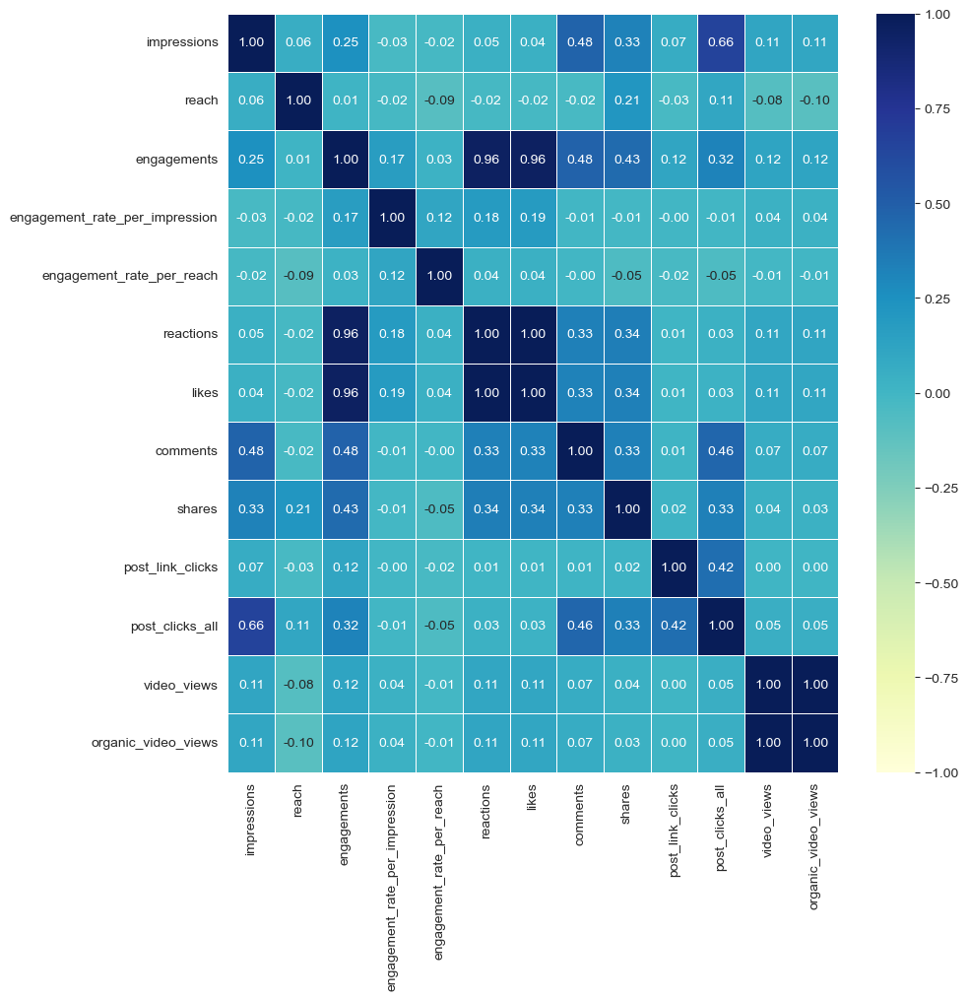

In [255]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[gen_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Spearman Rank Correlation:

Spearman correlation shows a more positive correlation between variables based on rank relationship rather than linear relationship. This is confirmed in scatter plot comparisons of variables which show that relationships between variables is dependent on each social media network.

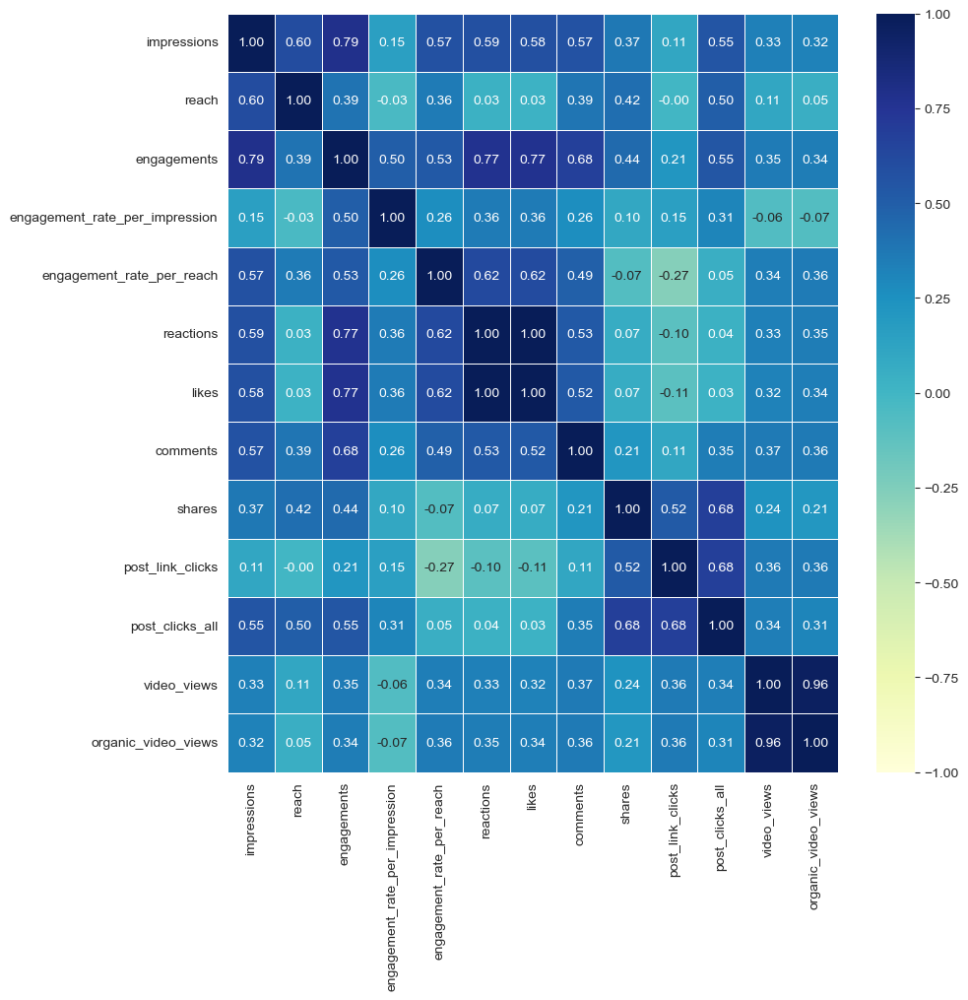

In [256]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[gen_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Sender & Content Type by Engagement, Impressions, Likes, Comments, All Post Clicks and Video Views

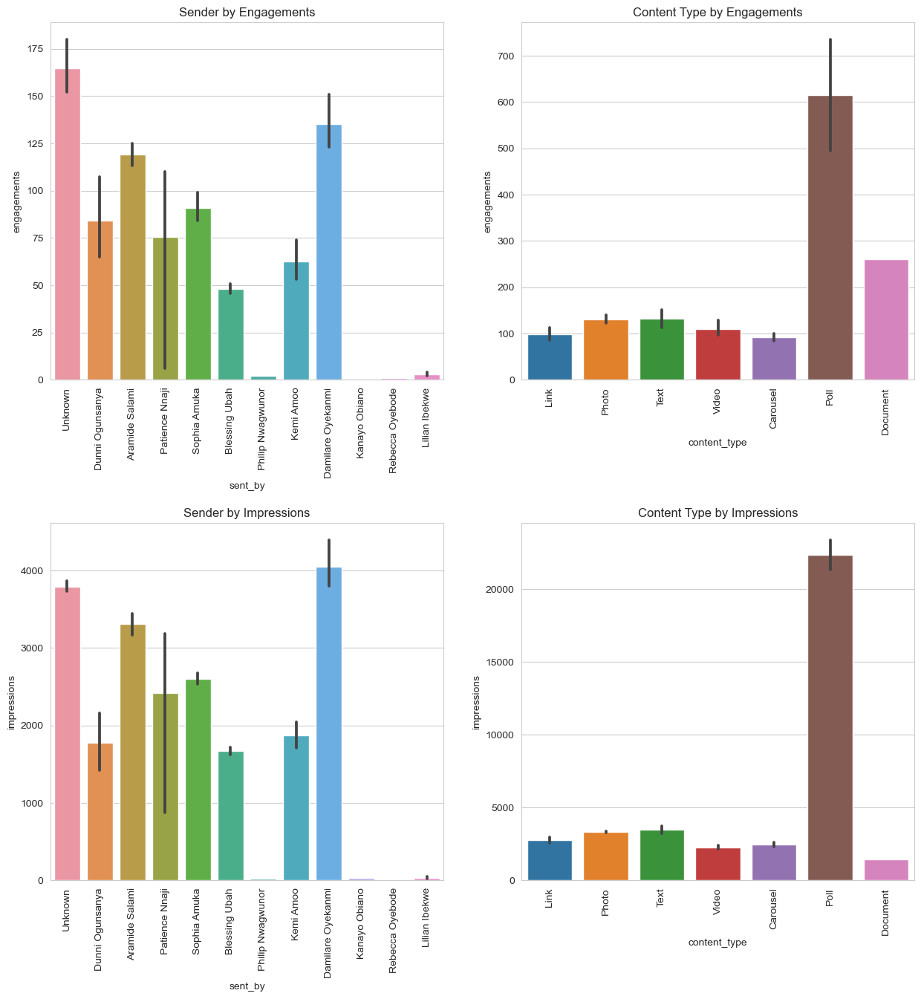

In [424]:
gm = ['engagements', 'impressions', 'likes', 'comments',
      'post_clicks_all', 'video_views']

fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

sns.barplot(data=df, x='sent_by', y='engagements', ax=axes.ravel()[0])
axes.ravel()[0].set_title('Sender by Engagements')
ticks = axes.ravel()[0].get_xticks()
labels = axes.ravel()[0].get_xticklabels()
axes.ravel()[0].set_xticks(ticks, labels, rotation=90)
sns.barplot(data=df, x='content_type', y='engagements', ax=axes.ravel()[1])
axes.ravel()[1].set_title('Content Type by Engagements')
ticks = axes.ravel()[1].get_xticks()
labels = axes.ravel()[1].get_xticklabels()
axes.ravel()[1].set_xticks(ticks, labels, rotation=90)

sns.barplot(data=df, x='sent_by', y='impressions', ax=axes.ravel()[2])
axes.ravel()[2].set_title('Sender by Impressions')
ticks = axes.ravel()[2].get_xticks()
labels = axes.ravel()[2].get_xticklabels()
axes.ravel()[2].set_xticks(ticks, labels, rotation=90)
sns.barplot(data=df, x='content_type', y='impressions', ax=axes.ravel()[3])
axes.ravel()[3].set_title('Content Type by Impressions')
ticks = axes.ravel()[3].get_xticks()
labels = axes.ravel()[3].get_xticklabels()
axes.ravel()[3].set_xticks(ticks, labels, rotation=90)


plt.show()

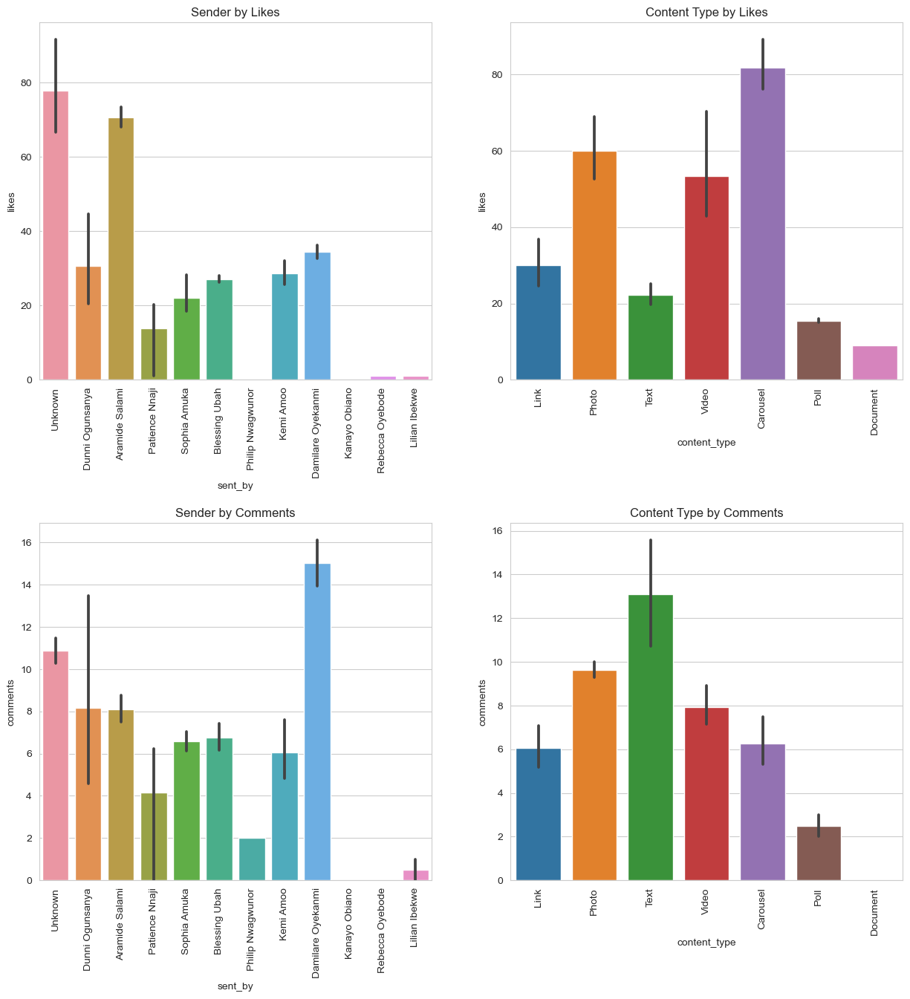

In [425]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

sns.barplot(data=df, x='sent_by', y='likes', ax=axes.ravel()[0])
axes.ravel()[0].set_title('Sender by Likes')
ticks = axes.ravel()[0].get_xticks()
labels = axes.ravel()[0].get_xticklabels()
axes.ravel()[0].set_xticks(ticks, labels, rotation=90)
sns.barplot(data=df, x='content_type', y='likes', ax=axes.ravel()[1])
axes.ravel()[1].set_title('Content Type by Likes')
ticks = axes.ravel()[1].get_xticks()
labels = axes.ravel()[1].get_xticklabels()
axes.ravel()[1].set_xticks(ticks, labels, rotation=90)

sns.barplot(data=df, x='sent_by', y='comments', ax=axes.ravel()[2])
axes.ravel()[2].set_title('Sender by Comments')
ticks = axes.ravel()[2].get_xticks()
labels = axes.ravel()[2].get_xticklabels()
axes.ravel()[2].set_xticks(ticks, labels, rotation=90)
sns.barplot(data=df, x='content_type', y='comments', ax=axes.ravel()[3])
axes.ravel()[3].set_title('Content Type by Comments')
ticks = axes.ravel()[3].get_xticks()
labels = axes.ravel()[3].get_xticklabels()
axes.ravel()[3].set_xticks(ticks, labels, rotation=90)

plt.show()


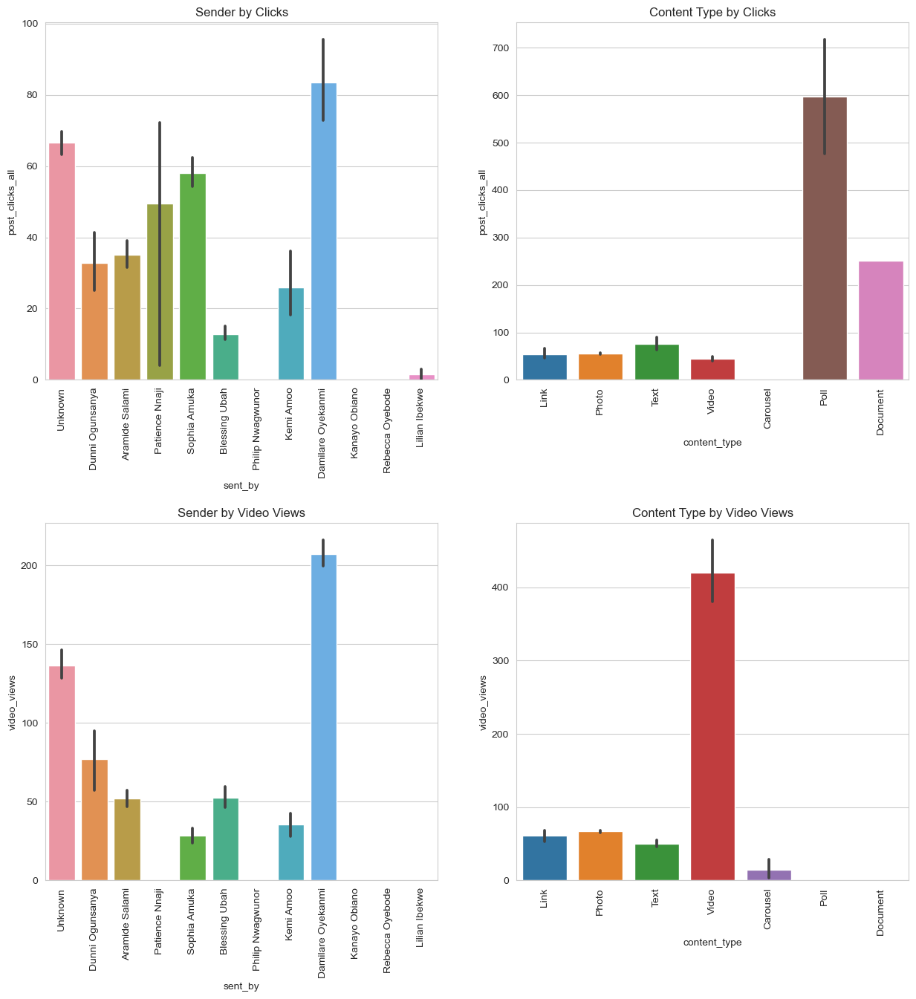

In [426]:
fig, axes = plt.subplots(2, 2, figsize=(15, 15))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

sns.barplot(data=df, x='sent_by', y='post_clicks_all', ax=axes.ravel()[0])
axes.ravel()[0].set_title('Sender by Clicks')
ticks = axes.ravel()[0].get_xticks()
labels = axes.ravel()[0].get_xticklabels()
axes.ravel()[0].set_xticks(ticks, labels, rotation=90)
sns.barplot(data=df, x='content_type', y='post_clicks_all', ax=axes.ravel()[1])
axes.ravel()[1].set_title('Content Type by Clicks')
ticks = axes.ravel()[1].get_xticks()
labels = axes.ravel()[1].get_xticklabels()
axes.ravel()[1].set_xticks(ticks, labels, rotation=90)

sns.barplot(data=df, x='sent_by', y='video_views', ax=axes.ravel()[2])
axes.ravel()[2].set_title('Sender by Video Views')
ticks = axes.ravel()[2].get_xticks()
labels = axes.ravel()[2].get_xticklabels()
axes.ravel()[2].set_xticks(ticks, labels, rotation=90)
sns.barplot(data=df, x='content_type', y='video_views', ax=axes.ravel()[3])
axes.ravel()[3].set_title('Content Type by Video Views')
ticks = axes.ravel()[3].get_xticks()
labels = axes.ravel()[3].get_xticklabels()
axes.ravel()[3].set_xticks(ticks, labels, rotation=90)

plt.show()


**Non-General Impression Metrics**

`Fan impressions` refer to the number of times that content from a social media account or page is displayed to the followers or fans of that particular account or page. These impressions represent the reach of your content within your existing audience or community.

This is a facebook-specific metric. From the plot, most of the impressions on the client's content come from followers and fans of the client. This may be connected to organic impressions, i.e. since most impressions are organic, they may reflect significant numbers from the client's followership.

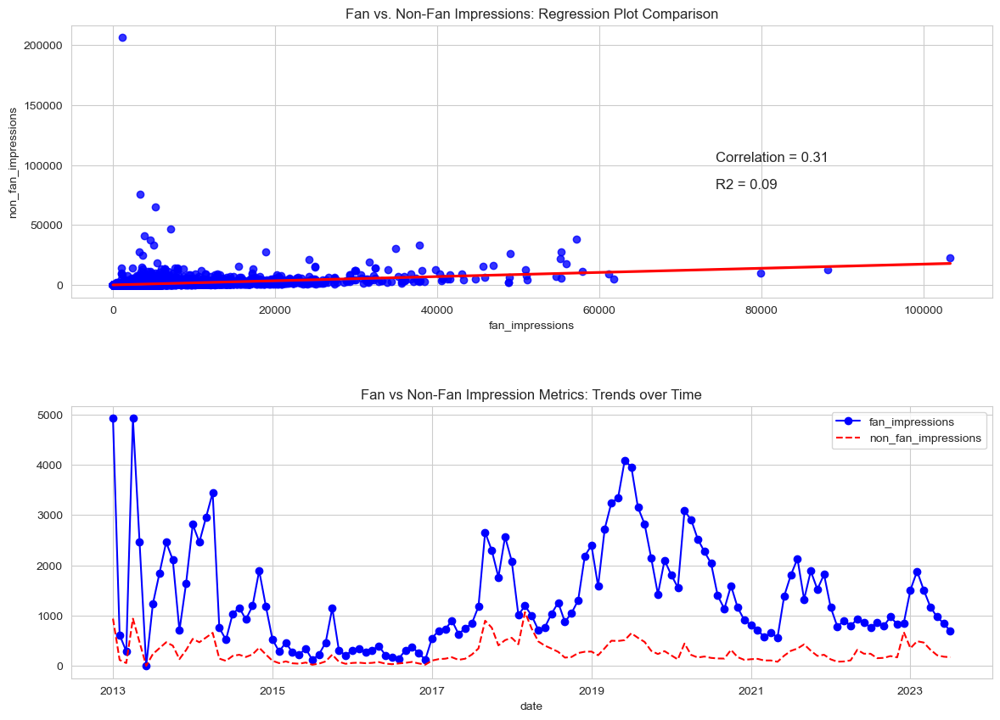

In [257]:
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.query('network=="Facebook"').fan_impressions, df.query('network=="Facebook"').non_fan_impressions)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='fan_impressions', y='non_fan_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Fan vs. Non-Fan Impressions: Regression Plot Comparison')

df[imp_metrics].resample('M').mean().interpolate().plot(
    y=['fan_impressions', 'non_fan_impressions'],
    style=['o-b', '--r'],
    title='Fan vs Non-Fan Impression Metrics: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

Most impression based metrics are positively correlated. When we restrict it to Facebook network, the correlation is even stronger.

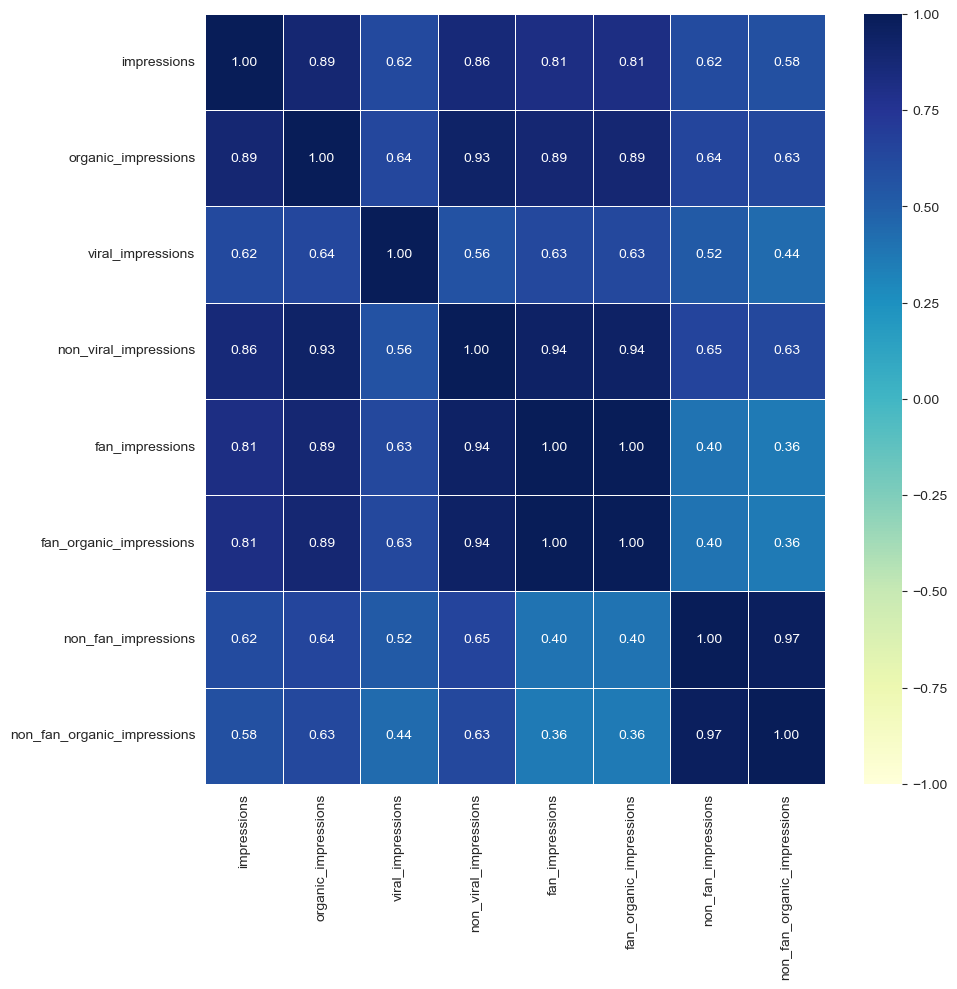

In [258]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[imp_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

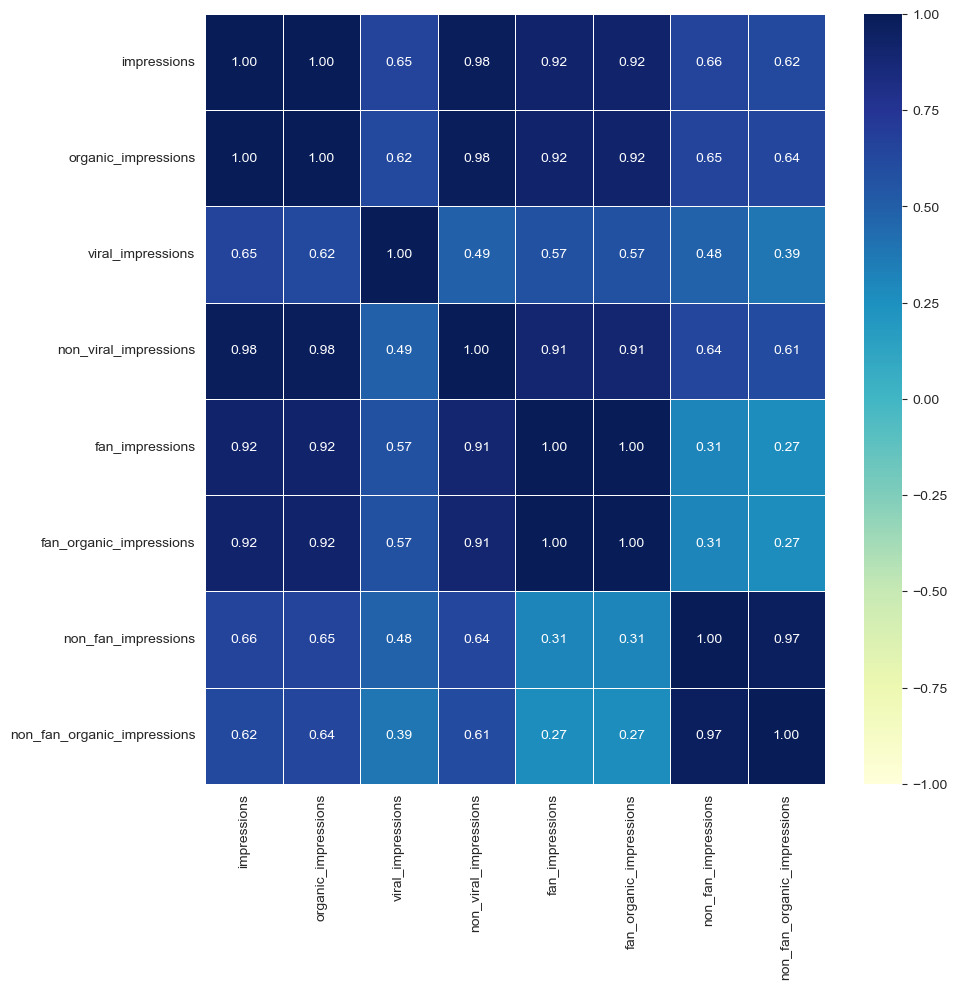

In [259]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df.query('network=="Facebook"')[imp_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

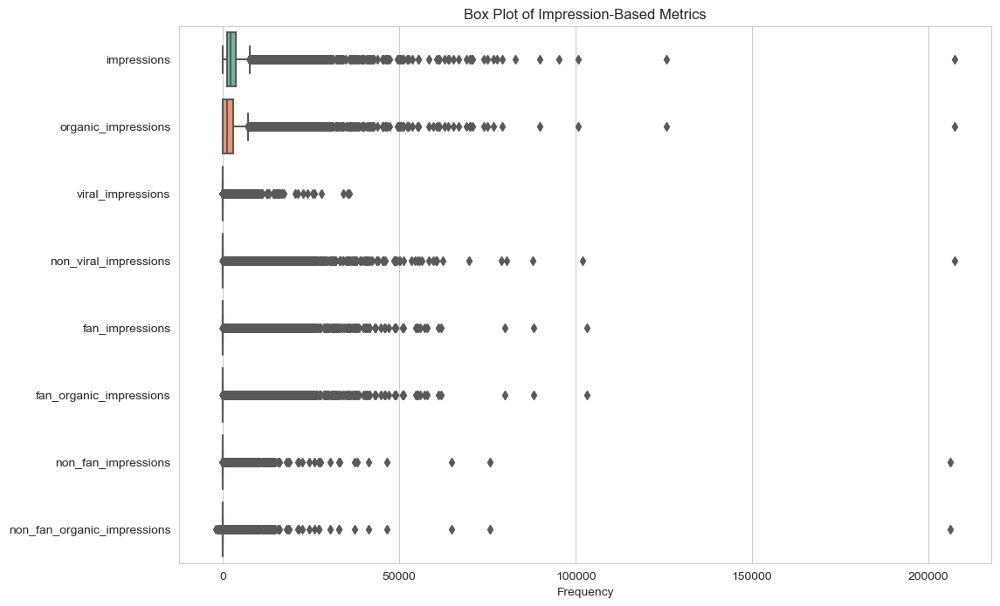

In [260]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[imp_metrics], orient="h", palette="Set2")
plt.title('Box Plot of Impression-Based Metrics')
plt.xlabel('Frequency')

plt.show()

From our analysis of the impressions-based metrics, we arrive at the following conclusions:
* All impressions-based metrics are positively correlated.
* Most impressions are organic (99%).
* All impressions have steadily increased over time.
* There is a marked spike in all impressions-based metrics from mid-2017, even though the earliest records are from 2013/ 2014.
* Tagging posts began in 2020. Tagged posts generally have lower impressions, averaging around 2500 impressions, with 2 peaks in late 2021 and early 2023.
* Fan-based and viral impressions have the lowest metric counts.
* The highest impressions come from Facebook, then Twitter, and the lowest come from LinkedIn.
* In a smoother plot, most network impressions show a normal distribution over time, except LinkedIn, whose values are closer to uniform than normal.
* When grouped by months, impressions are higher on average during the dry months (November - April) than during the wet months, with the exception of a significant spike in July. This implies seasonality in impression trends.
* On average, the lowest months for impressions are November and February.
* For non-outlier values in impression and organic impression features, the mode is around 1000 impressions. However, the mode only represents 0.04% of the non-outlier dataset.
* All impressions and their organic counterparts are 100% correlated.
* Most posts do not go viral, i.e. most posts have non-viral impressions.
* Viral impressions offer less than half the total number of impressions of non-viral impressions. This implies that the client gets most of their impressions from their own community of followers. This trend is replicated for fan/ fan-organic impressions.
* Impressions and organic impressions follow the same trend, non-viral, fan and fan-organic follow the same trend and non-fan and non-fan organic follow the same trend. This is confirmed in the correlation matrix plot.
* Viral impressions overlap with the non-fan-based impressions, although from 2020, viral impressions fall significantly lower than them. This implies that since 2020 the client has had significantly fewer viral impressions. 

**Reach Metrics**

`Reach` refers to the total number of unique users or accounts who have seen a particular piece of content posted on a social media platform. It is a metric used to gauge how far a piece of content has spread and how many people have been exposed to it. Reach is often used in conjunction with other metrics like engagement (likes, comments, shares) to assess the effectiveness of a social media marketing campaign or the popularity of a specific post.

In [261]:
rch_metrics = ['reach', 'organic_reach', 'viral_reach', 
               'non_viral_reach', 'fan_reach']

Reach metrics generally have very low values, with significant outliers.

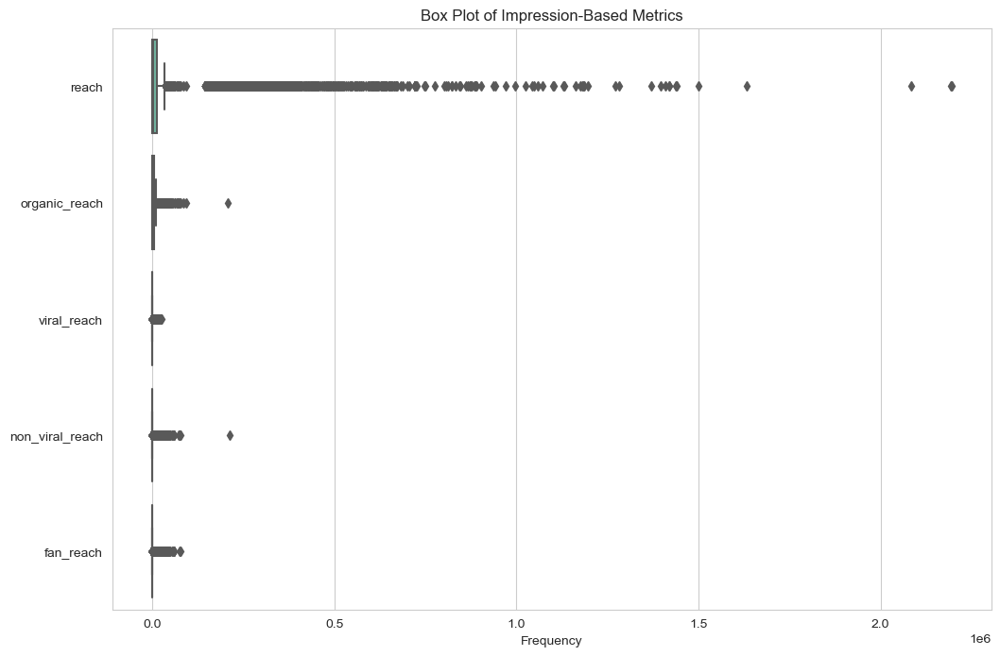

In [262]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=df[rch_metrics], orient="h", palette="Set2")
plt.title('Box Plot of Impression-Based Metrics')
plt.xlabel('Frequency')

plt.show()

There are 12842 records with outlier reach in excess of 5000, representing over 35.58% of the dataset, while there are 10,256 records with 0 reach, representing over 28.42% of the dataset.


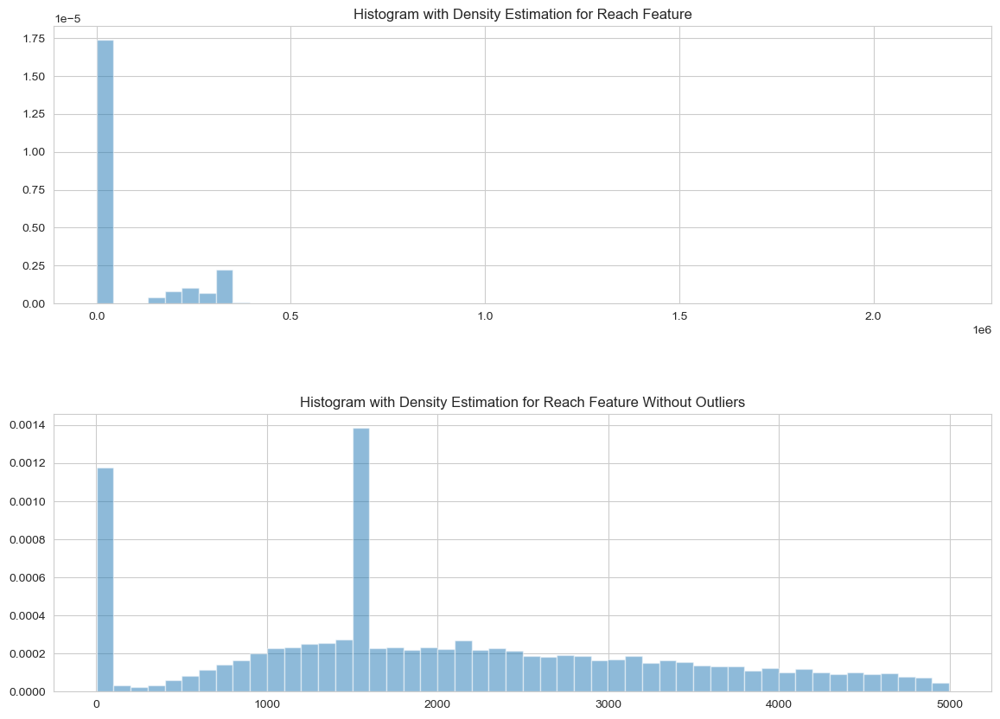

In [263]:
excess_5k = df.loc[df['reach'] > 5000, 'reach'].shape[0]
zero_vals = df.loc[df['reach'] == 0, 'reach'].shape[0]
len_df = df.shape[0]

print(f'There are {excess_5k} records with outlier reach in excess of 5000, representing over {(excess_5k/len_df)*100:.2f}% of the dataset, while there are {zero_vals:,.0f} records with 0 reach, representing over {(zero_vals/len_df)*100:.2f}% of the dataset.')

sns.set_style("whitegrid")
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

axes[0].hist(df.reach, density=True, bins=50, alpha=0.5)
axes[0].set_title('Histogram with Density Estimation for Reach Feature')

no_outliers = df.loc[df.reach.between(0, 5000, inclusive='neither'), 'reach']
axes[1].hist(no_outliers, density=True, bins=50, alpha=0.5)
axes[1].set_title('Histogram with Density Estimation for Reach Feature Without Outliers')

plt.show()

When we drop the outlier values and view the spread of this feature, we find that the values in reach are very spread throughout the dataset, with a cluster around 0 which has a density frequency of 0.1%.

`For all reach metrics except reach and potential reach, about 27k 0 values were imputed as they were missing values. This makes 0 values about 80% of the feature. We'll exclude them to see how those reach metrics are spread.`

Organic Reach:

There are 4328 records with outlier organic reach in excess of 5000, representing over 11.99% of the dataset, while there are 2,450 records with 0 organic reach, representing over 6.79% of the dataset.


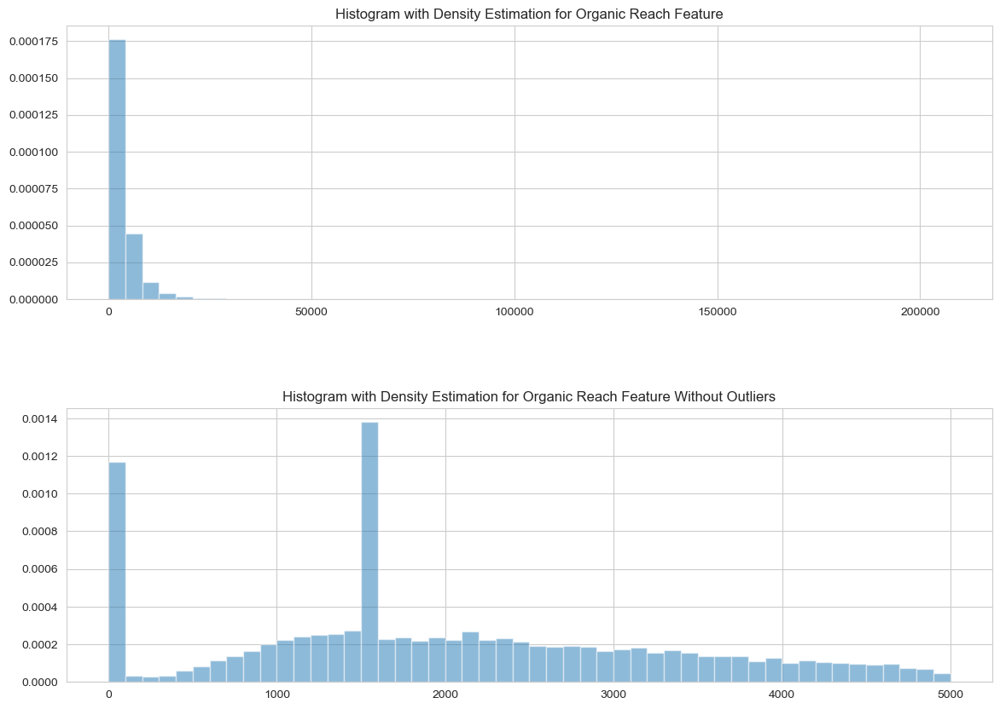

In [264]:
excess_5k = df.loc[df['organic_reach'] > 5000, 'organic_reach'].shape[0]
zero_vals = df.loc[df['organic_reach'] == 0, 'organic_reach'].shape[0]
len_df = df.shape[0]

print(f'There are {excess_5k} records with outlier organic reach in excess of 5000, representing over {(excess_5k/len_df)*100:.2f}% of the dataset, while there are {zero_vals:,.0f} records with 0 organic reach, representing over {(zero_vals/len_df)*100:.2f}% of the dataset.')

sns.set_style("whitegrid")
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

axes[0].hist(df.organic_reach, density=True, bins=50, alpha=0.5)
axes[0].set_title('Histogram with Density Estimation for Organic Reach Feature')

no_outliers = df.loc[df.organic_reach.between(0, 5000, inclusive='neither'), 'organic_reach']
axes[1].hist(no_outliers, density=True, bins=50, alpha=0.5)
axes[1].set_title('Histogram with Density Estimation for Organic Reach Feature Without Outliers')

plt.show()

This is similar to the reach metric implying that nearly all reach is organic. This histogram spread without outliers is also identical to the corresponding reach histogram. 

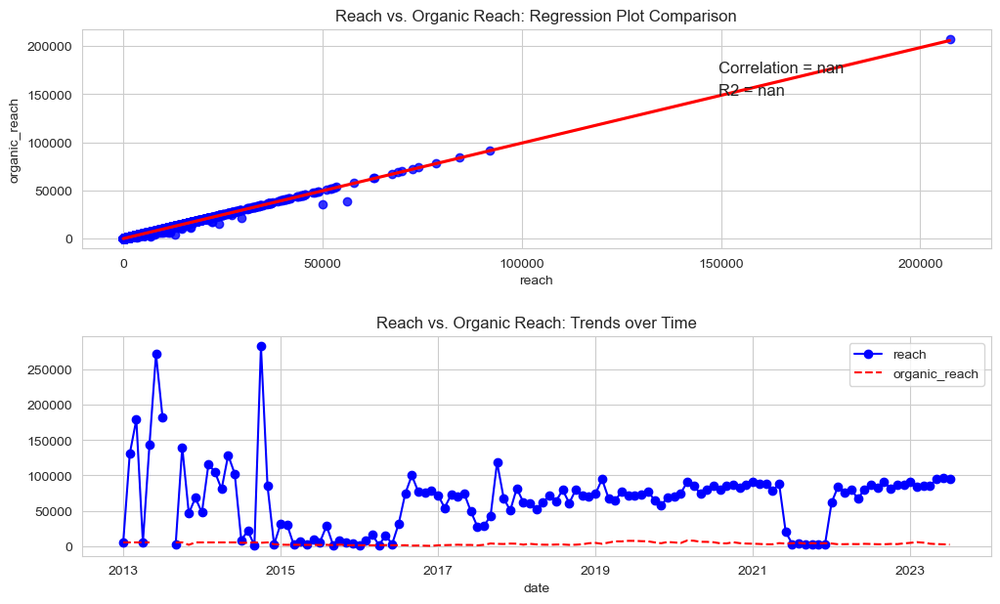

In [265]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.reach, df.organic_reach)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='reach', y='organic_reach', data=df, color='b', 
            line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.7), 
                 xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', 
                 xy=(0.7, 0.8), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Reach vs. Organic Reach: Regression Plot Comparison')

df[rch_metrics].resample('M').mean().plot(
    y=['reach', 'organic_reach'],
    style=['o-b', '--r'],
    title='Reach vs. Organic Reach: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

Viral Reach:

There are 87 records with outlier viral reach in excess of 5000, representing over 0.24% of the dataset, while there are 27,987 records with 0 viral reach, representing over 77.54% of the dataset.


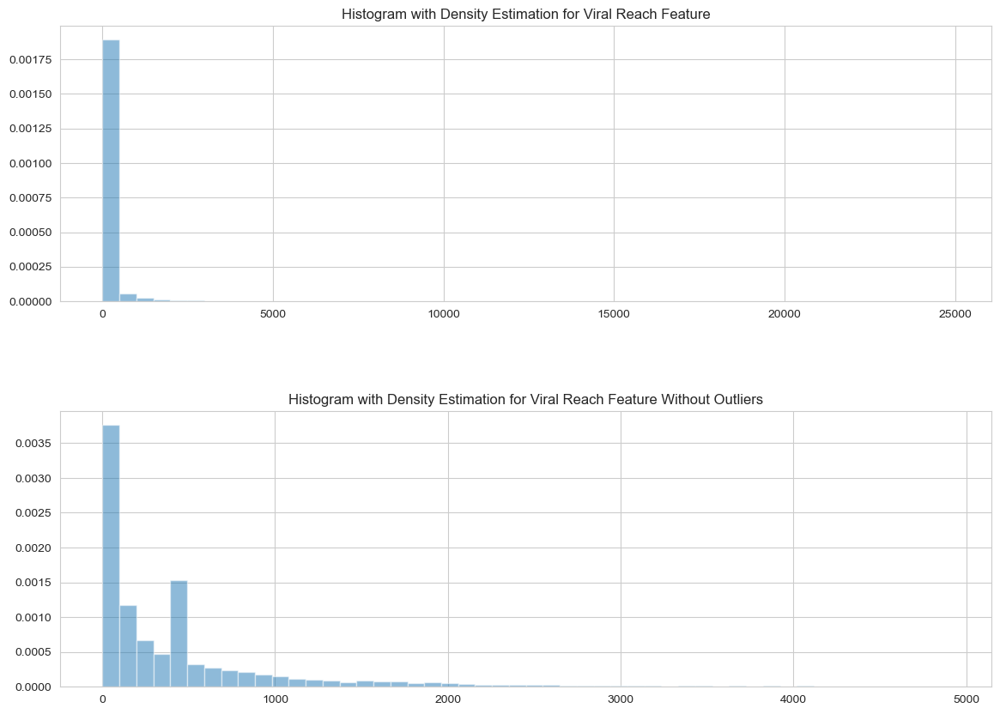

In [266]:
excess_5k = df.loc[df['viral_reach'] > 5000, 'viral_reach'].shape[0]
zero_vals = df.loc[df['viral_reach'] == 0, 'viral_reach'].shape[0]
len_df = df.shape[0]

print(f'There are {excess_5k} records with outlier viral reach in excess of 5000, representing over {(excess_5k/len_df)*100:.2f}% of the dataset, while there are {zero_vals:,.0f} records with 0 viral reach, representing over {(zero_vals/len_df)*100:.2f}% of the dataset.')

sns.set_style("whitegrid")
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

axes[0].hist(df.viral_reach, density=True, bins=50, alpha=0.5)
axes[0].set_title('Histogram with Density Estimation for Viral Reach Feature')

no_outliers = df.loc[df.viral_reach.between(0, 5000, inclusive='neither'), 'viral_reach']
axes[1].hist(no_outliers, density=True, bins=50, alpha=0.5)
axes[1].set_title('Histogram with Density Estimation for Viral Reach Feature Without Outliers')

plt.show()

Fan Reach:

There are 2612 records with outlier fan reach in excess of 5000, representing over 7.24% of the dataset, while there are 27,472 records with 0 fan reach, representing over 76.12% of the dataset.


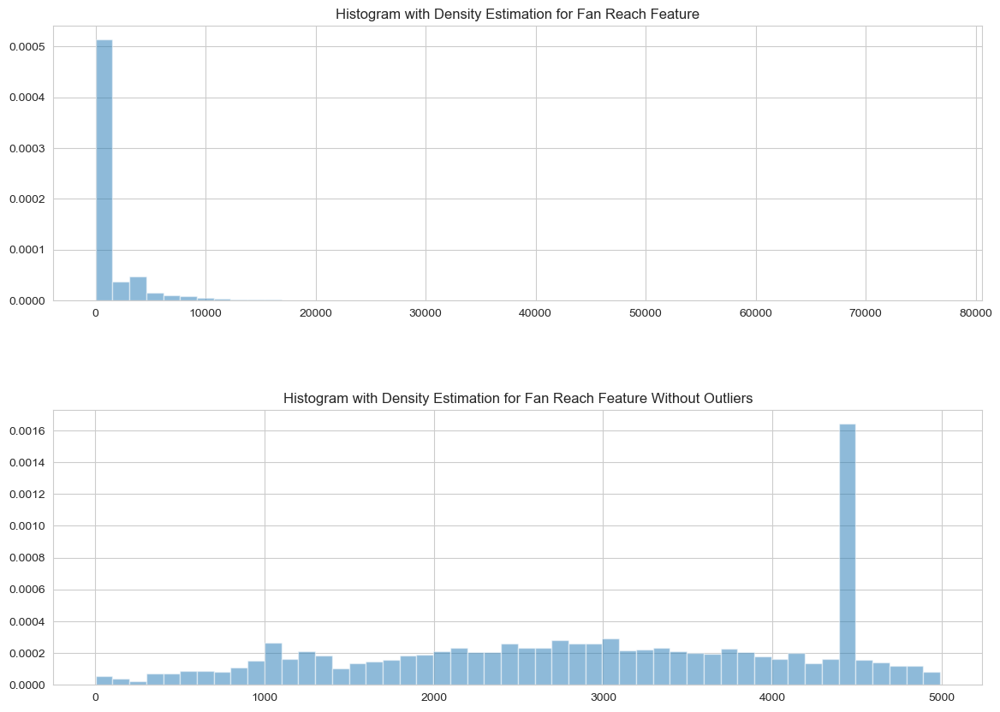

In [267]:
excess_5k = df.loc[df['fan_reach'] > 5000, 'fan_reach'].shape[0]
zero_vals = df.loc[df['fan_reach'] == 0, 'fan_reach'].shape[0]
len_df = df.shape[0]

print(f'There are {excess_5k} records with outlier fan reach in excess of 5000, representing over {(excess_5k/len_df)*100:.2f}% of the dataset, while there are {zero_vals:,.0f} records with 0 fan reach, representing over {(zero_vals/len_df)*100:.2f}% of the dataset.')

sns.set_style("whitegrid")
fig, axes = plt.subplots(2, 1, figsize=(14, 10))
fig.subplots_adjust(hspace=0.4)

axes[0].hist(df.fan_reach, density=True, bins=50, alpha=0.5)
axes[0].set_title('Histogram with Density Estimation for Fan Reach Feature')

no_outliers = df.loc[df.fan_reach.between(0, 5000, inclusive='neither'), 'fan_reach']
axes[1].hist(no_outliers, density=True, bins=50, alpha=0.5)
axes[1].set_title('Histogram with Density Estimation for Fan Reach Feature Without Outliers')

plt.show()

Reach Trends

Reach over time:

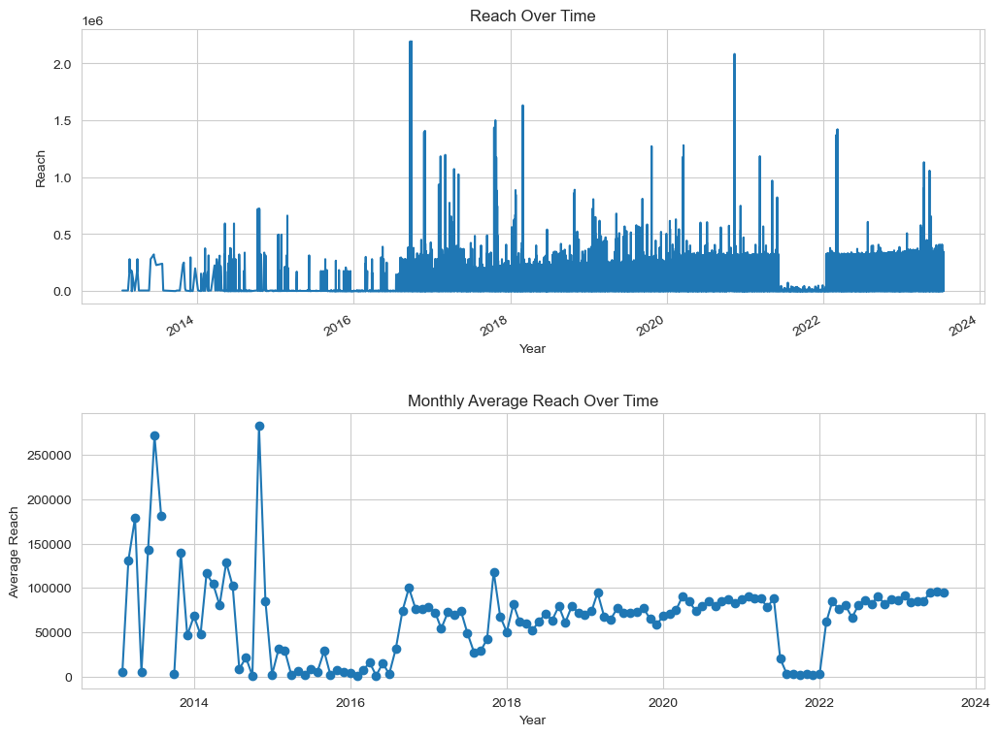

In [268]:
fig, axes = plt.subplots(2, 1, figsize=(12, 10))
fig.subplots_adjust(hspace=0.4)

sns.set_style("whitegrid")
df.reach.plot(kind='line', ax=axes[0], title='Reach Over Time', ylabel='Reach', xlabel='Year')

sns.set_style("whitegrid")
monthly_mean = df.reach.resample('M').mean()

axes[1].plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
axes[1].set_xlabel('Year')
axes[1].set_ylabel('Average Reach')
axes[1].set_title('Monthly Average Reach Over Time')

plt.show()

Text(0.5, 1.0, 'Monthly Average Reach Over Time')

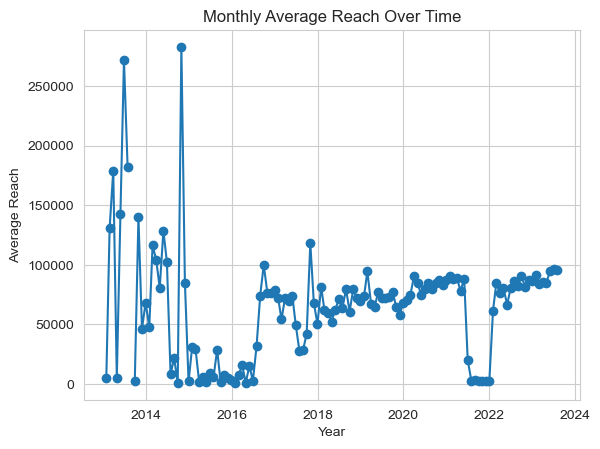

In [269]:
sns.set_style("whitegrid")
monthly_mean = df.reach.resample('M').mean()

plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Reach')
plt.title('Monthly Average Reach Over Time')

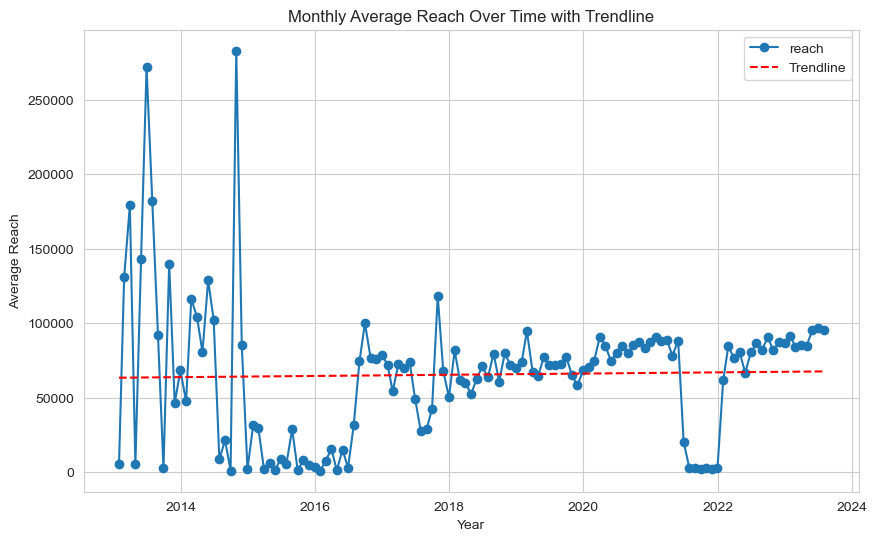

In [270]:
sns.set_style("whitegrid")
monthly_mean = df.reach.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='reach')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Reach')
plt.title('Monthly Average Reach Over Time with Trendline')
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


Average Reach Grouped by Month

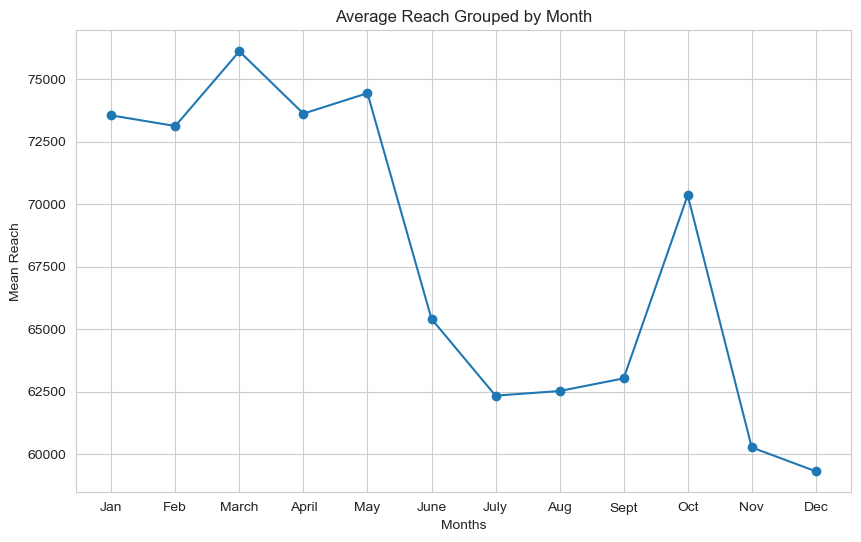

In [271]:
sns.set_style("whitegrid")
monthly_mean = df.reach.groupby(df.index.month).mean()

month_mapping = {
    1: 'Jan', 2: 'Feb', 3: 'March', 4: 'April',
    5: 'May', 6: 'June', 7: 'July', 8: 'Aug',
    9: 'Sept', 10: 'Oct', 11: 'Nov', 12: 'Dec'
}
monthly_mean.index = monthly_mean.index.map(month_mapping)

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Months')
plt.ylabel('Mean Reach')
plt.title('Average Reach Grouped by Month')
plt.show()

<Figure size 1000x600 with 0 Axes>

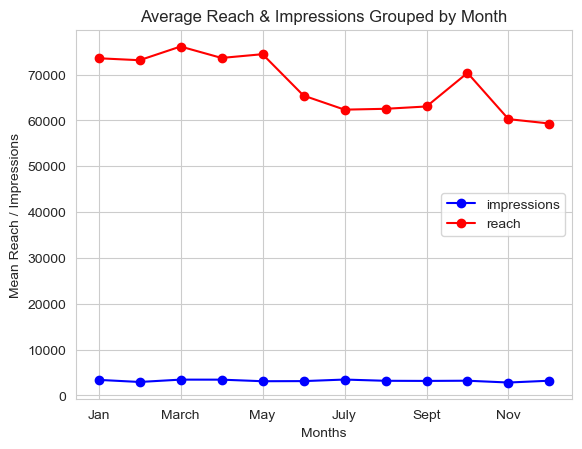

In [272]:
monthly_mean = df.groupby(df.index.month).mean(numeric_only=True)[['impressions', 'reach']]

month_mapping = {
    1: 'Jan', 2: 'Feb', 3: 'March', 4: 'April',
    5: 'May', 6: 'June', 7: 'July', 8: 'Aug',
    9: 'Sept', 10: 'Oct', 11: 'Nov', 12: 'Dec'
}
monthly_mean.index = monthly_mean.index.map(month_mapping)

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
monthly_mean.plot(
    y=['impressions', 'reach'],
    style=['o-b', 'o-r'],
    title='Average Reach & Impressions Grouped by Month'
).autoscale()
plt.xlabel('Months')
plt.ylabel('Mean Reach / Impressions')
plt.show()

Impressions and reach, grouped by month, follow the same trend. However, reach has higher values than impressions.

Average Reach grouped by Network

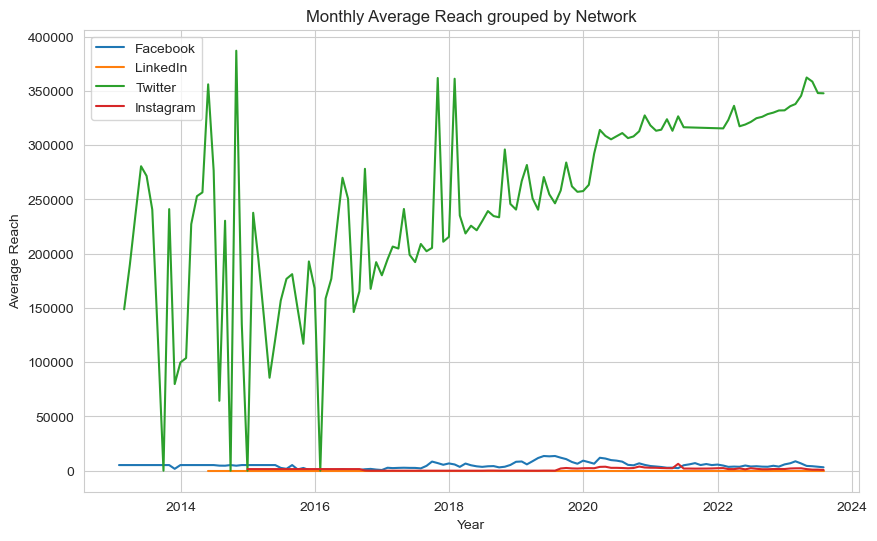

In [273]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'reach'].resample('M').mean().interpolate()
li_monthly_mean = df.loc[df.network=='LinkedIn', 'reach'].resample('M').mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'reach'].resample('M').mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'reach'].resample('M').mean().interpolate()

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(li_monthly_mean.index, li_monthly_mean, linestyle='-', label='LinkedIn')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Year')
plt.ylabel('Average Reach')
plt.title('Monthly Average Reach grouped by Network')
plt.legend()
plt.show()

LinkedIn is outstanding because the dataset does not include reach data from LinkedIn:

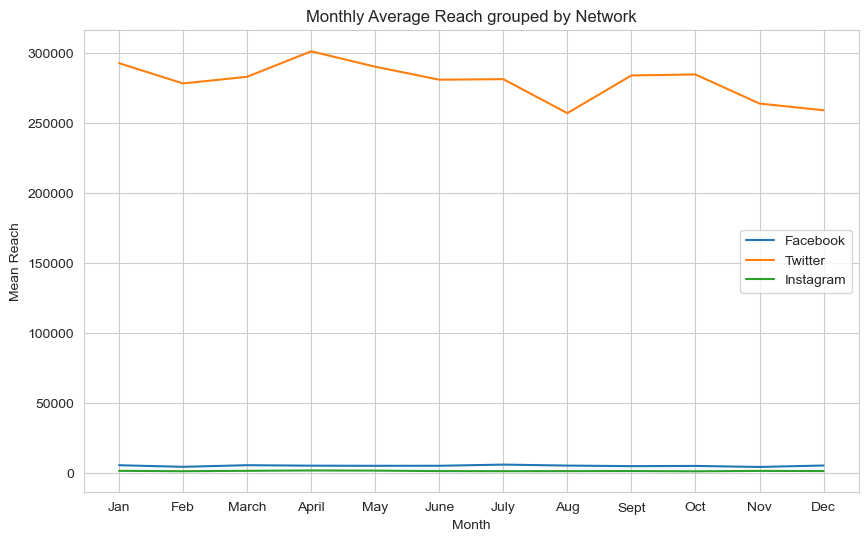

In [274]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'reach'].groupby(df.loc[df.network=='Facebook', 'reach'].index.month).mean().interpolate()
tw_monthly_mean = df.loc[df.network=='Twitter', 'reach'].groupby(df.loc[df.network=='Twitter', 'reach'].index.month).mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'reach'].groupby(df.loc[df.network=='Instagram', 'reach'].index.month).mean().interpolate()

fb_monthly_mean.index = fb_monthly_mean.index.map(month_mapping)
tw_monthly_mean.index = tw_monthly_mean.index.map(month_mapping)
ig_monthly_mean.index = ig_monthly_mean.index.map(month_mapping)

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(tw_monthly_mean.index, tw_monthly_mean, linestyle='-', label='Twitter')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Month')
plt.ylabel('Mean Reach')
plt.title('Monthly Average Reach grouped by Network')
plt.legend()
plt.show()

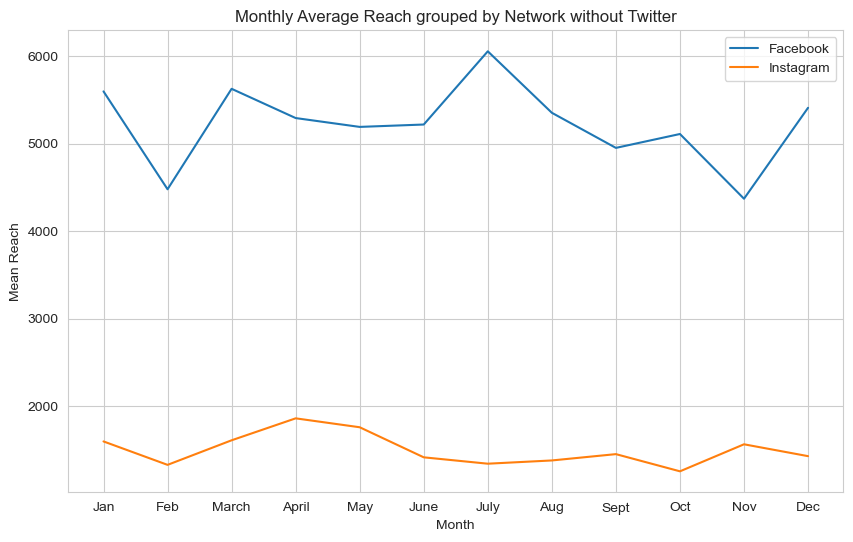

In [275]:
fb_monthly_mean = df.loc[df.network=='Facebook', 'reach'].groupby(df.loc[df.network=='Facebook', 'reach'].index.month).mean().interpolate()
ig_monthly_mean = df.loc[df.network=='Instagram', 'reach'].groupby(df.loc[df.network=='Instagram', 'reach'].index.month).mean().interpolate()

fb_monthly_mean.index = fb_monthly_mean.index.map(month_mapping)
ig_monthly_mean.index = ig_monthly_mean.index.map(month_mapping)

sns.set_style("whitegrid")
plt.figure(figsize=(10, 6))
plt.plot(fb_monthly_mean.index, fb_monthly_mean, linestyle='-', label='Facebook')
plt.plot(ig_monthly_mean.index, ig_monthly_mean, linestyle='-', label='Instagram')

plt.xlabel('Month')
plt.ylabel('Mean Reach')
plt.title('Monthly Average Reach grouped by Network without Twitter')
plt.legend()
plt.show()

Reach Trends for Records with Tags:

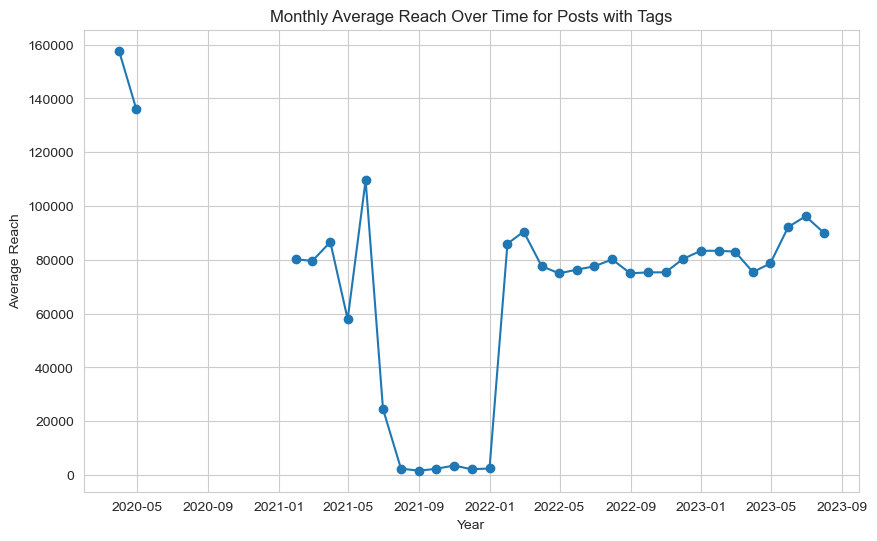

In [276]:
tag_df = df.loc[df.tags != 'no tags']
monthly_mean = tag_df.reach.resample('M').mean()

plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-')
plt.xlabel('Year')
plt.ylabel('Average Reach')
plt.title('Monthly Average Reach Over Time for Posts with Tags')
plt.show()

Reach vs. Impressions:

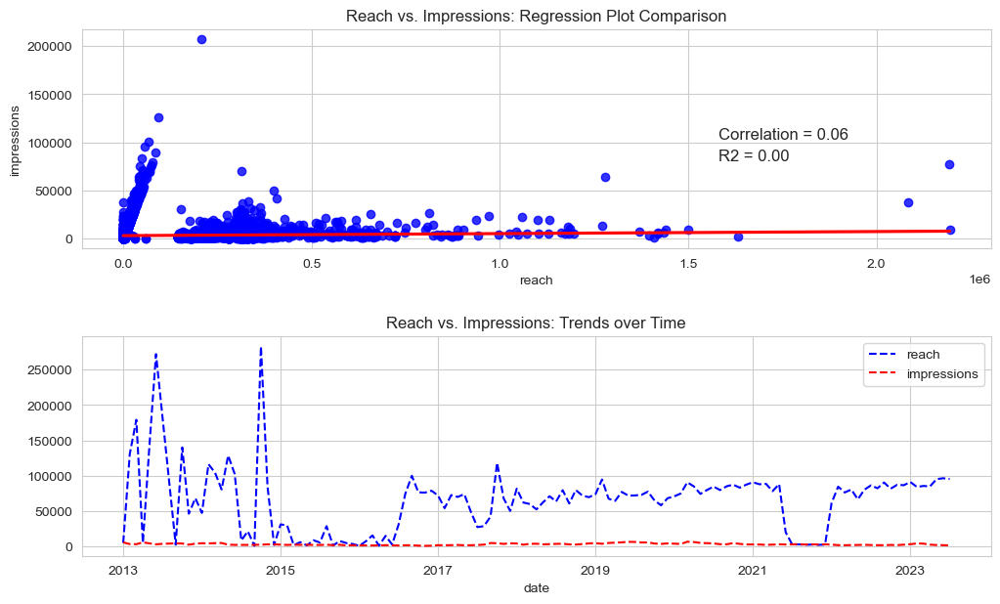

In [277]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.reach, df.impressions)
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='reach', y='impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.4), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.5), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Reach vs. Impressions: Regression Plot Comparison')

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['reach', 'impressions'],
    style=['--b', '--r'],
    title='Reach vs. Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

Let's review Twitter's Reach separate from the others, since it distorts the reach plot:

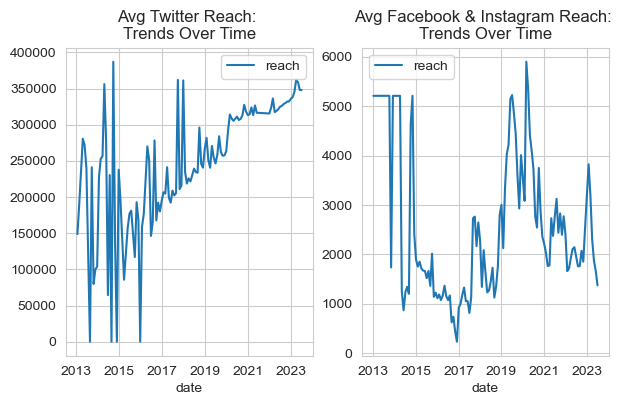

In [278]:
fig, axes = plt.subplots(1, 2, figsize=(7, 4))
fig.subplots_adjust(hspace=0.4)

df.query('network=="Twitter"').resample('M').mean(numeric_only=True).interpolate().plot(
    y='reach',
    title='Avg Twitter Reach: \nTrends Over Time',
    ax=axes[0],
    ).autoscale()

df.query('network!="Twitter"').resample('M').mean(numeric_only=True).interpolate().plot(
    y='reach',
    title='Avg Facebook & Instagram Reach: \nTrends Over Time',
    ax=axes[1],
    ).autoscale()

plt.legend()
plt.show()

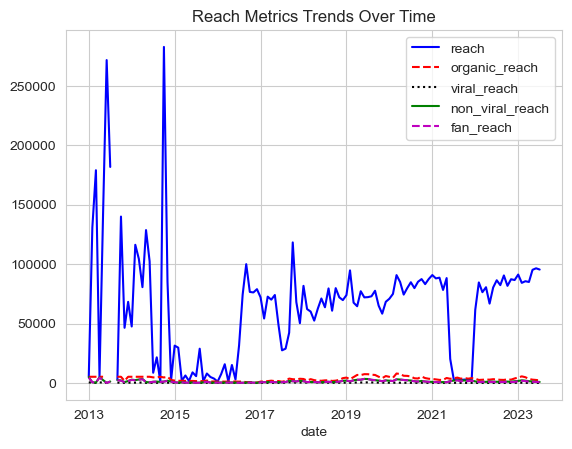

In [280]:
df[rch_metrics].resample('M').mean().plot(
    y=rch_metrics,
    style=['-b', '--r', ':k', '-g', '--m'],
    title='Reach Metrics Trends Over Time'
).autoscale()
plt.show()

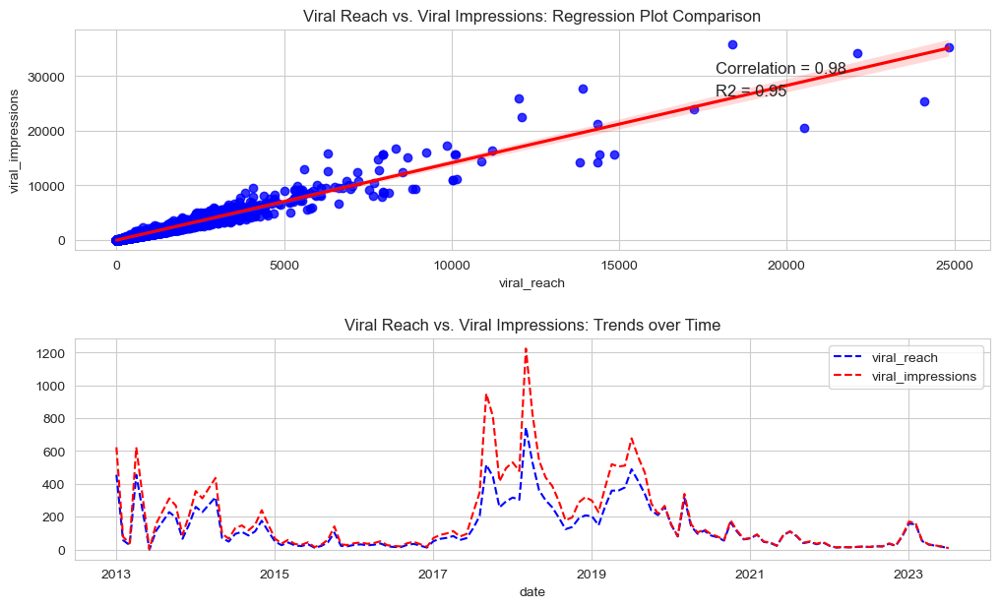

In [281]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.viral_reach.fillna(df.viral_reach.mean()), df.viral_impressions.fillna(df.viral_impressions.mean()))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='viral_reach', y='viral_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.7), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.8), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Viral Reach vs. Viral Impressions: Regression Plot Comparison')

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['viral_reach', 'viral_impressions'],
    style=['--b', '--r'],
    title='Viral Reach vs. Viral Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

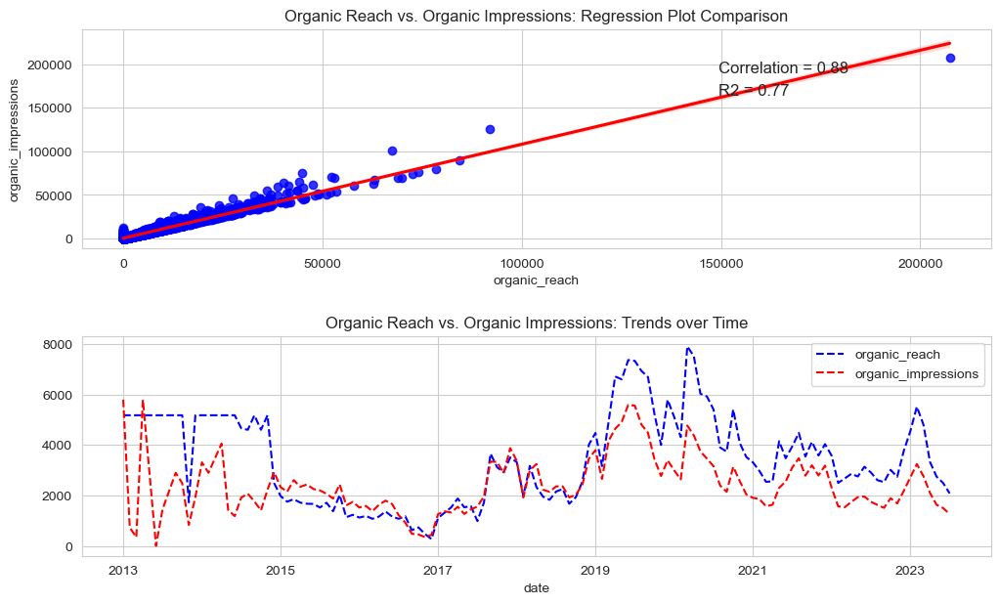

In [282]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.organic_reach.fillna(df.organic_reach.mean()), df.organic_impressions.fillna(df.organic_impressions.mean()))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='organic_reach', y='organic_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.7), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.8), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Organic Reach vs. Organic Impressions: Regression Plot Comparison')

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['organic_reach', 'organic_impressions'],
    style=['--b', '--r'],
    title='Organic Reach vs. Organic Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

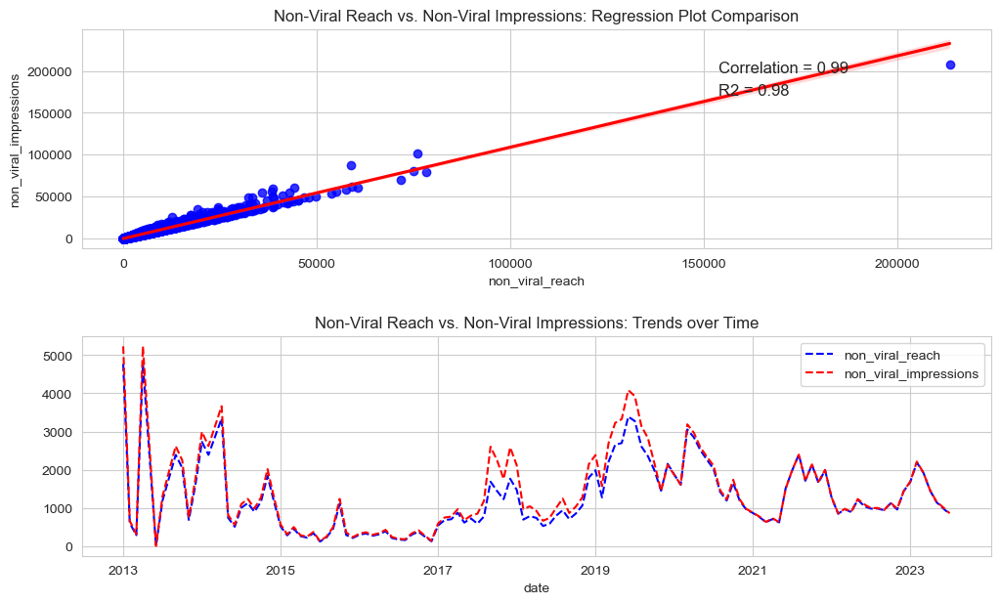

In [283]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.non_viral_reach.fillna(df.non_viral_reach.mean()), df.non_viral_impressions.fillna(df.non_viral_impressions.mean()))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='non_viral_reach', y='non_viral_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.7), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.8), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Non-Viral Reach vs. Non-Viral Impressions: Regression Plot Comparison')

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['non_viral_reach', 'non_viral_impressions'],
    style=['--b', '--r'],
    title='Non-Viral Reach vs. Non-Viral Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

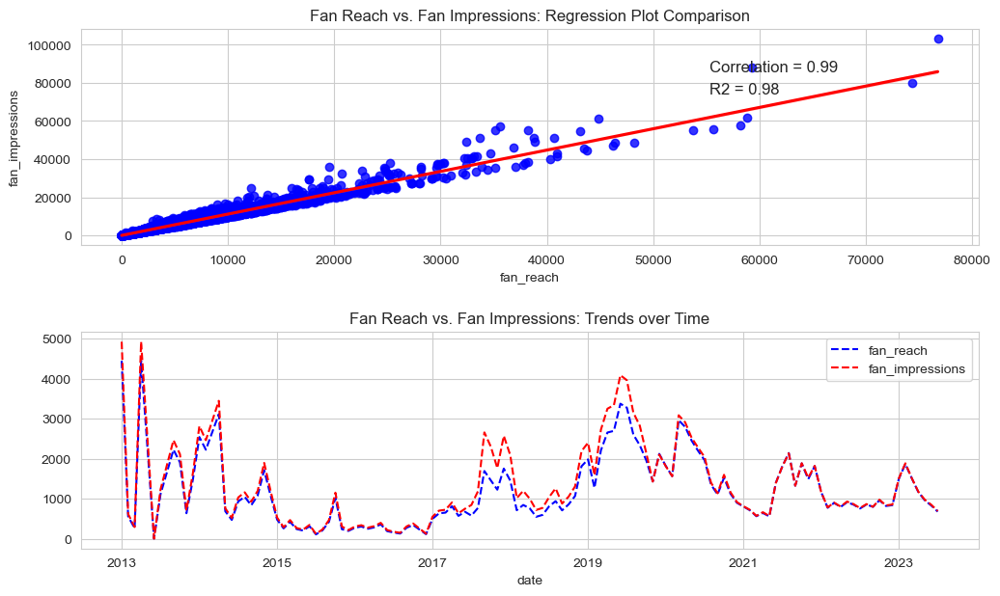

In [284]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4)

slope, intercept, r_value, p_value, std_err = stats.linregress(df.fan_reach.fillna(df.fan_reach.mean()), df.fan_impressions.fillna(df.fan_impressions.mean()))
r_squared = r_value**2
correlation_coefficient = r_value

sns.regplot(x='fan_reach', y='fan_impressions', data=df, color='b', line_kws=dict(color="r"), ax=axes[0])
axes[0].annotate(f'R2 = {r_squared:.2f}', xy=(0.7, 0.7), xycoords='axes fraction', fontsize=12)
axes[0].annotate(f'Correlation = {correlation_coefficient:.2f}', xy=(0.7, 0.8), xycoords='axes fraction', fontsize=12)
axes[0].set_title('Fan Reach vs. Fan Impressions: Regression Plot Comparison')

df.resample('M').mean(numeric_only=True).interpolate().plot(
    y=['fan_reach', 'fan_impressions'],
    style=['--b', '--r'],
    title='Fan Reach vs. Fan Impressions: Trends over Time',
    ax=axes[1]
).autoscale()

plt.show()

Reach Metrics Pearson Correlation:

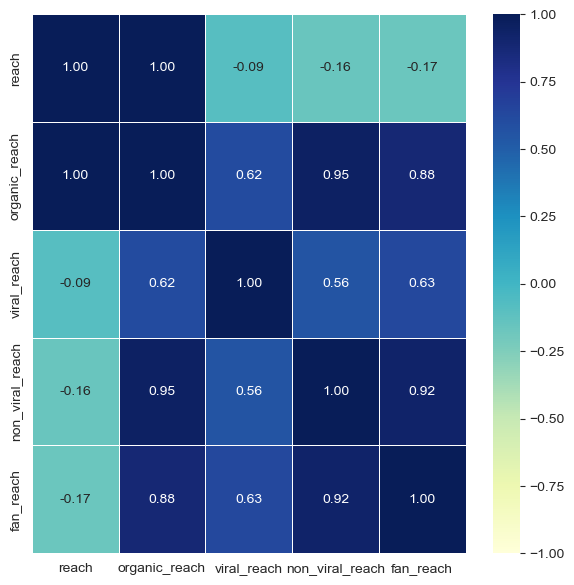

In [285]:
plt.figure(figsize=(7, 7))
sns.heatmap(
    df[rch_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Reach Metrics Spearman Correlation:

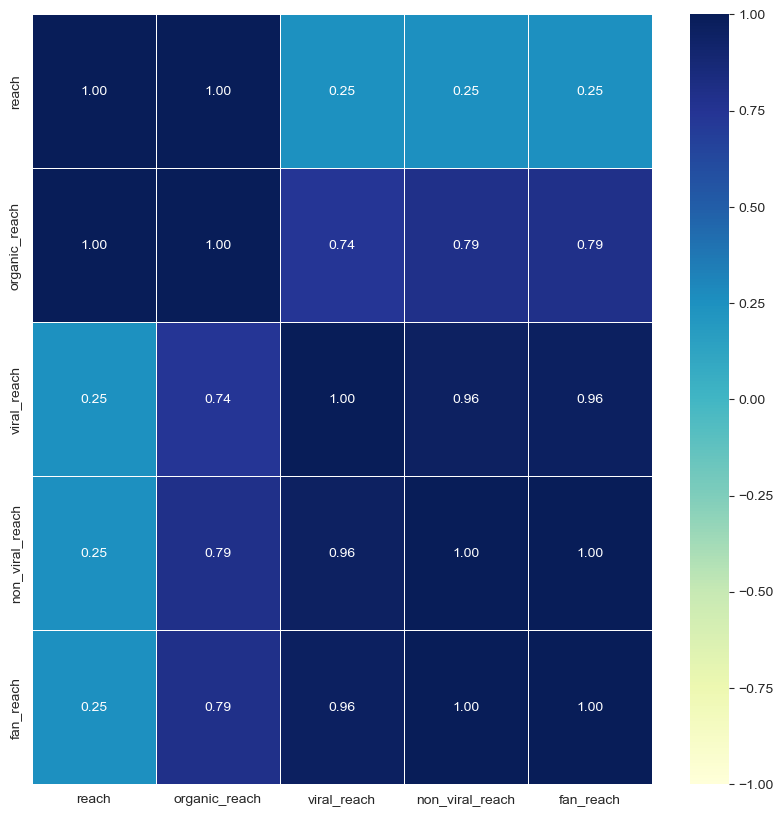

In [286]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[rch_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Reach & Impression Metrics Pearson Correlation:

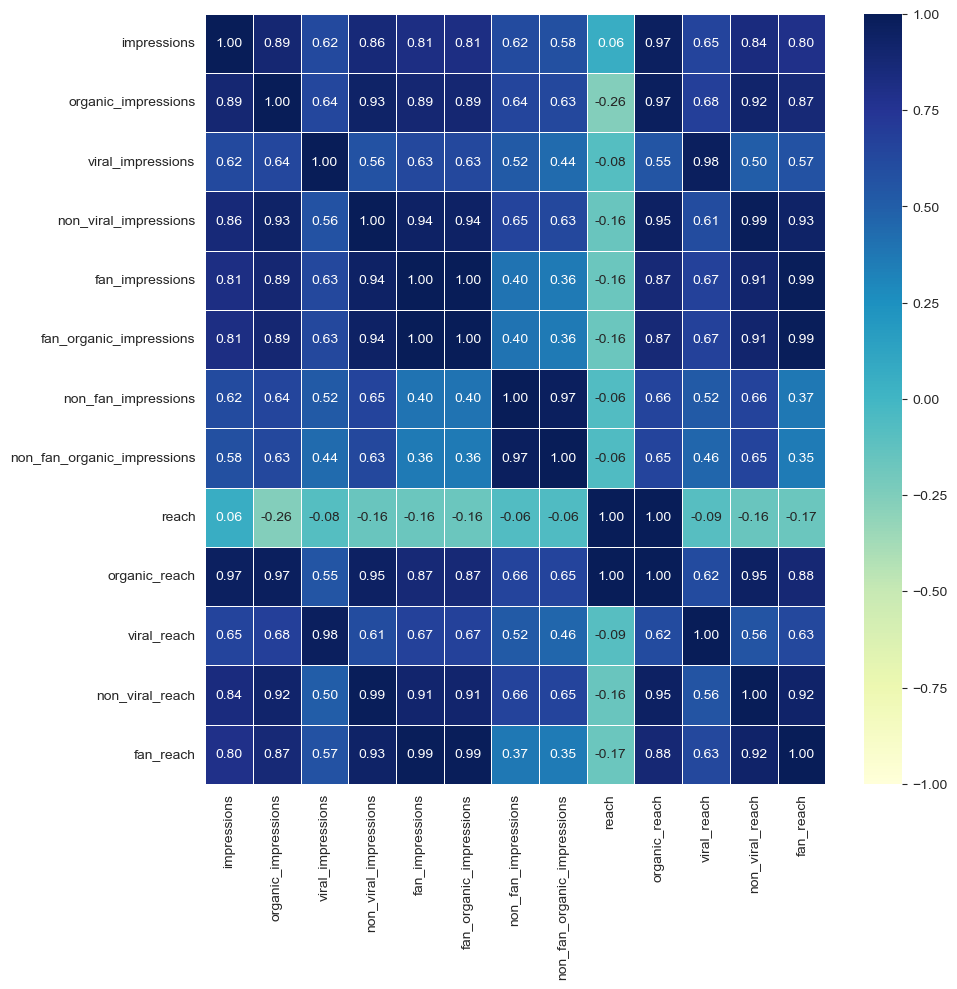

In [287]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[imp_metrics + rch_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Reach & Impression Metrics Spearman Correlation:

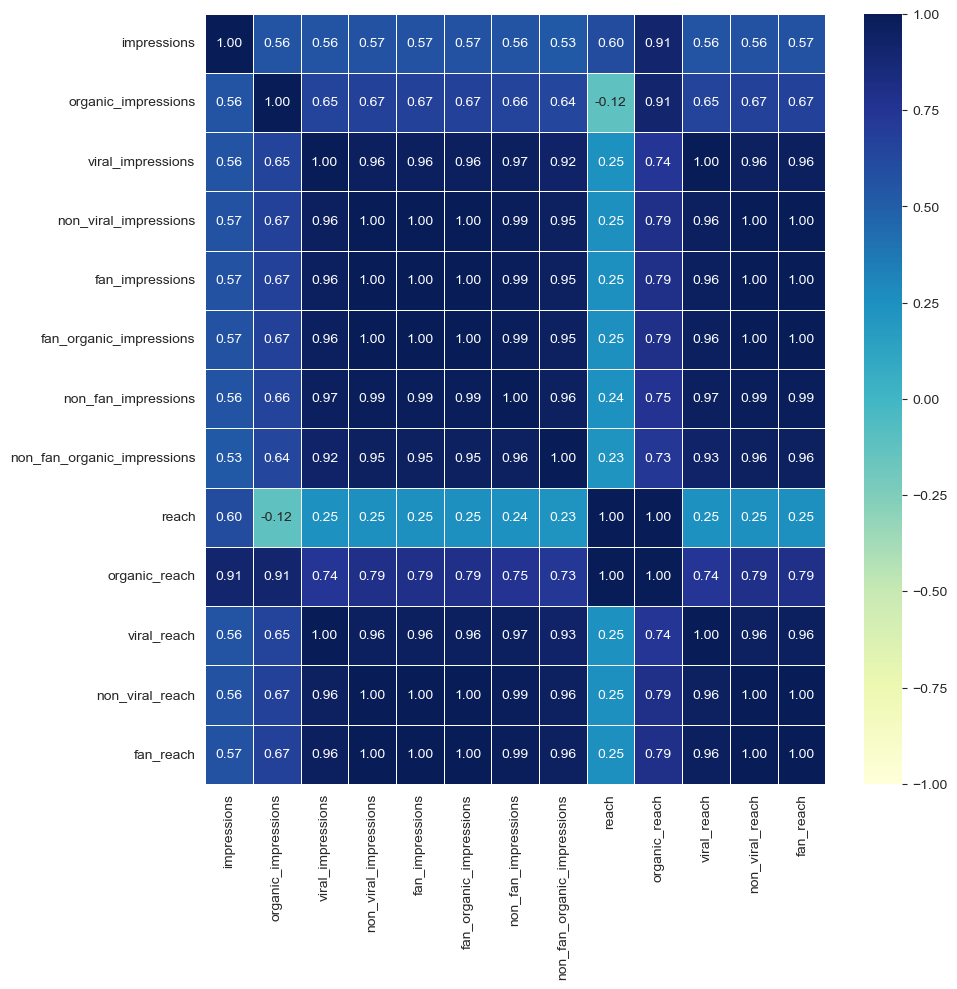

In [288]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[imp_metrics + rch_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

From our analysis of the reach-based metrics, we arrive at the following conclusions:
* Reach refers to the total number of unique users or accounts who have seen your content at least once. It counts the distinct individuals or profiles that have been exposed to your content.
* It differs from impressions in that it tracks distinct users who engaged with a particular piece of content as opposed to the number of times such content was viewed, which views maye repeat views by the same user.
* Reach gauges how far a piece of content has spread and how many people have been exposed to it.
* Our dataset has 6 reach-related metrics, with most valued clustered around 0 and with significant outliers. 
* Most of the features in reach metrics have similar spreads, except `potential reach` which has really large value outliers.
* As with impressions, reach and organic reach are correlated with a r2 of 1, meaning all reach is organic. 
* For viral and fan reach, about 80% of values are 0, of which over 90% were imputed.
* The distribution of reach and organic reach, without outliers, have wide normal distributions, and a long head around 0.
* The trend lines for reach, monthly average reach and average reach grouped by months are identical to the corresponding impressions trend. 
* However, reach values are lower than impression values, except for viral, non-viral and fan reach and impressions where the values significantly overlap.
* There is a strong positive correlation between a reach metric and its corresponding impression metric. 
* Potential reach is not correlated with other reach and impression metrics, except impressions and organic impressions. 
* When grouped by network, we find that all reach data is from Facebook and Instagram. 

**Engagement Metrics**

In [289]:
eng_metrics = ['engagement_rate_per_impression',
               'engagement_rate_per_reach', 'engagements']

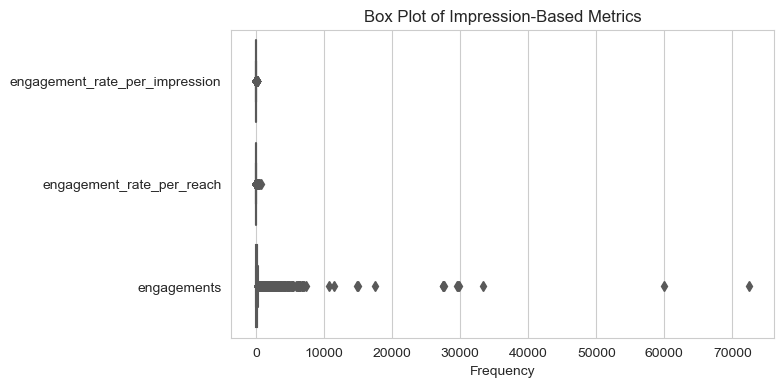

In [290]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df[eng_metrics], orient="h", palette="Set2")
plt.title('Box Plot of Impression-Based Metrics')
plt.xlabel('Frequency')

plt.show()

Engagement Metrics without Engagements Feature:

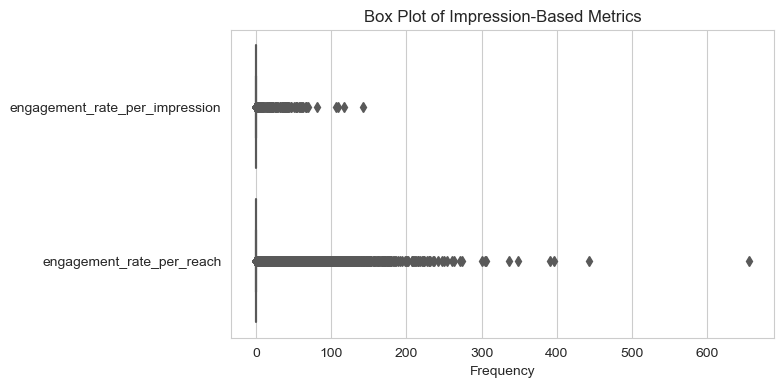

In [291]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df[['engagement_rate_per_impression', 'engagement_rate_per_reach']], orient="h", palette="Set2")
plt.title('Box Plot of Impression-Based Metrics')
plt.xlabel('Frequency')

plt.show()

Trends in Engagement-Based Metrics

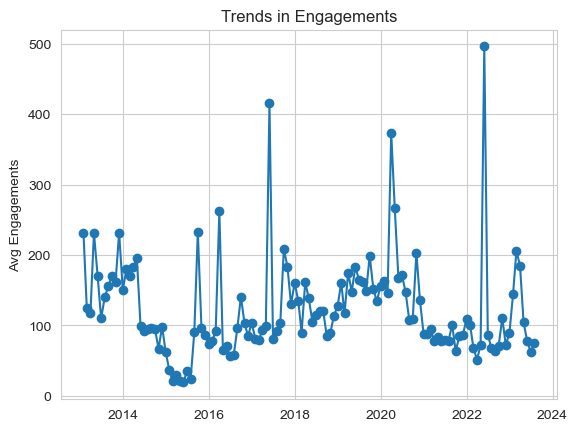

In [292]:
monthly_mean = df.engagements.resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, marker='o', 
         linestyle='-', label='engagements')
plt.ylabel('Avg Engagements')
plt.title('Trends in Engagements')
plt.show()

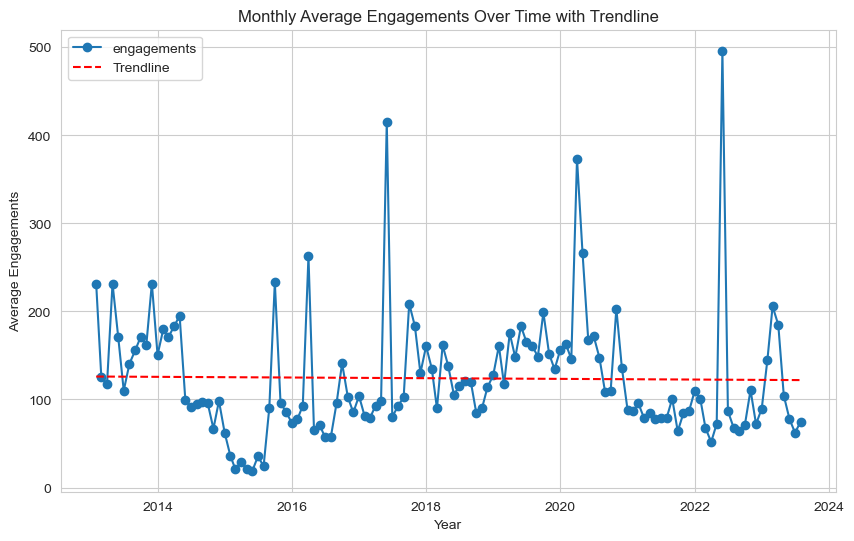

In [293]:
sns.set_style("whitegrid")
monthly_mean = df.engagements.resample('M').mean().interpolate()

# Create the line plot for the original data
plt.figure(figsize=(10, 6))
plt.plot(monthly_mean.index, monthly_mean, marker='o', linestyle='-', label='engagements')

# Fit a linear trendline using NumPy's polyfit
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients

# Create a line plot for the trendline
trendline_values = slope * x_values + intercept
# Convert back to datetime
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', linestyle='--', color='red')

# Add labels and a legend (optional)
plt.xlabel('Year')
plt.ylabel('Average Engagements')
plt.title('Monthly Average Engagements Over Time with Trendline')
plt.legend()

# Show the plot
plt.grid(True)
plt.show()


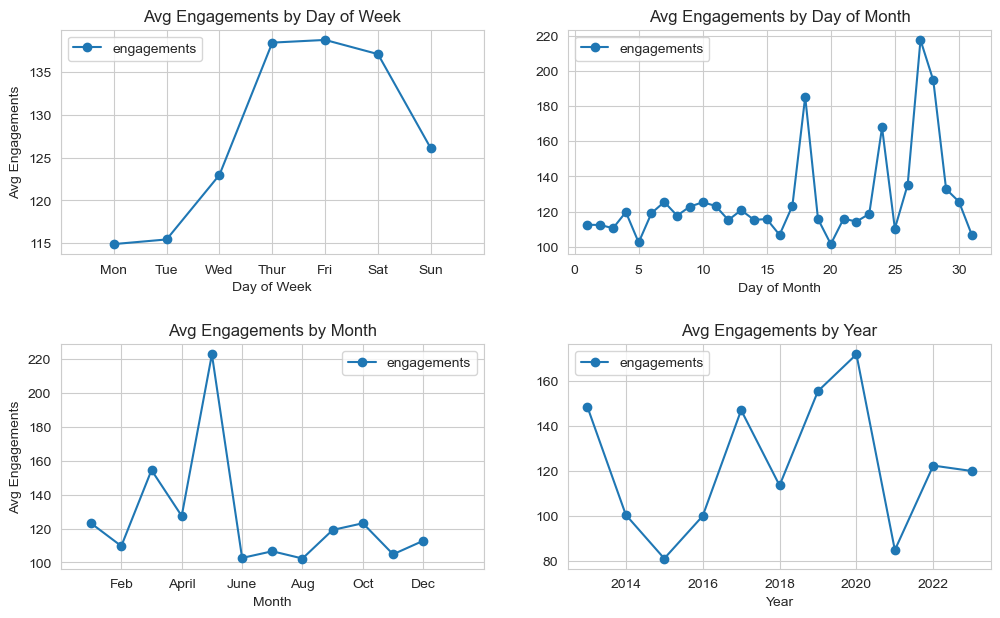

In [294]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)['engagements'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Engagements', linestyle='-', 
    marker='o', title='Avg Engagements by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)['engagements'].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', linestyle='-', 
    marker='o', title='Avg Engagements by Day of Month',
    ax=axes.ravel()[1]
)

df.groupby(df.index.month)['engagements'].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Engagements', linestyle='-', 
    marker='o', title='Avg Engagements by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])

df.groupby(df.index.year)['engagements'].mean().reset_index().set_index('date').plot(
    xlabel='Year', linestyle='-', 
    marker='o', title='Avg Engagements by Year',
    ax=axes.ravel()[3]
)

plt.show()

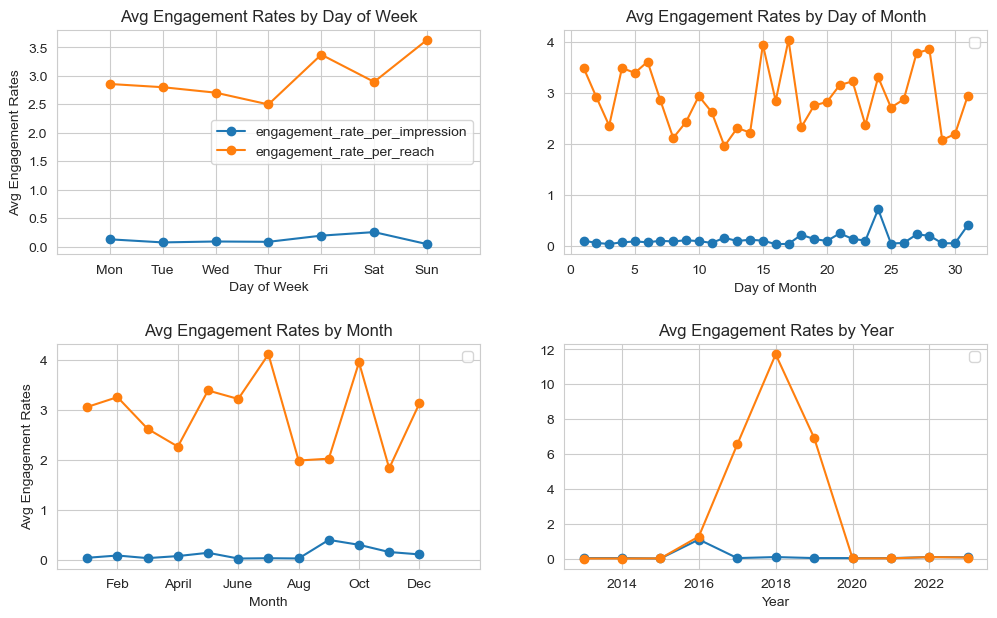

In [295]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

df.groupby(df.index.dayofweek)[['engagement_rate_per_impression', 'engagement_rate_per_reach']].mean().reset_index().set_index('date').plot(
    xlabel='Day of Week', ylabel='Avg Engagement Rates', linestyle='-', 
    marker='o', title='Avg Engagement Rates by Day of Week', 
    ax=axes.ravel()[0]
)
xticks = axes.ravel()[0].get_xticks()
axes.ravel()[0].set_xticks(xticks)
axes.ravel()[0].set_xticklabels(['', 'Mon', 'Tue', 'Wed', 'Thur', 'Fri', 'Sat', 'Sun', ''])


df.groupby(df.index.day)[['engagement_rate_per_impression', 'engagement_rate_per_reach']].mean().reset_index().set_index('date').plot(
    xlabel='Day of Month', linestyle='-', 
    marker='o', title='Avg Engagement Rates by Day of Month',
    ax=axes.ravel()[1]
)
axes.ravel()[1].legend('')

df.groupby(df.index.month)[['engagement_rate_per_impression', 'engagement_rate_per_reach']].mean().reset_index().set_index('date').plot(
    xlabel='Month', ylabel='Avg Engagement Rates', linestyle='-', 
    marker='o', title='Avg Engagement Rates by Month',
    ax=axes.ravel()[2]
)
xticks = axes.ravel()[2].get_xticks()
axes.ravel()[2].set_xticks(xticks)
axes.ravel()[2].set_xticklabels(['', 'Feb', 'April', 'June', 
                                 'Aug', 'Oct', 'Dec', ''])
axes.ravel()[2].legend('')

df.groupby(df.index.year)[['engagement_rate_per_impression', 'engagement_rate_per_reach']].mean().reset_index().set_index('date').plot(
    xlabel='Year', linestyle='-', 
    marker='o', title='Avg Engagement Rates by Year',
    ax=axes.ravel()[3]
)
axes.ravel()[3].legend('')

plt.show()

**Reaction Metrics**

Beyond Reactions and Likes, all other reactions are Facebook based, so we'll restrict this portion of the analysis to Facebook:

In [296]:
rct_metrics = ['reactions', 'likes', 'love_reactions',
               'haha_reactions', 'wow_reactions', 'sad_reactions', 
               'angry_reactions', 'unique_reactions']

In [297]:
for i in df.network.unique():
    print(i)
    for j in rct_metrics:
        print(j, df.loc[df.network==i, j].mean())
    print('\n')

Facebook
reactions 91.88698976723266
likes 89.1085123130552
love_reactions 2.30574609243225
haha_reactions 0.1581018778814798
wow_reactions 0.1292027437310244
sad_reactions 0.033959293826605196
angry_reactions 0.15146744630608344
unique_reactions 58.73372315304171


Twitter
reactions 20.21015047181841
likes 20.21015047181841
love_reactions 0.0
haha_reactions 0.0
wow_reactions 0.0
sad_reactions 0.0
angry_reactions 0.0
unique_reactions 0.0


LinkedIn
reactions 15.752684775742262
likes 15.752684775742262
love_reactions 0.0
haha_reactions 0.0
wow_reactions 0.0
sad_reactions 0.0
angry_reactions 0.0
unique_reactions 0.0


Instagram
reactions 90.8868
likes 90.8868
love_reactions 0.0
haha_reactions 0.0
wow_reactions 0.0
sad_reactions 0.0
angry_reactions 0.0
unique_reactions 0.0




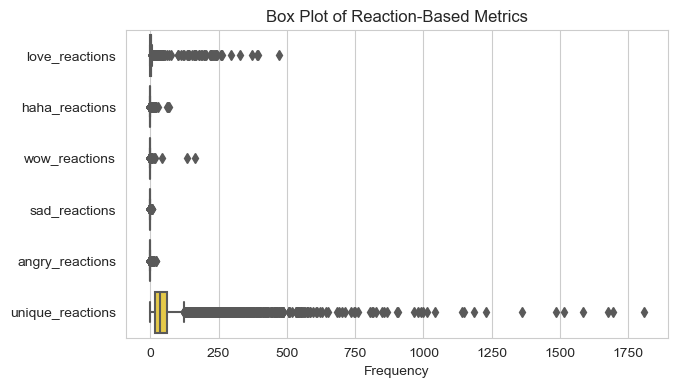

In [298]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Facebook"')[rct_metrics[2:]], orient="h", palette="Set2")
plt.title('Box Plot of Reaction-Based Metrics')
plt.xlabel('Frequency')

plt.show()

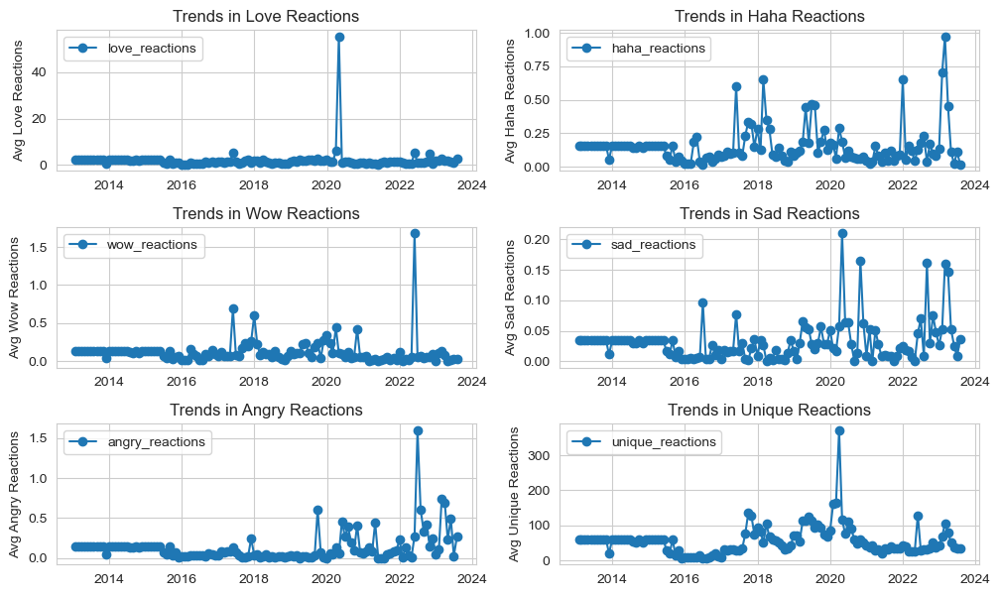

In [299]:
fig, axes = plt.subplots(3, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(rct_metrics[2:], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

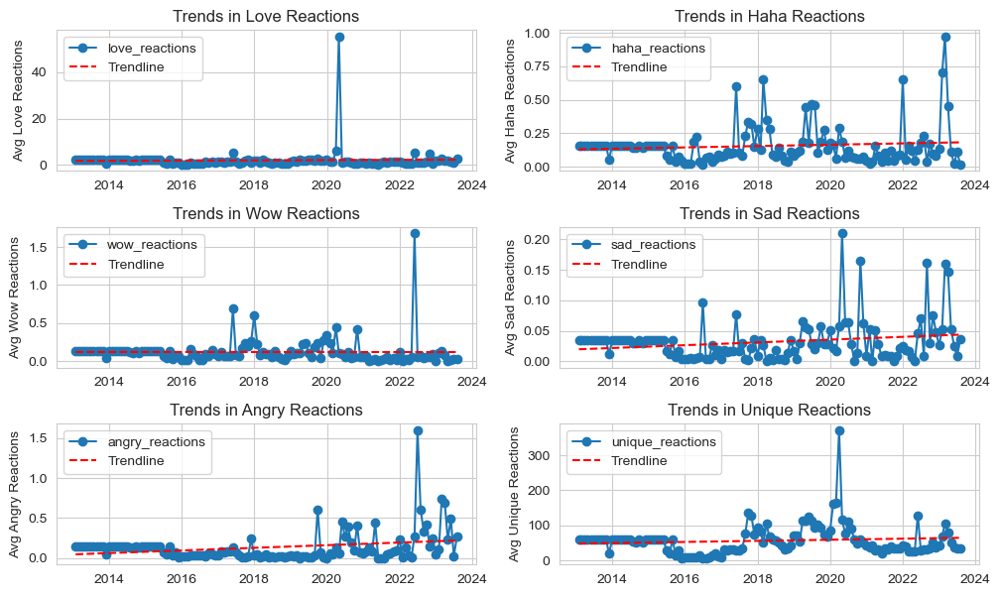

In [300]:
fig, axes = plt.subplots(3, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(rct_metrics[2:], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

While most trendlines seem flat, sad and angry reaction see a slight uptick. Let's delve deeper:

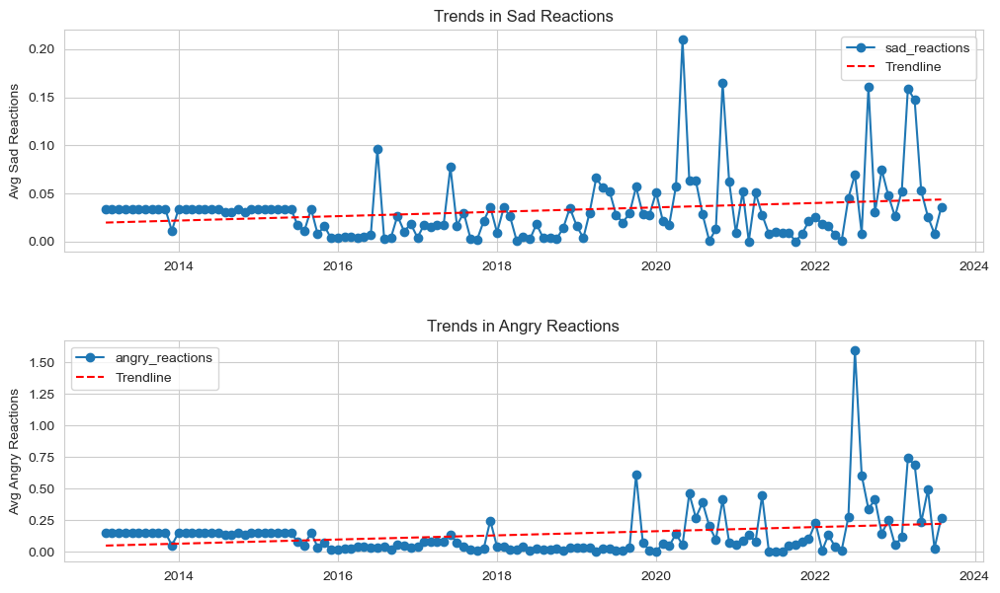

In [301]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(['sad_reactions', 'angry_reactions'], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

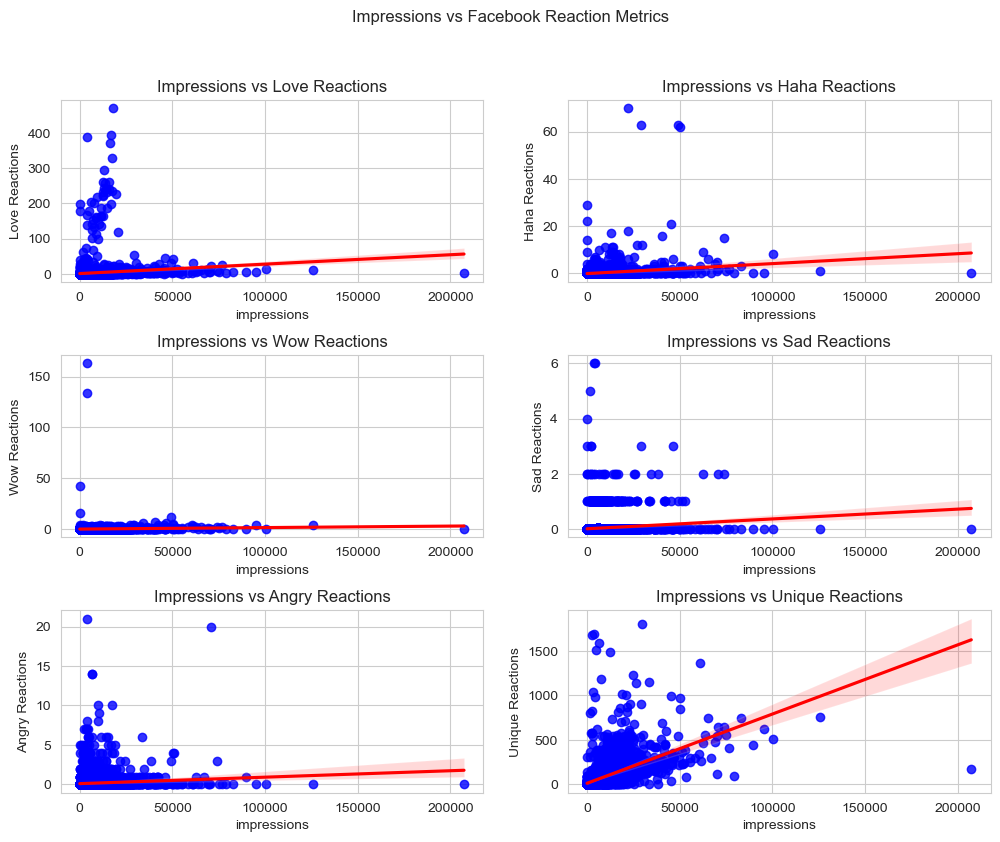

In [302]:
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(rct_metrics[2:], axes.ravel()):
    sns.regplot(x='impressions', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Impressions vs {i.replace("_", " ").title()}')
plt.suptitle('Impressions vs Facebook Reaction Metrics')
plt.show()

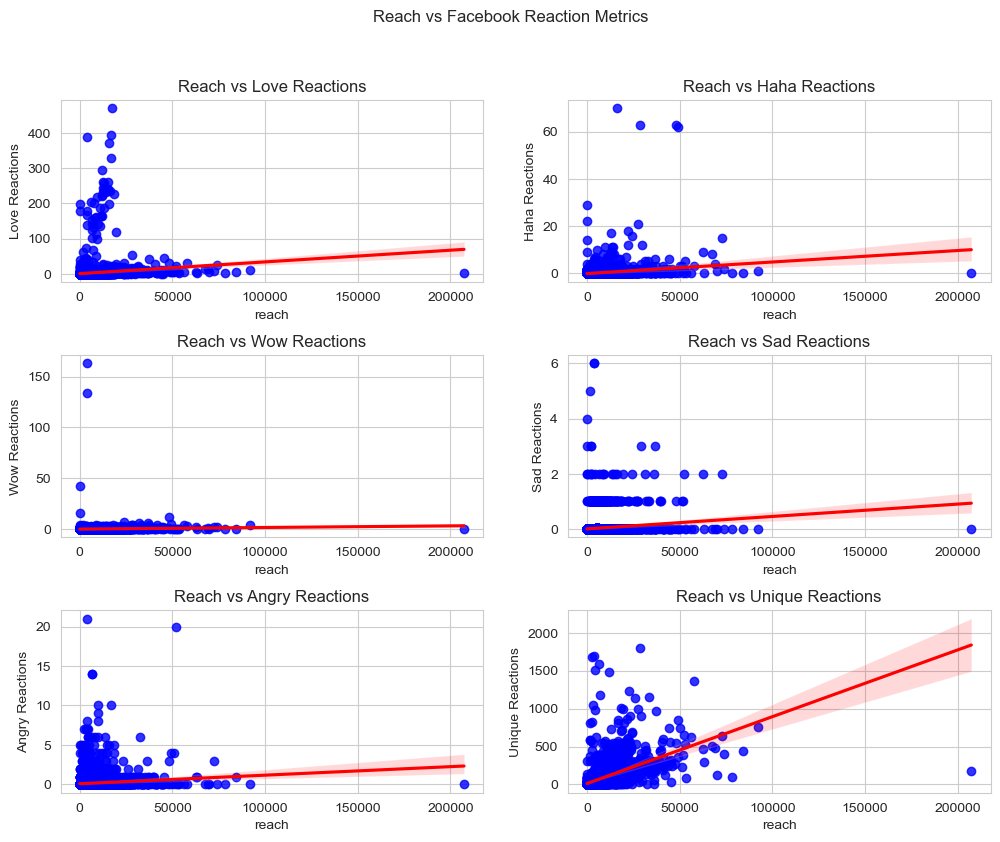

In [303]:
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(rct_metrics[2:], axes.ravel()):
    sns.regplot(x='reach', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Reach vs {i.replace("_", " ").title()}')
plt.suptitle('Reach vs Facebook Reaction Metrics')
plt.show()

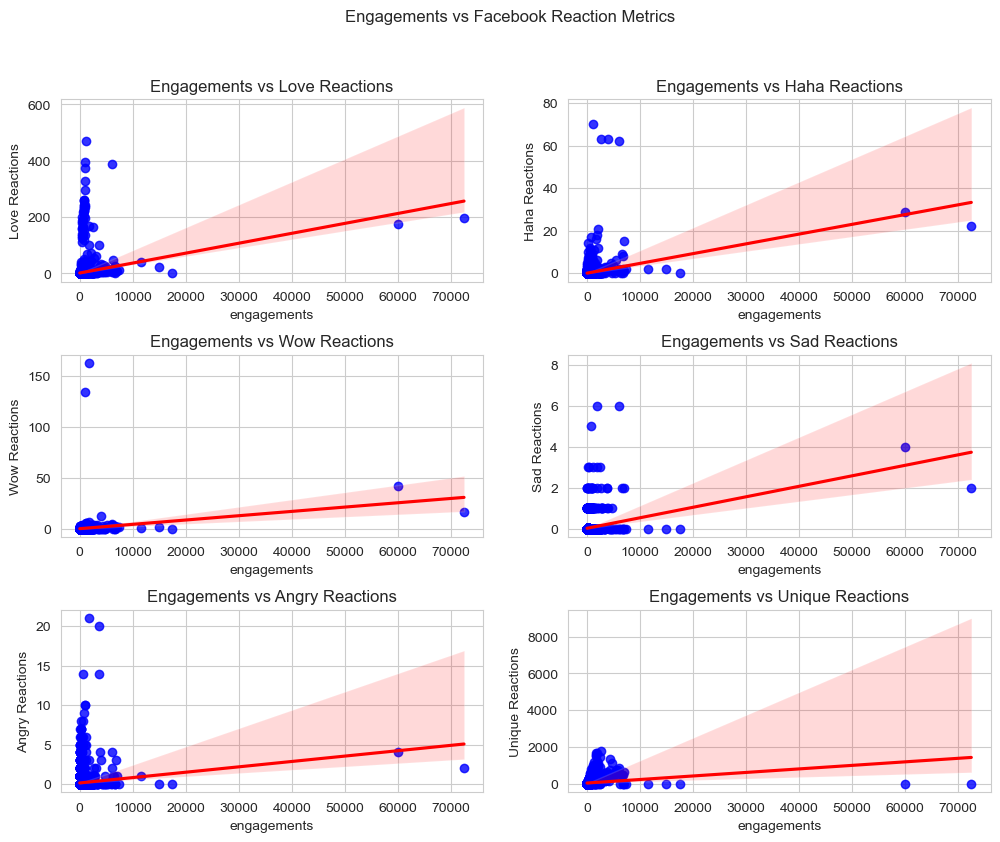

In [304]:
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(rct_metrics[2:], axes.ravel()):
    sns.regplot(x='engagements', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Engagements vs {i.replace("_", " ").title()}')
plt.suptitle('Engagements vs Facebook Reaction Metrics')
plt.show()

In [305]:
rct_metrics

['reactions',
 'likes',
 'love_reactions',
 'haha_reactions',
 'wow_reactions',
 'sad_reactions',
 'angry_reactions',
 'unique_reactions']

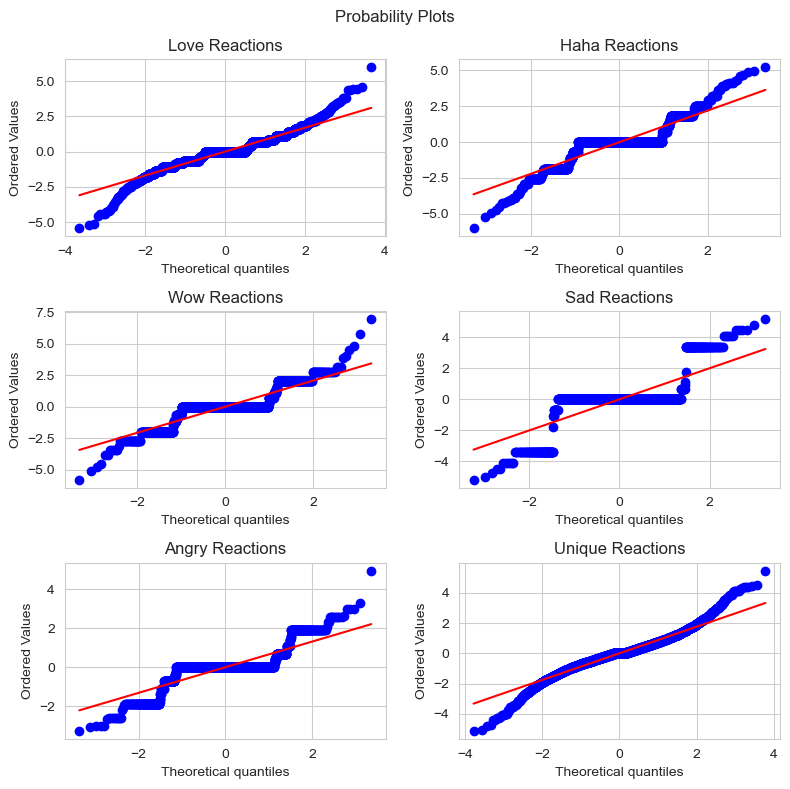

In [306]:
lov = df.query('network=="Facebook"').love_reactions
lov = np.diff(np.log(lov[lov > 0]))

hah = df.query('network=="Facebook"').haha_reactions
hah = np.diff(np.log(hah[hah > 0]))

wow = df.query('network=="Facebook"').wow_reactions
wow = np.diff(np.log(wow[wow > 0]))

sad = df.query('network=="Facebook"').sad_reactions
sad = np.diff(np.log(sad[sad > 0]))

ang = df.query('network=="Facebook"').angry_reactions
ang = np.diff(np.log(ang[ang > 0]))

uni = df.query('network=="Facebook"').unique_reactions
uni = np.diff(np.log(uni[uni > 0]))

fig, axes = plt.subplots(3, 2, figsize=(8, 8))
for ax, i, name in zip(axes.ravel(), [lov, hah, wow, sad, ang, uni], 
                       ['Love Reactions', 'Haha Reactions', 
                        'Wow Reactions', 'Sad Reactions', 
                        'Angry Reactions', 'Unique Reactions']):
    stats.probplot(i, plot=ax)
    ax.set_title(name)

plt.suptitle('Probability Plots')
plt.tight_layout()
plt.show()

**Activity Metrics**

Most of the activity metrics are from Facebook and Twitter.

In [307]:
act_metrics = ['comments', 'shares', 'saves', 'other_engagements', 
               'answers', 'app_opens', 'follows_from_post', 
               'unfollows_from_post', 'negative_feedback', 
               'unique_comments','unique_shares', 'unique_answers', 
               'unique_negative_feedback']

In [308]:
for i in df.network.unique():
    print(i)
    for j in act_metrics:
        print(j, df.loc[df.network==i, j].mean())
    print('\n')

Facebook
comments 20.538738333520744
shares 8.381311143596088
saves 0.0
other_engagements 0.0
answers 0.11941976835713483
app_opens 0.0
follows_from_post 0.0
unfollows_from_post 0.0
negative_feedback 0.32756100303609575
unique_comments 11.325424491172834
unique_shares 5.344090857978184
unique_answers 0.11390981670977172
unique_negative_feedback 0.3190149555830429


Twitter
comments 6.244963019637848
shares 8.317393522060698
saves 0.0
other_engagements 3.0623565416985463
answers 0.0
app_opens 0.0005100739607243049
follows_from_post 0.028819178780923237
unfollows_from_post 0.02435603162458557
negative_feedback 0.0
unique_comments 0.0
unique_shares 0.0
unique_answers 0.0
unique_negative_feedback 0.0


LinkedIn
comments 1.1528742893240682
shares 1.4074542008843967
saves 0.0
other_engagements 0.0
answers 0.0
app_opens 0.0
follows_from_post 0.0
unfollows_from_post 0.0
negative_feedback 0.0
unique_comments 0.0
unique_shares 0.0
unique_answers 0.0
unique_negative_feedback 0.0


Instagram
comme

In [309]:
fb_act = ['answers', 'negative_feedback', 'unique_comments',
          'unique_shares', 'unique_answers', 
          'unique_negative_feedback']
tw_act = ['other_engagements', 'app_opens', 'follows_from_post', 
          'unfollows_from_post']
ig_act = ['saves']

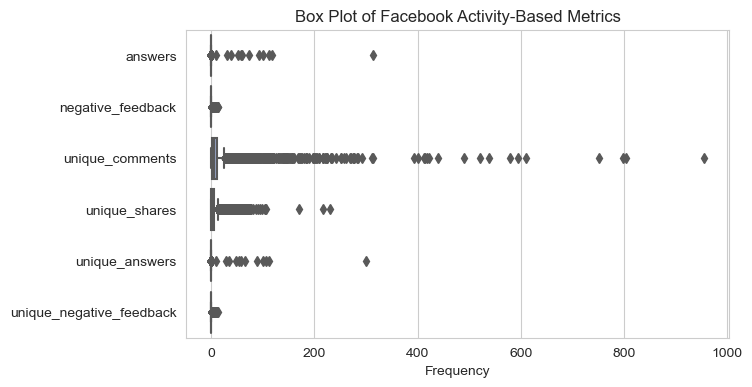

In [310]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Facebook"')[fb_act], orient="h", palette="Set2")
plt.title('Box Plot of Facebook Activity-Based Metrics')
plt.xlabel('Frequency')

plt.show()

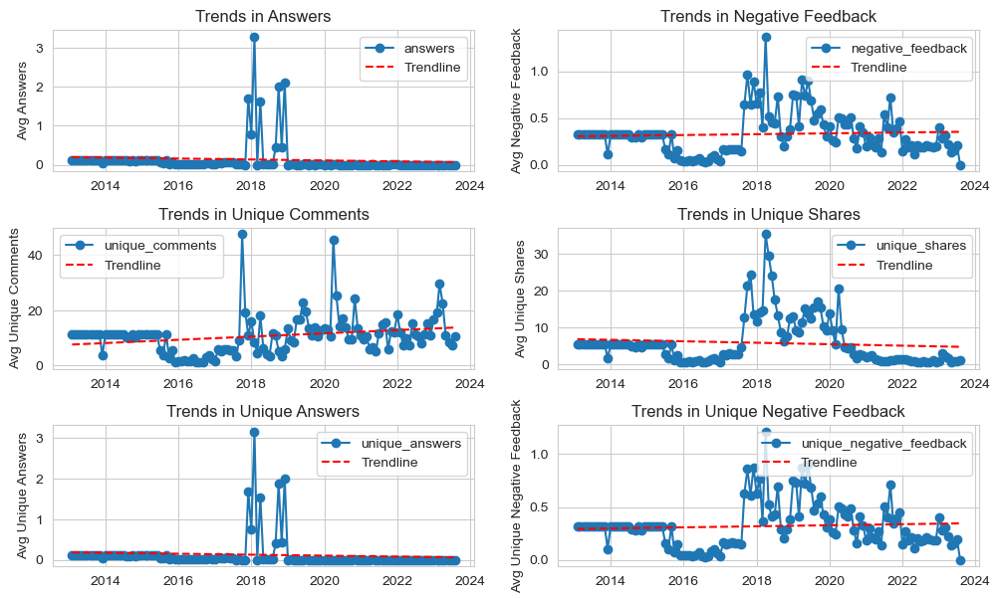

In [311]:
fig, axes = plt.subplots(3, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_act, axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

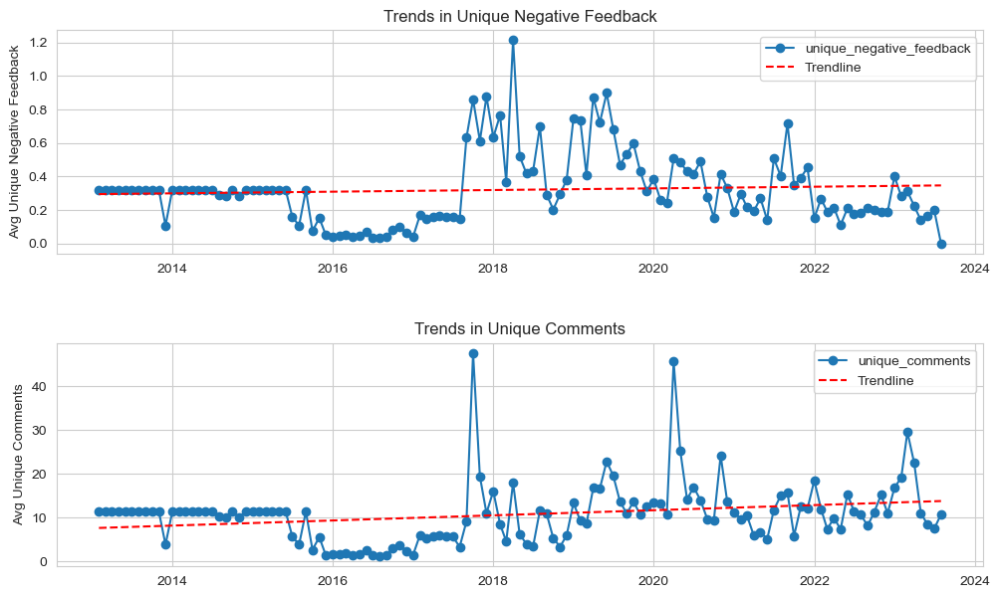

In [312]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(['unique_negative_feedback', 'unique_comments'], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

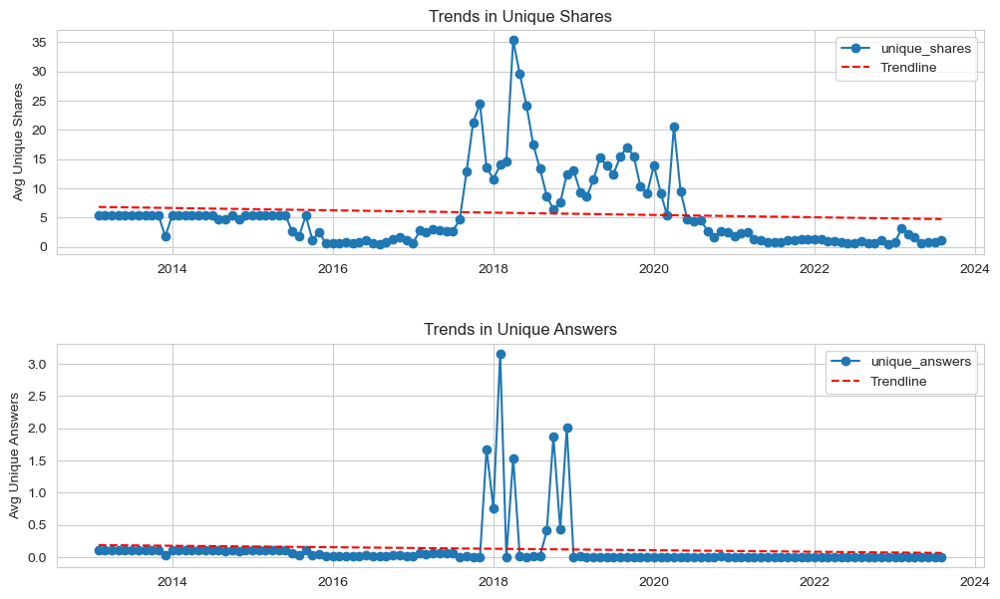

In [313]:
fig, axes = plt.subplots(2, 1, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(['unique_shares', 'unique_answers'], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

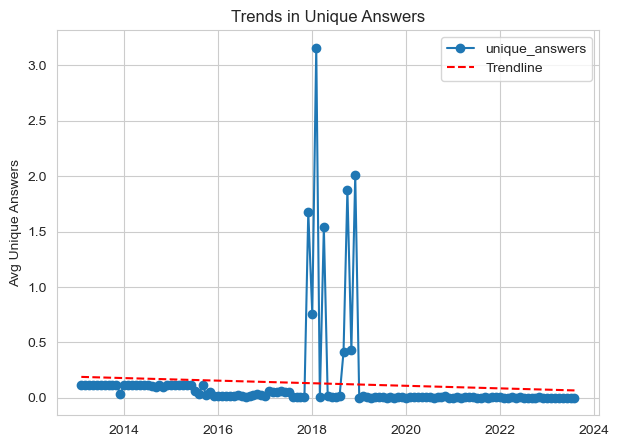

In [314]:
fig, ax = plt.subplots(1, 1, figsize=(7, 5))

monthly_mean = df.query('network=="Facebook"')['unique_answers'].resample('M').mean().interpolate()
ax.plot(monthly_mean.index, monthly_mean, 
        marker='o', linestyle='-', label=i)
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients
trendline_values = slope * x_values + intercept
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
ax.plot(trendline_dates, trendline_values, label='Trendline', 
        linestyle='--', color='red')
ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
ax.set_title(f'Trends in {i.replace("_", " ").title()}')
ax.legend()
plt.show()

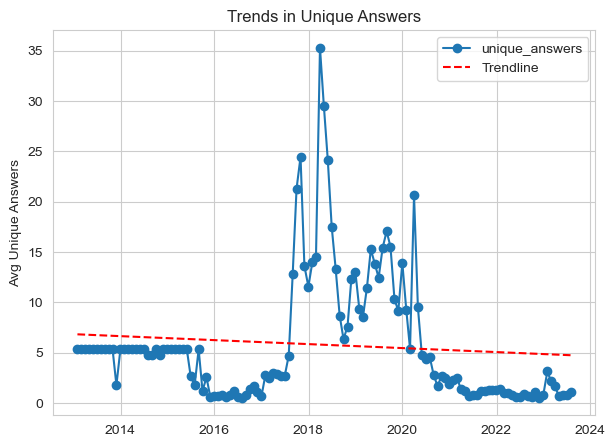

In [315]:
fig, ax = plt.subplots(1, 1, figsize=(7, 5))

monthly_mean = df.query('network=="Facebook"')['unique_shares'].resample('M').mean().interpolate()
ax.plot(monthly_mean.index, monthly_mean, 
        marker='o', linestyle='-', label=i)
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients
trendline_values = slope * x_values + intercept
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
ax.plot(trendline_dates, trendline_values, label='Trendline', 
        linestyle='--', color='red')
ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
ax.set_title(f'Trends in {i.replace("_", " ").title()}')
ax.legend()
plt.show()

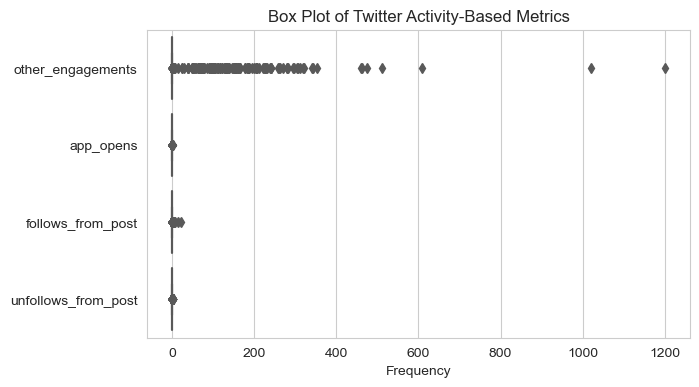

In [316]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Twitter"')[tw_act], orient="h", palette="Set2")
plt.title('Box Plot of Twitter Activity-Based Metrics')
plt.xlabel('Frequency')

plt.show()

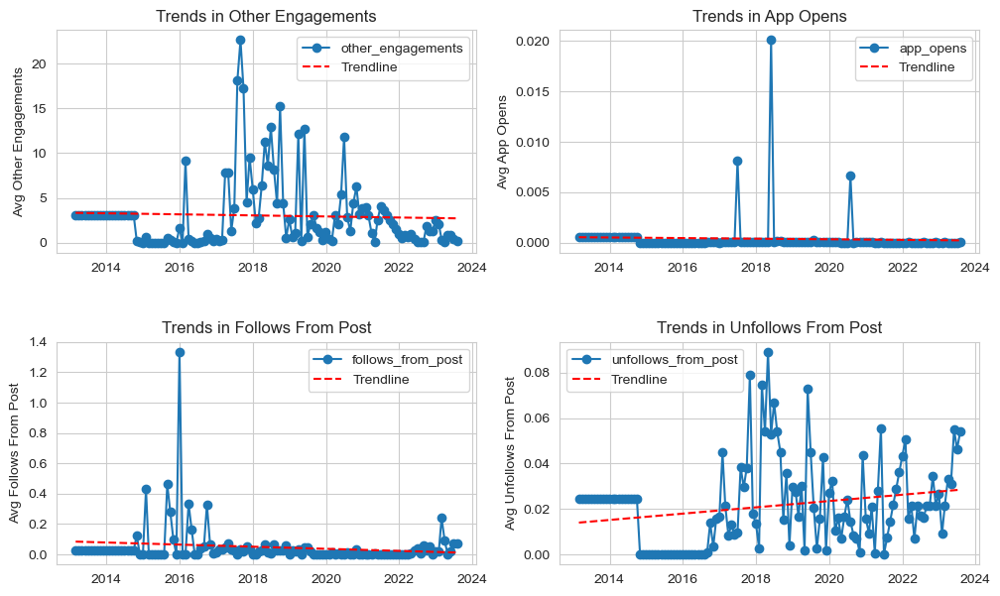

In [317]:
fig, axes = plt.subplots(2, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_act, axes.ravel()):
    monthly_mean = df.query('network=="Twitter"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

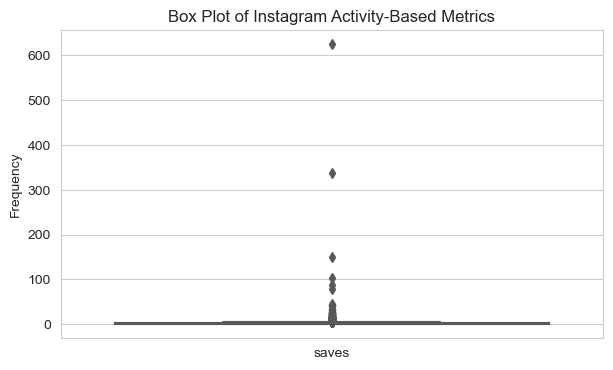

In [318]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Instagram"')[ig_act],  palette="Set2")
plt.title('Box Plot of Instagram Activity-Based Metrics')
plt.ylabel('Frequency')

plt.show()

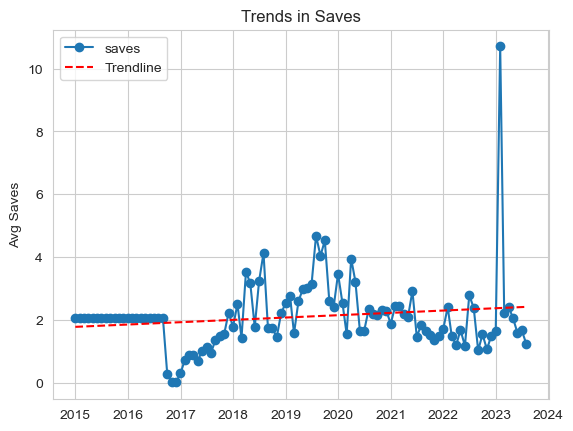

In [319]:
monthly_mean = df.query('network=="Instagram"')['saves'].resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, 
        marker='o', linestyle='-', label='saves')
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients
trendline_values = slope * x_values + intercept
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', 
        linestyle='--', color='red')
plt.ylabel(f'Avg Saves')
plt.title(f'Trends in Saves')
plt.legend()
plt.show()

Facebook Activity Metrics vs. Impressions/ Engagements/ Reach

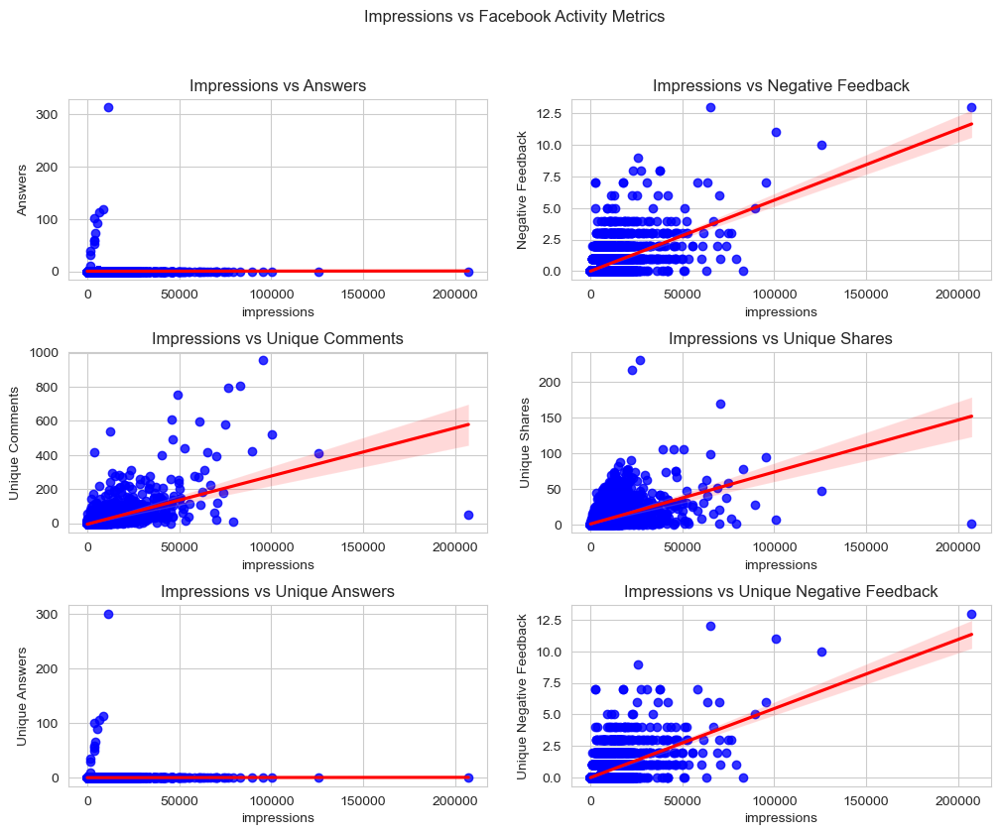

In [320]:
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_act, axes.ravel()):
    sns.regplot(x='impressions', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Impressions vs {i.replace("_", " ").title()}')
plt.suptitle('Impressions vs Facebook Activity Metrics')
plt.show()

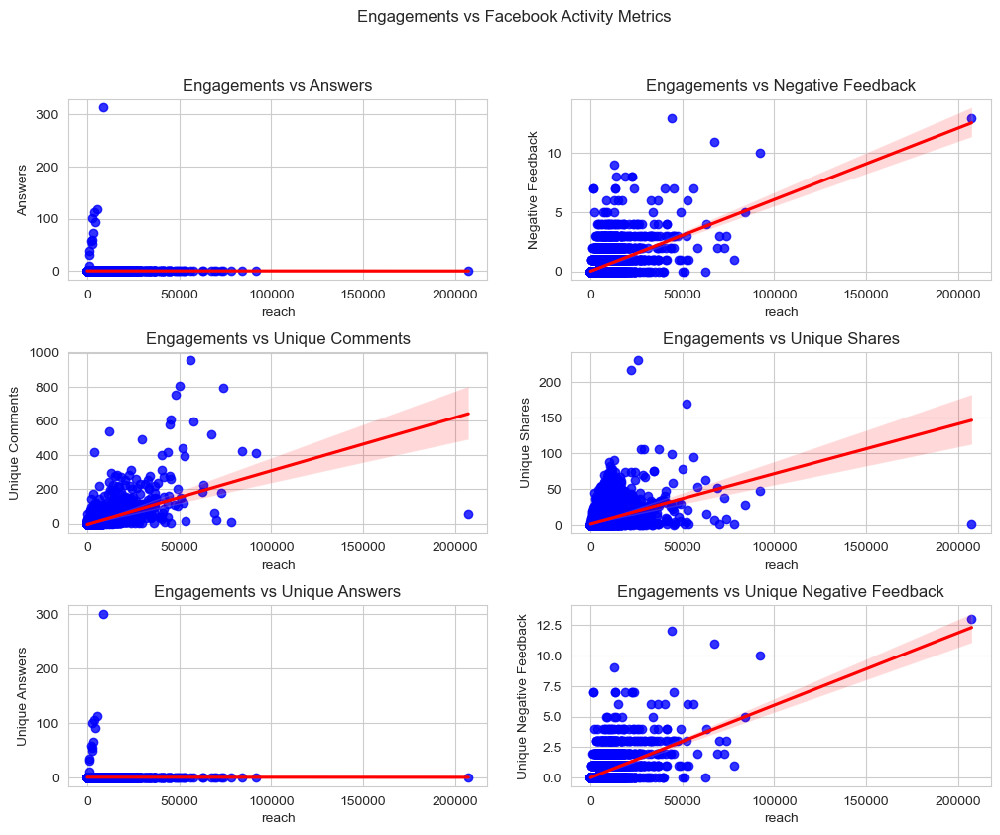

In [356]:
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_act, axes.ravel()):
    sns.regplot(x='engagements', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Engagements vs {i.replace("_", " ").title()}')
plt.suptitle('Engagements vs Facebook Activity Metrics')
plt.show()

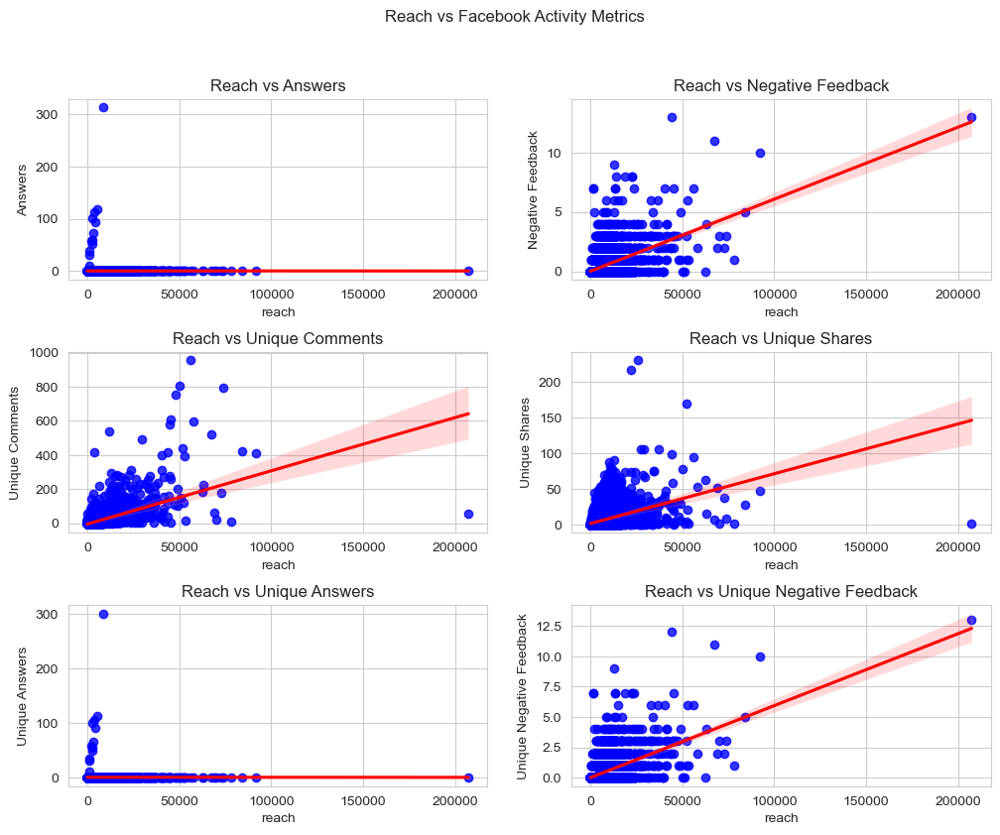

In [359]:
fig, axes = plt.subplots(3, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_act, axes.ravel()):
    sns.regplot(x='reach', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Reach vs {i.replace("_", " ").title()}')
plt.suptitle('Reach vs Facebook Activity Metrics')
plt.show()

Twitter Activity Metrics vs. Impressions/ Engagements/ Reach

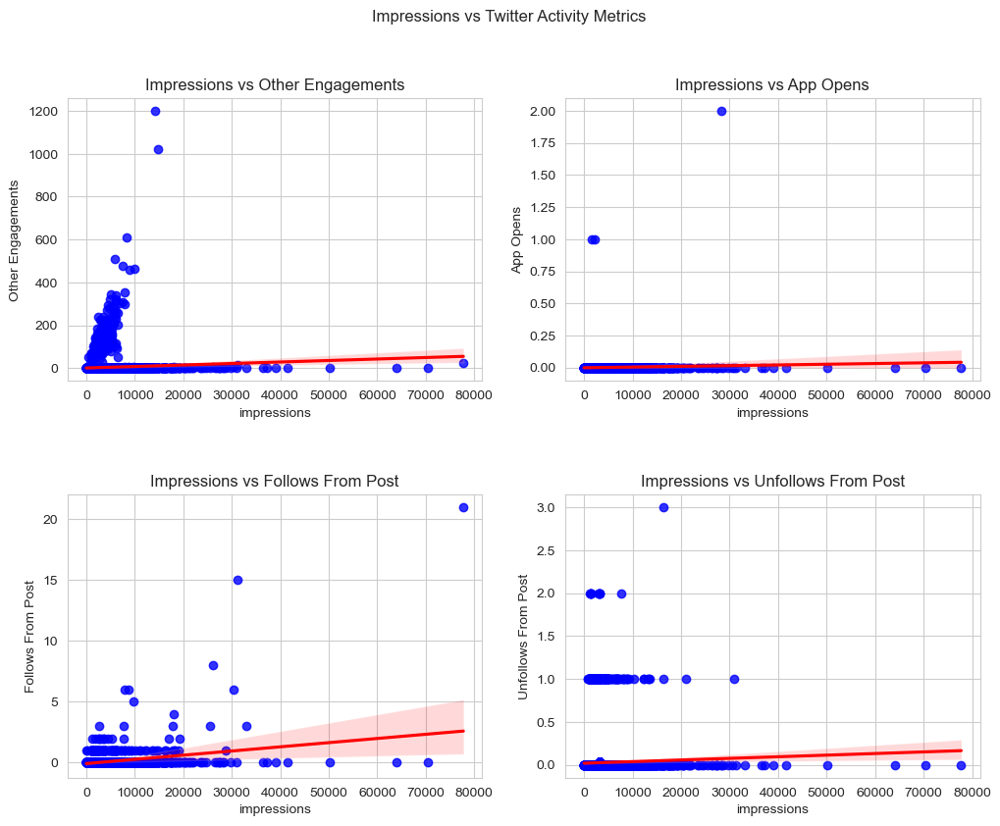

In [360]:
fig, axes = plt.subplots(2, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_act, axes.ravel()):
    sns.regplot(x='impressions', y=i, 
                data=df.query('network=="Twitter"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Impressions vs {i.replace("_", " ").title()}')
plt.suptitle('Impressions vs Twitter Activity Metrics')
plt.show()

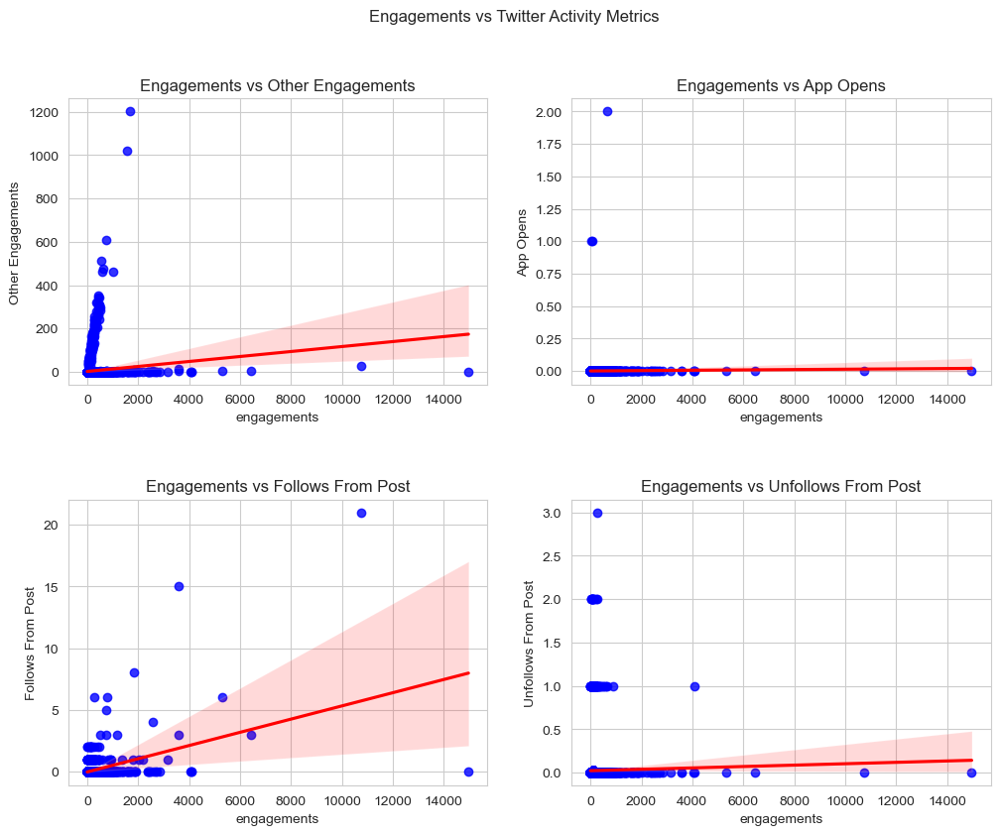

In [363]:
fig, axes = plt.subplots(2, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_act, axes.ravel()):
    sns.regplot(x='engagements', y=i, 
                data=df.query('network=="Twitter"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Engagements vs {i.replace("_", " ").title()}')
plt.suptitle('Engagements vs Twitter Activity Metrics')
plt.show()

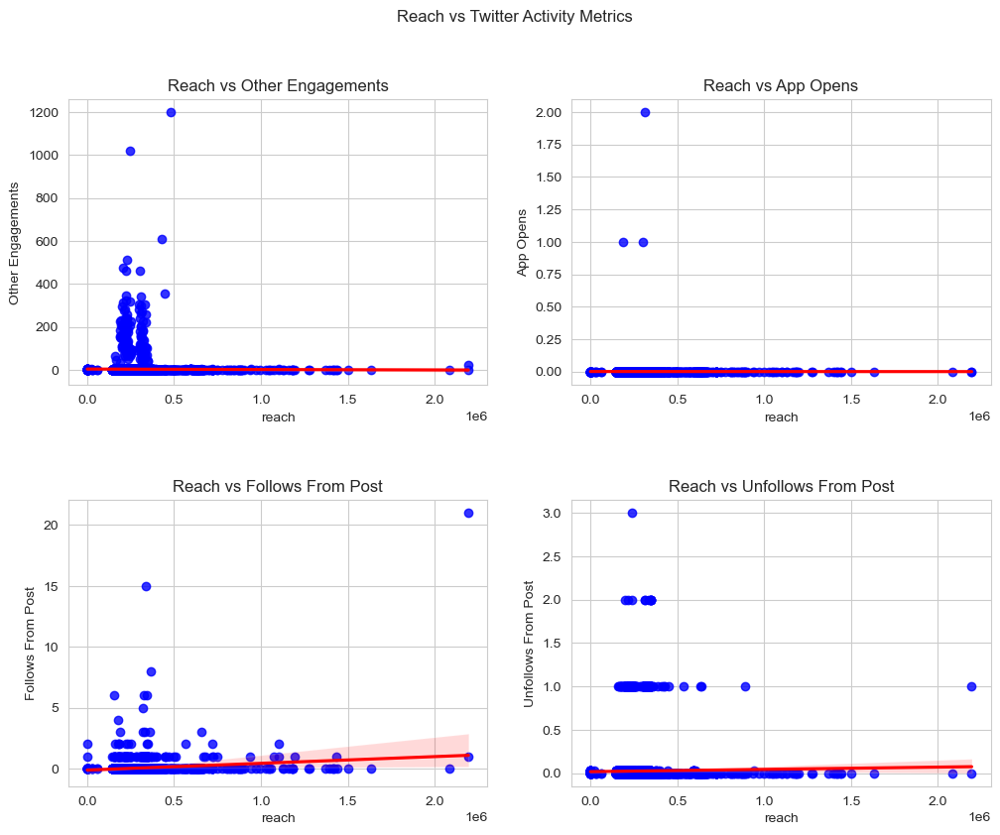

In [364]:
fig, axes = plt.subplots(2, 2, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_act, axes.ravel()):
    sns.regplot(x='reach', y=i, 
                data=df.query('network=="Twitter"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Reach vs {i.replace("_", " ").title()}')
plt.suptitle('Reach vs Twitter Activity Metrics')
plt.show()

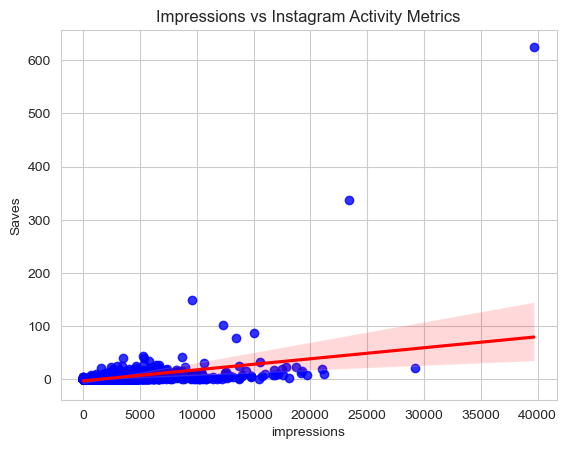

In [322]:
sns.regplot(x='impressions', y='saves', 
                data=df.query('network=="Instagram"'),
                color='b', line_kws=dict(color="r"))
plt.ylabel('Saves')
plt.title('Impressions vs Instagram Activity Metrics')
plt.show()

Pearson Correlation:

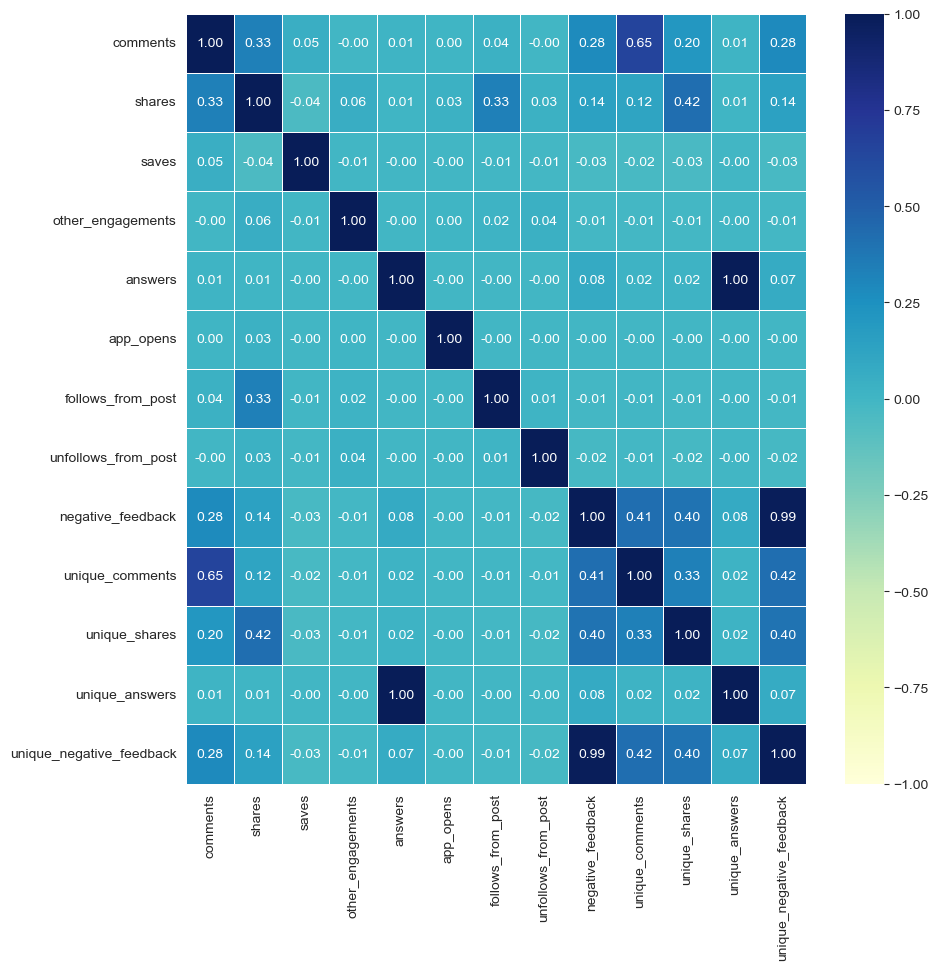

In [340]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[act_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Spearman Rank Correlation

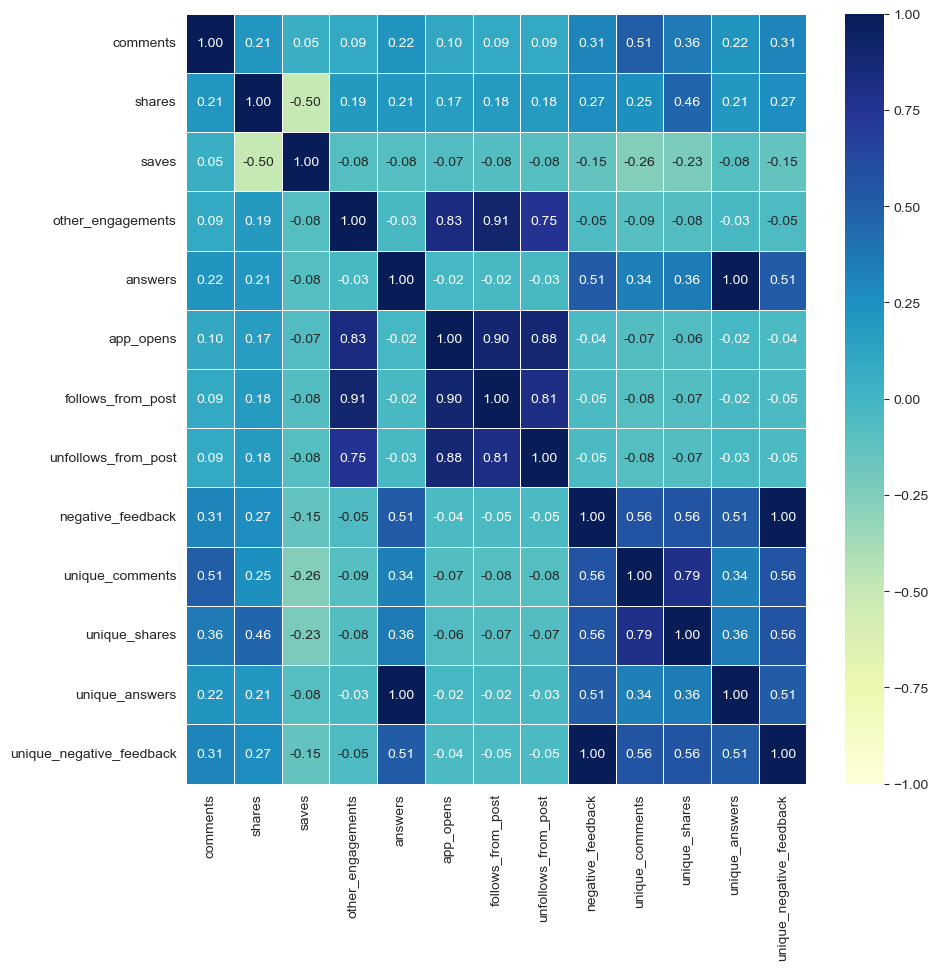

In [341]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[act_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

**Clicks Metrics**

Click metrics are for Facebook and twitter:

In [323]:
clk_metrics = ['post_link_clicks', 'other_post_clicks',
               'post_clicks_all', 'post_media_clicks', 
               'post_hashtag_clicks', 'post_detail_expand_clicks', 
               'profile_clicks', 'post_photo_view_clicks', 
               'post_video_play_clicks', 'bit_ly_link_clicks', 
               'unique_post_clicks', 'unique_post_link_clicks', 
               'unique_post_photo_view_clicks', 
               'unique_post_video_play_clicks', 
               'unique_other_post_clicks']

In [344]:
for i in df.network.unique():
    print(i)
    for j in clk_metrics:
        print(j, df.loc[df.network==i, j].mean())
    print('\n')

Facebook
post_link_clicks 10.718228867165038
other_post_clicks 108.7802766220623
post_clicks_all 110.87619475992352
post_media_clicks 0.0
post_hashtag_clicks 0.0
post_detail_expand_clicks 0.0
profile_clicks 0.0
post_photo_view_clicks 30.141257648743654
post_video_play_clicks 28.32792207792208
bit_ly_link_clicks 0.0
unique_post_clicks 83.11267288878894
unique_post_link_clicks 10.023001725129385
unique_post_photo_view_clicks 28.21820075511001
unique_post_video_play_clicks 23.78571428571428
unique_other_post_clicks 63.229956145282806


Twitter
post_link_clicks 7.002767783005812
other_post_clicks 69.00216781433306
post_clicks_all 72.2285131344045
post_media_clicks 45.09711639025847
post_hashtag_clicks 1.5340003391555028
post_detail_expand_clicks 24.242157612853863
profile_clicks 5.116934455496047
post_photo_view_clicks 0.0
post_video_play_clicks 0.0
bit_ly_link_clicks 975.1746031746029
unique_post_clicks 0.0
unique_post_link_clicks 0.0
unique_post_photo_view_clicks 0.0
unique_post_video_pl

In [345]:
fb_clk = ['other_post_clicks', 'post_photo_view_clicks', 
          'post_video_play_clicks', 'unique_post_clicks', 
          'unique_post_link_clicks', 'unique_post_photo_view_clicks', 
          'unique_post_video_play_clicks', 'unique_other_post_clicks']

tw_clk = ['other_post_clicks', 'post_media_clicks', 
          'post_hashtag_clicks', 'post_detail_expand_clicks', 
          'profile_clicks', 'bit_ly_link_clicks']

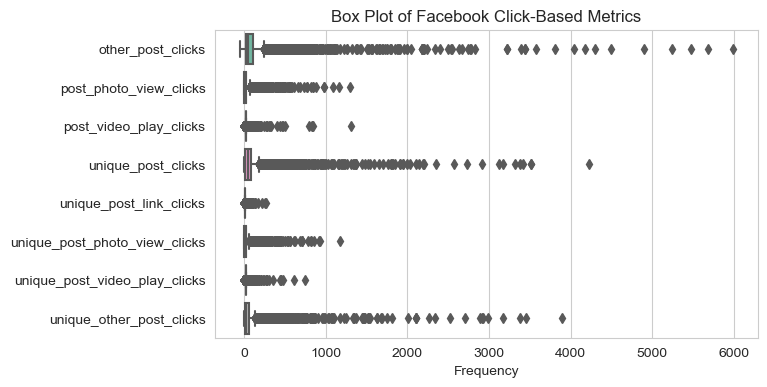

In [346]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Facebook"')[fb_clk], orient="h", palette="Set2")
plt.title('Box Plot of Facebook Click-Based Metrics')
plt.xlabel('Frequency')

plt.show()

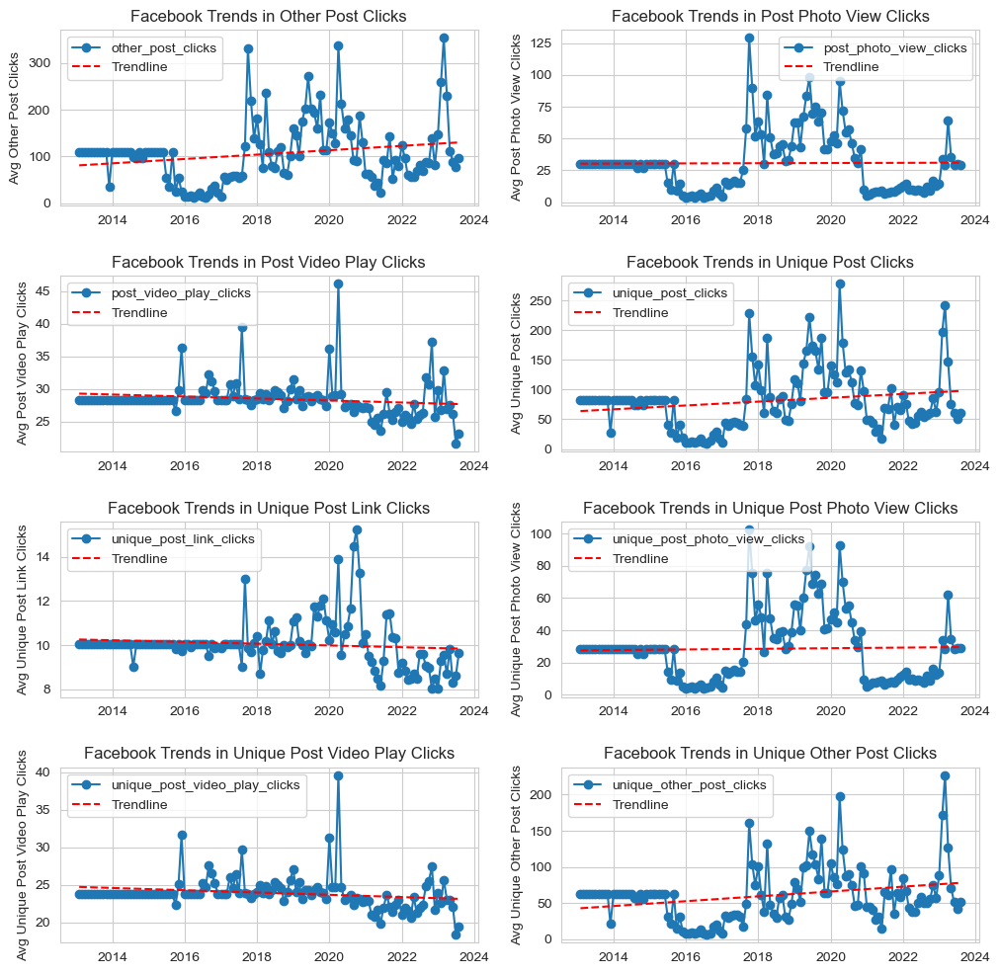

In [351]:
fig, axes = plt.subplots(4, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_clk, axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Facebook Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

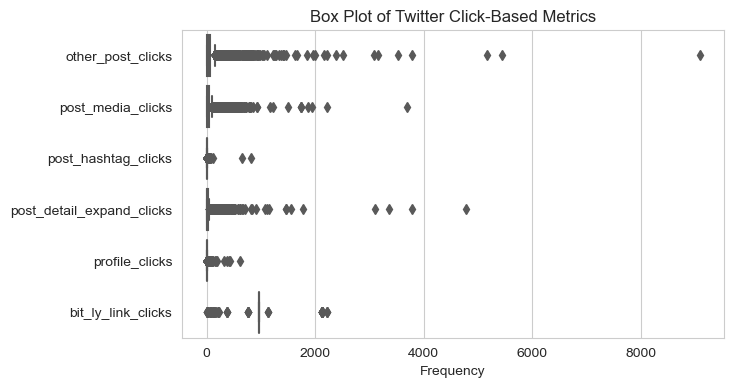

In [347]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Twitter"')[tw_clk], orient="h", palette="Set2")
plt.title('Box Plot of Twitter Click-Based Metrics')
plt.xlabel('Frequency')

plt.show()

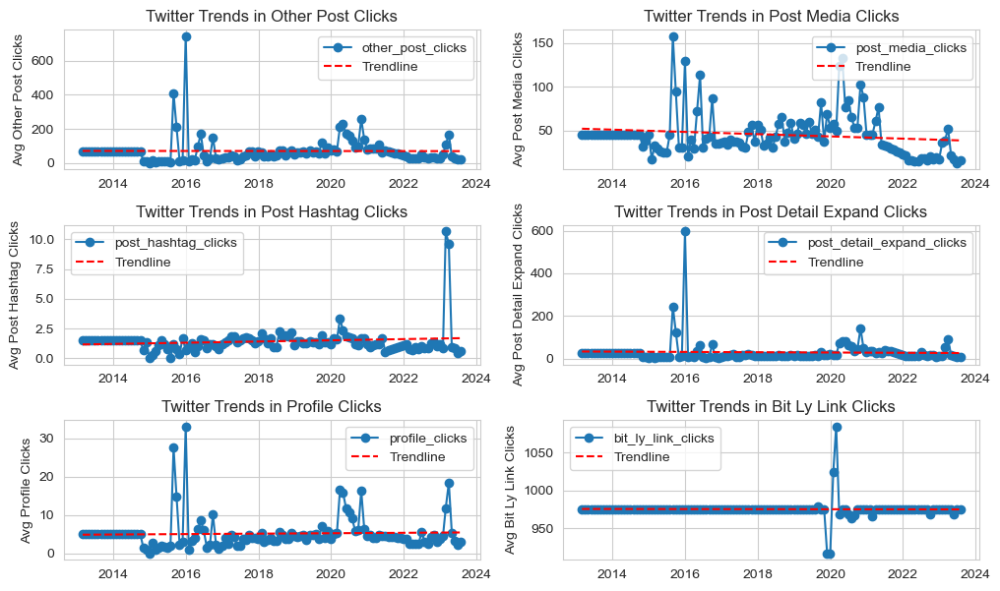

In [352]:
fig, axes = plt.subplots(3, 2, figsize=(12, 7))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_clk, axes.ravel()):
    monthly_mean = df.query('network=="Twitter"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Twitter Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

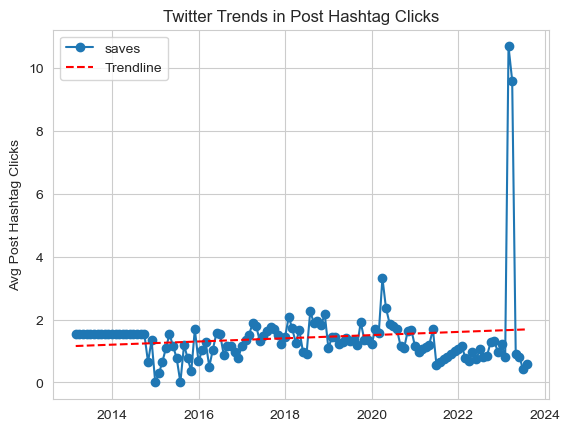

In [353]:
monthly_mean = df.query('network=="Twitter"')['post_hashtag_clicks'].resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, 
        marker='o', linestyle='-', label='saves')
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients
trendline_values = slope * x_values + intercept
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', 
        linestyle='--', color='red')
plt.ylabel(f'Avg Post Hashtag Clicks')
plt.title(f'Twitter Trends in Post Hashtag Clicks')
plt.legend()
plt.show()

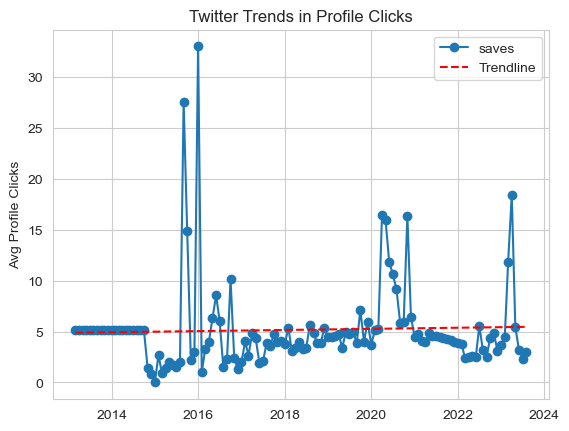

In [354]:
monthly_mean = df.query('network=="Twitter"')['profile_clicks'].resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, 
        marker='o', linestyle='-', label='saves')
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients
trendline_values = slope * x_values + intercept
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', 
        linestyle='--', color='red')
plt.ylabel(f'Avg Profile Clicks')
plt.title(f'Twitter Trends in Profile Clicks')
plt.legend()
plt.show()

Click Metrics vs Impressions/ Engagements/ Reach:

Facebook:

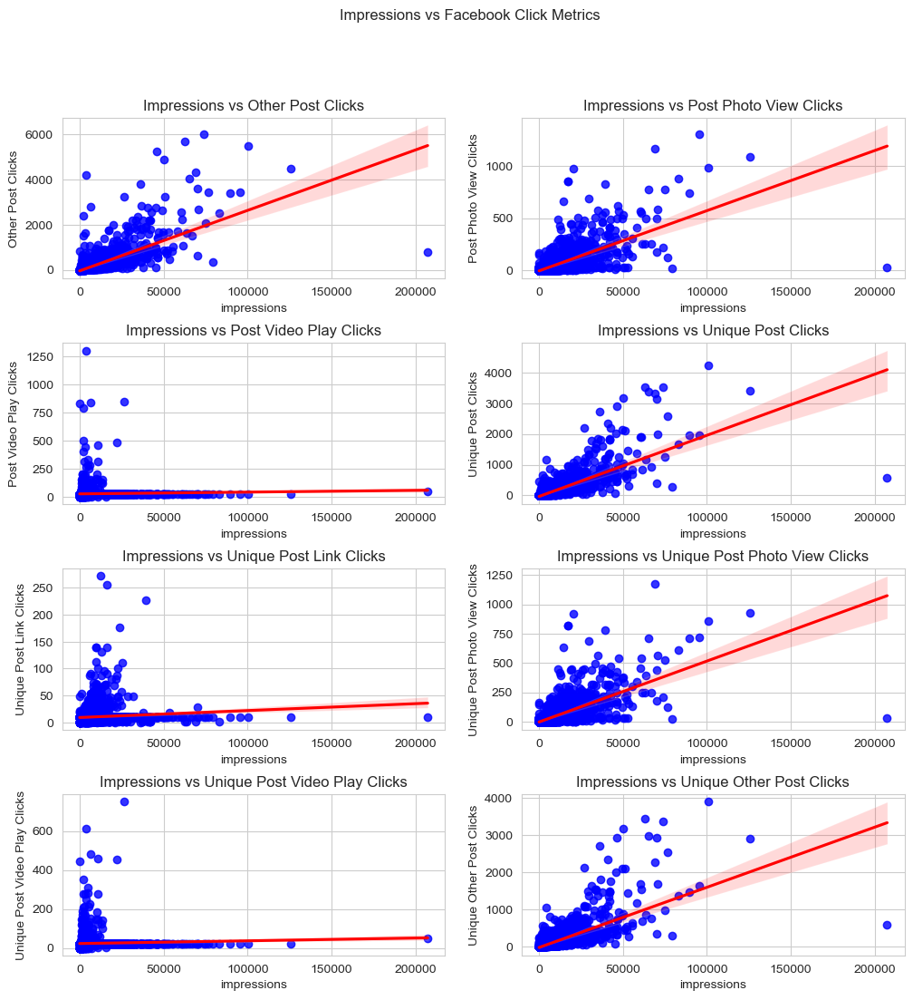

In [366]:
fig, axes = plt.subplots(4, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_clk, axes.ravel()):
    sns.regplot(x='impressions', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Impressions vs {i.replace("_", " ").title()}')
plt.suptitle('Impressions vs Facebook Click Metrics')
plt.show()

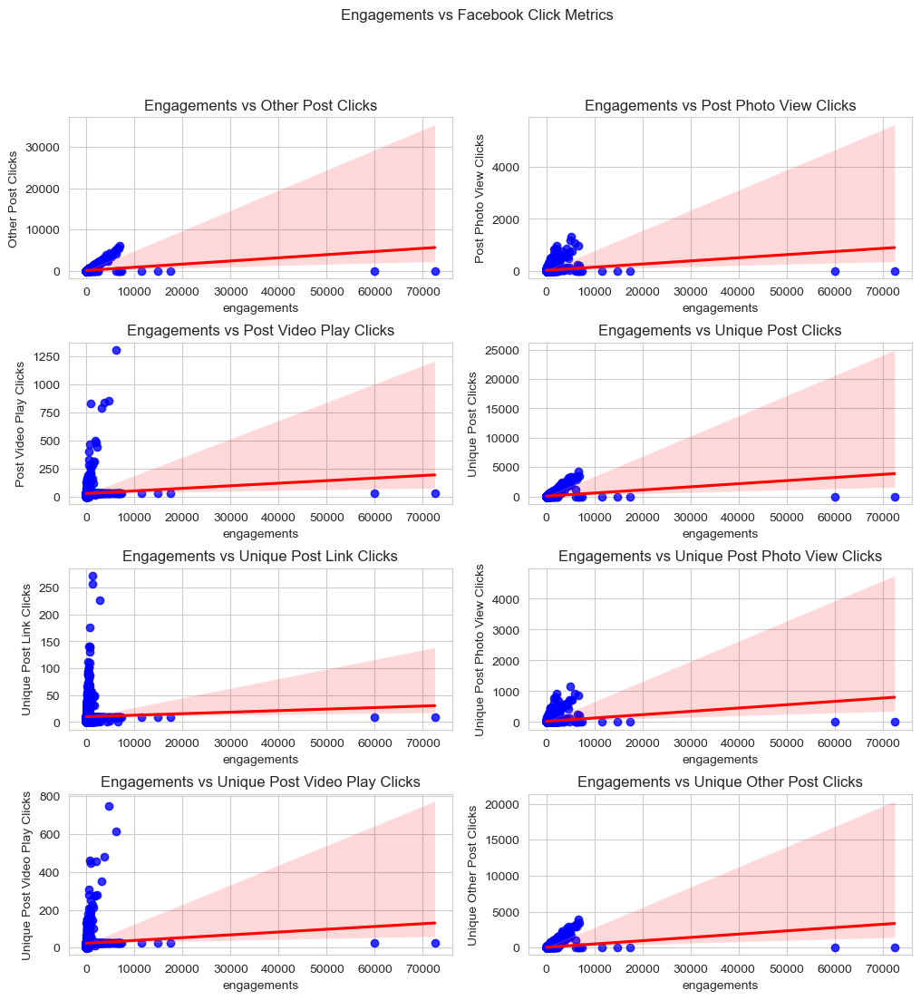

In [369]:
fig, axes = plt.subplots(4, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(fb_clk, axes.ravel()):
    sns.regplot(x='engagements', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Engagements vs {i.replace("_", " ").title()}')
plt.suptitle('Engagements vs Facebook Click Metrics')
plt.show()

Twitter:

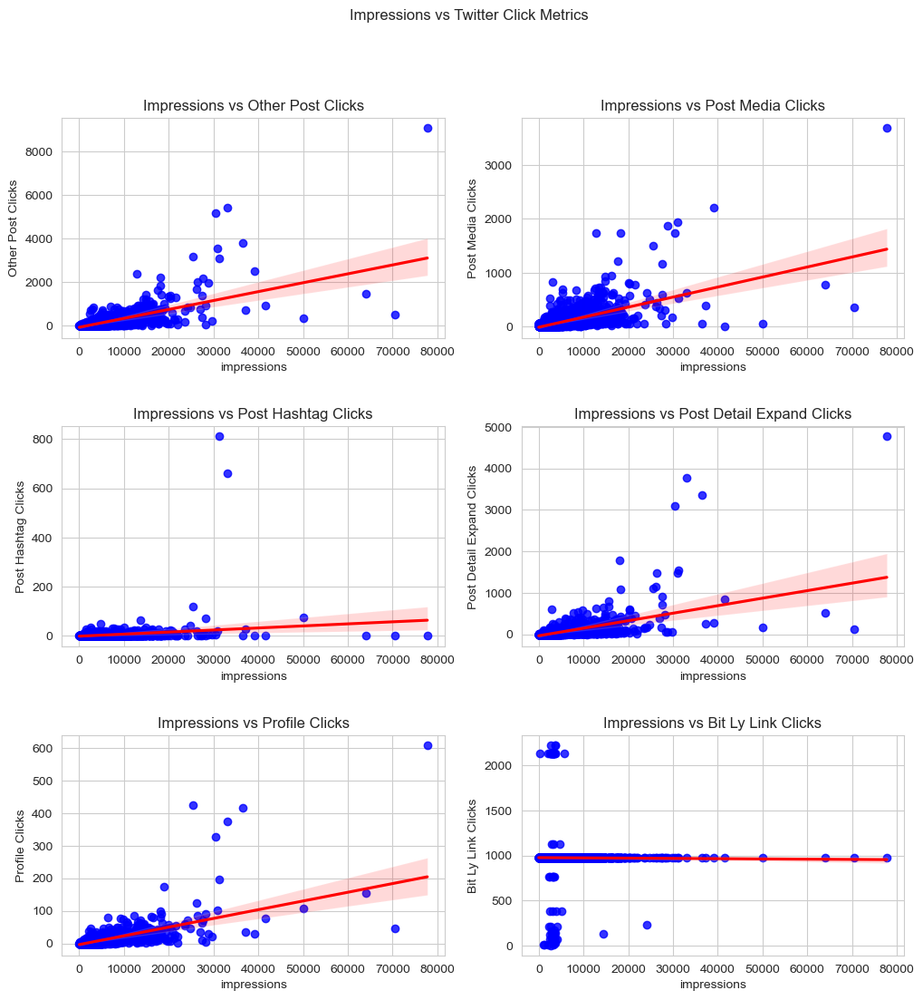

In [368]:
fig, axes = plt.subplots(3, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_clk, axes.ravel()):
    sns.regplot(x='impressions', y=i, 
                data=df.query('network=="Twitter"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Impressions vs {i.replace("_", " ").title()}')
plt.suptitle('Impressions vs Twitter Click Metrics')
plt.show()

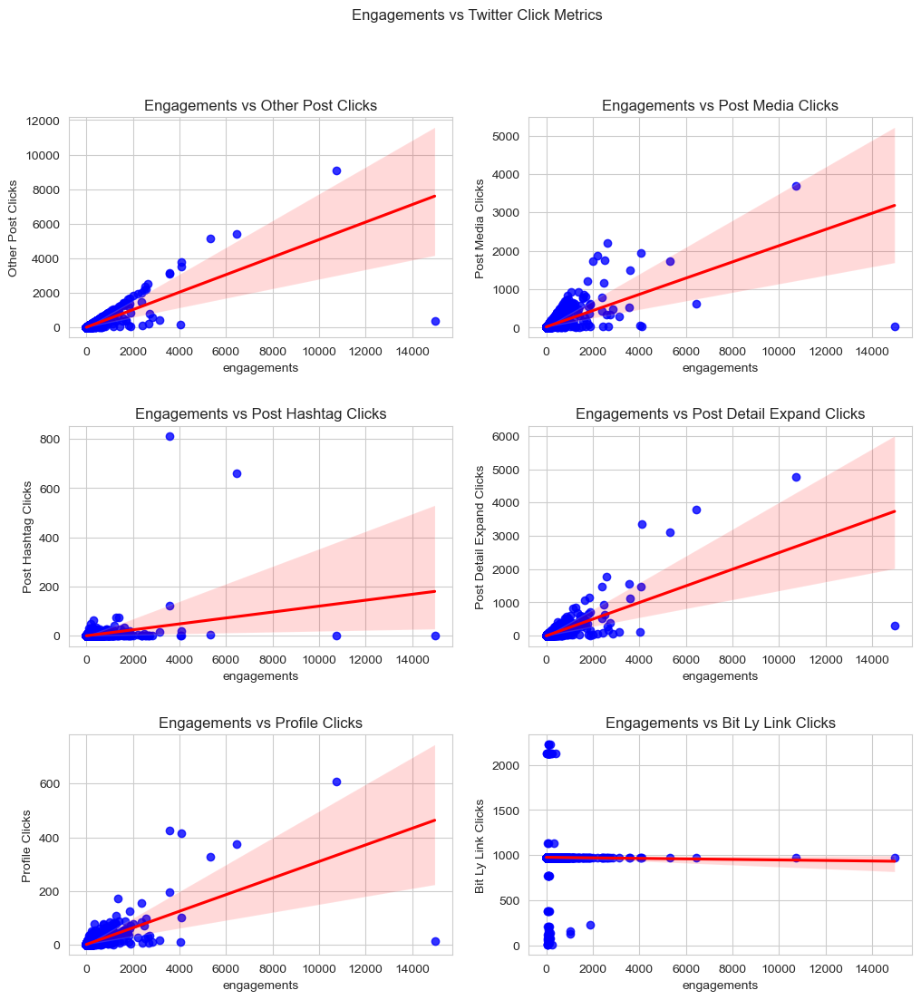

In [372]:
fig, axes = plt.subplots(3, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(tw_clk, axes.ravel()):
    sns.regplot(x='engagements', y=i, 
                data=df.query('network=="Twitter"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Engagements vs {i.replace("_", " ").title()}')
plt.suptitle('Engagements vs Twitter Click Metrics')
plt.show()

Pearson Correlation:

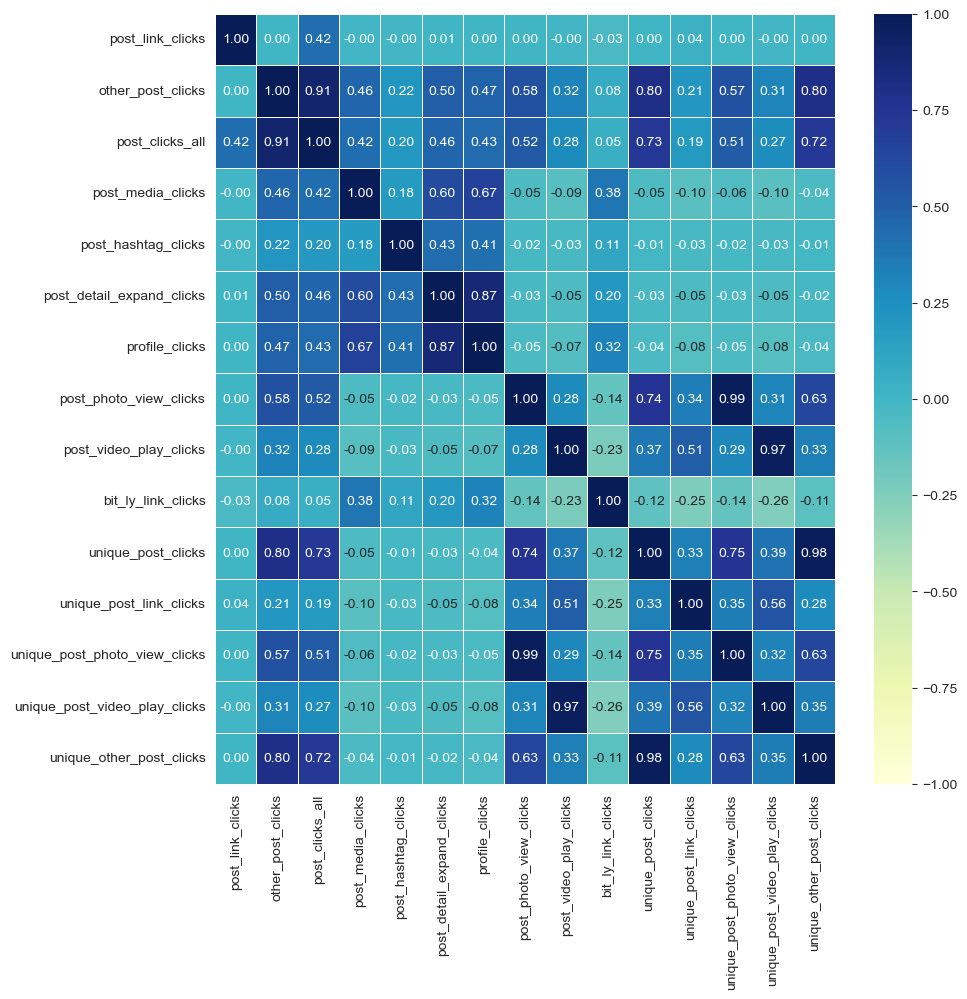

In [373]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[clk_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Spearman Rank Correlation

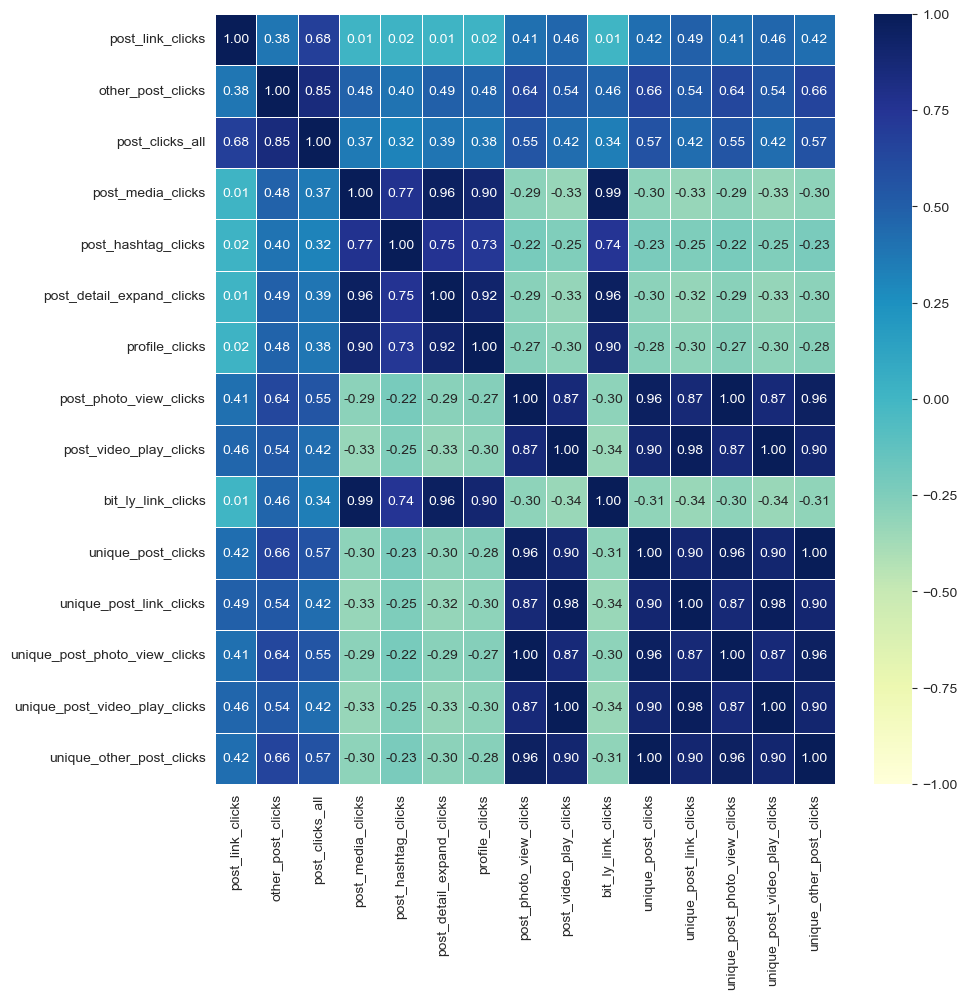

In [374]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    df[clk_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

**User-Based Metrics**

These are all facebook metrics:

In [324]:
usr_metrics = ['engaged_users', 'engaged_fans',
               'users_talking_about_this']

In [375]:
for i in df.network.unique():
    print(i)
    for j in usr_metrics:
        print(j, df.loc[df.network==i, j].mean())
    print('\n')

Facebook
engaged_users 139.40042730237266
engaged_fans 115.99404025638142
users_talking_about_this 69.9055436860452


Twitter
engaged_users 0.0
engaged_fans 0.0
users_talking_about_this 0.0


LinkedIn
engaged_users 0.0
engaged_fans 0.0
users_talking_about_this 0.0


Instagram
engaged_users 0.0
engaged_fans 0.0
users_talking_about_this 0.0




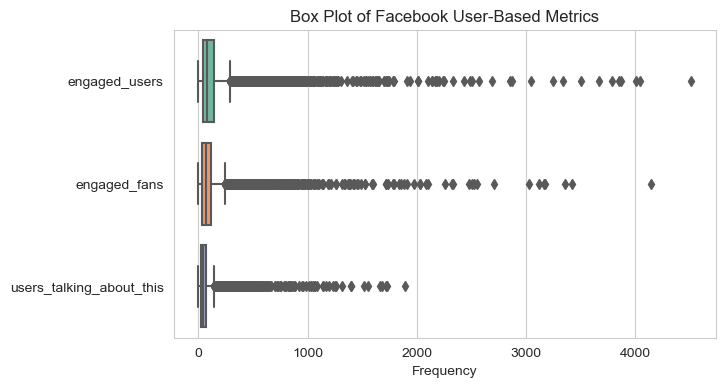

In [376]:
plt.figure(figsize=(7, 4))
sns.boxplot(data=df.query('network=="Facebook"')[usr_metrics], 
            orient="h", palette="Set2")
plt.title('Box Plot of Facebook User-Based Metrics')
plt.xlabel('Frequency')

plt.show()

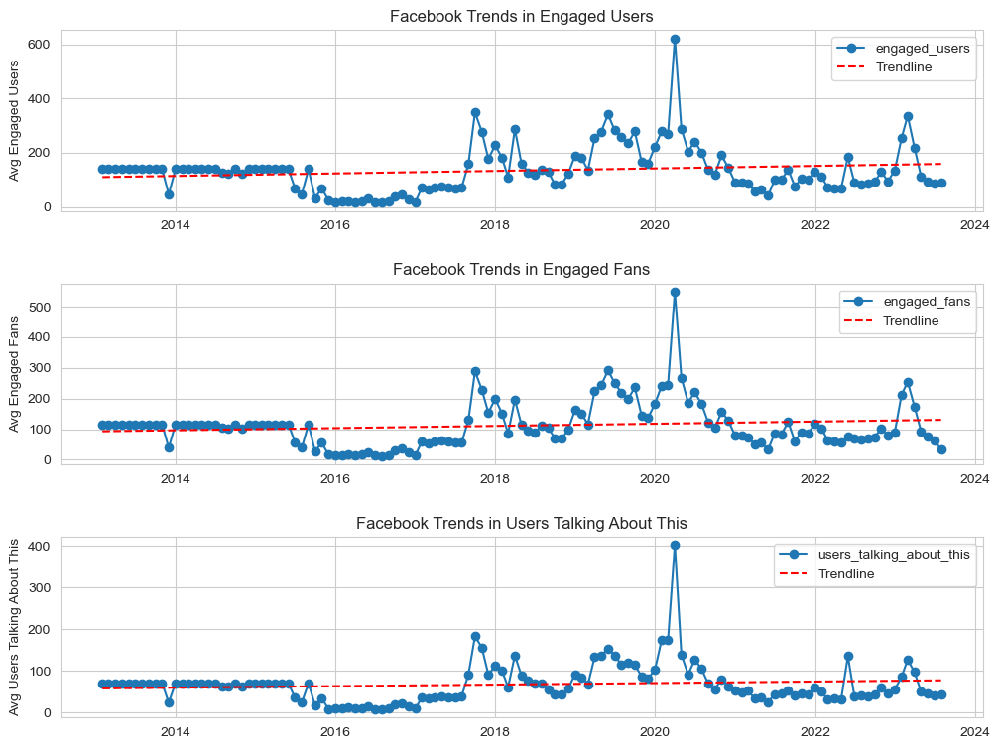

In [378]:
fig, axes = plt.subplots(3, 1, figsize=(12, 9))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(usr_metrics, axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'Facebook Trends in {i.replace("_", " ").title()}')
    ax.legend()
plt.show()

User Metrics vs Impressions/ Engagements/ Reach

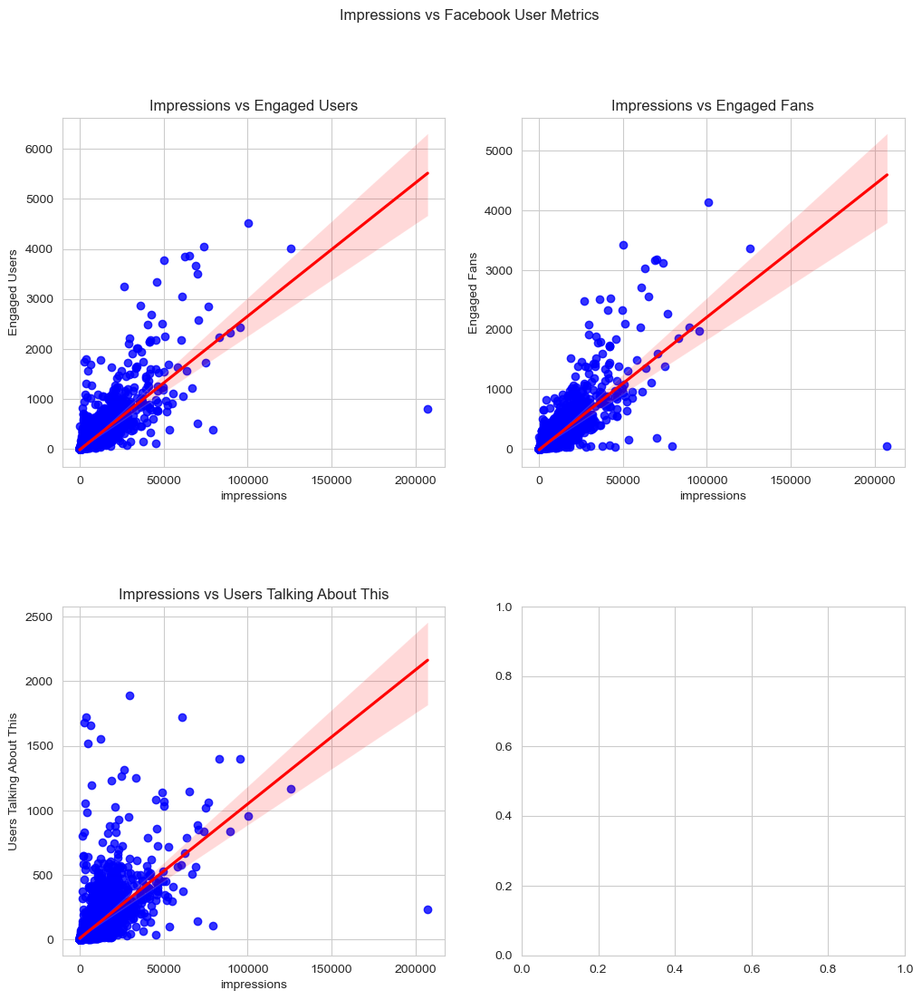

In [380]:
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(usr_metrics, axes.ravel()):
    sns.regplot(x='impressions', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Impressions vs {i.replace("_", " ").title()}')
plt.suptitle('Impressions vs Facebook User Metrics')
plt.show()

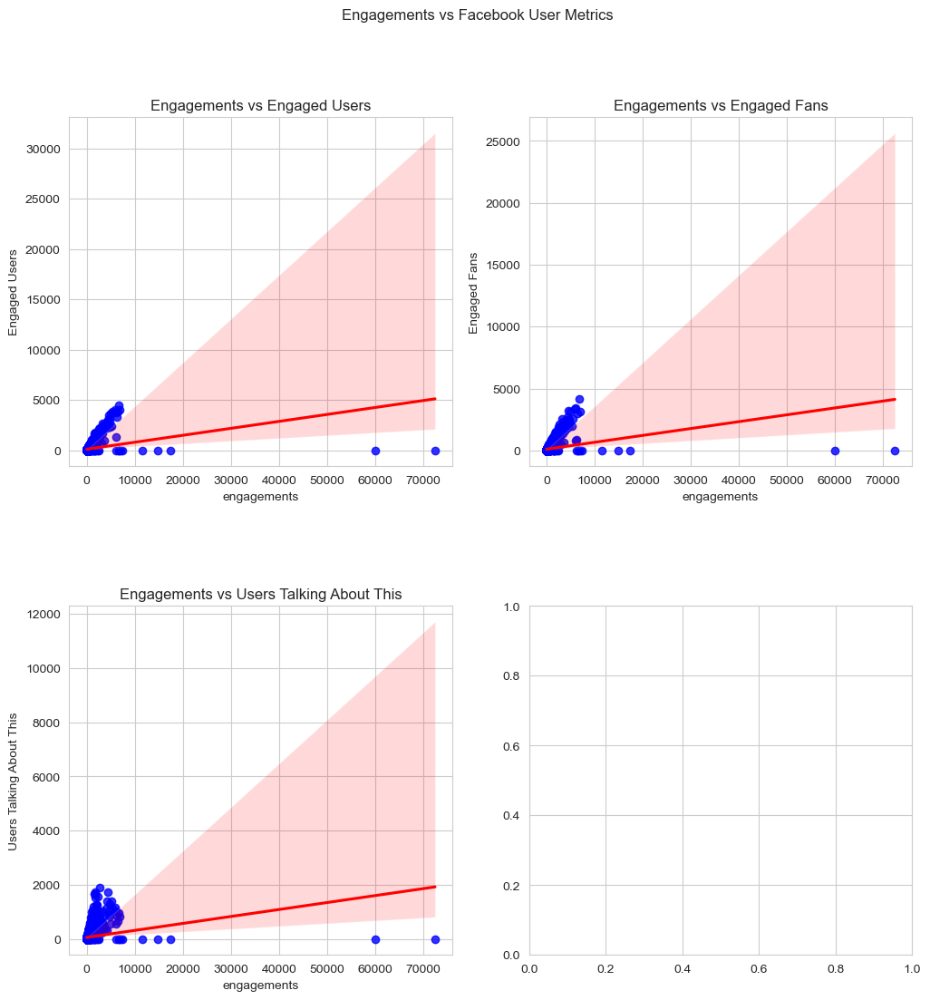

In [381]:
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(usr_metrics, axes.ravel()):
    sns.regplot(x='engagements', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Engagements vs {i.replace("_", " ").title()}')
plt.suptitle('Engagements vs Facebook User Metrics')
plt.show()

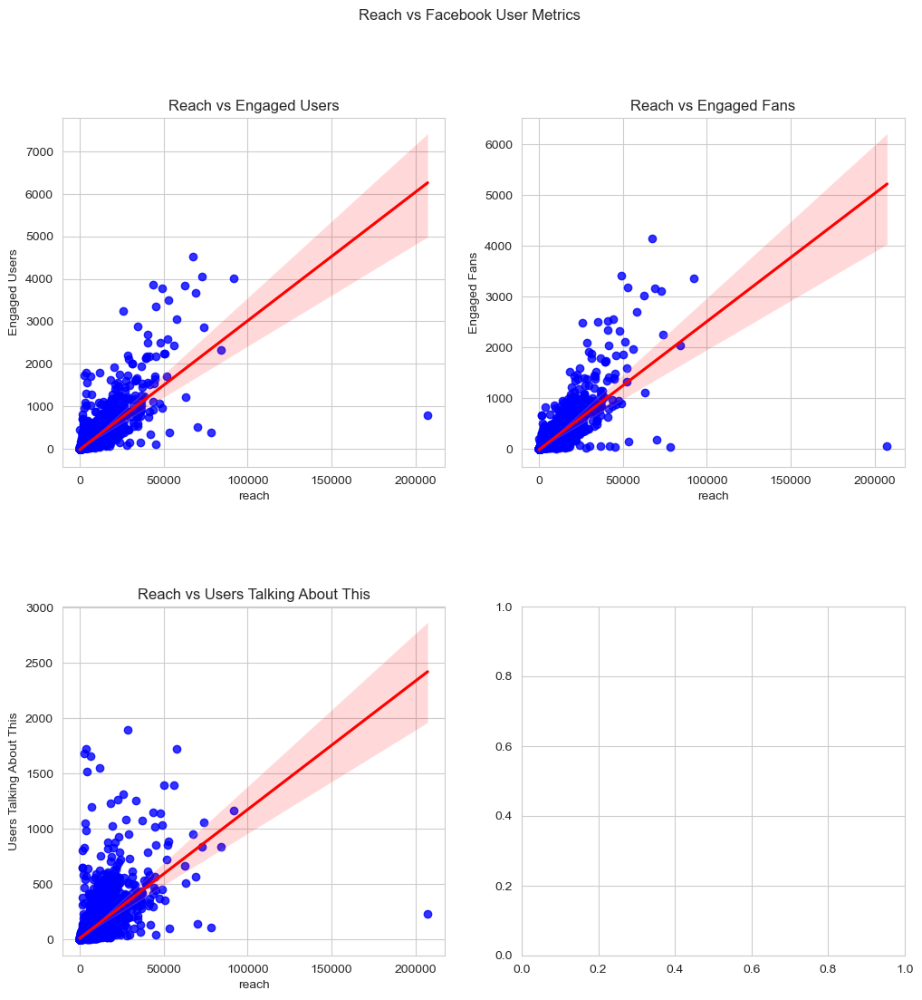

In [382]:
fig, axes = plt.subplots(2, 2, figsize=(12, 12))
fig.subplots_adjust(hspace=0.4, wspace=0.2)
sns.set_style("whitegrid")

for i, ax in zip(usr_metrics, axes.ravel()):
    sns.regplot(x='reach', y=i, 
                data=df.query('network=="Facebook"'),
                color='b', line_kws=dict(color="r"), ax=ax)
    ax.set_ylabel(f'{i.replace("_", " ").title()}')
    ax.set_title(f'Reach vs {i.replace("_", " ").title()}')
plt.suptitle('Reach vs Facebook User Metrics')
plt.show()

Pearson Correlation:

All user mtrics are strongly positively correlatted.

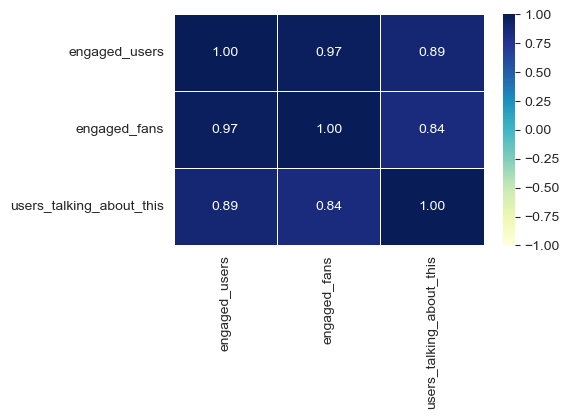

In [384]:
plt.figure(figsize=(5, 3))
sns.heatmap(
    df[usr_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Spearman Rank Correlation

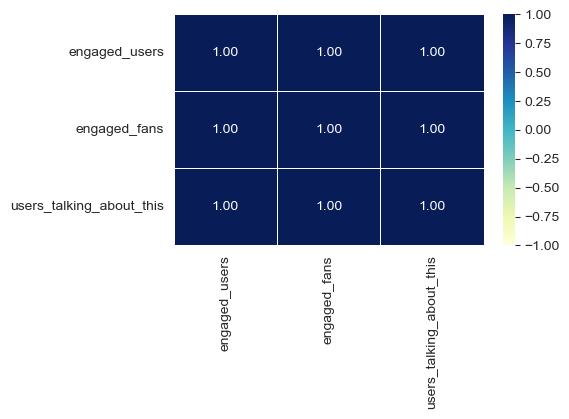

In [385]:
plt.figure(figsize=(5, 3))
sns.heatmap(
    df[usr_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

**Photo Metrics**

These are facebook metrics. They've been reviewed with other click metrics.

In [325]:
pho_metrics = ['post_photo_view_clicks', 
               'unique_post_photo_view_clicks']

In [386]:
for i in df.network.unique():
    print(i)
    for j in pho_metrics:
        print(j, df.loc[df.network==i, j].mean())
    print('\n')

Facebook
post_photo_view_clicks 30.141257648743654
unique_post_photo_view_clicks 28.21820075511001


Twitter
post_photo_view_clicks 0.0
unique_post_photo_view_clicks 0.0


LinkedIn
post_photo_view_clicks 0.0
unique_post_photo_view_clicks 0.0


Instagram
post_photo_view_clicks 0.0
unique_post_photo_view_clicks 0.0




**Video & Other Media Metrics**

Media views are Twitter based. The rest are facebook metrics.

In [397]:
vid_metrics = [
    'post_video_play_clicks', 'unique_post_video_play_clicks', 
    'media_views', 'partial_video_views', 'organic_partial_video_views', 
    'full_video_views', 'organic_full_video_views', 
    'autoplay_video_views', 'click_to_play_video_views', 
    'sound_on_video_views', 'sound_off_video_views', 
    '10_second_video_views', 'organic_10_second_video_views', 
    'paid_10_second_video_views', 'autoplay_10_second_video_views', 
    'click_to_play_10_second_video_views', 
    'sound_on_10_second_video_views', 
    'sound_off_10_second_video_views', 'autoplay_partial_video_views', 
    'autoplay_full_video_views', 'click_to_play_full_video_views', 
    '95%_video_views', 'organic_95%_video_views', 
    'video_length_seconds', 'average_video_time_watched_seconds', 
    'video_view_time_seconds', 'organic_video_view_time_seconds', 
    'paid_video_view_time_seconds', 'unique_video_views', 
    'unique_organic_video_views', 'unique_10_second_video_views', 
    'unique_full_video_views', 'unique_organic_95%_video_views'
]

In [398]:
for i in df.network.unique():
    print(i)
    for j in vid_metrics:
        print(j, df.loc[df.network==i, j].mean())
    print('\n')

Facebook
post_video_play_clicks 28.32792207792208
unique_post_video_play_clicks 23.78571428571428
media_views 0.0
partial_video_views 166.6572668112799
organic_partial_video_views 166.61496746203903
full_video_views 69.2556634304207
organic_full_video_views 69.21359223300969
autoplay_video_views 209.15857605177996
click_to_play_video_views 26.796116504854357
sound_on_video_views 152.97087378640774
sound_off_video_views 81.74620390455532
10_second_video_views 109.24595469255662
organic_10_second_video_views 109.1866235167206
paid_10_second_video_views 0.06073752711496746
autoplay_10_second_video_views 89.12189859762677
click_to_play_10_second_video_views 20.12405609492988
sound_on_10_second_video_views 79.70334412081984
sound_off_10_second_video_views 29.542610571736777
autoplay_partial_video_views 154.87918015102477
autoplay_full_video_views 54.27939590075514
click_to_play_full_video_views 14.990280777537798
95%_video_views 45.891046386192
organic_95%_video_views 45.865156418554484
vid

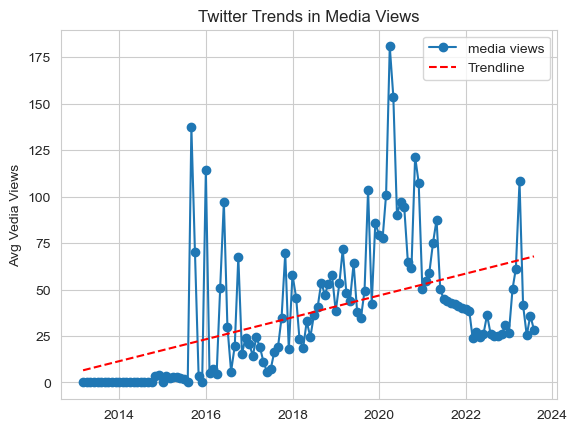

In [399]:
monthly_mean = df.query('network=="Twitter"')['media_views'].resample('M').mean().interpolate()
plt.plot(monthly_mean.index, monthly_mean, 
        marker='o', linestyle='-', label='media views')
x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
coefficients = np.polyfit(x_values, monthly_mean, 1)
slope, intercept = coefficients
trendline_values = slope * x_values + intercept
trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
plt.plot(trendline_dates, trendline_values, label='Trendline', 
        linestyle='--', color='red')
plt.ylabel(f'Avg Vedia Views')
plt.title(f'Twitter Trends in Media Views')
plt.legend()
plt.show()

In [400]:
vid_metrics.remove('media_views')
len(vid_metrics)

32

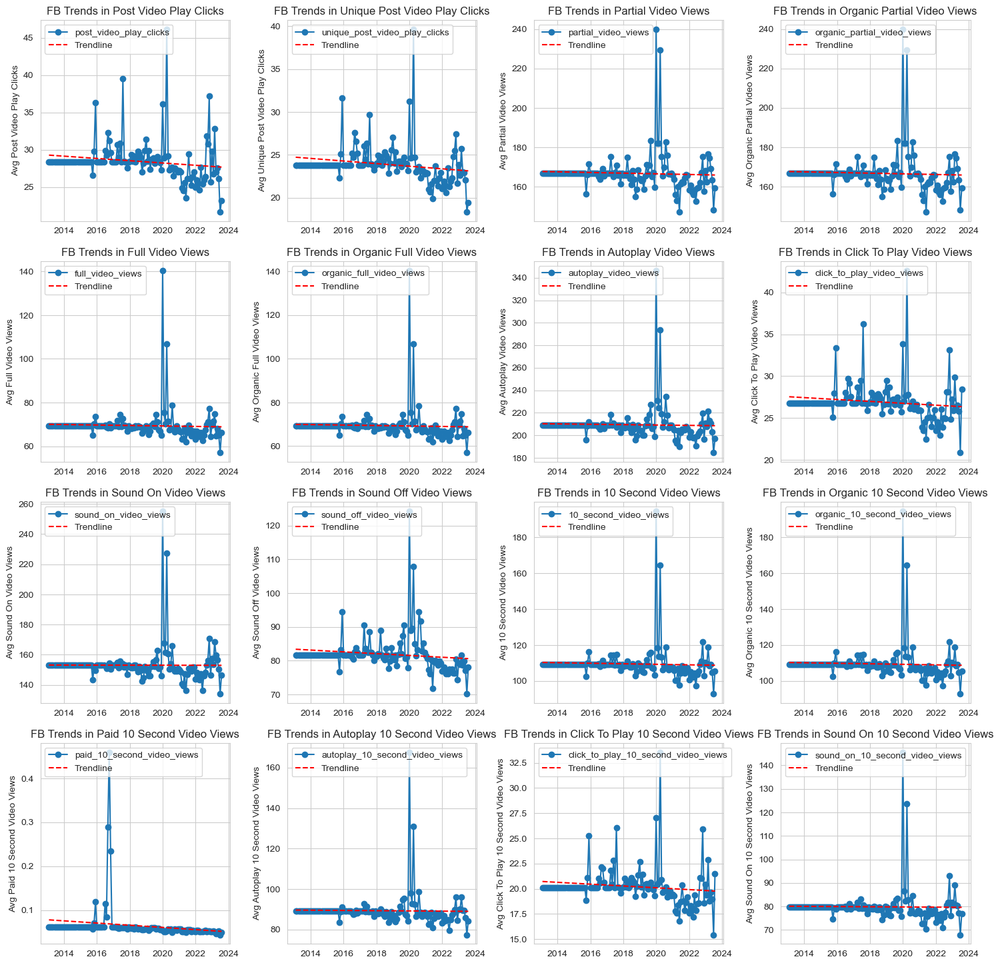

In [406]:
fig, axes = plt.subplots(4, 4, figsize=(18, 18))
fig.subplots_adjust(hspace=0.2, wspace=0.3)
sns.set_style("whitegrid")

for i, ax in zip(vid_metrics[:16], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'FB Trends in {i.replace("_", " ").title()}')
    ax.legend(loc='upper left')
plt.show()

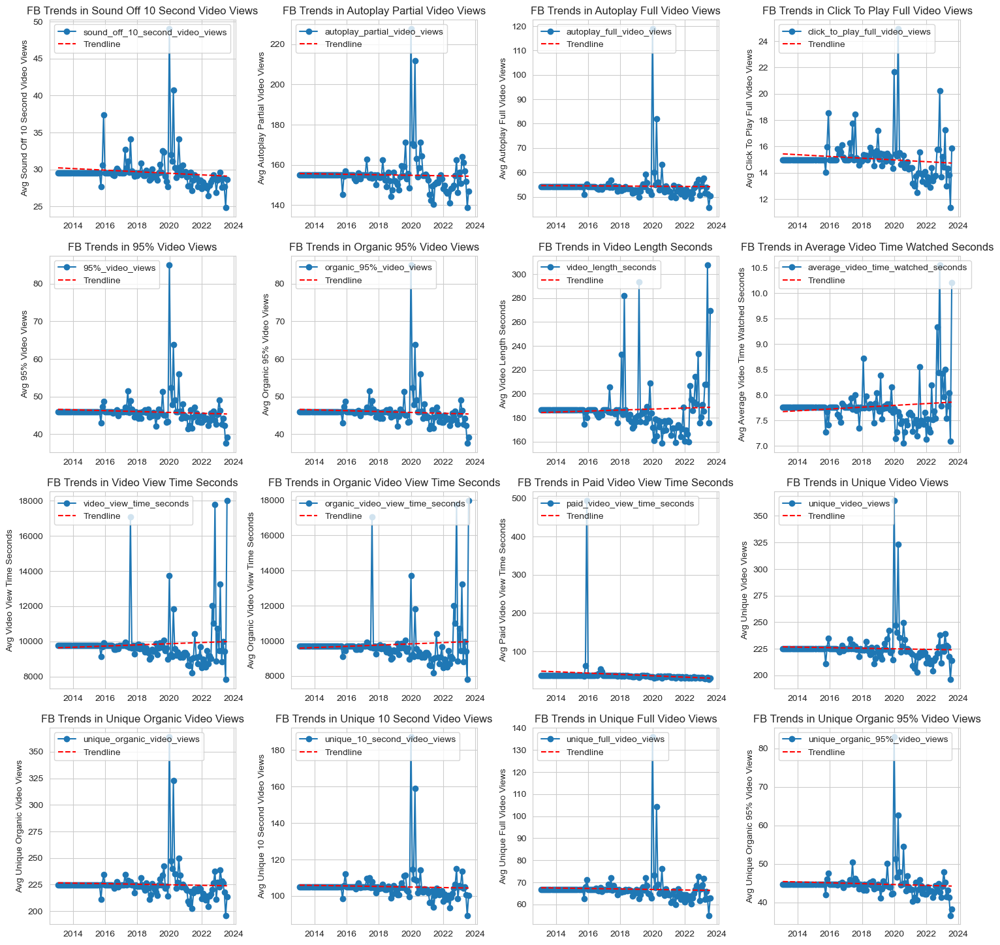

In [407]:
fig, axes = plt.subplots(4, 4, figsize=(18, 18))
fig.subplots_adjust(hspace=0.2, wspace=0.3)
sns.set_style("whitegrid")

for i, ax in zip(vid_metrics[16:], axes.ravel()):
    monthly_mean = df.query('network=="Facebook"')[i].resample('M').mean().interpolate()
    ax.plot(monthly_mean.index, monthly_mean, 
            marker='o', linestyle='-', label=i)
    x_values = pd.to_numeric(monthly_mean.index) / 10**9  # Convert timestamps to seconds
    coefficients = np.polyfit(x_values, monthly_mean, 1)
    slope, intercept = coefficients
    trendline_values = slope * x_values + intercept
    trendline_dates = pd.to_datetime(x_values.astype(int) * 10**9)  
    ax.plot(trendline_dates, trendline_values, label='Trendline', 
            linestyle='--', color='red')
    ax.set_ylabel(f'Avg {i.replace("_", " ").title()}')
    ax.set_title(f'FB Trends in {i.replace("_", " ").title()}')
    ax.legend(loc='upper left')
plt.show()

All video metrics are strongly positively correlated.

Pearson Correlation:

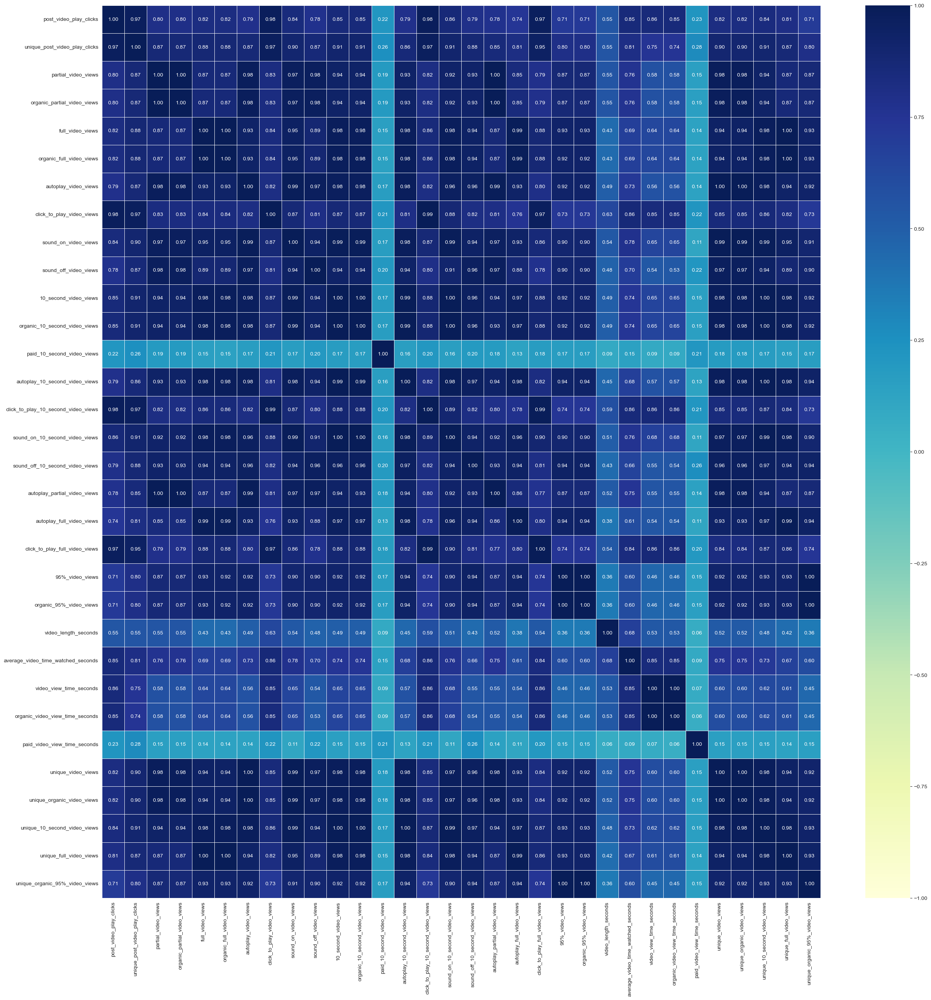

In [413]:
plt.figure(figsize=(30, 30))
sns.heatmap(
    df[vid_metrics].corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

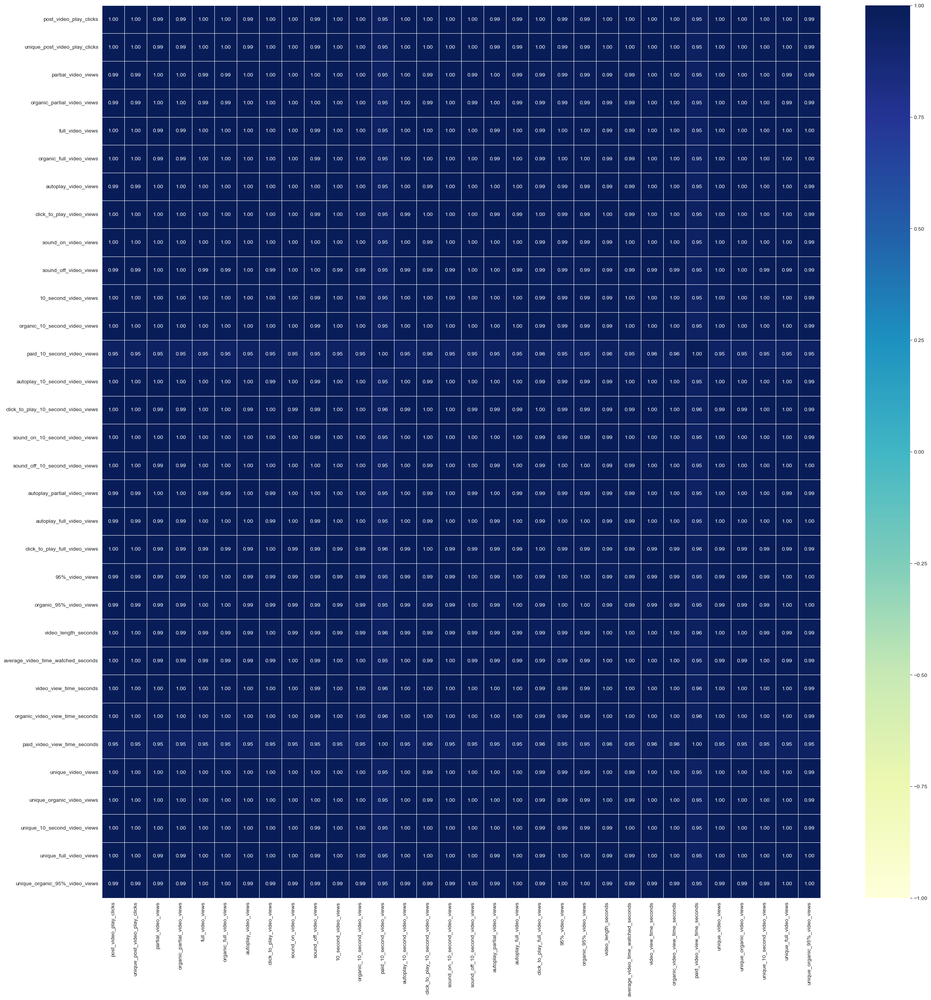

In [414]:
plt.figure(figsize=(30, 30))
sns.heatmap(
    df[vid_metrics].corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

**Sentiment Analysis**

In [327]:
example = df.sample(1).post.iloc[0]
print(example)

This Nigeria landmark is Kajuru Castle in Kaduna state. Built in 1978, it features a baronial hall, with a great view of the surrounding mountains. #NigerianHistory #Tourist #Travel #Africa #StanbicIBTC 
Photocredit: @irinajo_ng


In [328]:
tokens = nltk.word_tokenize(example)
tokens[:10]

['This',
 'Nigeria',
 'landmark',
 'is',
 'Kajuru',
 'Castle',
 'in',
 'Kaduna',
 'state',
 '.']

In [329]:
tagged = nltk.pos_tag(tokens)
tagged[:10]

[('This', 'DT'),
 ('Nigeria', 'NNP'),
 ('landmark', 'NN'),
 ('is', 'VBZ'),
 ('Kajuru', 'NNP'),
 ('Castle', 'NNP'),
 ('in', 'IN'),
 ('Kaduna', 'NNP'),
 ('state', 'NN'),
 ('.', '.')]

In [330]:
sia = SentimentIntensityAnalyzer()
sia.polarity_scores(example)

{'neg': 0.0, 'neu': 0.838, 'pos': 0.162, 'compound': 0.6597}

In [331]:
res = {}
for i, row in tqdm(df.iterrows(), total=len(df)):
    text = row['post']
    myid = i
    res[myid] = sia.polarity_scores(text)

  0%|          | 0/36092 [00:00<?, ?it/s]

In [332]:
vaders = pd.DataFrame(res).T
vaders = vaders.reset_index().rename(columns={'index': 'date'})
vaders = vaders.merge(df[gen_metrics + ['network', 'content_type', 'sent_by']].reset_index(), how='left')

vaders.head()

,date,neg,neu,pos,compound,impressions,reach,engagements,engagement_rate_per_impression,engagement_rate_per_reach,...,likes,comments,shares,post_link_clicks,post_clicks_all,video_views,organic_video_views,network,content_type,sent_by
0,2013-01-15 16:25:00,0.688,0.312,0.0,-0.296,5857.725177,5210.642078,231.683234,0.039552,0.044463,...,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909,Facebook,Link,Unknown
1,2013-01-16 16:51:00,0.688,0.312,0.0,-0.296,5857.725177,5210.642078,231.683234,0.039552,0.044463,...,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909,Facebook,Photo,Unknown
2,2013-01-16 16:58:00,0.688,0.312,0.0,-0.296,5857.725177,5210.642078,231.683234,0.039552,0.044463,...,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909,Facebook,Photo,Unknown
3,2013-01-17 17:08:00,0.688,0.312,0.0,-0.296,5857.725177,5210.642078,231.683234,0.039552,0.044463,...,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909,Facebook,Photo,Unknown
4,2013-02-01 13:24:00,0.688,0.312,0.0,-0.296,5857.725177,5210.642078,231.683234,0.039552,0.044463,...,89.108512,20.538738,8.381311,10.718229,110.876195,235.06833,235.921909,Facebook,Photo,Unknown


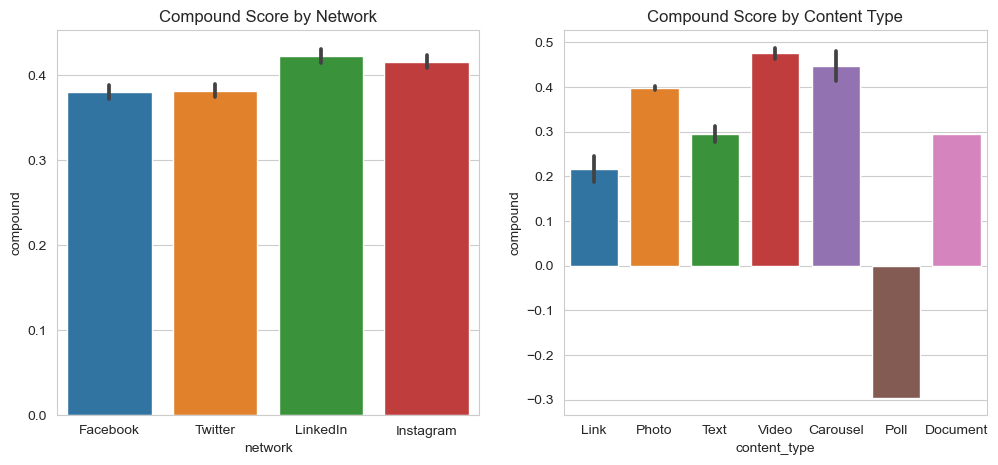

In [333]:
fig, axs = plt.subplots(1, 2, figsize=(12, 5))
sns.barplot(data=vaders, x='network', y='compound',
 ax=axs[0])
axs[0].set_title('Compound Score by Network')

sns.barplot(data=vaders, x='content_type', y='compound', ax=axs[1])
axs[1].set_title('Compound Score by Content Type')


plt.show()

Only about 20% of posts are not neutral:

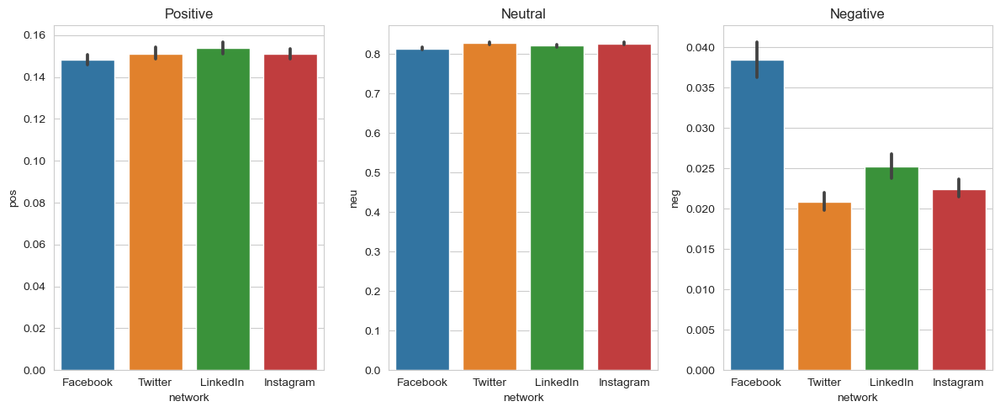

In [334]:
fig, axs = plt.subplots(1, 3, figsize=(12, 5))
sns.barplot(data=vaders, x='network', y='pos', ax=axs[0])
sns.barplot(data=vaders, x='network', y='neu', ax=axs[1])
sns.barplot(data=vaders, x='network', y='neg', ax=axs[2])
axs[0].set_title('Positive')
axs[1].set_title('Neutral')
axs[2].set_title('Negative')
plt.tight_layout()
plt.show()

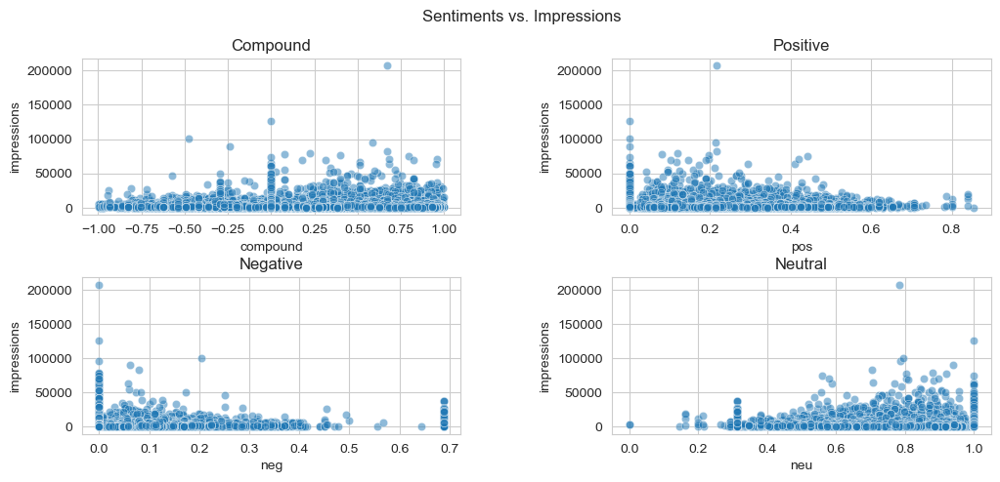

In [427]:
fig, axs = plt.subplots(2, 2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

sns.scatterplot(x='compound', y='impressions', data=vaders, 
                ax=axs.ravel()[0], alpha=0.5)
sns.scatterplot(x='pos', y='impressions', data=vaders, 
                ax=axs.ravel()[1], alpha=0.5)
sns.scatterplot(x='neg', y='impressions', data=vaders, 
                ax=axs.ravel()[2], alpha=0.5)
sns.scatterplot(x='neu', y='impressions', data=vaders, 
                ax=axs.ravel()[3], alpha=0.5)

axs.ravel()[0].set_title('Compound')
axs.ravel()[1].set_title('Positive')
axs.ravel()[2].set_title('Negative')
axs.ravel()[3].set_title('Neutral')

plt.suptitle('Sentiments vs. Impressions')
plt.show()

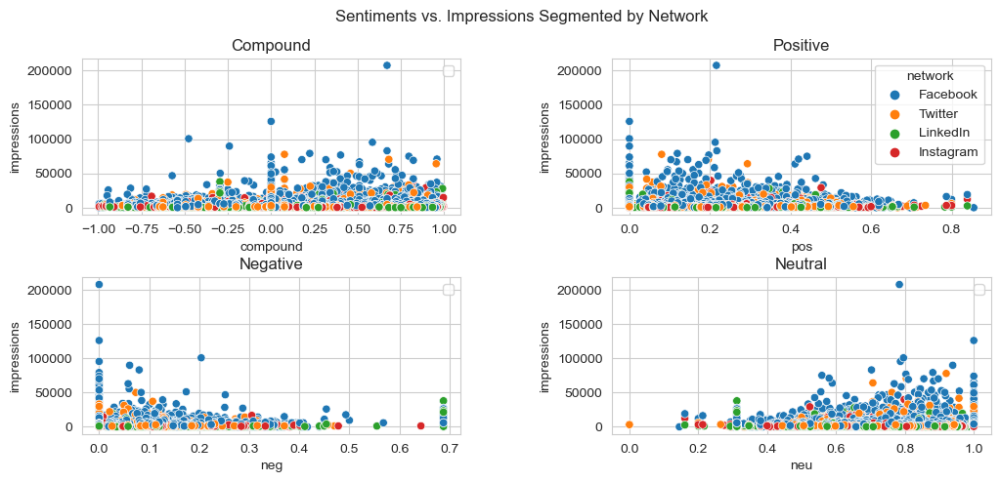

In [428]:
fig, axs = plt.subplots(2, 2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

sns.scatterplot(x='compound', y='impressions', 
                data=vaders, hue='network', ax=axs.ravel()[0])
sns.scatterplot(x='pos', y='impressions', 
                data=vaders, hue='network', ax=axs.ravel()[1])
sns.scatterplot(x='neg', y='impressions', 
                data=vaders, hue='network', ax=axs.ravel()[2])
sns.scatterplot(x='neu', y='impressions', 
                data=vaders, hue='network', ax=axs.ravel()[3])

axs.ravel()[0].set_title('Compound')
axs.ravel()[1].set_title('Positive')
axs.ravel()[2].set_title('Negative')
axs.ravel()[3].set_title('Neutral')

axs.ravel()[0].legend('')
axs.ravel()[2].legend('')
axs.ravel()[3].legend('')

plt.suptitle('Sentiments vs. Impressions Segmented by Network')
plt.show()

There are no trends in sentiment features when segmented by network.

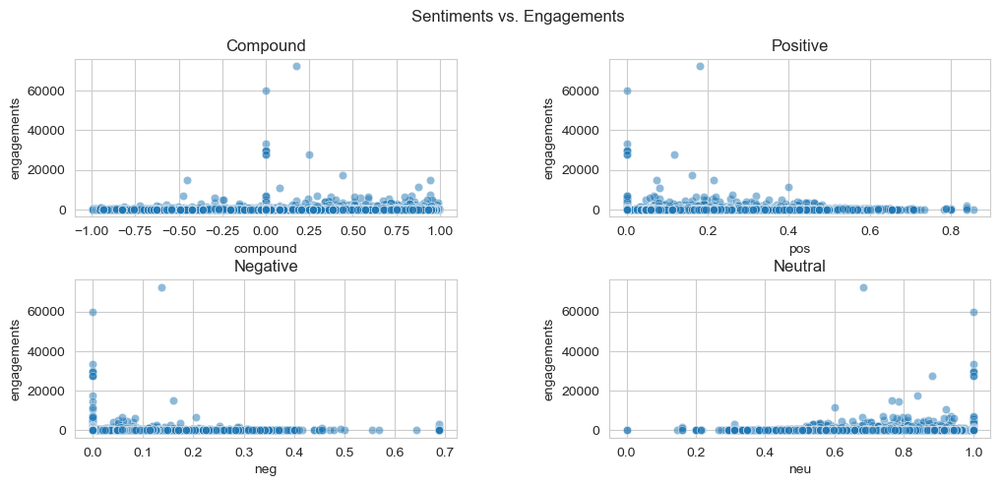

In [429]:
fig, axs = plt.subplots(2, 2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

sns.scatterplot(x='compound', y='engagements', data=vaders, 
                ax=axs.ravel()[0], alpha=0.5)
sns.scatterplot(x='pos', y='engagements', data=vaders, 
                ax=axs.ravel()[1], alpha=0.5)
sns.scatterplot(x='neg', y='engagements', data=vaders, 
                ax=axs.ravel()[2], alpha=0.5)
sns.scatterplot(x='neu', y='engagements', data=vaders, 
                ax=axs.ravel()[3], alpha=0.5)

axs.ravel()[0].set_title('Compound')
axs.ravel()[1].set_title('Positive')
axs.ravel()[2].set_title('Negative')
axs.ravel()[3].set_title('Neutral')

plt.suptitle('Sentiments vs. Engagements')
plt.show()

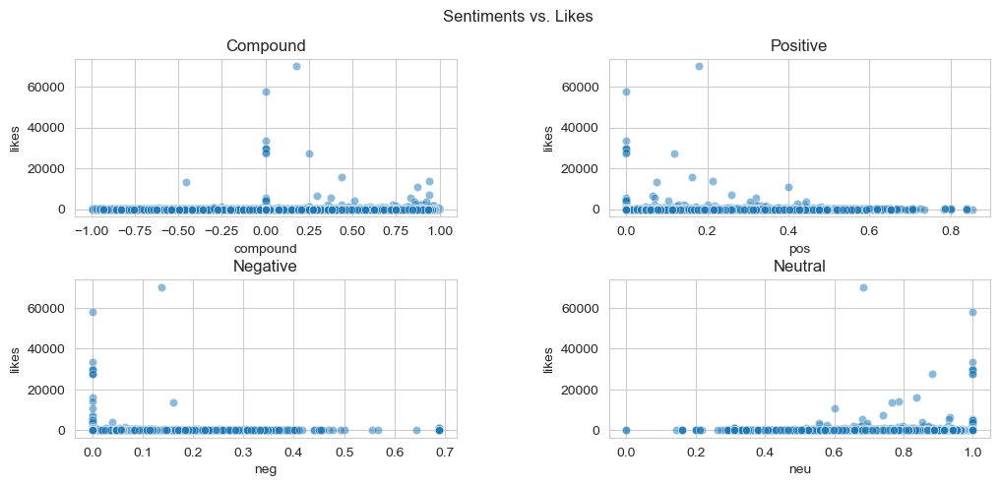

In [433]:
fig, axs = plt.subplots(2, 2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

sns.scatterplot(x='compound', y='likes', data=vaders, 
                ax=axs.ravel()[0], alpha=0.5)
sns.scatterplot(x='pos', y='likes', data=vaders, 
                ax=axs.ravel()[1], alpha=0.5)
sns.scatterplot(x='neg', y='likes', data=vaders, 
                ax=axs.ravel()[2], alpha=0.5)
sns.scatterplot(x='neu', y='likes', data=vaders, 
                ax=axs.ravel()[3], alpha=0.5)

axs.ravel()[0].set_title('Compound')
axs.ravel()[1].set_title('Positive')
axs.ravel()[2].set_title('Negative')
axs.ravel()[3].set_title('Neutral')

plt.suptitle('Sentiments vs. Likes')
plt.show()

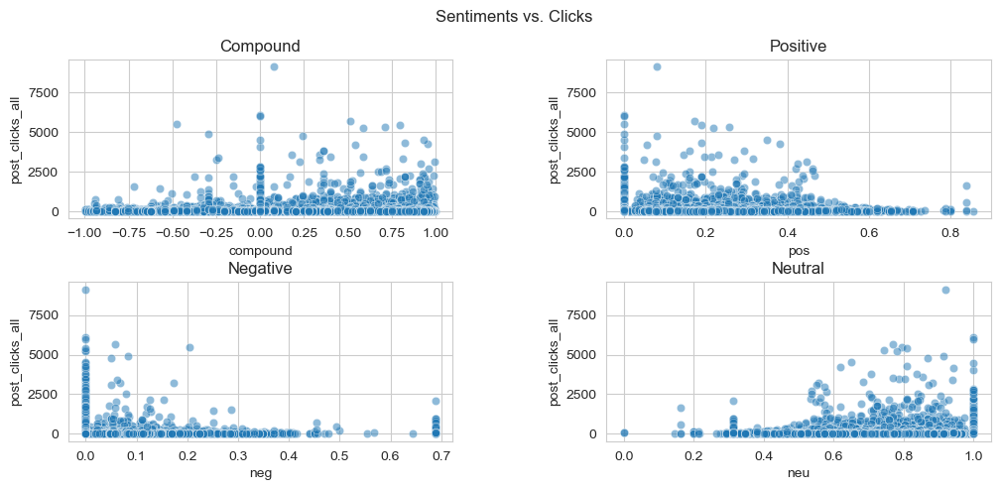

In [431]:
fig, axs = plt.subplots(2, 2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

sns.scatterplot(x='compound', y='post_clicks_all', data=vaders, 
                ax=axs.ravel()[0], alpha=0.5)
sns.scatterplot(x='pos', y='post_clicks_all', data=vaders, 
                ax=axs.ravel()[1], alpha=0.5)
sns.scatterplot(x='neg', y='post_clicks_all', data=vaders, 
                ax=axs.ravel()[2], alpha=0.5)
sns.scatterplot(x='neu', y='post_clicks_all', data=vaders, 
                ax=axs.ravel()[3], alpha=0.5)

axs.ravel()[0].set_title('Compound')
axs.ravel()[1].set_title('Positive')
axs.ravel()[2].set_title('Negative')
axs.ravel()[3].set_title('Neutral')

plt.suptitle('Sentiments vs. Clicks')
plt.show()

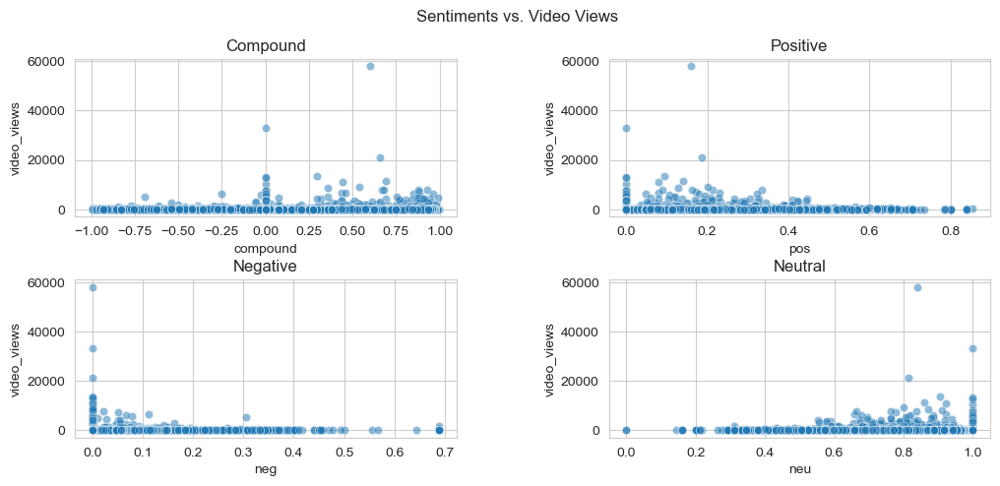

In [432]:
fig, axs = plt.subplots(2, 2, figsize=(12, 5))
fig.subplots_adjust(hspace=0.4, wspace=0.4)

sns.scatterplot(x='compound', y='video_views', data=vaders, 
                ax=axs.ravel()[0], alpha=0.5)
sns.scatterplot(x='pos', y='video_views', data=vaders, 
                ax=axs.ravel()[1], alpha=0.5)
sns.scatterplot(x='neg', y='video_views', data=vaders, 
                ax=axs.ravel()[2], alpha=0.5)
sns.scatterplot(x='neu', y='video_views', data=vaders, 
                ax=axs.ravel()[3], alpha=0.5)

axs.ravel()[0].set_title('Compound')
axs.ravel()[1].set_title('Positive')
axs.ravel()[2].set_title('Negative')
axs.ravel()[3].set_title('Neutral')

plt.suptitle('Sentiments vs. Video Views')
plt.show()

Vaders Correlation

Sentiments features are not correlated with any of the general metrics:

Spearman Rank Correlation:

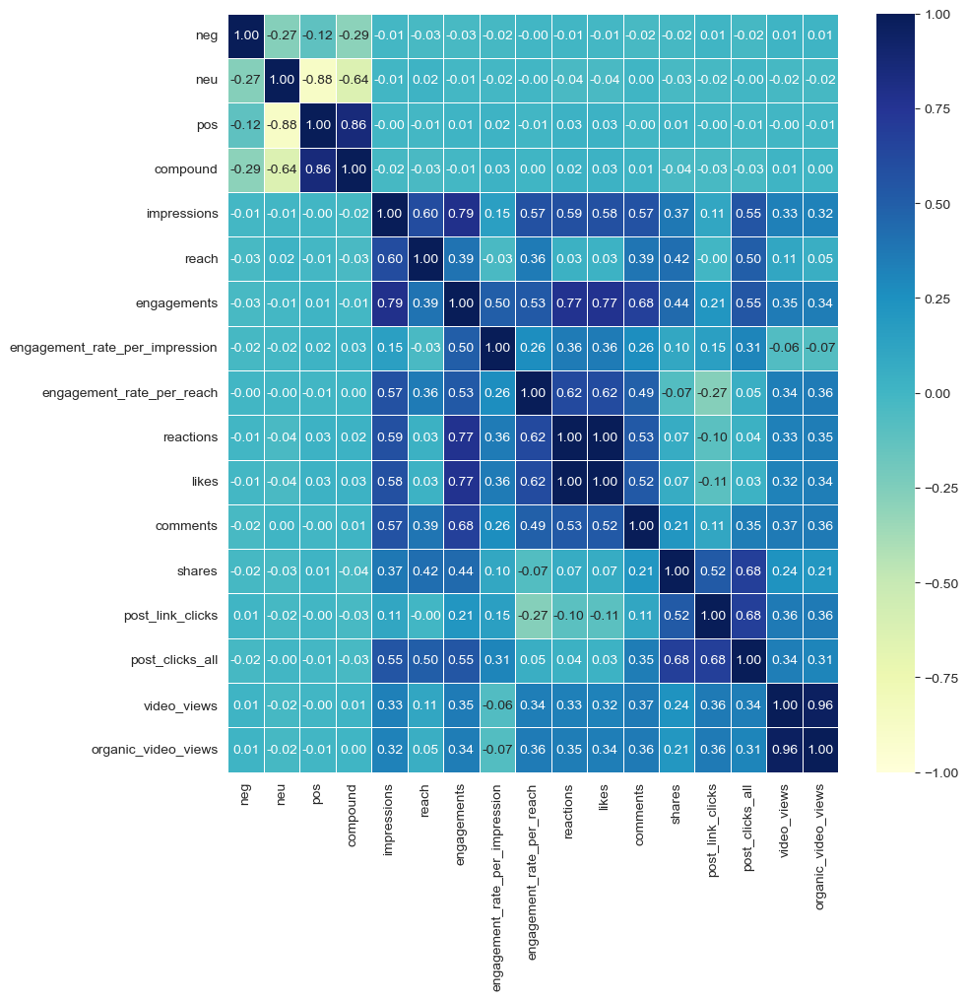

In [338]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    vaders.corr(numeric_only=True, method='spearman'),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Pearson Correlation:

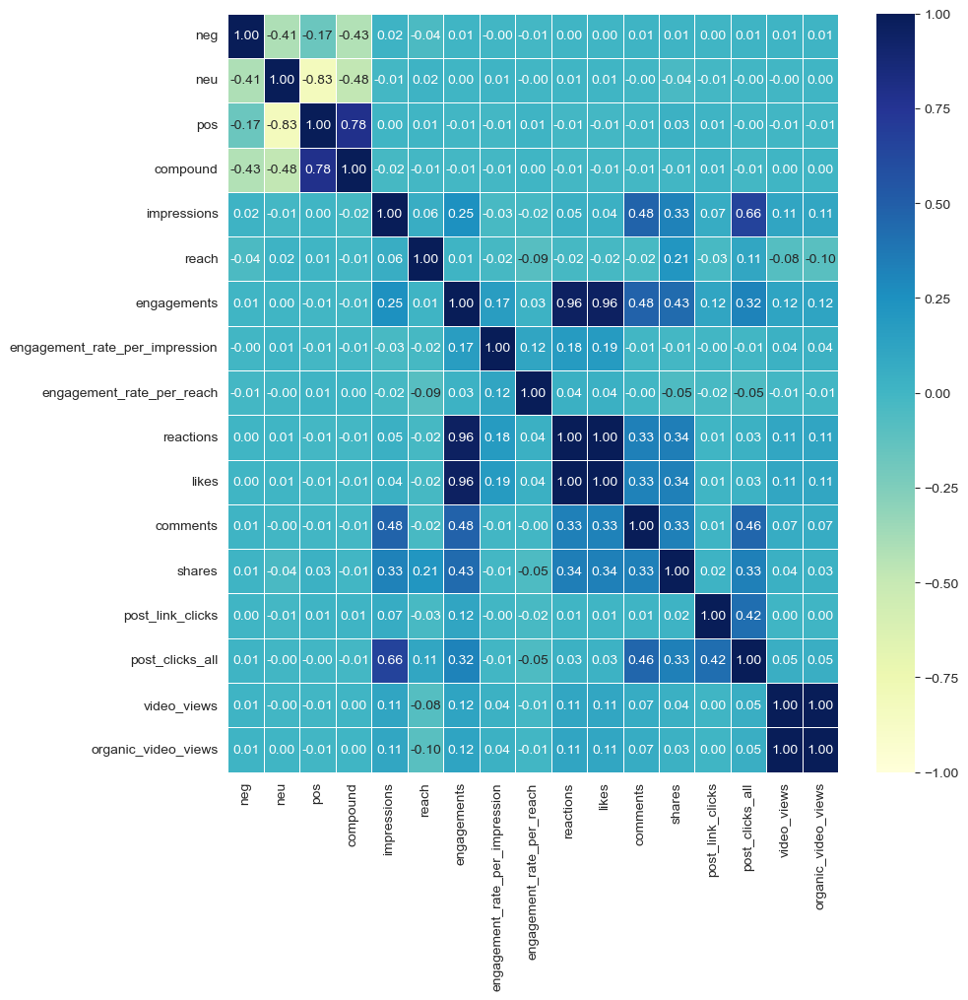

In [339]:
plt.figure(figsize=(10, 10))
sns.heatmap(
    vaders.corr(numeric_only=True),
    annot=True,
    linewidths=0.5,
    center=0,
    vmin=-1,
    vmax=1,
    fmt= ".2f",
    cmap="YlGnBu");

Hashtags by Network

Facebook:

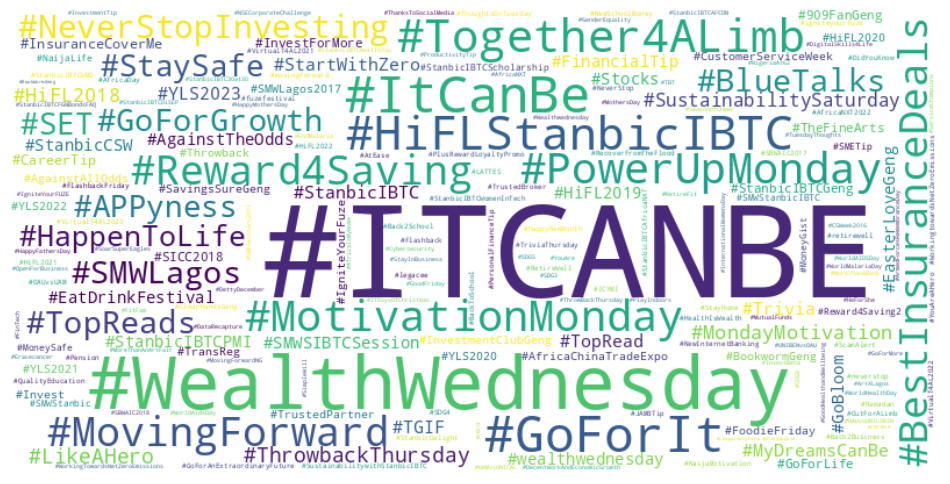

In [409]:
all_words = [word for sublist in df.loc[df.network=='Facebook', 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

Twitter:

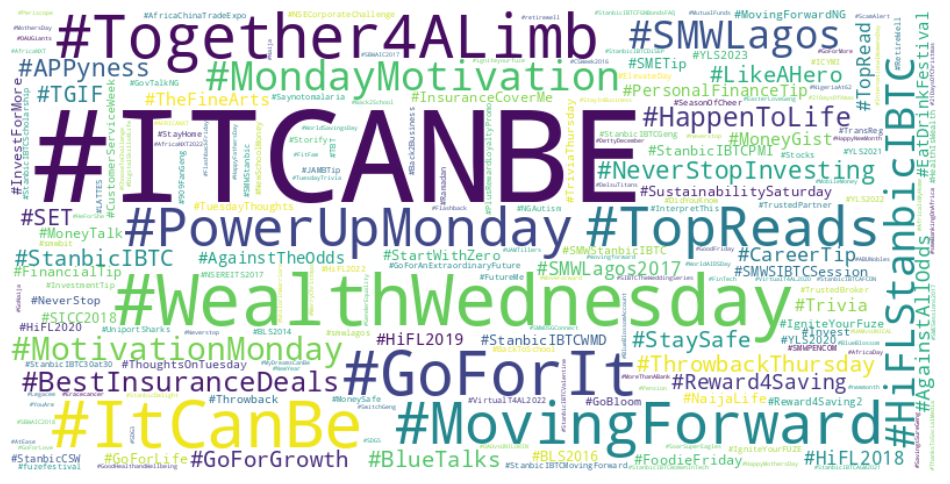

In [410]:
all_words = [word for sublist in df.loc[df.network=='Twitter', 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

Instagram:

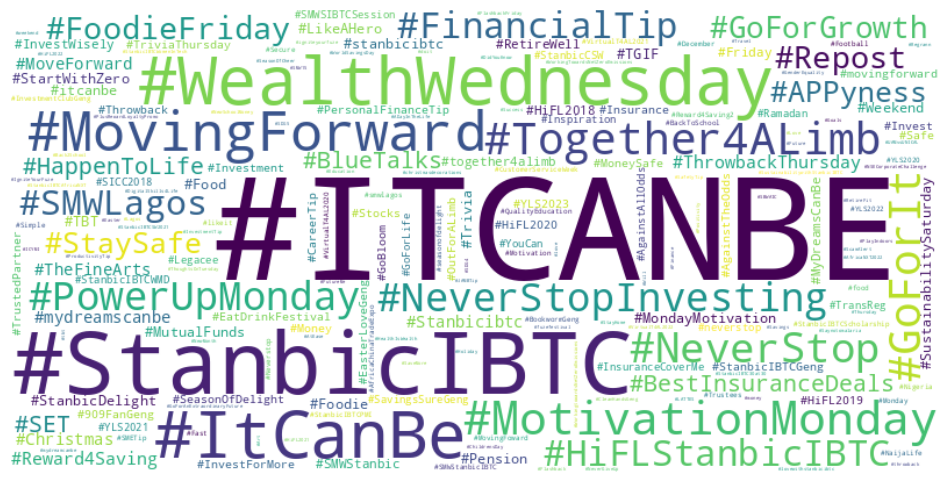

In [411]:
all_words = [word for sublist in df.loc[df.network=='Instagram', 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

LinkedIn:

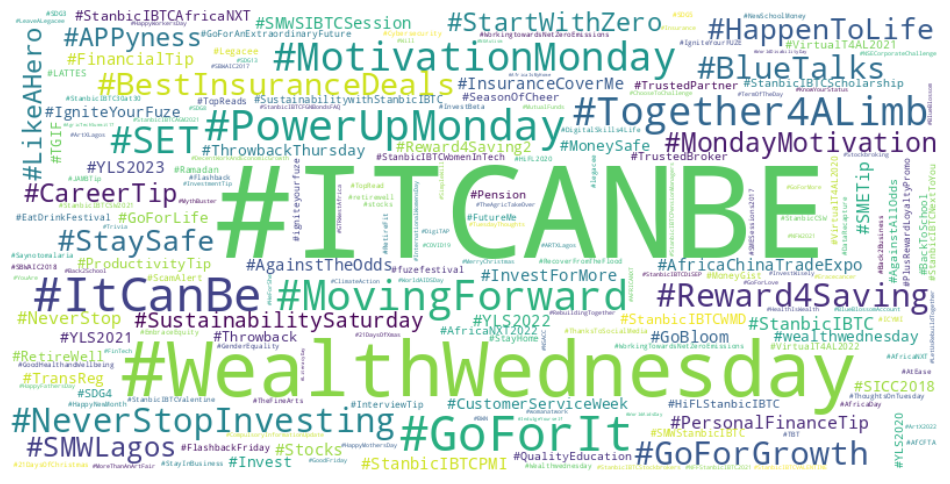

In [412]:
all_words = [word for sublist in df.loc[df.network=='LinkedIn', 'hashtags'] for word in sublist]
text = ' '.join(all_words)

word_counts = Counter(text.split())

wordcloud = WordCloud(width=800, height=400, background_color='white')
wordcloud.generate_from_frequencies(word_counts)

plt.figure(figsize=(12, 10))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

### Data Analysis

**Key Questions**

* What are they talking about?
* Spread number of words by tags/ hashtags 
* What are the most engaging types of posts?
* Which platform yields the highest engagement for the client?
* What are the peak times for user engagement? (Best date / time for impressions/ engagements/ reach)
* Are there any noticeable trends over time (e.g., increasing likes, decreasing shares)?
    * Are there are any increases / decreases in engagements
    * Is this related to increase or reduction in activity
    * Is this related to time/ date of post?
    * Is this related to the sentiment of post / hashtag?
    * Count of posts per day/ month
    * Which day of the week has the most / least posts?
* Popular tags & hashtags
* Sentiment analysis: Relationship between sentiment and engagement/ clicks
* Which poster had the highest / lowest engagement/ impression?
* Relationship between a content type and clicks/ engagement / impressions
* Most popular and least popular post across all metrics
* Word cloud of posts
* Relationship between length of post and engagement.

### Feature Engineering
* Based on EDA, create new metrics or indicators that might be more informative. For instance, engagement rate as a ratio of engagements to impressions.

### Deep Dive Analysis
* Use statistical methods or machine learning (if applicable) to understand underlying patterns or to predict future trends.
    * Can we predict whether a post will have high or low engagement given certain features?
    * What linear relationships exist between features?
* Segment data to find insights specific to certain demographics or post-types.

### Insight Generation
* Based on the analysis, derive actionable insights.
* Translate these insights into recommendations for the client.